### This notebook trains proteinVI unshared, totalvi shared, and rna unshared on protein_unshared, protein shared, rna shared and rna_unshared

This notebook also train the models in a criss cross manner too.

In [1]:
import numpy as np
import pandas as pd
from scipy.io import mmread
import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"] = (6, 4)
import anndata as ad
import scanpy as sc
import torch
import random

In [2]:
def set_random_seed():
    # Example usage:
    seed = 42
    # Set seed for random module
    random.seed(seed)

    # Set seed for numpy
    np.random.seed(seed)

    # Set seed for torch
    torch.manual_seed(seed)
    if torch.cuda.is_available():
        torch.cuda.manual_seed(seed)
        torch.cuda.manual_seed_all(seed)
        
set_random_seed()

In [3]:
# read in protein data
protein = pd.read_csv("data/citeseq_pbmc/pro.csv") # 10k cells (protein)
# convert to AnnData
protein_adata = ad.AnnData(
    protein.to_numpy(), dtype=np.float32
)
protein_adata.var_names = protein.columns

# read in celltyle labels
metadata = pd.read_csv('data/citeseq_pbmc/meta.csv')
labels_l1 = metadata['celltype.l1'].to_numpy()
labels_l2 = metadata['celltype.l2'].to_numpy()

protein_adata.obs['celltype.l1'] = labels_l1
protein_adata.obs['celltype.l2'] = labels_l2

print("Final stats of protein adata: \n",protein_adata)

Final stats of protein adata: 
 AnnData object with n_obs × n_vars = 10000 × 224
    obs: 'celltype.l1', 'celltype.l2'


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\anndata\_core\anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


In [4]:
# read in RNA data
rna = mmread("./data/citeseq_pbmc/rna.txt") # rna count as sparse matrix, 10k cells (RNA)
rna_names = pd.read_csv('./data/citeseq_pbmc/citeseq_rna_names.csv')['names'].to_numpy()
# convert to AnnData
rna_adata = ad.AnnData(
    rna.tocsr(), dtype=np.float32
)
rna_adata.var_names = rna_names

# read in celltyle labels
metadata = pd.read_csv('./data/citeseq_pbmc/meta.csv')
labels_l1 = metadata['celltype.l1'].to_numpy()
labels_l2 = metadata['celltype.l2'].to_numpy()

rna_adata.obs['celltype.l1'] = labels_l1
rna_adata.obs['celltype.l2'] = labels_l2

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\anndata\_core\anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


In [5]:
rna_protein_correspondence = []
correspondence = pd.read_csv('data/protein_gene_conversion.csv')
for i in range(correspondence.shape[0]):
    curr_protein_name, curr_rna_names = correspondence.iloc[i]
    if curr_protein_name not in protein_adata.var_names:
        continue
    if curr_rna_names.find('Ignore') != -1: # some correspondence ignored eg. protein isoform to one gene
        continue
    curr_rna_names = curr_rna_names.split('/') # eg. one protein to multiple genes
    for r in curr_rna_names:
        if r in rna_adata.var_names:
            rna_protein_correspondence.append([r, curr_protein_name])

rna_protein_correspondence = np.array(rna_protein_correspondence)
print("Number of correspondence matches: ", rna_protein_correspondence.shape)
shared_gene_names_repeated = rna_protein_correspondence.T[0]
shared_protein_names_repeated = rna_protein_correspondence.T[1]
print("Unique shared gene names: {}, Unique shared protein names: {}".format(len(np.unique(shared_gene_names_repeated)), len(np.unique(shared_protein_names_repeated))))

Number of correspondence matches:  (180, 2)
Unique shared gene names: 170, Unique shared protein names: 170


In [6]:
shared_gene_features = list(set(shared_gene_names_repeated))
print("Final shared RNA: ",len(shared_gene_features))
shared_protein_features = list(set(shared_protein_names_repeated))
print("Final share protein: ", len(shared_protein_features))

rna_adata_copy = rna_adata.copy()
sc.pp.normalize_total(rna_adata_copy)
sc.pp.log1p(rna_adata_copy)
sc.pp.highly_variable_genes(rna_adata_copy, n_top_genes=2000)

highly_var_genes = list(set(rna_adata.var_names[rna_adata_copy.var.highly_variable==True]))
highly_var_genes_filtered = [gene for gene in highly_var_genes if gene not in shared_gene_features]

unshared_protein_features = [protein for protein in protein_adata.var_names if protein not in shared_protein_features]
print("Unshared protein features: ", len(unshared_protein_features))
print("variable genes that are not shared: ", len(highly_var_genes_filtered))

Final shared RNA:  170
Final share protein:  170
Unshared protein features:  54
variable genes that are not shared:  1911


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\preprocessing\_highly_variable_genes.py:220: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  disp_grouped = df.groupby('mean_bin')['dispersions']


In [7]:
def get_indices(feature_names, all_feature_names):
    """Returns the indices of features in 'feature_names' within the 'all_feature_names' list.

    Args:
        feature_names: A list of feature names to find indices for.
        all_feature_names: The complete list of all feature names.

    Returns:
        A list of indices corresponding to the positions of the 'feature_names' 
        within the 'all_feature_names' list. If a feature is not found, its index
        will be -1.
    """
    indices = []
    for feature in feature_names:
        try:
            index = all_feature_names.index(feature)
        except ValueError:
            index = -1  # Feature not found
        indices.append(index)
    return indices

In [8]:
unshared_gene_indices = get_indices(highly_var_genes_filtered, rna_adata.var_names.to_list())
shared_gene_indices = get_indices(shared_gene_names_repeated, rna_adata.var_names.to_list())
unshared_protein_indices = get_indices(unshared_protein_features, protein_adata.var_names.to_list())
shared_protein_indices = get_indices(shared_protein_names_repeated, protein_adata.var_names.to_list())

print("Length of unshared_gene_indices:", len(unshared_gene_indices))
print("Length of shared_gene_indices:", len(shared_gene_indices))
print("Length of unshared_protein_indices:", len(unshared_protein_indices))
print("Length of shared_protein_indices:", len(shared_protein_indices))

# Convert index lists to sets for unique element calculation
unshared_gene_unique = set(unshared_gene_indices)
shared_gene_unique = set(shared_gene_indices)
unshared_protein_unique = set(unshared_protein_indices)
shared_protein_unique = set(shared_protein_indices)

# Print lengths of unique elements
print("Unique elements in unshared_gene_indices:", len(unshared_gene_unique))
print("Unique elements in shared_gene_indices:", len(shared_gene_unique))
print("Unique elements in unshared_protein_indices:", len(unshared_protein_unique))
print("Unique elements in shared_protein_indices:", len(shared_protein_unique))

Length of unshared_gene_indices: 1911
Length of shared_gene_indices: 180
Length of unshared_protein_indices: 54
Length of shared_protein_indices: 180
Unique elements in unshared_gene_indices: 1911
Unique elements in shared_gene_indices: 170
Unique elements in unshared_protein_indices: 54
Unique elements in shared_protein_indices: 170


In [9]:
rna_unshared_adata = rna_adata[:,unshared_gene_indices]
rna_shared_adata = rna_adata[:,shared_gene_indices]
protein_unshared_adata = protein_adata[:,unshared_protein_indices]
protein_shared_adata = protein_adata[:,shared_protein_indices]

In [10]:
from torch.utils.data import Dataset, DataLoader
from tqdm import tqdm

class ProteinDataset(Dataset):
    def __init__(self,unshared_protein_adata, shared_protein_adata):
        self.unshared_data = np.asarray(unshared_protein_adata.X)
        self.shared_data = np.asarray(shared_protein_adata.X)
        self.labels_l1 = protein_adata.obs['celltype.l1']
        self.labels_l2 = protein_adata.obs['celltype.l2']
        self.batch = np.array([1.0]*self.unshared_data.shape[0]).reshape((-1,1)).astype(np.float32)
        
    def __len__(self):
        return self.unshared_data.shape[0]

    def __getitem__(self, idx):
        return {"y_unshared":self.unshared_data[idx], "y_shared":self.shared_data[idx], "l1":self.labels_l1[idx], "l2":self.labels_l2[idx], "batch": self.batch[idx]}

protein_dataset = ProteinDataset(protein_unshared_adata, protein_shared_adata)
protein_dataloader = DataLoader(protein_dataset, batch_size=256, shuffle=True)

In [11]:
class RNADataset(Dataset):
    def __init__(self,unshared_rna_adata, shared_rna_adata):
        self.unshared_data = np.asarray(unshared_rna_adata.X.todense())
        self.shared_data = np.asarray(shared_rna_adata.X.todense())
        self.labels_l1 = rna_adata.obs['celltype.l1']
        self.labels_l2 = rna_adata.obs['celltype.l2']
        self.local_mean, self.local_var = self.compute_library_size(np.concatenate([self.unshared_data, self.shared_data],axis=1))
        self.local_mean = np.array([self.local_mean]*self.unshared_data.shape[0])
        self.local_var = np.array([self.local_var]*self.unshared_data.shape[0])
        self.batch = np.array([0.0]*self.unshared_data.shape[0]).reshape((-1,1)).astype(np.float32)
        
    def __len__(self):
        return self.unshared_data.shape[0]

    def __getitem__(self, idx):
        return {"x_unshared":self.unshared_data[idx], "x_shared":self.shared_data[idx], "l1":self.labels_l1[idx], "l2":self.labels_l2[idx], "mean": self.local_mean[idx], "var": self.local_var[idx], "batch": self.batch[idx]}
    
    def compute_library_size(self, data):
        # print(data.shape)
        sum_counts = data.sum(axis=1)
        masked_log_sum = np.ma.log(sum_counts)
        if np.ma.is_masked(masked_log_sum):
            print(
                "Warning: This dataset has some empty cells, this might fail scVI inference. Data should be filtered with `my_dataset.filter_cells_by_count()"
            )
        log_counts = masked_log_sum.filled(0)
        local_mean = (np.mean(log_counts).reshape(-1, 1)).astype(np.float32)
        local_var = (np.var(log_counts).reshape(-1, 1)).astype(np.float32)

        local_mean = torch.Tensor(local_mean).reshape(-1)
        local_var = torch.Tensor(local_var).reshape(-1)
        return local_mean, local_var

rna_dataset = RNADataset(rna_unshared_adata, rna_shared_adata)
rna_dataloader = DataLoader(rna_dataset, batch_size=256, shuffle=True)

In [12]:
def l2_normalize_batch_pytorch(batch):
    norm = torch.norm(batch, dim=1, keepdim=True)
    normalized_batch = batch / norm
    return normalized_batch
    
def cross_entropy(preds, targets, reduction='none'):
    log_softmax = nn.LogSoftmax(dim=-1)
    loss = (-targets * log_softmax(preds)).sum(1)
    if reduction == "none":
        return loss
    elif reduction == "mean":
        return loss.mean()

def CLIP_loss(rna_total,rna_unshared):
    
    text_embeddings = l2_normalize_batch_pytorch(rna_total)
    image_embeddings = l2_normalize_batch_pytorch(rna_unshared)
    temperature = 1.0
    logits = (text_embeddings @ image_embeddings.T) 
    images_similarity = image_embeddings @ image_embeddings.T
    texts_similarity = text_embeddings @ text_embeddings.T
    targets = F.softmax(
        (images_similarity + texts_similarity) / 2, dim=-1
    )
    texts_loss = cross_entropy(logits, targets, reduction='none')
    images_loss = cross_entropy(logits.T, targets.T, reduction='none')
    loss =  (images_loss + texts_loss) / 2.0 
    return loss.mean()

In [13]:
Unshared_protein_loss = []
Unshared_rna_loss = []
Shared_loss = []
loss_emb_p = []
loss_emb_r = []

final_unshared_protein_loss = 0.0
final_unshared_rna_loss = 0.0
final_shared_loss = 0.0
final_loss_emb_p = 0.0
final_loss_emb_r = 0.0

In [14]:
def get_paras_for_podel(para_out_prodel, gene_size):
    para = {}
    para["qz_m"] = para_out_prodel["qz_m"][gene_size:]
    para["qz_v"] = para_out_prodel["qz_v"][gene_size:]
    para["z_protein"] = para_out_prodel["z_protein"]
    para["untran_z"] = para_out_prodel["untran_z"][gene_size:]
    return para

def get_paras_for_rodel(para_out_prodel, gene_size):
    para = {}
    para["qz_m"] = para_out_prodel["qz_m"][:gene_size]
    para["qz_v"] = para_out_prodel["qz_v"][:gene_size]
    para["z_gene"] = para_out_prodel["z_gene"]
    para["ql_m"] = para_out_prodel["ql_m"][:gene_size]
    para["ql_v"] = para_out_prodel["ql_v"][:gene_size]
    para["l"] = para_out_prodel["l"][:gene_size]
    return para

def get_paras_for_prodel(para_out_rodel, para_out_podel, gene_size):
    para = {}
    para["qz_m"] = torch.cat([para_out_rodel["qz_m"], para_out_podel["qz_m"]], dim=0)
    para["qz_v"] = torch.cat([para_out_rodel["qz_v"], para_out_podel["qz_v"]], dim=0)    
    para["ql_m"] = torch.cat([para_out_rodel["ql_m"], torch.zeros_like(para_out_rodel["ql_m"])], dim=0)
    para["ql_v"] = torch.cat([para_out_rodel["ql_v"], torch.zeros_like(para_out_rodel["ql_v"])], dim=0)
    para["z_gene"] = para_out_rodel["z_gene"]
    para["z_protein"] = para_out_podel["z_protein"]
    para["l"] = torch.cat([para_out_rodel["l"], torch.zeros_like(para_out_rodel["l"])], dim=0)
    para["untran_z"] = torch.cat([torch.zeros_like(para_out_podel["untran_z"]), para_out_podel["untran_z"]], dim=0)
    para["untran_l"] = torch.cat([para_out_rodel["l"], torch.zeros_like(para_out_rodel["l"])], dim=0)
    return para

In [15]:
from scvi.models.proteinvi_unshared_cross import PROTENVI_UNSHARED_CROSS
from scvi.models.rna_unshared_cross import RNA_UNSHARED_CROSS
from scvi.models.totalvi_shared_cross import TOTALVI_SHARED_CROSS
import torch.nn.functional as F
import torch.nn as nn
import metrics.match_utils as mu
from torch.optim.lr_scheduler import StepLR

podel = PROTENVI_UNSHARED_CROSS(54, latent_distribution="normal", log_variational=True)
prodel = TOTALVI_SHARED_CROSS(180, latent_distribution="normal", log_variational=True, reconstruction_loss_gene = "zinb")
rodel = RNA_UNSHARED_CROSS(1911, latent_distribution="normal", log_variational=True, reconstruction_loss="zinb")
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("The device used for training is: ", device)
podel.to(device)
prodel.to(device)
rodel.to(device)
prodel_params = filter(lambda p: p.requires_grad, prodel.parameters())
podel_params = filter(lambda p: p.requires_grad, podel.parameters())
rodel_params = filter(lambda p: p.requires_grad, rodel.parameters())

optimizer_p = torch.optim.Adam(podel_params, lr=0.001, eps=0.01)
optimizer_r = torch.optim.Adam(rodel_params, lr=0.001, eps=0.01)
optimizer_pr = torch.optim.Adam(prodel_params, lr=0.001, eps=0.01)

scheduler_p = StepLR(optimizer_p, step_size=300, gamma=0.5)
scheduler_pr = StepLR(optimizer_pr, step_size=300, gamma=0.5)
scheduler_r = StepLR(optimizer_r, step_size=300, gamma=0.5)

The device used for training is:  cpu


Epoch: 0: 0it [00:00, ?it/s]C:\Users\vinee\AppData\Local\Temp\ipykernel_2144\3129631169.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return {"x_unshared":self.unshared_data[idx], "x_shared":self.shared_data[idx], "l1":self.labels_l1[idx], "l2":self.labels_l2[idx], "mean": self.local_mean[idx], "var": self.local_var[idx], "batch": self.batch[idx]}
Epoch: 0: 40it [00:09,  4.07it/s]


RNA Recon Loss: 25.3240, RNA KL Div L: 0.6454, RNA KL Div Z: 0.0692, Protein Recon Loss: 1.6905, Protein KL Div Back Pro: 1.5880, Protein KL Div Z: 0.1058, Embedding Loss P1: 0.0220, Embedding Loss R1: 0.0220, Shared KL Div Z: 0.1328, Shared Recon Loss Gene: 0.6585, Shared Recon Loss Protein: 5.4939 Cross Loss Protein: 0.0000


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


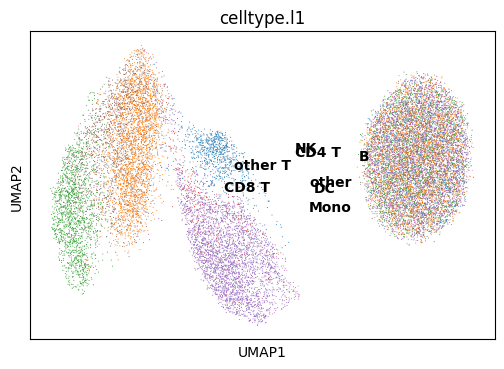

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


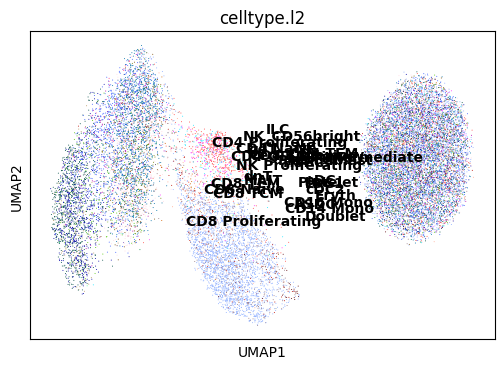

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


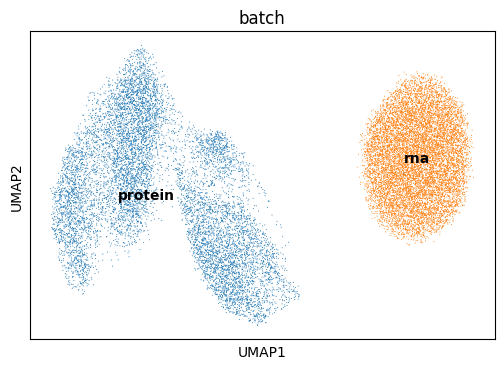

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


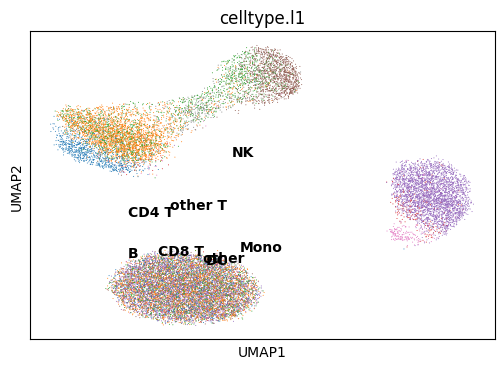

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


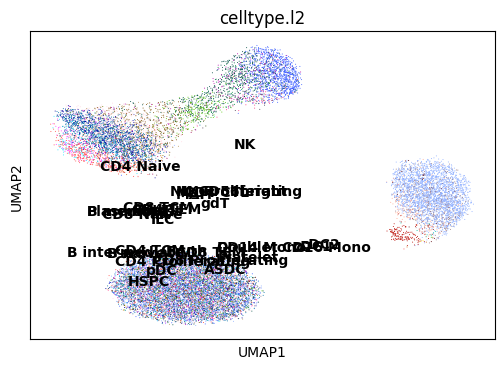

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


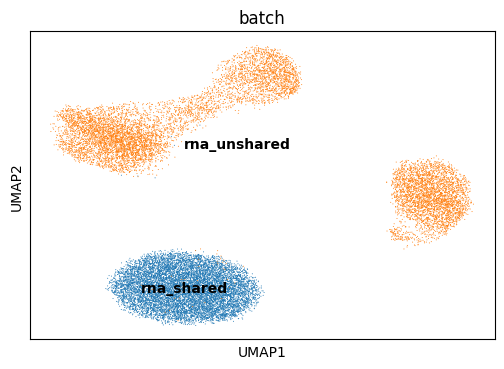

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


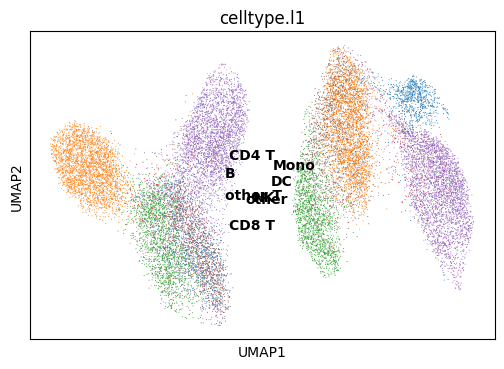

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


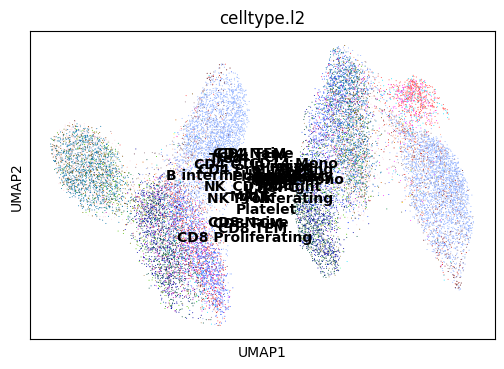

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


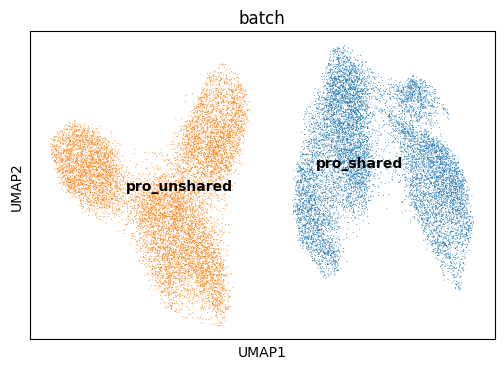

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For All matchings: lv1 matching acc: 0.094,
lv2 matching acc: 0.023.
For All matchings: FOSCTTM score: 0.49791630000000003, 
Knn Alignment score: [0.0001 0.0002 0.0002 0.0003 0.0004 0.0006 0.0006 0.0007 0.0008 0.0008
 0.0009 0.001  0.001  0.0011 0.0012 0.0014 0.0016 0.0016 0.0016 0.0018
 0.0019 0.002  0.0021 0.0023 0.0023]
For All matchings: Silhouette F1 score for lv1: 0.3154880744933552, 
Silhouette F1 score for lv2: 0.3113072645293384



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  6.354333162307739
Matchings are reduced to 5000 after filtering...


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:423: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[matchings[0]], labels_l1[matchings[1]])
C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For only filtered matchings: lv1 matching acc: 0.096,
lv2 matching acc: 0.023.



Matches are being propagated....


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:460: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[filtered_matchings[0]], labels_l1[filtered_matchings[1]])
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scipy\sparse\_index.py:143: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


Done!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For all matchings after propagation: lv1 matching acc: 0.318,
lv2 matching acc: 0.091.


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:495: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[propagated_matchings[0]], labels_l1[propagated_matchings[1]])


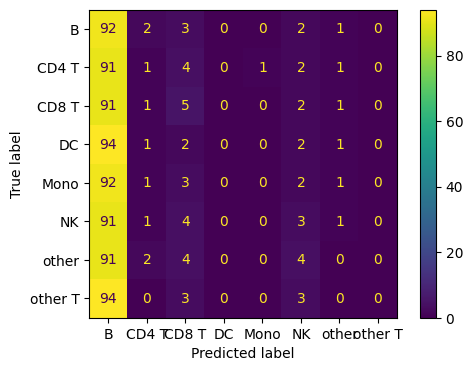

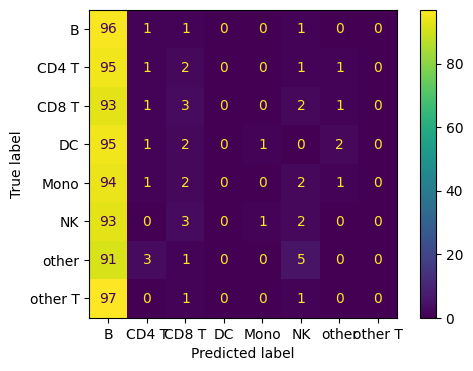

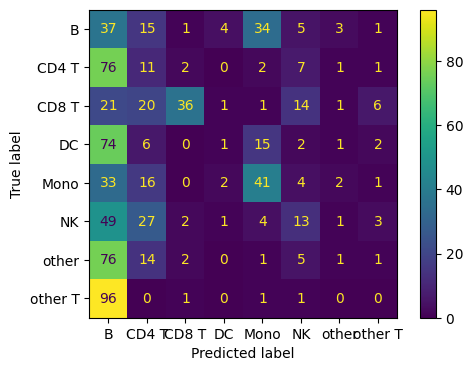

Epoch: 1: 0it [00:00, ?it/s]C:\Users\vinee\AppData\Local\Temp\ipykernel_2144\3129631169.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return {"x_unshared":self.unshared_data[idx], "x_shared":self.shared_data[idx], "l1":self.labels_l1[idx], "l2":self.labels_l2[idx], "mean": self.local_mean[idx], "var": self.local_var[idx], "batch": self.batch[idx]}
Epoch: 1: 40it [00:10,  3.98it/s]


RNA Recon Loss: 9.1678, RNA KL Div L: 0.3188, RNA KL Div Z: 0.2246, Protein Recon Loss: 0.6390, Protein KL Div Back Pro: 1.7745, Protein KL Div Z: 0.2109, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0220, Shared KL Div Z: 0.1946, Shared Recon Loss Gene: 0.4272, Shared Recon Loss Protein: 2.2375 Cross Loss Protein: 0.0000


Epoch: 2: 40it [00:11,  3.46it/s]


RNA Recon Loss: 4.7698, RNA KL Div L: 0.1437, RNA KL Div Z: 0.2854, Protein Recon Loss: 0.6131, Protein KL Div Back Pro: 1.6117, Protein KL Div Z: 0.2375, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0220, Shared KL Div Z: 0.2144, Shared Recon Loss Gene: 0.4172, Shared Recon Loss Protein: 2.1671 Cross Loss Protein: 0.6951


Epoch: 3: 40it [00:11,  3.45it/s]


RNA Recon Loss: 3.0014, RNA KL Div L: 0.0481, RNA KL Div Z: 0.3005, Protein Recon Loss: 0.5959, Protein KL Div Back Pro: 1.5022, Protein KL Div Z: 0.2623, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0220, Shared KL Div Z: 0.2485, Shared Recon Loss Gene: 0.3995, Shared Recon Loss Protein: 2.1194 Cross Loss Protein: 0.6147


Epoch: 4: 40it [00:11,  3.47it/s]


RNA Recon Loss: 2.6103, RNA KL Div L: 0.0195, RNA KL Div Z: 0.3090, Protein Recon Loss: 0.5869, Protein KL Div Back Pro: 1.4210, Protein KL Div Z: 0.2904, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0220, Shared KL Div Z: 0.2834, Shared Recon Loss Gene: 0.3800, Shared Recon Loss Protein: 2.0985 Cross Loss Protein: 0.6046


Epoch: 5: 40it [00:11,  3.43it/s]


RNA Recon Loss: 2.5819, RNA KL Div L: 0.0205, RNA KL Div Z: 0.3180, Protein Recon Loss: 0.5803, Protein KL Div Back Pro: 1.3609, Protein KL Div Z: 0.3172, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0220, Shared KL Div Z: 0.3149, Shared Recon Loss Gene: 0.3695, Shared Recon Loss Protein: 2.0808 Cross Loss Protein: 0.5978


Epoch: 6: 40it [00:11,  3.43it/s]


RNA Recon Loss: 2.5169, RNA KL Div L: 0.0141, RNA KL Div Z: 0.3206, Protein Recon Loss: 0.5749, Protein KL Div Back Pro: 1.3142, Protein KL Div Z: 0.3423, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0220, Shared KL Div Z: 0.3441, Shared Recon Loss Gene: 0.3612, Shared Recon Loss Protein: 2.0659 Cross Loss Protein: 0.5931


Epoch: 7: 40it [00:11,  3.37it/s]


RNA Recon Loss: 2.4704, RNA KL Div L: 0.0140, RNA KL Div Z: 0.3276, Protein Recon Loss: 0.5694, Protein KL Div Back Pro: 1.2797, Protein KL Div Z: 0.3670, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0220, Shared KL Div Z: 0.3733, Shared Recon Loss Gene: 0.3561, Shared Recon Loss Protein: 2.0533 Cross Loss Protein: 0.5890


Epoch: 8: 40it [00:12,  3.27it/s]


RNA Recon Loss: 2.4655, RNA KL Div L: 0.0132, RNA KL Div Z: 0.3333, Protein Recon Loss: 0.5663, Protein KL Div Back Pro: 1.2478, Protein KL Div Z: 0.3879, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0220, Shared KL Div Z: 0.3973, Shared Recon Loss Gene: 0.3506, Shared Recon Loss Protein: 2.0445 Cross Loss Protein: 0.5870


Epoch: 9: 40it [00:12,  3.29it/s]


RNA Recon Loss: 2.4280, RNA KL Div L: 0.0125, RNA KL Div Z: 0.3372, Protein Recon Loss: 0.5632, Protein KL Div Back Pro: 1.2235, Protein KL Div Z: 0.4062, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0220, Shared KL Div Z: 0.4203, Shared Recon Loss Gene: 0.3470, Shared Recon Loss Protein: 2.0362 Cross Loss Protein: 0.5847


Epoch: 10: 40it [00:12,  3.30it/s]


RNA Recon Loss: 2.4353, RNA KL Div L: 0.0138, RNA KL Div Z: 0.3413, Protein Recon Loss: 0.5608, Protein KL Div Back Pro: 1.2015, Protein KL Div Z: 0.4224, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0220, Shared KL Div Z: 0.4421, Shared Recon Loss Gene: 0.3436, Shared Recon Loss Protein: 2.0318 Cross Loss Protein: 0.5833


Epoch: 11: 40it [00:11,  3.35it/s]


RNA Recon Loss: 2.4076, RNA KL Div L: 0.0118, RNA KL Div Z: 0.3446, Protein Recon Loss: 0.5576, Protein KL Div Back Pro: 1.1789, Protein KL Div Z: 0.4358, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.4616, Shared Recon Loss Gene: 0.3410, Shared Recon Loss Protein: 2.0259 Cross Loss Protein: 0.5815


Epoch: 12: 40it [00:11,  3.39it/s]


RNA Recon Loss: 2.4035, RNA KL Div L: 0.0118, RNA KL Div Z: 0.3497, Protein Recon Loss: 0.5553, Protein KL Div Back Pro: 1.1644, Protein KL Div Z: 0.4499, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.4776, Shared Recon Loss Gene: 0.3397, Shared Recon Loss Protein: 2.0219 Cross Loss Protein: 0.5802


Epoch: 13: 40it [00:11,  3.39it/s]


RNA Recon Loss: 2.3750, RNA KL Div L: 0.0113, RNA KL Div Z: 0.3519, Protein Recon Loss: 0.5536, Protein KL Div Back Pro: 1.1460, Protein KL Div Z: 0.4596, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.4948, Shared Recon Loss Gene: 0.3361, Shared Recon Loss Protein: 2.0153 Cross Loss Protein: 0.5793


Epoch: 14: 40it [00:11,  3.36it/s]


RNA Recon Loss: 2.4530, RNA KL Div L: 0.0143, RNA KL Div Z: 0.3549, Protein Recon Loss: 0.5514, Protein KL Div Back Pro: 1.1282, Protein KL Div Z: 0.4671, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5083, Shared Recon Loss Gene: 0.3349, Shared Recon Loss Protein: 2.0107 Cross Loss Protein: 0.5781


Epoch: 15: 40it [00:11,  3.38it/s]


RNA Recon Loss: 2.4124, RNA KL Div L: 0.0177, RNA KL Div Z: 0.3620, Protein Recon Loss: 0.5475, Protein KL Div Back Pro: 1.1123, Protein KL Div Z: 0.4774, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5190, Shared Recon Loss Gene: 0.3312, Shared Recon Loss Protein: 2.0057 Cross Loss Protein: 0.5753


Epoch: 16: 40it [00:11,  3.37it/s]


RNA Recon Loss: 2.3721, RNA KL Div L: 0.0130, RNA KL Div Z: 0.3690, Protein Recon Loss: 0.5463, Protein KL Div Back Pro: 1.1131, Protein KL Div Z: 0.4900, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5321, Shared Recon Loss Gene: 0.3302, Shared Recon Loss Protein: 2.0029 Cross Loss Protein: 0.5755


Epoch: 17: 40it [00:11,  3.38it/s]


RNA Recon Loss: 2.3654, RNA KL Div L: 0.0117, RNA KL Div Z: 0.3676, Protein Recon Loss: 0.5437, Protein KL Div Back Pro: 1.0930, Protein KL Div Z: 0.4957, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5432, Shared Recon Loss Gene: 0.3284, Shared Recon Loss Protein: 1.9989 Cross Loss Protein: 0.5738


Epoch: 18: 40it [00:11,  3.40it/s]


RNA Recon Loss: 2.3531, RNA KL Div L: 0.0126, RNA KL Div Z: 0.3713, Protein Recon Loss: 0.5407, Protein KL Div Back Pro: 1.0838, Protein KL Div Z: 0.5041, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5533, Shared Recon Loss Gene: 0.3271, Shared Recon Loss Protein: 1.9914 Cross Loss Protein: 0.5716


Epoch: 19: 40it [00:14,  2.81it/s]


RNA Recon Loss: 2.3501, RNA KL Div L: 0.0120, RNA KL Div Z: 0.3743, Protein Recon Loss: 0.5402, Protein KL Div Back Pro: 1.0736, Protein KL Div Z: 0.5119, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5645, Shared Recon Loss Gene: 0.3259, Shared Recon Loss Protein: 1.9900 Cross Loss Protein: 0.5716


Epoch: 20: 40it [00:17,  2.22it/s]


RNA Recon Loss: 2.3430, RNA KL Div L: 0.0121, RNA KL Div Z: 0.3792, Protein Recon Loss: 0.5389, Protein KL Div Back Pro: 1.0687, Protein KL Div Z: 0.5222, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5727, Shared Recon Loss Gene: 0.3243, Shared Recon Loss Protein: 1.9866 Cross Loss Protein: 0.5708


Epoch: 21: 40it [00:16,  2.36it/s]


RNA Recon Loss: 2.3437, RNA KL Div L: 0.0135, RNA KL Div Z: 0.3824, Protein Recon Loss: 0.5368, Protein KL Div Back Pro: 1.0633, Protein KL Div Z: 0.5277, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5805, Shared Recon Loss Gene: 0.3221, Shared Recon Loss Protein: 1.9834 Cross Loss Protein: 0.5699


Epoch: 22: 40it [00:12,  3.16it/s]


RNA Recon Loss: 2.3325, RNA KL Div L: 0.0124, RNA KL Div Z: 0.3859, Protein Recon Loss: 0.5357, Protein KL Div Back Pro: 1.0568, Protein KL Div Z: 0.5341, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5868, Shared Recon Loss Gene: 0.3220, Shared Recon Loss Protein: 1.9797 Cross Loss Protein: 0.5691


Epoch: 23: 40it [00:12,  3.23it/s]


RNA Recon Loss: 2.3447, RNA KL Div L: 0.0138, RNA KL Div Z: 0.3878, Protein Recon Loss: 0.5352, Protein KL Div Back Pro: 1.0509, Protein KL Div Z: 0.5393, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5934, Shared Recon Loss Gene: 0.3198, Shared Recon Loss Protein: 1.9850 Cross Loss Protein: 0.5691


Epoch: 24: 40it [00:12,  3.16it/s]


RNA Recon Loss: 2.3352, RNA KL Div L: 0.0137, RNA KL Div Z: 0.3931, Protein Recon Loss: 0.5345, Protein KL Div Back Pro: 1.0445, Protein KL Div Z: 0.5447, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6021, Shared Recon Loss Gene: 0.3212, Shared Recon Loss Protein: 1.9818 Cross Loss Protein: 0.5708


Epoch: 25: 40it [00:12,  3.12it/s]


RNA Recon Loss: 2.3254, RNA KL Div L: 0.0136, RNA KL Div Z: 0.3926, Protein Recon Loss: 0.5316, Protein KL Div Back Pro: 1.0372, Protein KL Div Z: 0.5493, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6009, Shared Recon Loss Gene: 0.3174, Shared Recon Loss Protein: 1.9760 Cross Loss Protein: 0.5676


Epoch: 26: 40it [00:12,  3.21it/s]


RNA Recon Loss: 2.3194, RNA KL Div L: 0.0123, RNA KL Div Z: 0.3951, Protein Recon Loss: 0.5315, Protein KL Div Back Pro: 1.0299, Protein KL Div Z: 0.5530, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6046, Shared Recon Loss Gene: 0.3168, Shared Recon Loss Protein: 1.9713 Cross Loss Protein: 0.5669


Epoch: 27: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.3149, RNA KL Div L: 0.0124, RNA KL Div Z: 0.3970, Protein Recon Loss: 0.5316, Protein KL Div Back Pro: 1.0344, Protein KL Div Z: 0.5579, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6100, Shared Recon Loss Gene: 0.3153, Shared Recon Loss Protein: 1.9669 Cross Loss Protein: 0.5674


Epoch: 28: 40it [00:13,  3.05it/s]


RNA Recon Loss: 2.3129, RNA KL Div L: 0.0128, RNA KL Div Z: 0.4004, Protein Recon Loss: 0.5328, Protein KL Div Back Pro: 1.0229, Protein KL Div Z: 0.5584, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6117, Shared Recon Loss Gene: 0.3147, Shared Recon Loss Protein: 1.9678 Cross Loss Protein: 0.5688


Epoch: 29: 40it [00:12,  3.19it/s]


RNA Recon Loss: 2.3089, RNA KL Div L: 0.0126, RNA KL Div Z: 0.4006, Protein Recon Loss: 0.5276, Protein KL Div Back Pro: 1.0146, Protein KL Div Z: 0.5629, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6146, Shared Recon Loss Gene: 0.3133, Shared Recon Loss Protein: 1.9639 Cross Loss Protein: 0.5651


Epoch: 30: 40it [00:12,  3.23it/s]


RNA Recon Loss: 2.3030, RNA KL Div L: 0.0129, RNA KL Div Z: 0.4024, Protein Recon Loss: 0.5271, Protein KL Div Back Pro: 1.0153, Protein KL Div Z: 0.5703, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6200, Shared Recon Loss Gene: 0.3122, Shared Recon Loss Protein: 1.9615 Cross Loss Protein: 0.5644


Epoch: 31: 40it [00:12,  3.27it/s]


RNA Recon Loss: 2.3199, RNA KL Div L: 0.0134, RNA KL Div Z: 0.4041, Protein Recon Loss: 0.5266, Protein KL Div Back Pro: 1.0069, Protein KL Div Z: 0.5725, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6229, Shared Recon Loss Gene: 0.3119, Shared Recon Loss Protein: 1.9588 Cross Loss Protein: 0.5646


Epoch: 32: 40it [00:12,  3.30it/s]


RNA Recon Loss: 2.3006, RNA KL Div L: 0.0133, RNA KL Div Z: 0.4077, Protein Recon Loss: 0.5274, Protein KL Div Back Pro: 1.0099, Protein KL Div Z: 0.5779, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6263, Shared Recon Loss Gene: 0.3106, Shared Recon Loss Protein: 1.9555 Cross Loss Protein: 0.5644


Epoch: 33: 40it [00:11,  3.34it/s]


RNA Recon Loss: 2.2937, RNA KL Div L: 0.0129, RNA KL Div Z: 0.4072, Protein Recon Loss: 0.5262, Protein KL Div Back Pro: 1.0074, Protein KL Div Z: 0.5796, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6266, Shared Recon Loss Gene: 0.3093, Shared Recon Loss Protein: 1.9510 Cross Loss Protein: 0.5640


Epoch: 34: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.2928, RNA KL Div L: 0.0129, RNA KL Div Z: 0.4084, Protein Recon Loss: 0.5233, Protein KL Div Back Pro: 1.0058, Protein KL Div Z: 0.5832, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6304, Shared Recon Loss Gene: 0.3078, Shared Recon Loss Protein: 1.9503 Cross Loss Protein: 0.5627


Epoch: 35: 40it [00:12,  3.31it/s]


RNA Recon Loss: 2.2833, RNA KL Div L: 0.0128, RNA KL Div Z: 0.4098, Protein Recon Loss: 0.5220, Protein KL Div Back Pro: 1.0030, Protein KL Div Z: 0.5918, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6366, Shared Recon Loss Gene: 0.3063, Shared Recon Loss Protein: 1.9484 Cross Loss Protein: 0.5618


Epoch: 36: 40it [00:11,  3.36it/s]


RNA Recon Loss: 2.2720, RNA KL Div L: 0.0128, RNA KL Div Z: 0.4102, Protein Recon Loss: 0.5223, Protein KL Div Back Pro: 1.0001, Protein KL Div Z: 0.5964, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6366, Shared Recon Loss Gene: 0.3048, Shared Recon Loss Protein: 1.9472 Cross Loss Protein: 0.5624


Epoch: 37: 40it [00:11,  3.36it/s]


RNA Recon Loss: 2.2898, RNA KL Div L: 0.0130, RNA KL Div Z: 0.4110, Protein Recon Loss: 0.5206, Protein KL Div Back Pro: 0.9988, Protein KL Div Z: 0.6011, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6389, Shared Recon Loss Gene: 0.3054, Shared Recon Loss Protein: 1.9449 Cross Loss Protein: 0.5611


Epoch: 38: 40it [00:12,  3.32it/s]


RNA Recon Loss: 2.2742, RNA KL Div L: 0.0132, RNA KL Div Z: 0.4097, Protein Recon Loss: 0.5199, Protein KL Div Back Pro: 1.0006, Protein KL Div Z: 0.6075, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6426, Shared Recon Loss Gene: 0.3041, Shared Recon Loss Protein: 1.9409 Cross Loss Protein: 0.5601


Epoch: 39: 40it [00:12,  3.30it/s]


RNA Recon Loss: 2.2763, RNA KL Div L: 0.0132, RNA KL Div Z: 0.4121, Protein Recon Loss: 0.5217, Protein KL Div Back Pro: 0.9986, Protein KL Div Z: 0.6092, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6422, Shared Recon Loss Gene: 0.3043, Shared Recon Loss Protein: 1.9430 Cross Loss Protein: 0.5628


Epoch: 40: 40it [00:11,  3.34it/s]


RNA Recon Loss: 2.2713, RNA KL Div L: 0.0134, RNA KL Div Z: 0.4144, Protein Recon Loss: 0.5191, Protein KL Div Back Pro: 0.9958, Protein KL Div Z: 0.6152, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6461, Shared Recon Loss Gene: 0.3026, Shared Recon Loss Protein: 1.9411 Cross Loss Protein: 0.5609


Epoch: 41: 40it [00:11,  3.33it/s]


RNA Recon Loss: 2.2750, RNA KL Div L: 0.0133, RNA KL Div Z: 0.4140, Protein Recon Loss: 0.5182, Protein KL Div Back Pro: 0.9911, Protein KL Div Z: 0.6190, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6457, Shared Recon Loss Gene: 0.3018, Shared Recon Loss Protein: 1.9351 Cross Loss Protein: 0.5590


Epoch: 42: 40it [00:11,  3.34it/s]


RNA Recon Loss: 2.2700, RNA KL Div L: 0.0136, RNA KL Div Z: 0.4134, Protein Recon Loss: 0.5173, Protein KL Div Back Pro: 0.9877, Protein KL Div Z: 0.6239, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6492, Shared Recon Loss Gene: 0.3005, Shared Recon Loss Protein: 1.9328 Cross Loss Protein: 0.5589


Epoch: 43: 40it [00:11,  3.33it/s]


RNA Recon Loss: 2.2609, RNA KL Div L: 0.0138, RNA KL Div Z: 0.4151, Protein Recon Loss: 0.5164, Protein KL Div Back Pro: 0.9866, Protein KL Div Z: 0.6282, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6496, Shared Recon Loss Gene: 0.2993, Shared Recon Loss Protein: 1.9309 Cross Loss Protein: 0.5588


Epoch: 44: 40it [00:12,  3.32it/s]


RNA Recon Loss: 2.2571, RNA KL Div L: 0.0128, RNA KL Div Z: 0.4152, Protein Recon Loss: 0.5168, Protein KL Div Back Pro: 0.9835, Protein KL Div Z: 0.6324, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6493, Shared Recon Loss Gene: 0.2997, Shared Recon Loss Protein: 1.9300 Cross Loss Protein: 0.5592


Epoch: 45: 40it [00:12,  3.30it/s]


RNA Recon Loss: 2.2531, RNA KL Div L: 0.0128, RNA KL Div Z: 0.4143, Protein Recon Loss: 0.5158, Protein KL Div Back Pro: 0.9798, Protein KL Div Z: 0.6374, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6513, Shared Recon Loss Gene: 0.2994, Shared Recon Loss Protein: 1.9273 Cross Loss Protein: 0.5577


Epoch: 46: 40it [00:12,  3.32it/s]


RNA Recon Loss: 2.2551, RNA KL Div L: 0.0136, RNA KL Div Z: 0.4184, Protein Recon Loss: 0.5166, Protein KL Div Back Pro: 0.9810, Protein KL Div Z: 0.6384, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6498, Shared Recon Loss Gene: 0.2975, Shared Recon Loss Protein: 1.9347 Cross Loss Protein: 0.5587


Epoch: 47: 40it [00:12,  3.32it/s]


RNA Recon Loss: 2.2469, RNA KL Div L: 0.0132, RNA KL Div Z: 0.4195, Protein Recon Loss: 0.5170, Protein KL Div Back Pro: 0.9833, Protein KL Div Z: 0.6434, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6490, Shared Recon Loss Gene: 0.3013, Shared Recon Loss Protein: 1.9380 Cross Loss Protein: 0.5625


Epoch: 48: 40it [00:12,  3.31it/s]


RNA Recon Loss: 2.2490, RNA KL Div L: 0.0134, RNA KL Div Z: 0.4158, Protein Recon Loss: 0.5188, Protein KL Div Back Pro: 0.9833, Protein KL Div Z: 0.6467, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6474, Shared Recon Loss Gene: 0.2983, Shared Recon Loss Protein: 1.9344 Cross Loss Protein: 0.5618


Epoch: 49: 40it [00:11,  3.33it/s]


RNA Recon Loss: 2.2415, RNA KL Div L: 0.0141, RNA KL Div Z: 0.4174, Protein Recon Loss: 0.5243, Protein KL Div Back Pro: 0.9830, Protein KL Div Z: 0.6500, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6494, Shared Recon Loss Gene: 0.2981, Shared Recon Loss Protein: 1.9340 Cross Loss Protein: 0.5663


Epoch: 50: 40it [00:11,  3.38it/s]


RNA Recon Loss: 2.2427, RNA KL Div L: 0.0135, RNA KL Div Z: 0.4189, Protein Recon Loss: 0.5129, Protein KL Div Back Pro: 0.9756, Protein KL Div Z: 0.6518, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6461, Shared Recon Loss Gene: 0.2965, Shared Recon Loss Protein: 1.9202 Cross Loss Protein: 0.5562


Epoch: 51: 40it [00:11,  3.34it/s]


RNA Recon Loss: 2.2391, RNA KL Div L: 0.0137, RNA KL Div Z: 0.4189, Protein Recon Loss: 0.5151, Protein KL Div Back Pro: 0.9768, Protein KL Div Z: 0.6573, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6492, Shared Recon Loss Gene: 0.2958, Shared Recon Loss Protein: 1.9242 Cross Loss Protein: 0.5589


Epoch: 52: 40it [00:11,  3.37it/s]


RNA Recon Loss: 2.2455, RNA KL Div L: 0.0133, RNA KL Div Z: 0.4196, Protein Recon Loss: 0.5141, Protein KL Div Back Pro: 0.9732, Protein KL Div Z: 0.6621, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6513, Shared Recon Loss Gene: 0.2952, Shared Recon Loss Protein: 1.9193 Cross Loss Protein: 0.5569


Epoch: 53: 40it [00:11,  3.40it/s]


RNA Recon Loss: 2.2345, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4216, Protein Recon Loss: 0.5123, Protein KL Div Back Pro: 0.9727, Protein KL Div Z: 0.6656, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6518, Shared Recon Loss Gene: 0.2930, Shared Recon Loss Protein: 1.9151 Cross Loss Protein: 0.5568


Epoch: 54: 40it [00:11,  3.43it/s]


RNA Recon Loss: 2.2324, RNA KL Div L: 0.0138, RNA KL Div Z: 0.4243, Protein Recon Loss: 0.5113, Protein KL Div Back Pro: 0.9704, Protein KL Div Z: 0.6699, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6531, Shared Recon Loss Gene: 0.2928, Shared Recon Loss Protein: 1.9153 Cross Loss Protein: 0.5562


Epoch: 55: 40it [00:11,  3.37it/s]


RNA Recon Loss: 2.2248, RNA KL Div L: 0.0129, RNA KL Div Z: 0.4230, Protein Recon Loss: 0.5118, Protein KL Div Back Pro: 0.9682, Protein KL Div Z: 0.6700, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6528, Shared Recon Loss Gene: 0.2933, Shared Recon Loss Protein: 1.9132 Cross Loss Protein: 0.5563


Epoch: 56: 40it [00:11,  3.41it/s]


RNA Recon Loss: 2.2298, RNA KL Div L: 0.0134, RNA KL Div Z: 0.4223, Protein Recon Loss: 0.5124, Protein KL Div Back Pro: 0.9630, Protein KL Div Z: 0.6698, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6526, Shared Recon Loss Gene: 0.2926, Shared Recon Loss Protein: 1.9147 Cross Loss Protein: 0.5570


Epoch: 57: 40it [00:11,  3.40it/s]


RNA Recon Loss: 2.2228, RNA KL Div L: 0.0137, RNA KL Div Z: 0.4236, Protein Recon Loss: 0.5148, Protein KL Div Back Pro: 0.9663, Protein KL Div Z: 0.6746, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6558, Shared Recon Loss Gene: 0.2918, Shared Recon Loss Protein: 1.9151 Cross Loss Protein: 0.5594


Epoch: 58: 40it [00:11,  3.42it/s]


RNA Recon Loss: 2.2422, RNA KL Div L: 0.0140, RNA KL Div Z: 0.4240, Protein Recon Loss: 0.5097, Protein KL Div Back Pro: 0.9621, Protein KL Div Z: 0.6740, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6549, Shared Recon Loss Gene: 0.2914, Shared Recon Loss Protein: 1.9080 Cross Loss Protein: 0.5543


Epoch: 59: 40it [00:11,  3.37it/s]


RNA Recon Loss: 2.2238, RNA KL Div L: 0.0138, RNA KL Div Z: 0.4299, Protein Recon Loss: 0.5096, Protein KL Div Back Pro: 0.9654, Protein KL Div Z: 0.6786, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6559, Shared Recon Loss Gene: 0.2903, Shared Recon Loss Protein: 1.9049 Cross Loss Protein: 0.5550


Epoch: 60: 40it [00:11,  3.41it/s]


RNA Recon Loss: 2.2132, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4267, Protein Recon Loss: 0.5084, Protein KL Div Back Pro: 0.9637, Protein KL Div Z: 0.6824, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6575, Shared Recon Loss Gene: 0.2891, Shared Recon Loss Protein: 1.9027 Cross Loss Protein: 0.5539


Epoch: 61: 40it [00:11,  3.40it/s]


RNA Recon Loss: 2.2270, RNA KL Div L: 0.0136, RNA KL Div Z: 0.4245, Protein Recon Loss: 0.5086, Protein KL Div Back Pro: 0.9643, Protein KL Div Z: 0.6854, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6582, Shared Recon Loss Gene: 0.2891, Shared Recon Loss Protein: 1.9034 Cross Loss Protein: 0.5541


Epoch: 62: 40it [00:11,  3.42it/s]


RNA Recon Loss: 2.2259, RNA KL Div L: 0.0136, RNA KL Div Z: 0.4288, Protein Recon Loss: 0.5098, Protein KL Div Back Pro: 0.9643, Protein KL Div Z: 0.6873, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6594, Shared Recon Loss Gene: 0.2888, Shared Recon Loss Protein: 1.9051 Cross Loss Protein: 0.5547


Epoch: 63: 40it [00:11,  3.40it/s]


RNA Recon Loss: 2.2114, RNA KL Div L: 0.0137, RNA KL Div Z: 0.4286, Protein Recon Loss: 0.5083, Protein KL Div Back Pro: 0.9633, Protein KL Div Z: 0.6886, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6580, Shared Recon Loss Gene: 0.2897, Shared Recon Loss Protein: 1.9024 Cross Loss Protein: 0.5549


Epoch: 64: 40it [00:11,  3.39it/s]


RNA Recon Loss: 2.2089, RNA KL Div L: 0.0143, RNA KL Div Z: 0.4296, Protein Recon Loss: 0.5077, Protein KL Div Back Pro: 0.9585, Protein KL Div Z: 0.6880, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6591, Shared Recon Loss Gene: 0.2877, Shared Recon Loss Protein: 1.8974 Cross Loss Protein: 0.5532


Epoch: 65: 40it [00:11,  3.34it/s]


RNA Recon Loss: 2.2160, RNA KL Div L: 0.0141, RNA KL Div Z: 0.4363, Protein Recon Loss: 0.5091, Protein KL Div Back Pro: 0.9628, Protein KL Div Z: 0.6907, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6590, Shared Recon Loss Gene: 0.2873, Shared Recon Loss Protein: 1.8996 Cross Loss Protein: 0.5552


Epoch: 66: 40it [00:11,  3.41it/s]


RNA Recon Loss: 2.2181, RNA KL Div L: 0.0138, RNA KL Div Z: 0.4368, Protein Recon Loss: 0.5093, Protein KL Div Back Pro: 0.9618, Protein KL Div Z: 0.6897, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6595, Shared Recon Loss Gene: 0.2877, Shared Recon Loss Protein: 1.8963 Cross Loss Protein: 0.5546


Epoch: 67: 40it [00:11,  3.37it/s]


RNA Recon Loss: 2.2022, RNA KL Div L: 0.0140, RNA KL Div Z: 0.4373, Protein Recon Loss: 0.5068, Protein KL Div Back Pro: 0.9598, Protein KL Div Z: 0.6921, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6591, Shared Recon Loss Gene: 0.2870, Shared Recon Loss Protein: 1.8930 Cross Loss Protein: 0.5533


Epoch: 68: 40it [00:11,  3.40it/s]


RNA Recon Loss: 2.2176, RNA KL Div L: 0.0142, RNA KL Div Z: 0.4347, Protein Recon Loss: 0.5130, Protein KL Div Back Pro: 0.9580, Protein KL Div Z: 0.6914, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6573, Shared Recon Loss Gene: 0.2884, Shared Recon Loss Protein: 1.8972 Cross Loss Protein: 0.5552


Epoch: 69: 40it [00:12,  3.32it/s]


RNA Recon Loss: 2.2183, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4441, Protein Recon Loss: 0.5079, Protein KL Div Back Pro: 0.9581, Protein KL Div Z: 0.6963, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6583, Shared Recon Loss Gene: 0.2859, Shared Recon Loss Protein: 1.8920 Cross Loss Protein: 0.5530


Epoch: 70: 40it [00:12,  3.20it/s]


RNA Recon Loss: 2.2426, RNA KL Div L: 0.0155, RNA KL Div Z: 0.4401, Protein Recon Loss: 0.5076, Protein KL Div Back Pro: 0.9620, Protein KL Div Z: 0.6981, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6603, Shared Recon Loss Gene: 0.2869, Shared Recon Loss Protein: 1.8944 Cross Loss Protein: 0.5535


Epoch: 71: 40it [00:12,  3.21it/s]


RNA Recon Loss: 2.2117, RNA KL Div L: 0.0172, RNA KL Div Z: 0.4528, Protein Recon Loss: 0.5077, Protein KL Div Back Pro: 0.9564, Protein KL Div Z: 0.7019, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6590, Shared Recon Loss Gene: 0.2852, Shared Recon Loss Protein: 1.8944 Cross Loss Protein: 0.5544


Epoch: 72: 40it [00:12,  3.16it/s]


RNA Recon Loss: 2.1997, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4473, Protein Recon Loss: 0.5079, Protein KL Div Back Pro: 0.9559, Protein KL Div Z: 0.7012, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6585, Shared Recon Loss Gene: 0.2857, Shared Recon Loss Protein: 1.8902 Cross Loss Protein: 0.5536


Epoch: 73: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.1892, RNA KL Div L: 0.0144, RNA KL Div Z: 0.4431, Protein Recon Loss: 0.5062, Protein KL Div Back Pro: 0.9527, Protein KL Div Z: 0.7007, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6586, Shared Recon Loss Gene: 0.2860, Shared Recon Loss Protein: 1.8873 Cross Loss Protein: 0.5530


Epoch: 74: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.1992, RNA KL Div L: 0.0140, RNA KL Div Z: 0.4431, Protein Recon Loss: 0.5065, Protein KL Div Back Pro: 0.9556, Protein KL Div Z: 0.7020, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6588, Shared Recon Loss Gene: 0.2847, Shared Recon Loss Protein: 1.8888 Cross Loss Protein: 0.5531


Epoch: 75: 40it [00:12,  3.31it/s]


RNA Recon Loss: 2.2008, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4457, Protein Recon Loss: 0.5071, Protein KL Div Back Pro: 0.9580, Protein KL Div Z: 0.7014, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6563, Shared Recon Loss Gene: 0.2854, Shared Recon Loss Protein: 1.8938 Cross Loss Protein: 0.5548


Epoch: 76: 40it [00:12,  3.09it/s]


RNA Recon Loss: 2.1840, RNA KL Div L: 0.0143, RNA KL Div Z: 0.4435, Protein Recon Loss: 0.5069, Protein KL Div Back Pro: 0.9480, Protein KL Div Z: 0.7015, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6559, Shared Recon Loss Gene: 0.2830, Shared Recon Loss Protein: 1.8851 Cross Loss Protein: 0.5525


Epoch: 77: 40it [00:12,  3.09it/s]


RNA Recon Loss: 2.2012, RNA KL Div L: 0.0143, RNA KL Div Z: 0.4428, Protein Recon Loss: 0.5076, Protein KL Div Back Pro: 0.9544, Protein KL Div Z: 0.7024, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6577, Shared Recon Loss Gene: 0.2841, Shared Recon Loss Protein: 1.8838 Cross Loss Protein: 0.5525


Epoch: 78: 40it [00:12,  3.09it/s]


RNA Recon Loss: 2.1887, RNA KL Div L: 0.0144, RNA KL Div Z: 0.4439, Protein Recon Loss: 0.5054, Protein KL Div Back Pro: 0.9530, Protein KL Div Z: 0.7056, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6564, Shared Recon Loss Gene: 0.2832, Shared Recon Loss Protein: 1.8808 Cross Loss Protein: 0.5520


Epoch: 79: 40it [00:12,  3.23it/s]


RNA Recon Loss: 2.1830, RNA KL Div L: 0.0144, RNA KL Div Z: 0.4461, Protein Recon Loss: 0.5071, Protein KL Div Back Pro: 0.9449, Protein KL Div Z: 0.7057, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6596, Shared Recon Loss Gene: 0.2827, Shared Recon Loss Protein: 1.8802 Cross Loss Protein: 0.5515


Epoch: 80: 40it [00:12,  3.32it/s]


RNA Recon Loss: 2.1790, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4471, Protein Recon Loss: 0.5069, Protein KL Div Back Pro: 0.9495, Protein KL Div Z: 0.7058, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6599, Shared Recon Loss Gene: 0.2817, Shared Recon Loss Protein: 1.8809 Cross Loss Protein: 0.5522


Epoch: 81: 40it [00:12,  3.29it/s]


RNA Recon Loss: 2.1743, RNA KL Div L: 0.0143, RNA KL Div Z: 0.4470, Protein Recon Loss: 0.5050, Protein KL Div Back Pro: 0.9537, Protein KL Div Z: 0.7082, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6595, Shared Recon Loss Gene: 0.2822, Shared Recon Loss Protein: 1.8826 Cross Loss Protein: 0.5530


Epoch: 82: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.1733, RNA KL Div L: 0.0144, RNA KL Div Z: 0.4464, Protein Recon Loss: 0.5040, Protein KL Div Back Pro: 0.9490, Protein KL Div Z: 0.7084, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6573, Shared Recon Loss Gene: 0.2817, Shared Recon Loss Protein: 1.8786 Cross Loss Protein: 0.5521


Epoch: 83: 40it [00:12,  3.29it/s]


RNA Recon Loss: 2.1763, RNA KL Div L: 0.0153, RNA KL Div Z: 0.4480, Protein Recon Loss: 0.5038, Protein KL Div Back Pro: 0.9436, Protein KL Div Z: 0.7106, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6580, Shared Recon Loss Gene: 0.2813, Shared Recon Loss Protein: 1.8799 Cross Loss Protein: 0.5527


Epoch: 84: 40it [00:12,  3.17it/s]


RNA Recon Loss: 2.1850, RNA KL Div L: 0.0142, RNA KL Div Z: 0.4459, Protein Recon Loss: 0.5062, Protein KL Div Back Pro: 0.9437, Protein KL Div Z: 0.7124, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6570, Shared Recon Loss Gene: 0.2821, Shared Recon Loss Protein: 1.8833 Cross Loss Protein: 0.5528


Epoch: 85: 40it [00:12,  3.09it/s]


RNA Recon Loss: 2.1693, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4471, Protein Recon Loss: 0.5099, Protein KL Div Back Pro: 0.9486, Protein KL Div Z: 0.7110, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6525, Shared Recon Loss Gene: 0.2846, Shared Recon Loss Protein: 1.8922 Cross Loss Protein: 0.5567


Epoch: 86: 40it [00:12,  3.24it/s]


RNA Recon Loss: 2.1756, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4475, Protein Recon Loss: 0.5102, Protein KL Div Back Pro: 0.9439, Protein KL Div Z: 0.7122, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6529, Shared Recon Loss Gene: 0.2815, Shared Recon Loss Protein: 1.8826 Cross Loss Protein: 0.5553


Epoch: 87: 40it [00:12,  3.20it/s]


RNA Recon Loss: 2.1672, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4487, Protein Recon Loss: 0.5070, Protein KL Div Back Pro: 0.9410, Protein KL Div Z: 0.7126, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6548, Shared Recon Loss Gene: 0.2804, Shared Recon Loss Protein: 1.8786 Cross Loss Protein: 0.5531


Epoch: 88: 40it [00:12,  3.27it/s]


RNA Recon Loss: 2.1700, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4480, Protein Recon Loss: 0.5039, Protein KL Div Back Pro: 0.9416, Protein KL Div Z: 0.7137, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6559, Shared Recon Loss Gene: 0.2806, Shared Recon Loss Protein: 1.8749 Cross Loss Protein: 0.5505


Epoch: 89: 40it [00:12,  3.29it/s]


RNA Recon Loss: 2.1709, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4530, Protein Recon Loss: 0.5062, Protein KL Div Back Pro: 0.9410, Protein KL Div Z: 0.7133, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6554, Shared Recon Loss Gene: 0.2811, Shared Recon Loss Protein: 1.8773 Cross Loss Protein: 0.5517


Epoch: 90: 40it [00:12,  3.27it/s]


RNA Recon Loss: 2.1753, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4515, Protein Recon Loss: 0.5025, Protein KL Div Back Pro: 0.9426, Protein KL Div Z: 0.7149, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6569, Shared Recon Loss Gene: 0.2804, Shared Recon Loss Protein: 1.8722 Cross Loss Protein: 0.5499


Epoch: 91: 40it [00:12,  3.21it/s]


RNA Recon Loss: 2.1781, RNA KL Div L: 0.0152, RNA KL Div Z: 0.4521, Protein Recon Loss: 0.5028, Protein KL Div Back Pro: 0.9434, Protein KL Div Z: 0.7169, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6576, Shared Recon Loss Gene: 0.2802, Shared Recon Loss Protein: 1.8721 Cross Loss Protein: 0.5502


Epoch: 92: 40it [00:12,  3.16it/s]


RNA Recon Loss: 2.1685, RNA KL Div L: 0.0153, RNA KL Div Z: 0.4564, Protein Recon Loss: 0.5020, Protein KL Div Back Pro: 0.9360, Protein KL Div Z: 0.7162, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6567, Shared Recon Loss Gene: 0.2797, Shared Recon Loss Protein: 1.8671 Cross Loss Protein: 0.5500


Epoch: 93: 40it [00:12,  3.17it/s]


RNA Recon Loss: 2.1670, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4535, Protein Recon Loss: 0.5030, Protein KL Div Back Pro: 0.9362, Protein KL Div Z: 0.7207, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6551, Shared Recon Loss Gene: 0.2793, Shared Recon Loss Protein: 1.8719 Cross Loss Protein: 0.5501


Epoch: 94: 40it [00:12,  3.14it/s]


RNA Recon Loss: 2.1650, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4523, Protein Recon Loss: 0.5036, Protein KL Div Back Pro: 0.9357, Protein KL Div Z: 0.7184, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6567, Shared Recon Loss Gene: 0.2804, Shared Recon Loss Protein: 1.8708 Cross Loss Protein: 0.5518


Epoch: 95: 40it [00:12,  3.18it/s]


RNA Recon Loss: 2.1662, RNA KL Div L: 0.0152, RNA KL Div Z: 0.4520, Protein Recon Loss: 0.5019, Protein KL Div Back Pro: 0.9326, Protein KL Div Z: 0.7172, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6564, Shared Recon Loss Gene: 0.2790, Shared Recon Loss Protein: 1.8683 Cross Loss Protein: 0.5506


Epoch: 96: 40it [00:12,  3.11it/s]


RNA Recon Loss: 2.1609, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4511, Protein Recon Loss: 0.5024, Protein KL Div Back Pro: 0.9323, Protein KL Div Z: 0.7203, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6577, Shared Recon Loss Gene: 0.2782, Shared Recon Loss Protein: 1.8678 Cross Loss Protein: 0.5504


Epoch: 97: 40it [00:13,  3.07it/s]


RNA Recon Loss: 2.1778, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4518, Protein Recon Loss: 0.5032, Protein KL Div Back Pro: 0.9409, Protein KL Div Z: 0.7202, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6546, Shared Recon Loss Gene: 0.2802, Shared Recon Loss Protein: 1.8671 Cross Loss Protein: 0.5512


Epoch: 98: 40it [00:12,  3.20it/s]


RNA Recon Loss: 2.1688, RNA KL Div L: 0.0157, RNA KL Div Z: 0.4562, Protein Recon Loss: 0.5022, Protein KL Div Back Pro: 0.9440, Protein KL Div Z: 0.7195, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6540, Shared Recon Loss Gene: 0.2789, Shared Recon Loss Protein: 1.8639 Cross Loss Protein: 0.5495


Epoch: 99: 40it [00:12,  3.10it/s]


RNA Recon Loss: 2.1625, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4544, Protein Recon Loss: 0.5048, Protein KL Div Back Pro: 0.9401, Protein KL Div Z: 0.7183, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6544, Shared Recon Loss Gene: 0.2795, Shared Recon Loss Protein: 1.8657 Cross Loss Protein: 0.5503


Epoch: 100: 40it [00:13,  3.04it/s]


RNA Recon Loss: 2.1639, RNA KL Div L: 0.0152, RNA KL Div Z: 0.4531, Protein Recon Loss: 0.5066, Protein KL Div Back Pro: 0.9399, Protein KL Div Z: 0.7173, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6556, Shared Recon Loss Gene: 0.2783, Shared Recon Loss Protein: 1.8626 Cross Loss Protein: 0.5496


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


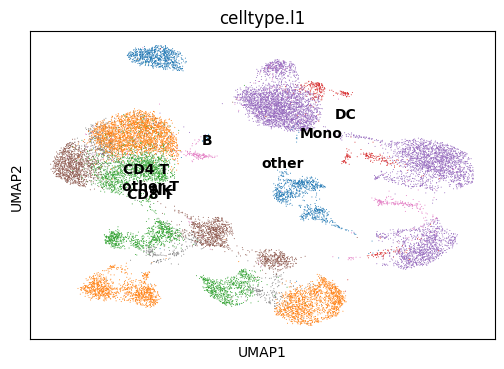

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


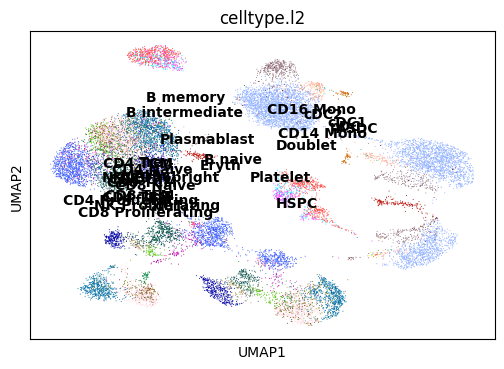

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


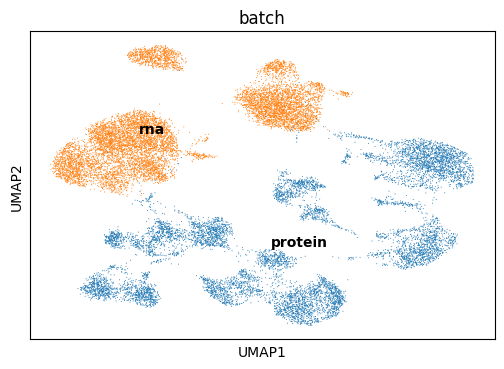

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


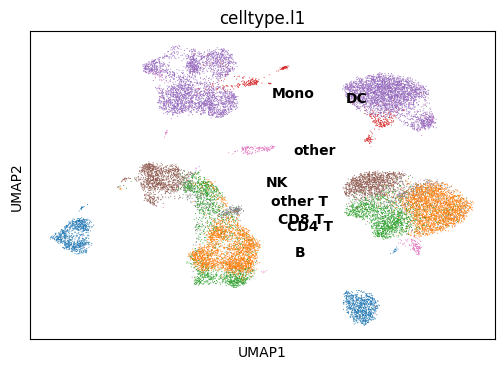

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


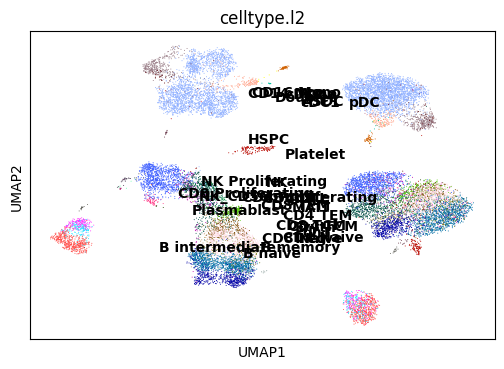

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


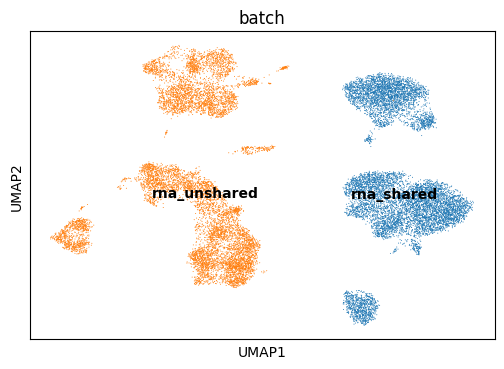

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


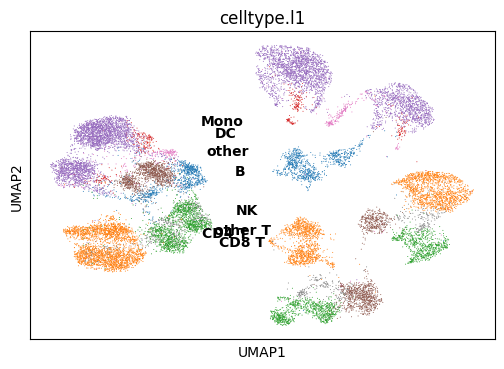

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


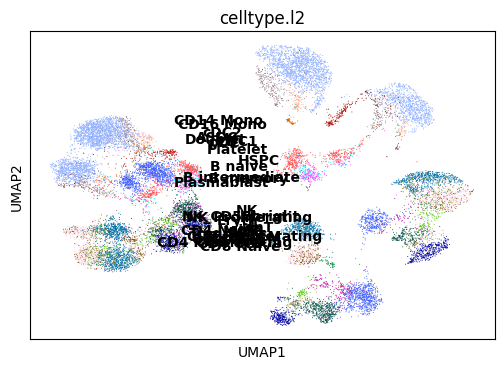

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


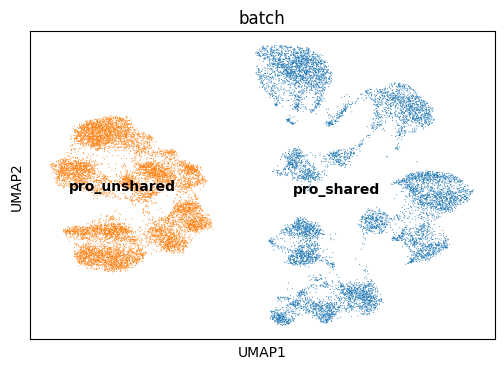

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For All matchings: lv1 matching acc: 0.379,
lv2 matching acc: 0.210.
For All matchings: FOSCTTM score: 0.39135275, 
Knn Alignment score: [0.0007 0.0015 0.0021 0.0025 0.0028 0.0035 0.0042 0.0046 0.0053 0.0058
 0.0067 0.0075 0.008  0.0087 0.0094 0.0097 0.0105 0.0106 0.0109 0.0115
 0.0119 0.0124 0.0129 0.0134 0.0141]
For All matchings: Silhouette F1 score for lv1: 0.43493502929570055, 
Silhouette F1 score for lv2: 0.420750526190134



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  5.017562389373779
Matchings are reduced to 5000 after filtering...


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:423: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[matchings[0]], labels_l1[matchings[1]])
C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For only filtered matchings: lv1 matching acc: 0.425,
lv2 matching acc: 0.245.



Matches are being propagated....


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:460: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[filtered_matchings[0]], labels_l1[filtered_matchings[1]])
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scipy\sparse\_index.py:143: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


Done!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For all matchings after propagation: lv1 matching acc: 0.520,
lv2 matching acc: 0.340.


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:495: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[propagated_matchings[0]], labels_l1[propagated_matchings[1]])


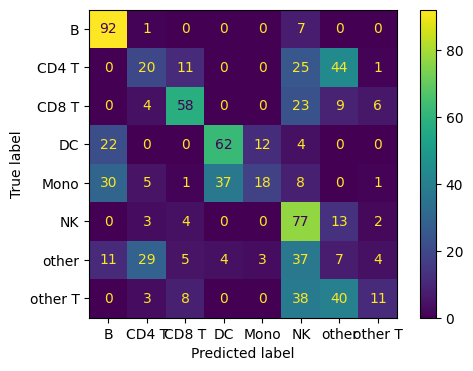

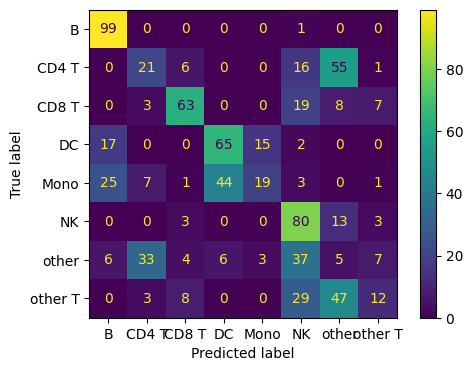

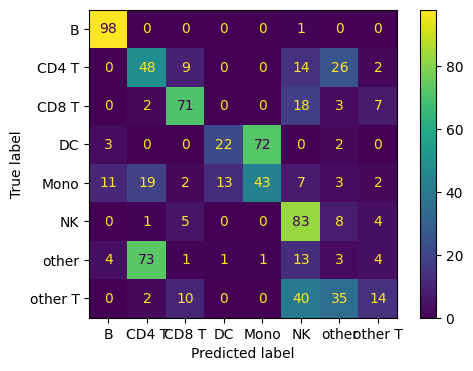

Epoch: 101: 0it [00:00, ?it/s]C:\Users\vinee\AppData\Local\Temp\ipykernel_2144\3129631169.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return {"x_unshared":self.unshared_data[idx], "x_shared":self.shared_data[idx], "l1":self.labels_l1[idx], "l2":self.labels_l2[idx], "mean": self.local_mean[idx], "var": self.local_var[idx], "batch": self.batch[idx]}
Epoch: 101: 40it [00:11,  3.36it/s]


RNA Recon Loss: 2.1660, RNA KL Div L: 0.0155, RNA KL Div Z: 0.4600, Protein Recon Loss: 0.5024, Protein KL Div Back Pro: 0.9375, Protein KL Div Z: 0.7180, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6567, Shared Recon Loss Gene: 0.2787, Shared Recon Loss Protein: 1.8601 Cross Loss Protein: 0.5490


Epoch: 102: 40it [00:11,  3.38it/s]


RNA Recon Loss: 2.1551, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4551, Protein Recon Loss: 0.5018, Protein KL Div Back Pro: 0.9315, Protein KL Div Z: 0.7211, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6563, Shared Recon Loss Gene: 0.2781, Shared Recon Loss Protein: 1.8637 Cross Loss Protein: 0.5504


Epoch: 103: 40it [00:11,  3.38it/s]


RNA Recon Loss: 2.1603, RNA KL Div L: 0.0156, RNA KL Div Z: 0.4572, Protein Recon Loss: 0.5020, Protein KL Div Back Pro: 0.9300, Protein KL Div Z: 0.7207, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6549, Shared Recon Loss Gene: 0.2773, Shared Recon Loss Protein: 1.8617 Cross Loss Protein: 0.5495


Epoch: 104: 40it [00:11,  3.41it/s]


RNA Recon Loss: 2.1529, RNA KL Div L: 0.0153, RNA KL Div Z: 0.4573, Protein Recon Loss: 0.5011, Protein KL Div Back Pro: 0.9299, Protein KL Div Z: 0.7223, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6550, Shared Recon Loss Gene: 0.2777, Shared Recon Loss Protein: 1.8607 Cross Loss Protein: 0.5498


Epoch: 105: 40it [00:11,  3.39it/s]


RNA Recon Loss: 2.1803, RNA KL Div L: 0.0158, RNA KL Div Z: 0.4577, Protein Recon Loss: 0.5021, Protein KL Div Back Pro: 0.9356, Protein KL Div Z: 0.7245, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6547, Shared Recon Loss Gene: 0.2776, Shared Recon Loss Protein: 1.8597 Cross Loss Protein: 0.5488


Epoch: 106: 40it [00:11,  3.40it/s]


RNA Recon Loss: 2.1613, RNA KL Div L: 0.0157, RNA KL Div Z: 0.4656, Protein Recon Loss: 0.5044, Protein KL Div Back Pro: 0.9356, Protein KL Div Z: 0.7207, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6556, Shared Recon Loss Gene: 0.2772, Shared Recon Loss Protein: 1.8571 Cross Loss Protein: 0.5494


Epoch: 107: 40it [00:11,  3.38it/s]


RNA Recon Loss: 2.1540, RNA KL Div L: 0.0153, RNA KL Div Z: 0.4599, Protein Recon Loss: 0.5026, Protein KL Div Back Pro: 0.9333, Protein KL Div Z: 0.7211, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6533, Shared Recon Loss Gene: 0.2778, Shared Recon Loss Protein: 1.8610 Cross Loss Protein: 0.5510


Epoch: 108: 40it [00:12,  3.18it/s]


RNA Recon Loss: 2.1632, RNA KL Div L: 0.0163, RNA KL Div Z: 0.4606, Protein Recon Loss: 0.5023, Protein KL Div Back Pro: 0.9322, Protein KL Div Z: 0.7200, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6544, Shared Recon Loss Gene: 0.2767, Shared Recon Loss Protein: 1.8587 Cross Loss Protein: 0.5503


Epoch: 109: 40it [00:15,  2.65it/s]


RNA Recon Loss: 2.1646, RNA KL Div L: 0.0153, RNA KL Div Z: 0.4666, Protein Recon Loss: 0.5002, Protein KL Div Back Pro: 0.9334, Protein KL Div Z: 0.7237, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6533, Shared Recon Loss Gene: 0.2772, Shared Recon Loss Protein: 1.8554 Cross Loss Protein: 0.5482


Epoch: 110: 40it [00:14,  2.83it/s]


RNA Recon Loss: 2.1608, RNA KL Div L: 0.0169, RNA KL Div Z: 0.4624, Protein Recon Loss: 0.5018, Protein KL Div Back Pro: 0.9348, Protein KL Div Z: 0.7253, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6541, Shared Recon Loss Gene: 0.2749, Shared Recon Loss Protein: 1.8592 Cross Loss Protein: 0.5490


Epoch: 111: 40it [00:12,  3.08it/s]


RNA Recon Loss: 2.1682, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4656, Protein Recon Loss: 0.5014, Protein KL Div Back Pro: 0.9324, Protein KL Div Z: 0.7216, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6533, Shared Recon Loss Gene: 0.2762, Shared Recon Loss Protein: 1.8560 Cross Loss Protein: 0.5490


Epoch: 112: 40it [00:14,  2.79it/s]


RNA Recon Loss: 2.1591, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4664, Protein Recon Loss: 0.4995, Protein KL Div Back Pro: 0.9309, Protein KL Div Z: 0.7220, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6528, Shared Recon Loss Gene: 0.2765, Shared Recon Loss Protein: 1.8530 Cross Loss Protein: 0.5478


Epoch: 113: 40it [00:14,  2.82it/s]


RNA Recon Loss: 2.1567, RNA KL Div L: 0.0157, RNA KL Div Z: 0.4677, Protein Recon Loss: 0.5021, Protein KL Div Back Pro: 0.9265, Protein KL Div Z: 0.7228, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6512, Shared Recon Loss Gene: 0.2768, Shared Recon Loss Protein: 1.8599 Cross Loss Protein: 0.5508


Epoch: 114: 40it [00:11,  3.38it/s]


RNA Recon Loss: 2.1459, RNA KL Div L: 0.0154, RNA KL Div Z: 0.4663, Protein Recon Loss: 0.4999, Protein KL Div Back Pro: 0.9288, Protein KL Div Z: 0.7242, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6527, Shared Recon Loss Gene: 0.2756, Shared Recon Loss Protein: 1.8563 Cross Loss Protein: 0.5493


Epoch: 115: 40it [00:11,  3.38it/s]


RNA Recon Loss: 2.1469, RNA KL Div L: 0.0153, RNA KL Div Z: 0.4676, Protein Recon Loss: 0.4992, Protein KL Div Back Pro: 0.9211, Protein KL Div Z: 0.7249, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6509, Shared Recon Loss Gene: 0.2760, Shared Recon Loss Protein: 1.8540 Cross Loss Protein: 0.5491


Epoch: 116: 40it [00:11,  3.40it/s]


RNA Recon Loss: 2.1447, RNA KL Div L: 0.0161, RNA KL Div Z: 0.4656, Protein Recon Loss: 0.5008, Protein KL Div Back Pro: 0.9255, Protein KL Div Z: 0.7237, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6507, Shared Recon Loss Gene: 0.2753, Shared Recon Loss Protein: 1.8537 Cross Loss Protein: 0.5489


Epoch: 117: 40it [00:11,  3.40it/s]


RNA Recon Loss: 2.1438, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4641, Protein Recon Loss: 0.5013, Protein KL Div Back Pro: 0.9285, Protein KL Div Z: 0.7233, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6502, Shared Recon Loss Gene: 0.2760, Shared Recon Loss Protein: 1.8566 Cross Loss Protein: 0.5497


Epoch: 118: 40it [00:11,  3.46it/s]


RNA Recon Loss: 2.1372, RNA KL Div L: 0.0159, RNA KL Div Z: 0.4658, Protein Recon Loss: 0.5000, Protein KL Div Back Pro: 0.9254, Protein KL Div Z: 0.7213, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6503, Shared Recon Loss Gene: 0.2746, Shared Recon Loss Protein: 1.8506 Cross Loss Protein: 0.5487


Epoch: 119: 40it [00:11,  3.43it/s]


RNA Recon Loss: 2.1444, RNA KL Div L: 0.0155, RNA KL Div Z: 0.4637, Protein Recon Loss: 0.5014, Protein KL Div Back Pro: 0.9234, Protein KL Div Z: 0.7226, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6485, Shared Recon Loss Gene: 0.2752, Shared Recon Loss Protein: 1.8594 Cross Loss Protein: 0.5509


Epoch: 120: 40it [00:11,  3.45it/s]


RNA Recon Loss: 2.1461, RNA KL Div L: 0.0161, RNA KL Div Z: 0.4685, Protein Recon Loss: 0.5026, Protein KL Div Back Pro: 0.9326, Protein KL Div Z: 0.7214, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6490, Shared Recon Loss Gene: 0.2787, Shared Recon Loss Protein: 1.8639 Cross Loss Protein: 0.5526


Epoch: 121: 40it [00:11,  3.46it/s]


RNA Recon Loss: 2.1403, RNA KL Div L: 0.0154, RNA KL Div Z: 0.4684, Protein Recon Loss: 0.5024, Protein KL Div Back Pro: 0.9323, Protein KL Div Z: 0.7204, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6484, Shared Recon Loss Gene: 0.2758, Shared Recon Loss Protein: 1.8577 Cross Loss Protein: 0.5522


Epoch: 122: 40it [00:11,  3.47it/s]


RNA Recon Loss: 2.1363, RNA KL Div L: 0.0154, RNA KL Div Z: 0.4672, Protein Recon Loss: 0.5005, Protein KL Div Back Pro: 0.9293, Protein KL Div Z: 0.7194, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6468, Shared Recon Loss Gene: 0.2752, Shared Recon Loss Protein: 1.8497 Cross Loss Protein: 0.5484


Epoch: 123: 40it [00:11,  3.44it/s]


RNA Recon Loss: 2.1368, RNA KL Div L: 0.0157, RNA KL Div Z: 0.4657, Protein Recon Loss: 0.4987, Protein KL Div Back Pro: 0.9276, Protein KL Div Z: 0.7196, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6462, Shared Recon Loss Gene: 0.2740, Shared Recon Loss Protein: 1.8499 Cross Loss Protein: 0.5479


Epoch: 124: 40it [00:11,  3.42it/s]


RNA Recon Loss: 2.1324, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4673, Protein Recon Loss: 0.5021, Protein KL Div Back Pro: 0.9299, Protein KL Div Z: 0.7182, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6474, Shared Recon Loss Gene: 0.2747, Shared Recon Loss Protein: 1.8500 Cross Loss Protein: 0.5489


Epoch: 125: 40it [00:11,  3.44it/s]


RNA Recon Loss: 2.1322, RNA KL Div L: 0.0154, RNA KL Div Z: 0.4676, Protein Recon Loss: 0.4993, Protein KL Div Back Pro: 0.9232, Protein KL Div Z: 0.7160, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6449, Shared Recon Loss Gene: 0.2744, Shared Recon Loss Protein: 1.8480 Cross Loss Protein: 0.5475


Epoch: 126: 40it [00:11,  3.46it/s]


RNA Recon Loss: 2.1285, RNA KL Div L: 0.0157, RNA KL Div Z: 0.4682, Protein Recon Loss: 0.4998, Protein KL Div Back Pro: 0.9265, Protein KL Div Z: 0.7153, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6429, Shared Recon Loss Gene: 0.2742, Shared Recon Loss Protein: 1.8525 Cross Loss Protein: 0.5490


Epoch: 127: 40it [00:11,  3.43it/s]


RNA Recon Loss: 2.1321, RNA KL Div L: 0.0152, RNA KL Div Z: 0.4688, Protein Recon Loss: 0.5010, Protein KL Div Back Pro: 0.9177, Protein KL Div Z: 0.7158, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6454, Shared Recon Loss Gene: 0.2747, Shared Recon Loss Protein: 1.8540 Cross Loss Protein: 0.5494


Epoch: 128: 40it [00:11,  3.43it/s]


RNA Recon Loss: 2.1334, RNA KL Div L: 0.0154, RNA KL Div Z: 0.4684, Protein Recon Loss: 0.5053, Protein KL Div Back Pro: 0.9184, Protein KL Div Z: 0.7142, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6450, Shared Recon Loss Gene: 0.2748, Shared Recon Loss Protein: 1.8532 Cross Loss Protein: 0.5497


Epoch: 129: 40it [00:11,  3.43it/s]


RNA Recon Loss: 2.1291, RNA KL Div L: 0.0155, RNA KL Div Z: 0.4665, Protein Recon Loss: 0.4990, Protein KL Div Back Pro: 0.9147, Protein KL Div Z: 0.7120, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6429, Shared Recon Loss Gene: 0.2746, Shared Recon Loss Protein: 1.8483 Cross Loss Protein: 0.5478


Epoch: 130: 40it [00:11,  3.39it/s]


RNA Recon Loss: 2.1224, RNA KL Div L: 0.0153, RNA KL Div Z: 0.4706, Protein Recon Loss: 0.4993, Protein KL Div Back Pro: 0.9182, Protein KL Div Z: 0.7126, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6422, Shared Recon Loss Gene: 0.2731, Shared Recon Loss Protein: 1.8491 Cross Loss Protein: 0.5481


Epoch: 131: 40it [00:11,  3.46it/s]


RNA Recon Loss: 2.1345, RNA KL Div L: 0.0153, RNA KL Div Z: 0.4705, Protein Recon Loss: 0.4996, Protein KL Div Back Pro: 0.9206, Protein KL Div Z: 0.7156, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6434, Shared Recon Loss Gene: 0.2743, Shared Recon Loss Protein: 1.8478 Cross Loss Protein: 0.5494


Epoch: 132: 40it [00:11,  3.44it/s]


RNA Recon Loss: 2.1411, RNA KL Div L: 0.0158, RNA KL Div Z: 0.4706, Protein Recon Loss: 0.4993, Protein KL Div Back Pro: 0.9222, Protein KL Div Z: 0.7145, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6402, Shared Recon Loss Gene: 0.2742, Shared Recon Loss Protein: 1.8446 Cross Loss Protein: 0.5471


Epoch: 133: 40it [00:12,  3.29it/s]


RNA Recon Loss: 2.1262, RNA KL Div L: 0.0157, RNA KL Div Z: 0.4729, Protein Recon Loss: 0.5023, Protein KL Div Back Pro: 0.9176, Protein KL Div Z: 0.7097, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6412, Shared Recon Loss Gene: 0.2732, Shared Recon Loss Protein: 1.8457 Cross Loss Protein: 0.5487


Epoch: 134: 40it [00:11,  3.48it/s]


RNA Recon Loss: 2.1219, RNA KL Div L: 0.0154, RNA KL Div Z: 0.4683, Protein Recon Loss: 0.4977, Protein KL Div Back Pro: 0.9163, Protein KL Div Z: 0.7121, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6415, Shared Recon Loss Gene: 0.2727, Shared Recon Loss Protein: 1.8432 Cross Loss Protein: 0.5472


Epoch: 135: 40it [00:11,  3.44it/s]


RNA Recon Loss: 2.1234, RNA KL Div L: 0.0154, RNA KL Div Z: 0.4678, Protein Recon Loss: 0.4992, Protein KL Div Back Pro: 0.9207, Protein KL Div Z: 0.7134, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6401, Shared Recon Loss Gene: 0.2725, Shared Recon Loss Protein: 1.8460 Cross Loss Protein: 0.5477


Epoch: 136: 40it [00:11,  3.41it/s]


RNA Recon Loss: 2.1222, RNA KL Div L: 0.0155, RNA KL Div Z: 0.4676, Protein Recon Loss: 0.4979, Protein KL Div Back Pro: 0.9173, Protein KL Div Z: 0.7153, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6419, Shared Recon Loss Gene: 0.2727, Shared Recon Loss Protein: 1.8457 Cross Loss Protein: 0.5486


Epoch: 137: 40it [00:11,  3.46it/s]


RNA Recon Loss: 2.1270, RNA KL Div L: 0.0156, RNA KL Div Z: 0.4672, Protein Recon Loss: 0.4987, Protein KL Div Back Pro: 0.9131, Protein KL Div Z: 0.7136, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6409, Shared Recon Loss Gene: 0.2733, Shared Recon Loss Protein: 1.8397 Cross Loss Protein: 0.5473


Epoch: 138: 40it [00:11,  3.44it/s]


RNA Recon Loss: 2.1289, RNA KL Div L: 0.0156, RNA KL Div Z: 0.4675, Protein Recon Loss: 0.5034, Protein KL Div Back Pro: 0.9129, Protein KL Div Z: 0.7104, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6393, Shared Recon Loss Gene: 0.2739, Shared Recon Loss Protein: 1.8469 Cross Loss Protein: 0.5497


Epoch: 139: 40it [00:11,  3.45it/s]


RNA Recon Loss: 2.1338, RNA KL Div L: 0.0159, RNA KL Div Z: 0.4693, Protein Recon Loss: 0.4975, Protein KL Div Back Pro: 0.9145, Protein KL Div Z: 0.7094, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6404, Shared Recon Loss Gene: 0.2725, Shared Recon Loss Protein: 1.8413 Cross Loss Protein: 0.5467


Epoch: 140: 40it [00:11,  3.46it/s]


RNA Recon Loss: 2.1325, RNA KL Div L: 0.0161, RNA KL Div Z: 0.4755, Protein Recon Loss: 0.4981, Protein KL Div Back Pro: 0.9138, Protein KL Div Z: 0.7128, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6393, Shared Recon Loss Gene: 0.2735, Shared Recon Loss Protein: 1.8412 Cross Loss Protein: 0.5465


Epoch: 141: 40it [00:11,  3.43it/s]


RNA Recon Loss: 2.1300, RNA KL Div L: 0.0159, RNA KL Div Z: 0.4724, Protein Recon Loss: 0.4989, Protein KL Div Back Pro: 0.9119, Protein KL Div Z: 0.7113, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6401, Shared Recon Loss Gene: 0.2731, Shared Recon Loss Protein: 1.8428 Cross Loss Protein: 0.5479


Epoch: 142: 40it [00:11,  3.49it/s]


RNA Recon Loss: 2.1262, RNA KL Div L: 0.0157, RNA KL Div Z: 0.4726, Protein Recon Loss: 0.4989, Protein KL Div Back Pro: 0.9177, Protein KL Div Z: 0.7131, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6402, Shared Recon Loss Gene: 0.2721, Shared Recon Loss Protein: 1.8418 Cross Loss Protein: 0.5475


Epoch: 143: 40it [00:11,  3.50it/s]


RNA Recon Loss: 2.1261, RNA KL Div L: 0.0157, RNA KL Div Z: 0.4727, Protein Recon Loss: 0.4989, Protein KL Div Back Pro: 0.9106, Protein KL Div Z: 0.7111, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6399, Shared Recon Loss Gene: 0.2728, Shared Recon Loss Protein: 1.8432 Cross Loss Protein: 0.5479


Epoch: 144: 40it [00:11,  3.44it/s]


RNA Recon Loss: 2.1161, RNA KL Div L: 0.0162, RNA KL Div Z: 0.4763, Protein Recon Loss: 0.5005, Protein KL Div Back Pro: 0.9076, Protein KL Div Z: 0.7129, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6353, Shared Recon Loss Gene: 0.2730, Shared Recon Loss Protein: 1.8499 Cross Loss Protein: 0.5510


Epoch: 145: 40it [00:11,  3.39it/s]


RNA Recon Loss: 2.1255, RNA KL Div L: 0.0155, RNA KL Div Z: 0.4739, Protein Recon Loss: 0.4992, Protein KL Div Back Pro: 0.9069, Protein KL Div Z: 0.7097, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6363, Shared Recon Loss Gene: 0.2727, Shared Recon Loss Protein: 1.8455 Cross Loss Protein: 0.5476


Epoch: 146: 40it [00:11,  3.45it/s]


RNA Recon Loss: 2.1227, RNA KL Div L: 0.0158, RNA KL Div Z: 0.4739, Protein Recon Loss: 0.4985, Protein KL Div Back Pro: 0.9192, Protein KL Div Z: 0.7097, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6390, Shared Recon Loss Gene: 0.2748, Shared Recon Loss Protein: 1.8475 Cross Loss Protein: 0.5492


Epoch: 147: 40it [00:11,  3.37it/s]


RNA Recon Loss: 2.1237, RNA KL Div L: 0.0155, RNA KL Div Z: 0.4707, Protein Recon Loss: 0.4990, Protein KL Div Back Pro: 0.9169, Protein KL Div Z: 0.7103, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6359, Shared Recon Loss Gene: 0.2720, Shared Recon Loss Protein: 1.8381 Cross Loss Protein: 0.5476


Epoch: 148: 40it [00:11,  3.43it/s]


RNA Recon Loss: 2.1261, RNA KL Div L: 0.0156, RNA KL Div Z: 0.4743, Protein Recon Loss: 0.4999, Protein KL Div Back Pro: 0.9165, Protein KL Div Z: 0.7088, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6357, Shared Recon Loss Gene: 0.2727, Shared Recon Loss Protein: 1.8409 Cross Loss Protein: 0.5475


Epoch: 149: 40it [00:12,  3.31it/s]


RNA Recon Loss: 2.1346, RNA KL Div L: 0.0159, RNA KL Div Z: 0.4760, Protein Recon Loss: 0.4990, Protein KL Div Back Pro: 0.9114, Protein KL Div Z: 0.7054, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6346, Shared Recon Loss Gene: 0.2736, Shared Recon Loss Protein: 1.8385 Cross Loss Protein: 0.5469


Epoch: 150: 40it [00:12,  3.31it/s]


RNA Recon Loss: 2.1262, RNA KL Div L: 0.0155, RNA KL Div Z: 0.4730, Protein Recon Loss: 0.5012, Protein KL Div Back Pro: 0.9124, Protein KL Div Z: 0.7056, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6328, Shared Recon Loss Gene: 0.2739, Shared Recon Loss Protein: 1.8431 Cross Loss Protein: 0.5486


Epoch: 151: 40it [00:11,  3.47it/s]


RNA Recon Loss: 2.1153, RNA KL Div L: 0.0156, RNA KL Div Z: 0.4736, Protein Recon Loss: 0.4998, Protein KL Div Back Pro: 0.9080, Protein KL Div Z: 0.7064, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6336, Shared Recon Loss Gene: 0.2711, Shared Recon Loss Protein: 1.8365 Cross Loss Protein: 0.5474


Epoch: 152: 40it [00:11,  3.43it/s]


RNA Recon Loss: 2.1185, RNA KL Div L: 0.0167, RNA KL Div Z: 0.4723, Protein Recon Loss: 0.4984, Protein KL Div Back Pro: 0.9039, Protein KL Div Z: 0.7045, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6323, Shared Recon Loss Gene: 0.2709, Shared Recon Loss Protein: 1.8388 Cross Loss Protein: 0.5468


Epoch: 153: 40it [00:11,  3.48it/s]


RNA Recon Loss: 2.1323, RNA KL Div L: 0.0154, RNA KL Div Z: 0.4731, Protein Recon Loss: 0.4982, Protein KL Div Back Pro: 0.9094, Protein KL Div Z: 0.7053, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6355, Shared Recon Loss Gene: 0.2722, Shared Recon Loss Protein: 1.8367 Cross Loss Protein: 0.5467


Epoch: 154: 40it [00:11,  3.45it/s]


RNA Recon Loss: 2.1129, RNA KL Div L: 0.0153, RNA KL Div Z: 0.4763, Protein Recon Loss: 0.4983, Protein KL Div Back Pro: 0.9092, Protein KL Div Z: 0.7051, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6349, Shared Recon Loss Gene: 0.2714, Shared Recon Loss Protein: 1.8382 Cross Loss Protein: 0.5466


Epoch: 155: 40it [00:11,  3.47it/s]


RNA Recon Loss: 2.1127, RNA KL Div L: 0.0157, RNA KL Div Z: 0.4750, Protein Recon Loss: 0.4986, Protein KL Div Back Pro: 0.9090, Protein KL Div Z: 0.7054, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6361, Shared Recon Loss Gene: 0.2719, Shared Recon Loss Protein: 1.8406 Cross Loss Protein: 0.5483


Epoch: 156: 40it [00:11,  3.35it/s]


RNA Recon Loss: 2.1163, RNA KL Div L: 0.0157, RNA KL Div Z: 0.4767, Protein Recon Loss: 0.4982, Protein KL Div Back Pro: 0.9097, Protein KL Div Z: 0.7045, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6327, Shared Recon Loss Gene: 0.2713, Shared Recon Loss Protein: 1.8354 Cross Loss Protein: 0.5467


Epoch: 157: 40it [00:12,  3.16it/s]


RNA Recon Loss: 2.1186, RNA KL Div L: 0.0157, RNA KL Div Z: 0.4728, Protein Recon Loss: 0.4977, Protein KL Div Back Pro: 0.9060, Protein KL Div Z: 0.7042, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6324, Shared Recon Loss Gene: 0.2715, Shared Recon Loss Protein: 1.8359 Cross Loss Protein: 0.5475


Epoch: 158: 40it [00:12,  3.17it/s]


RNA Recon Loss: 2.1112, RNA KL Div L: 0.0155, RNA KL Div Z: 0.4754, Protein Recon Loss: 0.4978, Protein KL Div Back Pro: 0.9051, Protein KL Div Z: 0.7062, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6325, Shared Recon Loss Gene: 0.2715, Shared Recon Loss Protein: 1.8388 Cross Loss Protein: 0.5470


Epoch: 159: 40it [00:12,  3.22it/s]


RNA Recon Loss: 2.1057, RNA KL Div L: 0.0159, RNA KL Div Z: 0.4724, Protein Recon Loss: 0.4989, Protein KL Div Back Pro: 0.9037, Protein KL Div Z: 0.7027, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6290, Shared Recon Loss Gene: 0.2728, Shared Recon Loss Protein: 1.8433 Cross Loss Protein: 0.5496


Epoch: 160: 40it [00:12,  3.10it/s]


RNA Recon Loss: 2.1072, RNA KL Div L: 0.0155, RNA KL Div Z: 0.4766, Protein Recon Loss: 0.4972, Protein KL Div Back Pro: 0.9050, Protein KL Div Z: 0.7032, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6318, Shared Recon Loss Gene: 0.2713, Shared Recon Loss Protein: 1.8355 Cross Loss Protein: 0.5469


Epoch: 161: 40it [00:12,  3.28it/s]


RNA Recon Loss: 2.1019, RNA KL Div L: 0.0157, RNA KL Div Z: 0.4748, Protein Recon Loss: 0.4975, Protein KL Div Back Pro: 0.9057, Protein KL Div Z: 0.7042, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6306, Shared Recon Loss Gene: 0.2708, Shared Recon Loss Protein: 1.8333 Cross Loss Protein: 0.5467


Epoch: 162: 40it [00:12,  3.28it/s]


RNA Recon Loss: 2.1041, RNA KL Div L: 0.0153, RNA KL Div Z: 0.4749, Protein Recon Loss: 0.4990, Protein KL Div Back Pro: 0.8996, Protein KL Div Z: 0.7027, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6318, Shared Recon Loss Gene: 0.2711, Shared Recon Loss Protein: 1.8350 Cross Loss Protein: 0.5469


Epoch: 163: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.1077, RNA KL Div L: 0.0154, RNA KL Div Z: 0.4745, Protein Recon Loss: 0.4969, Protein KL Div Back Pro: 0.9033, Protein KL Div Z: 0.7011, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6299, Shared Recon Loss Gene: 0.2710, Shared Recon Loss Protein: 1.8365 Cross Loss Protein: 0.5470


Epoch: 164: 40it [00:12,  3.19it/s]


RNA Recon Loss: 2.1104, RNA KL Div L: 0.0157, RNA KL Div Z: 0.4750, Protein Recon Loss: 0.4968, Protein KL Div Back Pro: 0.9066, Protein KL Div Z: 0.7028, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6316, Shared Recon Loss Gene: 0.2708, Shared Recon Loss Protein: 1.8319 Cross Loss Protein: 0.5461


Epoch: 165: 40it [00:12,  3.23it/s]


RNA Recon Loss: 2.1043, RNA KL Div L: 0.0157, RNA KL Div Z: 0.4739, Protein Recon Loss: 0.4997, Protein KL Div Back Pro: 0.9046, Protein KL Div Z: 0.6987, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6291, Shared Recon Loss Gene: 0.2707, Shared Recon Loss Protein: 1.8322 Cross Loss Protein: 0.5470


Epoch: 166: 40it [00:12,  3.18it/s]


RNA Recon Loss: 2.1028, RNA KL Div L: 0.0160, RNA KL Div Z: 0.4735, Protein Recon Loss: 0.4977, Protein KL Div Back Pro: 0.9082, Protein KL Div Z: 0.7005, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6306, Shared Recon Loss Gene: 0.2700, Shared Recon Loss Protein: 1.8353 Cross Loss Protein: 0.5474


Epoch: 167: 40it [00:12,  3.11it/s]


RNA Recon Loss: 2.1123, RNA KL Div L: 0.0156, RNA KL Div Z: 0.4750, Protein Recon Loss: 0.4977, Protein KL Div Back Pro: 0.9095, Protein KL Div Z: 0.6996, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6313, Shared Recon Loss Gene: 0.2711, Shared Recon Loss Protein: 1.8319 Cross Loss Protein: 0.5466


Epoch: 168: 40it [00:12,  3.14it/s]


RNA Recon Loss: 2.1123, RNA KL Div L: 0.0163, RNA KL Div Z: 0.4748, Protein Recon Loss: 0.4973, Protein KL Div Back Pro: 0.9051, Protein KL Div Z: 0.7005, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6283, Shared Recon Loss Gene: 0.2698, Shared Recon Loss Protein: 1.8324 Cross Loss Protein: 0.5464


Epoch: 169: 40it [00:13,  2.95it/s]


RNA Recon Loss: 2.1212, RNA KL Div L: 0.0153, RNA KL Div Z: 0.4793, Protein Recon Loss: 0.4997, Protein KL Div Back Pro: 0.9050, Protein KL Div Z: 0.6972, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6275, Shared Recon Loss Gene: 0.2704, Shared Recon Loss Protein: 1.8313 Cross Loss Protein: 0.5464


Epoch: 170: 40it [00:13,  3.00it/s]


RNA Recon Loss: 2.1021, RNA KL Div L: 0.0157, RNA KL Div Z: 0.4793, Protein Recon Loss: 0.4988, Protein KL Div Back Pro: 0.9043, Protein KL Div Z: 0.6984, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6291, Shared Recon Loss Gene: 0.2695, Shared Recon Loss Protein: 1.8303 Cross Loss Protein: 0.5467


Epoch: 171: 40it [00:12,  3.17it/s]


RNA Recon Loss: 2.1177, RNA KL Div L: 0.0157, RNA KL Div Z: 0.4777, Protein Recon Loss: 0.5003, Protein KL Div Back Pro: 0.8985, Protein KL Div Z: 0.6921, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6263, Shared Recon Loss Gene: 0.2719, Shared Recon Loss Protein: 1.8381 Cross Loss Protein: 0.5483


Epoch: 172: 40it [00:14,  2.78it/s]


RNA Recon Loss: 2.1100, RNA KL Div L: 0.0160, RNA KL Div Z: 0.4819, Protein Recon Loss: 0.4975, Protein KL Div Back Pro: 0.9000, Protein KL Div Z: 0.6934, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0220, Shared KL Div Z: 0.6285, Shared Recon Loss Gene: 0.2700, Shared Recon Loss Protein: 1.8329 Cross Loss Protein: 0.5479


Epoch: 173: 40it [00:12,  3.13it/s]


RNA Recon Loss: 2.1000, RNA KL Div L: 0.0163, RNA KL Div Z: 0.4791, Protein Recon Loss: 0.4965, Protein KL Div Back Pro: 0.9007, Protein KL Div Z: 0.6950, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6280, Shared Recon Loss Gene: 0.2691, Shared Recon Loss Protein: 1.8290 Cross Loss Protein: 0.5461


Epoch: 174: 40it [00:13,  3.01it/s]


RNA Recon Loss: 2.1050, RNA KL Div L: 0.0157, RNA KL Div Z: 0.4784, Protein Recon Loss: 0.4990, Protein KL Div Back Pro: 0.9015, Protein KL Div Z: 0.6960, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6271, Shared Recon Loss Gene: 0.2697, Shared Recon Loss Protein: 1.8397 Cross Loss Protein: 0.5478


Epoch: 175: 40it [00:12,  3.11it/s]


RNA Recon Loss: 2.1119, RNA KL Div L: 0.0164, RNA KL Div Z: 0.4747, Protein Recon Loss: 0.5025, Protein KL Div Back Pro: 0.9044, Protein KL Div Z: 0.6913, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6234, Shared Recon Loss Gene: 0.2724, Shared Recon Loss Protein: 1.8462 Cross Loss Protein: 0.5497


Epoch: 176: 40it [00:12,  3.21it/s]


RNA Recon Loss: 2.1262, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4730, Protein Recon Loss: 0.4972, Protein KL Div Back Pro: 0.8978, Protein KL Div Z: 0.6935, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6253, Shared Recon Loss Gene: 0.2720, Shared Recon Loss Protein: 1.8343 Cross Loss Protein: 0.5469


Epoch: 177: 40it [00:13,  2.99it/s]


RNA Recon Loss: 2.1110, RNA KL Div L: 0.0156, RNA KL Div Z: 0.4766, Protein Recon Loss: 0.4979, Protein KL Div Back Pro: 0.8936, Protein KL Div Z: 0.6953, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6226, Shared Recon Loss Gene: 0.2706, Shared Recon Loss Protein: 1.8360 Cross Loss Protein: 0.5472


Epoch: 178: 40it [00:12,  3.11it/s]


RNA Recon Loss: 2.0990, RNA KL Div L: 0.0155, RNA KL Div Z: 0.4770, Protein Recon Loss: 0.4967, Protein KL Div Back Pro: 0.8988, Protein KL Div Z: 0.6961, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6230, Shared Recon Loss Gene: 0.2711, Shared Recon Loss Protein: 1.8303 Cross Loss Protein: 0.5463


Epoch: 179: 40it [00:13,  2.97it/s]


RNA Recon Loss: 2.1018, RNA KL Div L: 0.0155, RNA KL Div Z: 0.4770, Protein Recon Loss: 0.4966, Protein KL Div Back Pro: 0.8948, Protein KL Div Z: 0.6936, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6233, Shared Recon Loss Gene: 0.2704, Shared Recon Loss Protein: 1.8292 Cross Loss Protein: 0.5458


Epoch: 180: 40it [00:12,  3.17it/s]


RNA Recon Loss: 2.0961, RNA KL Div L: 0.0159, RNA KL Div Z: 0.4759, Protein Recon Loss: 0.4971, Protein KL Div Back Pro: 0.9006, Protein KL Div Z: 0.6948, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6252, Shared Recon Loss Gene: 0.2698, Shared Recon Loss Protein: 1.8335 Cross Loss Protein: 0.5476


Epoch: 181: 40it [00:12,  3.32it/s]


RNA Recon Loss: 2.0990, RNA KL Div L: 0.0153, RNA KL Div Z: 0.4750, Protein Recon Loss: 0.4959, Protein KL Div Back Pro: 0.9019, Protein KL Div Z: 0.6962, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6256, Shared Recon Loss Gene: 0.2702, Shared Recon Loss Protein: 1.8281 Cross Loss Protein: 0.5457


Epoch: 182: 40it [00:12,  3.29it/s]


RNA Recon Loss: 2.0972, RNA KL Div L: 0.0155, RNA KL Div Z: 0.4773, Protein Recon Loss: 0.5006, Protein KL Div Back Pro: 0.8931, Protein KL Div Z: 0.6906, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6234, Shared Recon Loss Gene: 0.2695, Shared Recon Loss Protein: 1.8294 Cross Loss Protein: 0.5473


Epoch: 183: 40it [00:12,  3.32it/s]


RNA Recon Loss: 2.1052, RNA KL Div L: 0.0155, RNA KL Div Z: 0.4748, Protein Recon Loss: 0.4966, Protein KL Div Back Pro: 0.8936, Protein KL Div Z: 0.6916, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6229, Shared Recon Loss Gene: 0.2704, Shared Recon Loss Protein: 1.8308 Cross Loss Protein: 0.5460


Epoch: 184: 40it [00:12,  3.32it/s]


RNA Recon Loss: 2.1055, RNA KL Div L: 0.0158, RNA KL Div Z: 0.4739, Protein Recon Loss: 0.4964, Protein KL Div Back Pro: 0.8963, Protein KL Div Z: 0.6909, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6220, Shared Recon Loss Gene: 0.2706, Shared Recon Loss Protein: 1.8271 Cross Loss Protein: 0.5456


Epoch: 185: 40it [00:12,  3.32it/s]


RNA Recon Loss: 2.0981, RNA KL Div L: 0.0155, RNA KL Div Z: 0.4744, Protein Recon Loss: 0.4970, Protein KL Div Back Pro: 0.8984, Protein KL Div Z: 0.6929, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6217, Shared Recon Loss Gene: 0.2697, Shared Recon Loss Protein: 1.8309 Cross Loss Protein: 0.5463


Epoch: 186: 40it [00:11,  3.35it/s]


RNA Recon Loss: 2.0942, RNA KL Div L: 0.0154, RNA KL Div Z: 0.4740, Protein Recon Loss: 0.4988, Protein KL Div Back Pro: 0.9024, Protein KL Div Z: 0.6908, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6212, Shared Recon Loss Gene: 0.2692, Shared Recon Loss Protein: 1.8320 Cross Loss Protein: 0.5465


Epoch: 187: 40it [00:12,  3.30it/s]


RNA Recon Loss: 2.0945, RNA KL Div L: 0.0157, RNA KL Div Z: 0.4747, Protein Recon Loss: 0.4958, Protein KL Div Back Pro: 0.8904, Protein KL Div Z: 0.6880, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6199, Shared Recon Loss Gene: 0.2694, Shared Recon Loss Protein: 1.8268 Cross Loss Protein: 0.5452


Epoch: 188: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.0947, RNA KL Div L: 0.0156, RNA KL Div Z: 0.4740, Protein Recon Loss: 0.4971, Protein KL Div Back Pro: 0.8948, Protein KL Div Z: 0.6886, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6188, Shared Recon Loss Gene: 0.2686, Shared Recon Loss Protein: 1.8305 Cross Loss Protein: 0.5472


Epoch: 189: 40it [00:12,  3.12it/s]


RNA Recon Loss: 2.0947, RNA KL Div L: 0.0157, RNA KL Div Z: 0.4736, Protein Recon Loss: 0.4966, Protein KL Div Back Pro: 0.8971, Protein KL Div Z: 0.6896, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6204, Shared Recon Loss Gene: 0.2688, Shared Recon Loss Protein: 1.8282 Cross Loss Protein: 0.5459


Epoch: 190: 40it [00:12,  3.20it/s]


RNA Recon Loss: 2.0883, RNA KL Div L: 0.0155, RNA KL Div Z: 0.4744, Protein Recon Loss: 0.4966, Protein KL Div Back Pro: 0.8982, Protein KL Div Z: 0.6897, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6201, Shared Recon Loss Gene: 0.2694, Shared Recon Loss Protein: 1.8276 Cross Loss Protein: 0.5461


Epoch: 191: 40it [00:13,  2.90it/s]


RNA Recon Loss: 2.1042, RNA KL Div L: 0.0155, RNA KL Div Z: 0.4717, Protein Recon Loss: 0.4982, Protein KL Div Back Pro: 0.8967, Protein KL Div Z: 0.6902, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6202, Shared Recon Loss Gene: 0.2707, Shared Recon Loss Protein: 1.8251 Cross Loss Protein: 0.5456


Epoch: 192: 40it [00:13,  2.86it/s]


RNA Recon Loss: 2.0977, RNA KL Div L: 0.0159, RNA KL Div Z: 0.4762, Protein Recon Loss: 0.4989, Protein KL Div Back Pro: 0.8959, Protein KL Div Z: 0.6841, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6192, Shared Recon Loss Gene: 0.2679, Shared Recon Loss Protein: 1.8285 Cross Loss Protein: 0.5462


Epoch: 193: 40it [00:13,  2.90it/s]


RNA Recon Loss: 2.0941, RNA KL Div L: 0.0155, RNA KL Div Z: 0.4740, Protein Recon Loss: 0.4962, Protein KL Div Back Pro: 0.8964, Protein KL Div Z: 0.6862, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6206, Shared Recon Loss Gene: 0.2697, Shared Recon Loss Protein: 1.8276 Cross Loss Protein: 0.5455


Epoch: 194: 40it [00:13,  2.92it/s]


RNA Recon Loss: 2.0947, RNA KL Div L: 0.0155, RNA KL Div Z: 0.4739, Protein Recon Loss: 0.4978, Protein KL Div Back Pro: 0.8961, Protein KL Div Z: 0.6854, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6195, Shared Recon Loss Gene: 0.2700, Shared Recon Loss Protein: 1.8263 Cross Loss Protein: 0.5462


Epoch: 195: 40it [00:13,  2.90it/s]


RNA Recon Loss: 2.0925, RNA KL Div L: 0.0155, RNA KL Div Z: 0.4744, Protein Recon Loss: 0.4954, Protein KL Div Back Pro: 0.8868, Protein KL Div Z: 0.6871, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6190, Shared Recon Loss Gene: 0.2699, Shared Recon Loss Protein: 1.8256 Cross Loss Protein: 0.5457


Epoch: 196: 40it [00:13,  2.89it/s]


RNA Recon Loss: 2.0922, RNA KL Div L: 0.0154, RNA KL Div Z: 0.4746, Protein Recon Loss: 0.4963, Protein KL Div Back Pro: 0.8925, Protein KL Div Z: 0.6877, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6197, Shared Recon Loss Gene: 0.2690, Shared Recon Loss Protein: 1.8292 Cross Loss Protein: 0.5468


Epoch: 197: 40it [00:12,  3.22it/s]


RNA Recon Loss: 2.0959, RNA KL Div L: 0.0155, RNA KL Div Z: 0.4741, Protein Recon Loss: 0.4974, Protein KL Div Back Pro: 0.8955, Protein KL Div Z: 0.6862, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6176, Shared Recon Loss Gene: 0.2686, Shared Recon Loss Protein: 1.8253 Cross Loss Protein: 0.5458


Epoch: 198: 40it [00:12,  3.31it/s]


RNA Recon Loss: 2.0856, RNA KL Div L: 0.0159, RNA KL Div Z: 0.4733, Protein Recon Loss: 0.4958, Protein KL Div Back Pro: 0.8937, Protein KL Div Z: 0.6837, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6171, Shared Recon Loss Gene: 0.2679, Shared Recon Loss Protein: 1.8239 Cross Loss Protein: 0.5451


Epoch: 199: 40it [00:12,  3.23it/s]


RNA Recon Loss: 2.0869, RNA KL Div L: 0.0157, RNA KL Div Z: 0.4738, Protein Recon Loss: 0.4971, Protein KL Div Back Pro: 0.8929, Protein KL Div Z: 0.6864, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6165, Shared Recon Loss Gene: 0.2682, Shared Recon Loss Protein: 1.8246 Cross Loss Protein: 0.5453


Epoch: 200: 40it [00:13,  3.07it/s]


RNA Recon Loss: 2.0879, RNA KL Div L: 0.0154, RNA KL Div Z: 0.4736, Protein Recon Loss: 0.4978, Protein KL Div Back Pro: 0.8890, Protein KL Div Z: 0.6827, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6159, Shared Recon Loss Gene: 0.2685, Shared Recon Loss Protein: 1.8245 Cross Loss Protein: 0.5455


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


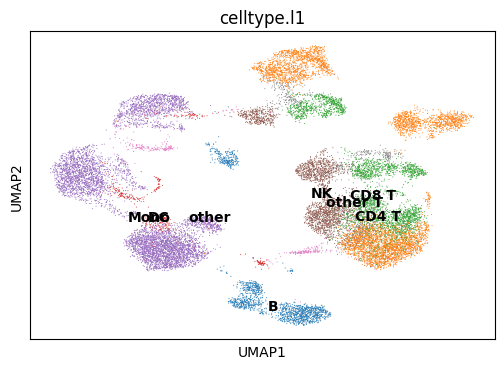

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


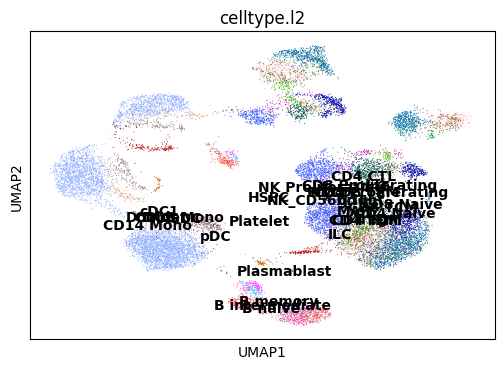

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


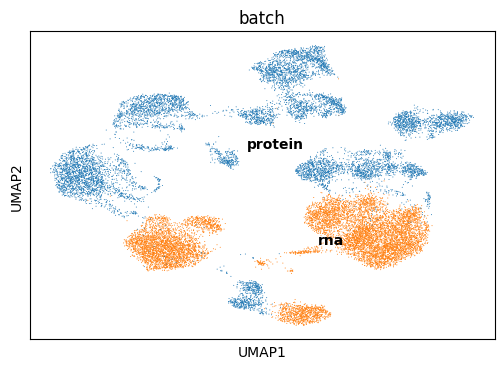

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


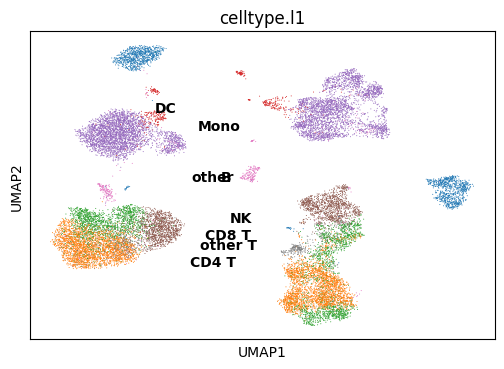

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


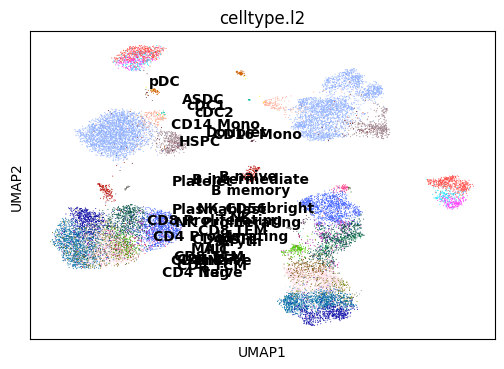

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


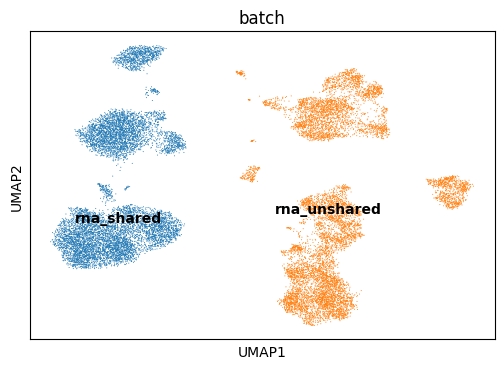

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


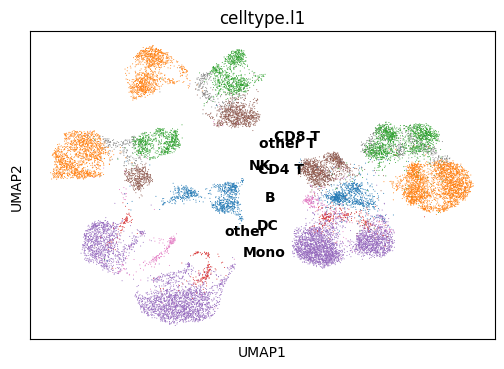

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


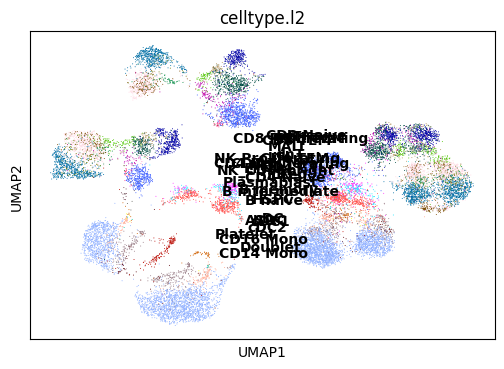

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


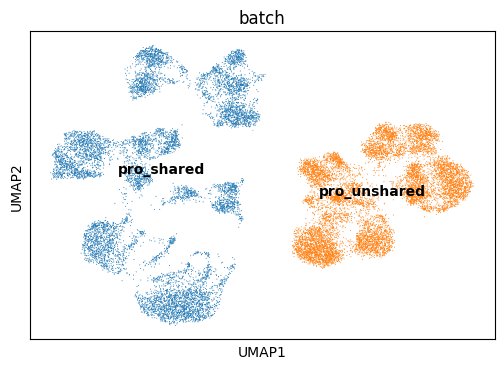

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For All matchings: lv1 matching acc: 0.596,
lv2 matching acc: 0.426.
For All matchings: FOSCTTM score: 0.34235618999999995, 
Knn Alignment score: [0.0014 0.0025 0.0033 0.0043 0.005  0.0054 0.0063 0.0071 0.0081 0.0085
 0.0095 0.0105 0.0112 0.0117 0.0122 0.0128 0.0132 0.0137 0.0143 0.0148
 0.0153 0.016  0.0168 0.0174 0.0182]
For All matchings: Silhouette F1 score for lv1: 0.46162529684021086, 
Silhouette F1 score for lv2: 0.4492056358034462



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  4.696527004241943
Matchings are reduced to 5000 after filtering...


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:423: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[matchings[0]], labels_l1[matchings[1]])
C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For only filtered matchings: lv1 matching acc: 0.692,
lv2 matching acc: 0.492.



Matches are being propagated....


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:460: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[filtered_matchings[0]], labels_l1[filtered_matchings[1]])
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scipy\sparse\_index.py:143: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


Done!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For all matchings after propagation: lv1 matching acc: 0.658,
lv2 matching acc: 0.458.


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:495: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[propagated_matchings[0]], labels_l1[propagated_matchings[1]])


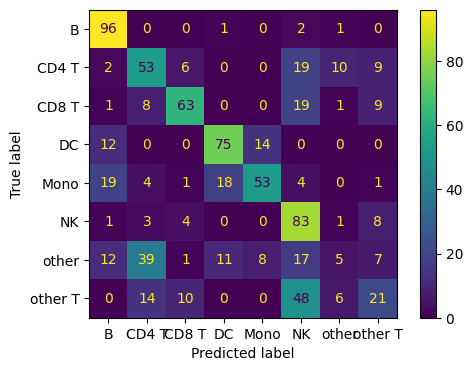

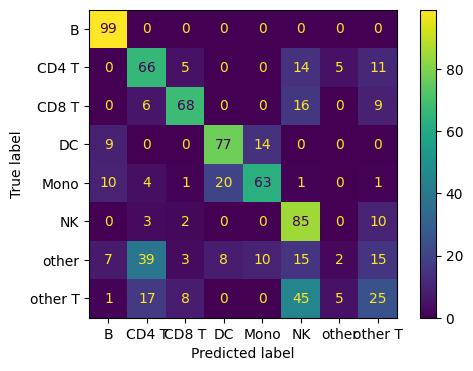

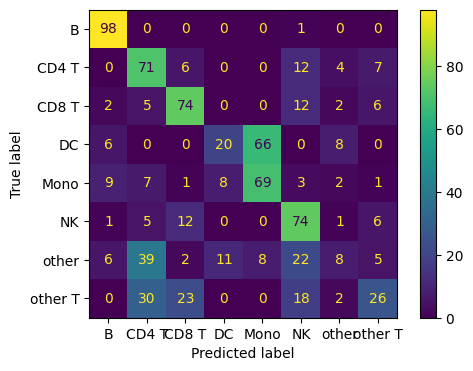

Epoch: 201: 0it [00:00, ?it/s]C:\Users\vinee\AppData\Local\Temp\ipykernel_2144\3129631169.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return {"x_unshared":self.unshared_data[idx], "x_shared":self.shared_data[idx], "l1":self.labels_l1[idx], "l2":self.labels_l2[idx], "mean": self.local_mean[idx], "var": self.local_var[idx], "batch": self.batch[idx]}
Epoch: 201: 40it [00:14,  2.68it/s]


RNA Recon Loss: 2.0814, RNA KL Div L: 0.0155, RNA KL Div Z: 0.4728, Protein Recon Loss: 0.4963, Protein KL Div Back Pro: 0.8973, Protein KL Div Z: 0.6857, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6168, Shared Recon Loss Gene: 0.2678, Shared Recon Loss Protein: 1.8295 Cross Loss Protein: 0.5459


Epoch: 202: 40it [00:12,  3.14it/s]


RNA Recon Loss: 2.0922, RNA KL Div L: 0.0155, RNA KL Div Z: 0.4734, Protein Recon Loss: 0.4973, Protein KL Div Back Pro: 0.8934, Protein KL Div Z: 0.6816, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6169, Shared Recon Loss Gene: 0.2686, Shared Recon Loss Protein: 1.8293 Cross Loss Protein: 0.5470


Epoch: 203: 40it [00:12,  3.23it/s]


RNA Recon Loss: 2.0940, RNA KL Div L: 0.0154, RNA KL Div Z: 0.4749, Protein Recon Loss: 0.4982, Protein KL Div Back Pro: 0.8941, Protein KL Div Z: 0.6825, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6163, Shared Recon Loss Gene: 0.2685, Shared Recon Loss Protein: 1.8257 Cross Loss Protein: 0.5468


Epoch: 204: 40it [00:12,  3.24it/s]


RNA Recon Loss: 2.0977, RNA KL Div L: 0.0157, RNA KL Div Z: 0.4731, Protein Recon Loss: 0.4966, Protein KL Div Back Pro: 0.8934, Protein KL Div Z: 0.6806, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6155, Shared Recon Loss Gene: 0.2700, Shared Recon Loss Protein: 1.8293 Cross Loss Protein: 0.5463


Epoch: 205: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.0859, RNA KL Div L: 0.0156, RNA KL Div Z: 0.4754, Protein Recon Loss: 0.4960, Protein KL Div Back Pro: 0.8897, Protein KL Div Z: 0.6810, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6145, Shared Recon Loss Gene: 0.2678, Shared Recon Loss Protein: 1.8276 Cross Loss Protein: 0.5459


Epoch: 206: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.1100, RNA KL Div L: 0.0158, RNA KL Div Z: 0.4732, Protein Recon Loss: 0.4946, Protein KL Div Back Pro: 0.8886, Protein KL Div Z: 0.6812, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6136, Shared Recon Loss Gene: 0.2691, Shared Recon Loss Protein: 1.8246 Cross Loss Protein: 0.5450


Epoch: 207: 40it [00:12,  3.19it/s]


RNA Recon Loss: 2.1061, RNA KL Div L: 0.0163, RNA KL Div Z: 0.4771, Protein Recon Loss: 0.4953, Protein KL Div Back Pro: 0.8891, Protein KL Div Z: 0.6798, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6109, Shared Recon Loss Gene: 0.2682, Shared Recon Loss Protein: 1.8251 Cross Loss Protein: 0.5459


Epoch: 208: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.0905, RNA KL Div L: 0.0158, RNA KL Div Z: 0.4760, Protein Recon Loss: 0.4952, Protein KL Div Back Pro: 0.8904, Protein KL Div Z: 0.6836, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6130, Shared Recon Loss Gene: 0.2684, Shared Recon Loss Protein: 1.8247 Cross Loss Protein: 0.5451


Epoch: 209: 40it [00:12,  3.32it/s]


RNA Recon Loss: 2.0851, RNA KL Div L: 0.0157, RNA KL Div Z: 0.4777, Protein Recon Loss: 0.4961, Protein KL Div Back Pro: 0.8851, Protein KL Div Z: 0.6815, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6121, Shared Recon Loss Gene: 0.2680, Shared Recon Loss Protein: 1.8245 Cross Loss Protein: 0.5453


Epoch: 210: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.1027, RNA KL Div L: 0.0158, RNA KL Div Z: 0.4754, Protein Recon Loss: 0.4953, Protein KL Div Back Pro: 0.8852, Protein KL Div Z: 0.6788, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6112, Shared Recon Loss Gene: 0.2684, Shared Recon Loss Protein: 1.8236 Cross Loss Protein: 0.5449


Epoch: 211: 40it [00:12,  3.31it/s]


RNA Recon Loss: 2.0902, RNA KL Div L: 0.0160, RNA KL Div Z: 0.4771, Protein Recon Loss: 0.4958, Protein KL Div Back Pro: 0.8882, Protein KL Div Z: 0.6783, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6113, Shared Recon Loss Gene: 0.2676, Shared Recon Loss Protein: 1.8237 Cross Loss Protein: 0.5455


Epoch: 212: 40it [00:13,  2.94it/s]


RNA Recon Loss: 2.0893, RNA KL Div L: 0.0156, RNA KL Div Z: 0.4757, Protein Recon Loss: 0.4958, Protein KL Div Back Pro: 0.8915, Protein KL Div Z: 0.6782, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6107, Shared Recon Loss Gene: 0.2676, Shared Recon Loss Protein: 1.8218 Cross Loss Protein: 0.5451


Epoch: 213: 40it [00:12,  3.22it/s]


RNA Recon Loss: 2.0891, RNA KL Div L: 0.0157, RNA KL Div Z: 0.4743, Protein Recon Loss: 0.4963, Protein KL Div Back Pro: 0.8871, Protein KL Div Z: 0.6725, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6105, Shared Recon Loss Gene: 0.2678, Shared Recon Loss Protein: 1.8275 Cross Loss Protein: 0.5453


Epoch: 214: 40it [00:12,  3.15it/s]


RNA Recon Loss: 2.0816, RNA KL Div L: 0.0156, RNA KL Div Z: 0.4740, Protein Recon Loss: 0.4962, Protein KL Div Back Pro: 0.8883, Protein KL Div Z: 0.6773, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6100, Shared Recon Loss Gene: 0.2681, Shared Recon Loss Protein: 1.8246 Cross Loss Protein: 0.5460


Epoch: 215: 40it [00:12,  3.15it/s]


RNA Recon Loss: 2.0866, RNA KL Div L: 0.0154, RNA KL Div Z: 0.4751, Protein Recon Loss: 0.4957, Protein KL Div Back Pro: 0.8878, Protein KL Div Z: 0.6761, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6090, Shared Recon Loss Gene: 0.2675, Shared Recon Loss Protein: 1.8237 Cross Loss Protein: 0.5450


Epoch: 216: 40it [00:13,  3.04it/s]


RNA Recon Loss: 2.0784, RNA KL Div L: 0.0156, RNA KL Div Z: 0.4740, Protein Recon Loss: 0.4960, Protein KL Div Back Pro: 0.8892, Protein KL Div Z: 0.6737, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6099, Shared Recon Loss Gene: 0.2672, Shared Recon Loss Protein: 1.8244 Cross Loss Protein: 0.5452


Epoch: 217: 40it [00:12,  3.09it/s]


RNA Recon Loss: 2.0874, RNA KL Div L: 0.0154, RNA KL Div Z: 0.4737, Protein Recon Loss: 0.4963, Protein KL Div Back Pro: 0.8855, Protein KL Div Z: 0.6743, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6086, Shared Recon Loss Gene: 0.2684, Shared Recon Loss Protein: 1.8250 Cross Loss Protein: 0.5463


Epoch: 218: 40it [00:13,  3.00it/s]


RNA Recon Loss: 2.0825, RNA KL Div L: 0.0158, RNA KL Div Z: 0.4755, Protein Recon Loss: 0.4963, Protein KL Div Back Pro: 0.8882, Protein KL Div Z: 0.6751, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6084, Shared Recon Loss Gene: 0.2677, Shared Recon Loss Protein: 1.8221 Cross Loss Protein: 0.5456


Epoch: 219: 40it [00:12,  3.24it/s]


RNA Recon Loss: 2.0787, RNA KL Div L: 0.0157, RNA KL Div Z: 0.4740, Protein Recon Loss: 0.4953, Protein KL Div Back Pro: 0.8874, Protein KL Div Z: 0.6714, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6095, Shared Recon Loss Gene: 0.2674, Shared Recon Loss Protein: 1.8248 Cross Loss Protein: 0.5455


Epoch: 220: 40it [00:12,  3.23it/s]


RNA Recon Loss: 2.0764, RNA KL Div L: 0.0155, RNA KL Div Z: 0.4740, Protein Recon Loss: 0.4951, Protein KL Div Back Pro: 0.8789, Protein KL Div Z: 0.6710, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6077, Shared Recon Loss Gene: 0.2680, Shared Recon Loss Protein: 1.8263 Cross Loss Protein: 0.5462


Epoch: 221: 40it [00:12,  3.11it/s]


RNA Recon Loss: 2.0791, RNA KL Div L: 0.0154, RNA KL Div Z: 0.4722, Protein Recon Loss: 0.4967, Protein KL Div Back Pro: 0.8848, Protein KL Div Z: 0.6718, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6085, Shared Recon Loss Gene: 0.2668, Shared Recon Loss Protein: 1.8222 Cross Loss Protein: 0.5454


Epoch: 222: 40it [00:13,  3.05it/s]


RNA Recon Loss: 2.0843, RNA KL Div L: 0.0155, RNA KL Div Z: 0.4725, Protein Recon Loss: 0.4953, Protein KL Div Back Pro: 0.8766, Protein KL Div Z: 0.6692, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6084, Shared Recon Loss Gene: 0.2671, Shared Recon Loss Protein: 1.8209 Cross Loss Protein: 0.5451


Epoch: 223: 40it [00:13,  2.96it/s]


RNA Recon Loss: 2.0832, RNA KL Div L: 0.0154, RNA KL Div Z: 0.4708, Protein Recon Loss: 0.4946, Protein KL Div Back Pro: 0.8836, Protein KL Div Z: 0.6706, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6087, Shared Recon Loss Gene: 0.2678, Shared Recon Loss Protein: 1.8207 Cross Loss Protein: 0.5452


Epoch: 224: 40it [00:12,  3.12it/s]


RNA Recon Loss: 2.0829, RNA KL Div L: 0.0154, RNA KL Div Z: 0.4718, Protein Recon Loss: 0.4944, Protein KL Div Back Pro: 0.8843, Protein KL Div Z: 0.6706, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6080, Shared Recon Loss Gene: 0.2678, Shared Recon Loss Protein: 1.8206 Cross Loss Protein: 0.5450


Epoch: 225: 40it [00:13,  3.01it/s]


RNA Recon Loss: 2.0879, RNA KL Div L: 0.0155, RNA KL Div Z: 0.4711, Protein Recon Loss: 0.4954, Protein KL Div Back Pro: 0.8824, Protein KL Div Z: 0.6703, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6071, Shared Recon Loss Gene: 0.2683, Shared Recon Loss Protein: 1.8212 Cross Loss Protein: 0.5448


Epoch: 226: 40it [00:13,  2.94it/s]


RNA Recon Loss: 2.0779, RNA KL Div L: 0.0159, RNA KL Div Z: 0.4727, Protein Recon Loss: 0.4947, Protein KL Div Back Pro: 0.8821, Protein KL Div Z: 0.6695, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6069, Shared Recon Loss Gene: 0.2673, Shared Recon Loss Protein: 1.8229 Cross Loss Protein: 0.5442


Epoch: 227: 40it [00:12,  3.15it/s]


RNA Recon Loss: 2.0797, RNA KL Div L: 0.0153, RNA KL Div Z: 0.4736, Protein Recon Loss: 0.4947, Protein KL Div Back Pro: 0.8811, Protein KL Div Z: 0.6688, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6069, Shared Recon Loss Gene: 0.2672, Shared Recon Loss Protein: 1.8206 Cross Loss Protein: 0.5458


Epoch: 228: 40it [00:12,  3.15it/s]


RNA Recon Loss: 2.0761, RNA KL Div L: 0.0152, RNA KL Div Z: 0.4719, Protein Recon Loss: 0.4955, Protein KL Div Back Pro: 0.8836, Protein KL Div Z: 0.6682, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6052, Shared Recon Loss Gene: 0.2672, Shared Recon Loss Protein: 1.8228 Cross Loss Protein: 0.5461


Epoch: 229: 40it [00:13,  3.07it/s]


RNA Recon Loss: 2.0787, RNA KL Div L: 0.0154, RNA KL Div Z: 0.4715, Protein Recon Loss: 0.4960, Protein KL Div Back Pro: 0.8849, Protein KL Div Z: 0.6687, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6059, Shared Recon Loss Gene: 0.2677, Shared Recon Loss Protein: 1.8255 Cross Loss Protein: 0.5456


Epoch: 230: 40it [00:13,  3.00it/s]


RNA Recon Loss: 2.0815, RNA KL Div L: 0.0155, RNA KL Div Z: 0.4719, Protein Recon Loss: 0.4950, Protein KL Div Back Pro: 0.8825, Protein KL Div Z: 0.6673, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6032, Shared Recon Loss Gene: 0.2682, Shared Recon Loss Protein: 1.8236 Cross Loss Protein: 0.5460


Epoch: 231: 40it [00:13,  2.98it/s]


RNA Recon Loss: 2.0785, RNA KL Div L: 0.0156, RNA KL Div Z: 0.4714, Protein Recon Loss: 0.4991, Protein KL Div Back Pro: 0.8780, Protein KL Div Z: 0.6659, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6036, Shared Recon Loss Gene: 0.2668, Shared Recon Loss Protein: 1.8194 Cross Loss Protein: 0.5455


Epoch: 232: 40it [00:12,  3.12it/s]


RNA Recon Loss: 2.0850, RNA KL Div L: 0.0153, RNA KL Div Z: 0.4720, Protein Recon Loss: 0.4966, Protein KL Div Back Pro: 0.8785, Protein KL Div Z: 0.6635, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6041, Shared Recon Loss Gene: 0.2674, Shared Recon Loss Protein: 1.8229 Cross Loss Protein: 0.5449


Epoch: 233: 40it [00:12,  3.23it/s]


RNA Recon Loss: 2.0786, RNA KL Div L: 0.0154, RNA KL Div Z: 0.4737, Protein Recon Loss: 0.4955, Protein KL Div Back Pro: 0.8780, Protein KL Div Z: 0.6629, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5997, Shared Recon Loss Gene: 0.2677, Shared Recon Loss Protein: 1.8301 Cross Loss Protein: 0.5459


Epoch: 234: 40it [00:12,  3.18it/s]


RNA Recon Loss: 2.0717, RNA KL Div L: 0.0157, RNA KL Div Z: 0.4716, Protein Recon Loss: 0.4956, Protein KL Div Back Pro: 0.8765, Protein KL Div Z: 0.6626, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6006, Shared Recon Loss Gene: 0.2672, Shared Recon Loss Protein: 1.8231 Cross Loss Protein: 0.5455


Epoch: 235: 40it [00:12,  3.11it/s]


RNA Recon Loss: 2.0725, RNA KL Div L: 0.0153, RNA KL Div Z: 0.4720, Protein Recon Loss: 0.4953, Protein KL Div Back Pro: 0.8765, Protein KL Div Z: 0.6622, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6002, Shared Recon Loss Gene: 0.2671, Shared Recon Loss Protein: 1.8215 Cross Loss Protein: 0.5446


Epoch: 236: 40it [00:13,  3.00it/s]


RNA Recon Loss: 2.0872, RNA KL Div L: 0.0156, RNA KL Div Z: 0.4741, Protein Recon Loss: 0.4956, Protein KL Div Back Pro: 0.8801, Protein KL Div Z: 0.6632, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6011, Shared Recon Loss Gene: 0.2676, Shared Recon Loss Protein: 1.8230 Cross Loss Protein: 0.5451


Epoch: 237: 40it [00:12,  3.10it/s]


RNA Recon Loss: 2.0839, RNA KL Div L: 0.0156, RNA KL Div Z: 0.4734, Protein Recon Loss: 0.4962, Protein KL Div Back Pro: 0.8786, Protein KL Div Z: 0.6596, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6017, Shared Recon Loss Gene: 0.2673, Shared Recon Loss Protein: 1.8246 Cross Loss Protein: 0.5457


Epoch: 238: 40it [00:12,  3.12it/s]


RNA Recon Loss: 2.0784, RNA KL Div L: 0.0153, RNA KL Div Z: 0.4724, Protein Recon Loss: 0.4937, Protein KL Div Back Pro: 0.8746, Protein KL Div Z: 0.6616, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5991, Shared Recon Loss Gene: 0.2668, Shared Recon Loss Protein: 1.8201 Cross Loss Protein: 0.5442


Epoch: 239: 40it [00:13,  2.90it/s]


RNA Recon Loss: 2.0730, RNA KL Div L: 0.0155, RNA KL Div Z: 0.4727, Protein Recon Loss: 0.4948, Protein KL Div Back Pro: 0.8770, Protein KL Div Z: 0.6628, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5989, Shared Recon Loss Gene: 0.2661, Shared Recon Loss Protein: 1.8224 Cross Loss Protein: 0.5457


Epoch: 240: 40it [00:12,  3.12it/s]


RNA Recon Loss: 2.0823, RNA KL Div L: 0.0153, RNA KL Div Z: 0.4715, Protein Recon Loss: 0.4953, Protein KL Div Back Pro: 0.8816, Protein KL Div Z: 0.6599, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5994, Shared Recon Loss Gene: 0.2669, Shared Recon Loss Protein: 1.8216 Cross Loss Protein: 0.5454


Epoch: 241: 40it [00:12,  3.18it/s]


RNA Recon Loss: 2.0738, RNA KL Div L: 0.0157, RNA KL Div Z: 0.4710, Protein Recon Loss: 0.4943, Protein KL Div Back Pro: 0.8805, Protein KL Div Z: 0.6587, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5973, Shared Recon Loss Gene: 0.2663, Shared Recon Loss Protein: 1.8228 Cross Loss Protein: 0.5449


Epoch: 242: 40it [00:12,  3.11it/s]


RNA Recon Loss: 2.0815, RNA KL Div L: 0.0154, RNA KL Div Z: 0.4712, Protein Recon Loss: 0.4960, Protein KL Div Back Pro: 0.8765, Protein KL Div Z: 0.6580, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5970, Shared Recon Loss Gene: 0.2665, Shared Recon Loss Protein: 1.8191 Cross Loss Protein: 0.5466


Epoch: 243: 40it [00:13,  3.08it/s]


RNA Recon Loss: 2.0728, RNA KL Div L: 0.0153, RNA KL Div Z: 0.4719, Protein Recon Loss: 0.4992, Protein KL Div Back Pro: 0.8995, Protein KL Div Z: 0.6642, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5970, Shared Recon Loss Gene: 0.2667, Shared Recon Loss Protein: 1.8221 Cross Loss Protein: 0.5473


Epoch: 244: 40it [00:12,  3.20it/s]


RNA Recon Loss: 2.0699, RNA KL Div L: 0.0154, RNA KL Div Z: 0.4682, Protein Recon Loss: 0.5015, Protein KL Div Back Pro: 0.8854, Protein KL Div Z: 0.6553, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5950, Shared Recon Loss Gene: 0.2666, Shared Recon Loss Protein: 1.8279 Cross Loss Protein: 0.5472


Epoch: 245: 40it [00:13,  2.99it/s]


RNA Recon Loss: 2.0754, RNA KL Div L: 0.0154, RNA KL Div Z: 0.4704, Protein Recon Loss: 0.4941, Protein KL Div Back Pro: 0.8810, Protein KL Div Z: 0.6570, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5971, Shared Recon Loss Gene: 0.2672, Shared Recon Loss Protein: 1.8213 Cross Loss Protein: 0.5448


Epoch: 246: 40it [00:14,  2.82it/s]


RNA Recon Loss: 2.0671, RNA KL Div L: 0.0154, RNA KL Div Z: 0.4697, Protein Recon Loss: 0.4951, Protein KL Div Back Pro: 0.8798, Protein KL Div Z: 0.6590, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5969, Shared Recon Loss Gene: 0.2658, Shared Recon Loss Protein: 1.8242 Cross Loss Protein: 0.5452


Epoch: 247: 40it [00:12,  3.09it/s]


RNA Recon Loss: 2.0708, RNA KL Div L: 0.0153, RNA KL Div Z: 0.4682, Protein Recon Loss: 0.4949, Protein KL Div Back Pro: 0.8745, Protein KL Div Z: 0.6566, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5950, Shared Recon Loss Gene: 0.2669, Shared Recon Loss Protein: 1.8185 Cross Loss Protein: 0.5444


Epoch: 248: 40it [00:12,  3.12it/s]


RNA Recon Loss: 2.0720, RNA KL Div L: 0.0153, RNA KL Div Z: 0.4698, Protein Recon Loss: 0.4938, Protein KL Div Back Pro: 0.8759, Protein KL Div Z: 0.6573, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5968, Shared Recon Loss Gene: 0.2655, Shared Recon Loss Protein: 1.8178 Cross Loss Protein: 0.5445


Epoch: 249: 40it [00:12,  3.12it/s]


RNA Recon Loss: 2.0754, RNA KL Div L: 0.0153, RNA KL Div Z: 0.4691, Protein Recon Loss: 0.4989, Protein KL Div Back Pro: 0.8756, Protein KL Div Z: 0.6545, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5957, Shared Recon Loss Gene: 0.2666, Shared Recon Loss Protein: 1.8216 Cross Loss Protein: 0.5462


Epoch: 250: 40it [00:13,  2.95it/s]


RNA Recon Loss: 2.0659, RNA KL Div L: 0.0155, RNA KL Div Z: 0.4686, Protein Recon Loss: 0.4952, Protein KL Div Back Pro: 0.8814, Protein KL Div Z: 0.6550, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5993, Shared Recon Loss Gene: 0.2665, Shared Recon Loss Protein: 1.8214 Cross Loss Protein: 0.5456


Epoch: 251: 40it [00:12,  3.12it/s]


RNA Recon Loss: 2.0689, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4687, Protein Recon Loss: 0.4954, Protein KL Div Back Pro: 0.8710, Protein KL Div Z: 0.6526, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5974, Shared Recon Loss Gene: 0.2664, Shared Recon Loss Protein: 1.8289 Cross Loss Protein: 0.5453


Epoch: 252: 40it [00:12,  3.09it/s]


RNA Recon Loss: 2.0767, RNA KL Div L: 0.0152, RNA KL Div Z: 0.4667, Protein Recon Loss: 0.4955, Protein KL Div Back Pro: 0.8681, Protein KL Div Z: 0.6555, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.6001, Shared Recon Loss Gene: 0.2695, Shared Recon Loss Protein: 1.8392 Cross Loss Protein: 0.5474


Epoch: 253: 40it [00:12,  3.14it/s]


RNA Recon Loss: 2.0645, RNA KL Div L: 0.0153, RNA KL Div Z: 0.4682, Protein Recon Loss: 0.4946, Protein KL Div Back Pro: 0.8663, Protein KL Div Z: 0.6552, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5998, Shared Recon Loss Gene: 0.2663, Shared Recon Loss Protein: 1.8234 Cross Loss Protein: 0.5447


Epoch: 254: 40it [00:12,  3.23it/s]


RNA Recon Loss: 2.0676, RNA KL Div L: 0.0152, RNA KL Div Z: 0.4678, Protein Recon Loss: 0.4941, Protein KL Div Back Pro: 0.8740, Protein KL Div Z: 0.6545, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5991, Shared Recon Loss Gene: 0.2668, Shared Recon Loss Protein: 1.8220 Cross Loss Protein: 0.5442


Epoch: 255: 40it [00:12,  3.21it/s]


RNA Recon Loss: 2.0706, RNA KL Div L: 0.0154, RNA KL Div Z: 0.4696, Protein Recon Loss: 0.4941, Protein KL Div Back Pro: 0.8739, Protein KL Div Z: 0.6556, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5939, Shared Recon Loss Gene: 0.2677, Shared Recon Loss Protein: 1.8235 Cross Loss Protein: 0.5452


Epoch: 256: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.0707, RNA KL Div L: 0.0153, RNA KL Div Z: 0.4686, Protein Recon Loss: 0.4943, Protein KL Div Back Pro: 0.8758, Protein KL Div Z: 0.6557, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5978, Shared Recon Loss Gene: 0.2674, Shared Recon Loss Protein: 1.8205 Cross Loss Protein: 0.5447


Epoch: 257: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.0693, RNA KL Div L: 0.0152, RNA KL Div Z: 0.4686, Protein Recon Loss: 0.4945, Protein KL Div Back Pro: 0.8747, Protein KL Div Z: 0.6551, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5964, Shared Recon Loss Gene: 0.2672, Shared Recon Loss Protein: 1.8201 Cross Loss Protein: 0.5445


Epoch: 258: 40it [00:12,  3.24it/s]


RNA Recon Loss: 2.0645, RNA KL Div L: 0.0155, RNA KL Div Z: 0.4697, Protein Recon Loss: 0.4941, Protein KL Div Back Pro: 0.8688, Protein KL Div Z: 0.6516, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5947, Shared Recon Loss Gene: 0.2660, Shared Recon Loss Protein: 1.8187 Cross Loss Protein: 0.5448


Epoch: 259: 40it [00:12,  3.29it/s]


RNA Recon Loss: 2.0724, RNA KL Div L: 0.0154, RNA KL Div Z: 0.4677, Protein Recon Loss: 0.4952, Protein KL Div Back Pro: 0.8691, Protein KL Div Z: 0.6530, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5950, Shared Recon Loss Gene: 0.2670, Shared Recon Loss Protein: 1.8191 Cross Loss Protein: 0.5471


Epoch: 260: 40it [00:12,  3.28it/s]


RNA Recon Loss: 2.0679, RNA KL Div L: 0.0153, RNA KL Div Z: 0.4679, Protein Recon Loss: 0.4968, Protein KL Div Back Pro: 0.8727, Protein KL Div Z: 0.6515, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5944, Shared Recon Loss Gene: 0.2674, Shared Recon Loss Protein: 1.8203 Cross Loss Protein: 0.5466


Epoch: 261: 40it [00:12,  3.31it/s]


RNA Recon Loss: 2.0650, RNA KL Div L: 0.0153, RNA KL Div Z: 0.4647, Protein Recon Loss: 0.4956, Protein KL Div Back Pro: 0.8723, Protein KL Div Z: 0.6484, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5933, Shared Recon Loss Gene: 0.2658, Shared Recon Loss Protein: 1.8237 Cross Loss Protein: 0.5457


Epoch: 262: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.0627, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4668, Protein Recon Loss: 0.4959, Protein KL Div Back Pro: 0.8730, Protein KL Div Z: 0.6473, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5929, Shared Recon Loss Gene: 0.2664, Shared Recon Loss Protein: 1.8229 Cross Loss Protein: 0.5459


Epoch: 263: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.0628, RNA KL Div L: 0.0154, RNA KL Div Z: 0.4675, Protein Recon Loss: 0.4943, Protein KL Div Back Pro: 0.8707, Protein KL Div Z: 0.6487, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5922, Shared Recon Loss Gene: 0.2652, Shared Recon Loss Protein: 1.8190 Cross Loss Protein: 0.5448


Epoch: 264: 40it [00:12,  3.29it/s]


RNA Recon Loss: 2.0697, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4682, Protein Recon Loss: 0.4941, Protein KL Div Back Pro: 0.8678, Protein KL Div Z: 0.6477, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5915, Shared Recon Loss Gene: 0.2660, Shared Recon Loss Protein: 1.8185 Cross Loss Protein: 0.5442


Epoch: 265: 40it [00:12,  3.16it/s]


RNA Recon Loss: 2.0644, RNA KL Div L: 0.0154, RNA KL Div Z: 0.4673, Protein Recon Loss: 0.4944, Protein KL Div Back Pro: 0.8708, Protein KL Div Z: 0.6500, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5916, Shared Recon Loss Gene: 0.2656, Shared Recon Loss Protein: 1.8188 Cross Loss Protein: 0.5447


Epoch: 266: 40it [00:13,  3.01it/s]


RNA Recon Loss: 2.0667, RNA KL Div L: 0.0154, RNA KL Div Z: 0.4648, Protein Recon Loss: 0.4963, Protein KL Div Back Pro: 0.8692, Protein KL Div Z: 0.6480, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5911, Shared Recon Loss Gene: 0.2659, Shared Recon Loss Protein: 1.8205 Cross Loss Protein: 0.5448


Epoch: 267: 40it [00:12,  3.14it/s]


RNA Recon Loss: 2.0975, RNA KL Div L: 0.0154, RNA KL Div Z: 0.4688, Protein Recon Loss: 0.4933, Protein KL Div Back Pro: 0.8710, Protein KL Div Z: 0.6473, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5923, Shared Recon Loss Gene: 0.2670, Shared Recon Loss Protein: 1.8212 Cross Loss Protein: 0.5448


Epoch: 268: 40it [00:12,  3.10it/s]


RNA Recon Loss: 2.0962, RNA KL Div L: 0.0163, RNA KL Div Z: 0.4723, Protein Recon Loss: 0.4934, Protein KL Div Back Pro: 0.8732, Protein KL Div Z: 0.6482, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5871, Shared Recon Loss Gene: 0.2672, Shared Recon Loss Protein: 1.8184 Cross Loss Protein: 0.5448


Epoch: 269: 40it [00:14,  2.79it/s]


RNA Recon Loss: 2.0687, RNA KL Div L: 0.0154, RNA KL Div Z: 0.4701, Protein Recon Loss: 0.4938, Protein KL Div Back Pro: 0.8699, Protein KL Div Z: 0.6472, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5889, Shared Recon Loss Gene: 0.2659, Shared Recon Loss Protein: 1.8181 Cross Loss Protein: 0.5444


Epoch: 270: 40it [00:14,  2.82it/s]


RNA Recon Loss: 2.0634, RNA KL Div L: 0.0154, RNA KL Div Z: 0.4695, Protein Recon Loss: 0.4932, Protein KL Div Back Pro: 0.8732, Protein KL Div Z: 0.6473, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5890, Shared Recon Loss Gene: 0.2656, Shared Recon Loss Protein: 1.8180 Cross Loss Protein: 0.5437


Epoch: 271: 40it [00:13,  3.02it/s]


RNA Recon Loss: 2.0711, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4673, Protein Recon Loss: 0.4963, Protein KL Div Back Pro: 0.8722, Protein KL Div Z: 0.6449, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5885, Shared Recon Loss Gene: 0.2670, Shared Recon Loss Protein: 1.8188 Cross Loss Protein: 0.5455


Epoch: 272: 40it [00:13,  2.98it/s]


RNA Recon Loss: 2.0604, RNA KL Div L: 0.0152, RNA KL Div Z: 0.4700, Protein Recon Loss: 0.4948, Protein KL Div Back Pro: 0.8696, Protein KL Div Z: 0.6447, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5879, Shared Recon Loss Gene: 0.2662, Shared Recon Loss Protein: 1.8208 Cross Loss Protein: 0.5450


Epoch: 273: 40it [00:13,  2.98it/s]


RNA Recon Loss: 2.0593, RNA KL Div L: 0.0152, RNA KL Div Z: 0.4691, Protein Recon Loss: 0.4932, Protein KL Div Back Pro: 0.8715, Protein KL Div Z: 0.6453, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5892, Shared Recon Loss Gene: 0.2660, Shared Recon Loss Protein: 1.8213 Cross Loss Protein: 0.5451


Epoch: 274: 40it [00:13,  3.03it/s]


RNA Recon Loss: 2.0640, RNA KL Div L: 0.0153, RNA KL Div Z: 0.4688, Protein Recon Loss: 0.4939, Protein KL Div Back Pro: 0.8712, Protein KL Div Z: 0.6457, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5873, Shared Recon Loss Gene: 0.2660, Shared Recon Loss Protein: 1.8192 Cross Loss Protein: 0.5445


Epoch: 275: 40it [00:13,  3.00it/s]


RNA Recon Loss: 2.0651, RNA KL Div L: 0.0153, RNA KL Div Z: 0.4691, Protein Recon Loss: 0.4936, Protein KL Div Back Pro: 0.8713, Protein KL Div Z: 0.6432, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5865, Shared Recon Loss Gene: 0.2661, Shared Recon Loss Protein: 1.8203 Cross Loss Protein: 0.5446


Epoch: 276: 40it [00:12,  3.08it/s]


RNA Recon Loss: 2.0582, RNA KL Div L: 0.0153, RNA KL Div Z: 0.4698, Protein Recon Loss: 0.4939, Protein KL Div Back Pro: 0.8753, Protein KL Div Z: 0.6462, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5862, Shared Recon Loss Gene: 0.2665, Shared Recon Loss Protein: 1.8204 Cross Loss Protein: 0.5453


Epoch: 277: 40it [00:12,  3.14it/s]


RNA Recon Loss: 2.0628, RNA KL Div L: 0.0154, RNA KL Div Z: 0.4678, Protein Recon Loss: 0.4941, Protein KL Div Back Pro: 0.8716, Protein KL Div Z: 0.6470, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5872, Shared Recon Loss Gene: 0.2652, Shared Recon Loss Protein: 1.8172 Cross Loss Protein: 0.5442


Epoch: 278: 40it [00:12,  3.13it/s]


RNA Recon Loss: 2.0669, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4713, Protein Recon Loss: 0.4949, Protein KL Div Back Pro: 0.8642, Protein KL Div Z: 0.6443, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5866, Shared Recon Loss Gene: 0.2663, Shared Recon Loss Protein: 1.8199 Cross Loss Protein: 0.5450


Epoch: 279: 40it [00:12,  3.14it/s]


RNA Recon Loss: 2.0566, RNA KL Div L: 0.0152, RNA KL Div Z: 0.4704, Protein Recon Loss: 0.4946, Protein KL Div Back Pro: 0.8642, Protein KL Div Z: 0.6426, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5866, Shared Recon Loss Gene: 0.2653, Shared Recon Loss Protein: 1.8162 Cross Loss Protein: 0.5443


Epoch: 280: 40it [00:13,  3.06it/s]


RNA Recon Loss: 2.0575, RNA KL Div L: 0.0152, RNA KL Div Z: 0.4696, Protein Recon Loss: 0.4934, Protein KL Div Back Pro: 0.8624, Protein KL Div Z: 0.6432, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5863, Shared Recon Loss Gene: 0.2647, Shared Recon Loss Protein: 1.8150 Cross Loss Protein: 0.5440


Epoch: 281: 40it [00:12,  3.21it/s]


RNA Recon Loss: 2.0622, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4689, Protein Recon Loss: 0.4942, Protein KL Div Back Pro: 0.8599, Protein KL Div Z: 0.6424, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5860, Shared Recon Loss Gene: 0.2664, Shared Recon Loss Protein: 1.8223 Cross Loss Protein: 0.5446


Epoch: 282: 40it [00:12,  3.21it/s]


RNA Recon Loss: 2.0637, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4696, Protein Recon Loss: 0.4939, Protein KL Div Back Pro: 0.8703, Protein KL Div Z: 0.6421, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5863, Shared Recon Loss Gene: 0.2670, Shared Recon Loss Protein: 1.8215 Cross Loss Protein: 0.5453


Epoch: 283: 40it [00:12,  3.20it/s]


RNA Recon Loss: 2.0572, RNA KL Div L: 0.0153, RNA KL Div Z: 0.4695, Protein Recon Loss: 0.4926, Protein KL Div Back Pro: 0.8685, Protein KL Div Z: 0.6429, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5838, Shared Recon Loss Gene: 0.2655, Shared Recon Loss Protein: 1.8169 Cross Loss Protein: 0.5441


Epoch: 284: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.0602, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4685, Protein Recon Loss: 0.4933, Protein KL Div Back Pro: 0.8698, Protein KL Div Z: 0.6433, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5831, Shared Recon Loss Gene: 0.2651, Shared Recon Loss Protein: 1.8191 Cross Loss Protein: 0.5442


Epoch: 285: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.0543, RNA KL Div L: 0.0152, RNA KL Div Z: 0.4691, Protein Recon Loss: 0.4937, Protein KL Div Back Pro: 0.8674, Protein KL Div Z: 0.6447, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5832, Shared Recon Loss Gene: 0.2652, Shared Recon Loss Protein: 1.8169 Cross Loss Protein: 0.5440


Epoch: 286: 40it [00:12,  3.23it/s]


RNA Recon Loss: 2.0563, RNA KL Div L: 0.0153, RNA KL Div Z: 0.4680, Protein Recon Loss: 0.4936, Protein KL Div Back Pro: 0.8699, Protein KL Div Z: 0.6418, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5832, Shared Recon Loss Gene: 0.2651, Shared Recon Loss Protein: 1.8160 Cross Loss Protein: 0.5441


Epoch: 287: 40it [00:12,  3.23it/s]


RNA Recon Loss: 2.0572, RNA KL Div L: 0.0152, RNA KL Div Z: 0.4670, Protein Recon Loss: 0.4947, Protein KL Div Back Pro: 0.8684, Protein KL Div Z: 0.6435, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5813, Shared Recon Loss Gene: 0.2651, Shared Recon Loss Protein: 1.8246 Cross Loss Protein: 0.5449


Epoch: 288: 40it [00:12,  3.22it/s]


RNA Recon Loss: 2.0530, RNA KL Div L: 0.0153, RNA KL Div Z: 0.4666, Protein Recon Loss: 0.4940, Protein KL Div Back Pro: 0.8607, Protein KL Div Z: 0.6408, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5829, Shared Recon Loss Gene: 0.2665, Shared Recon Loss Protein: 1.8297 Cross Loss Protein: 0.5469


Epoch: 289: 40it [00:12,  3.24it/s]


RNA Recon Loss: 2.0599, RNA KL Div L: 0.0153, RNA KL Div Z: 0.4669, Protein Recon Loss: 0.4932, Protein KL Div Back Pro: 0.8642, Protein KL Div Z: 0.6402, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5808, Shared Recon Loss Gene: 0.2660, Shared Recon Loss Protein: 1.8163 Cross Loss Protein: 0.5441


Epoch: 290: 40it [00:12,  3.22it/s]


RNA Recon Loss: 2.0607, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4692, Protein Recon Loss: 0.4938, Protein KL Div Back Pro: 0.8598, Protein KL Div Z: 0.6386, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5805, Shared Recon Loss Gene: 0.2656, Shared Recon Loss Protein: 1.8217 Cross Loss Protein: 0.5452


Epoch: 291: 40it [00:12,  3.20it/s]


RNA Recon Loss: 2.0612, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4689, Protein Recon Loss: 0.4932, Protein KL Div Back Pro: 0.8637, Protein KL Div Z: 0.6382, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5793, Shared Recon Loss Gene: 0.2663, Shared Recon Loss Protein: 1.8164 Cross Loss Protein: 0.5436


Epoch: 292: 40it [00:12,  3.11it/s]


RNA Recon Loss: 2.0598, RNA KL Div L: 0.0152, RNA KL Div Z: 0.4673, Protein Recon Loss: 0.4948, Protein KL Div Back Pro: 0.8663, Protein KL Div Z: 0.6385, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5790, Shared Recon Loss Gene: 0.2650, Shared Recon Loss Protein: 1.8179 Cross Loss Protein: 0.5449


Epoch: 293: 40it [00:12,  3.19it/s]


RNA Recon Loss: 2.0539, RNA KL Div L: 0.0153, RNA KL Div Z: 0.4669, Protein Recon Loss: 0.4965, Protein KL Div Back Pro: 0.8674, Protein KL Div Z: 0.6371, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5787, Shared Recon Loss Gene: 0.2652, Shared Recon Loss Protein: 1.8195 Cross Loss Protein: 0.5456


Epoch: 294: 40it [00:12,  3.21it/s]


RNA Recon Loss: 2.0591, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4678, Protein Recon Loss: 0.4943, Protein KL Div Back Pro: 0.8574, Protein KL Div Z: 0.6338, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5792, Shared Recon Loss Gene: 0.2652, Shared Recon Loss Protein: 1.8178 Cross Loss Protein: 0.5446


Epoch: 295: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.0542, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4681, Protein Recon Loss: 0.4943, Protein KL Div Back Pro: 0.8596, Protein KL Div Z: 0.6352, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5802, Shared Recon Loss Gene: 0.2651, Shared Recon Loss Protein: 1.8185 Cross Loss Protein: 0.5451


Epoch: 296: 40it [00:12,  3.28it/s]


RNA Recon Loss: 2.0540, RNA KL Div L: 0.0154, RNA KL Div Z: 0.4666, Protein Recon Loss: 0.4940, Protein KL Div Back Pro: 0.8615, Protein KL Div Z: 0.6350, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5783, Shared Recon Loss Gene: 0.2652, Shared Recon Loss Protein: 1.8186 Cross Loss Protein: 0.5453


Epoch: 297: 40it [00:12,  3.23it/s]


RNA Recon Loss: 2.0551, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4654, Protein Recon Loss: 0.4932, Protein KL Div Back Pro: 0.8649, Protein KL Div Z: 0.6341, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5784, Shared Recon Loss Gene: 0.2643, Shared Recon Loss Protein: 1.8149 Cross Loss Protein: 0.5436


Epoch: 298: 40it [00:12,  3.20it/s]


RNA Recon Loss: 2.0600, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4666, Protein Recon Loss: 0.4956, Protein KL Div Back Pro: 0.8650, Protein KL Div Z: 0.6337, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5783, Shared Recon Loss Gene: 0.2651, Shared Recon Loss Protein: 1.8168 Cross Loss Protein: 0.5450


Epoch: 299: 40it [00:13,  3.07it/s]


RNA Recon Loss: 2.0509, RNA KL Div L: 0.0152, RNA KL Div Z: 0.4657, Protein Recon Loss: 0.4959, Protein KL Div Back Pro: 0.8605, Protein KL Div Z: 0.6297, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5776, Shared Recon Loss Gene: 0.2645, Shared Recon Loss Protein: 1.8191 Cross Loss Protein: 0.5446


Epoch: 300: 40it [00:12,  3.19it/s]


RNA Recon Loss: 2.0523, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4663, Protein Recon Loss: 0.4923, Protein KL Div Back Pro: 0.8654, Protein KL Div Z: 0.6307, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5779, Shared Recon Loss Gene: 0.2647, Shared Recon Loss Protein: 1.8121 Cross Loss Protein: 0.5428


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


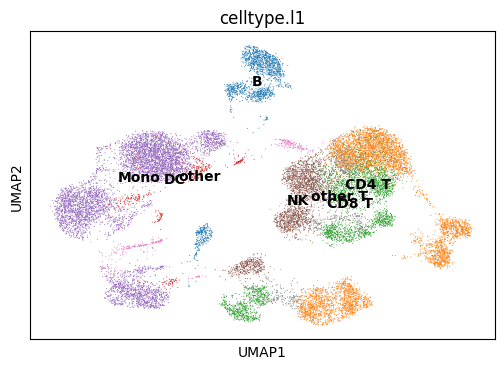

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


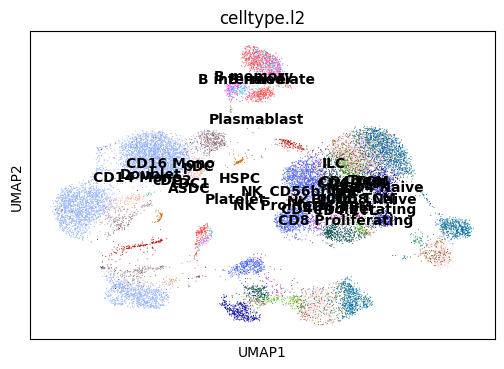

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


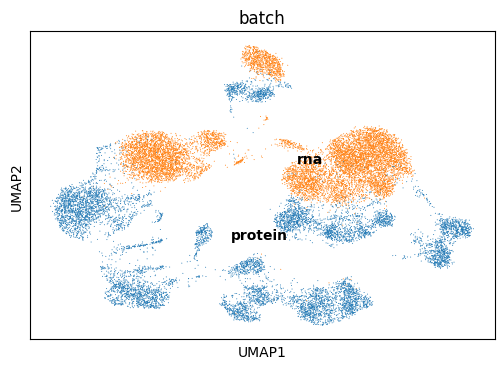

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


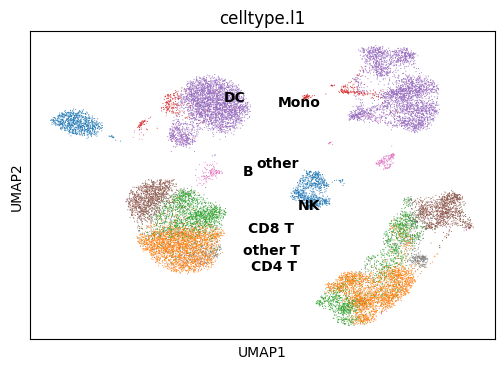

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


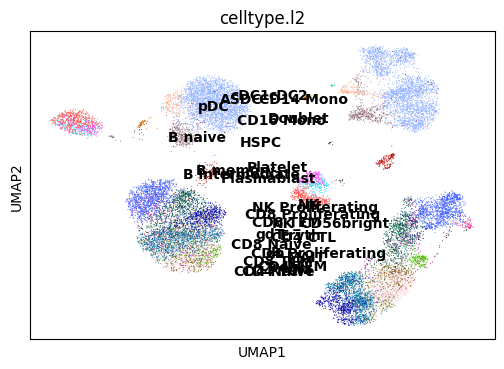

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


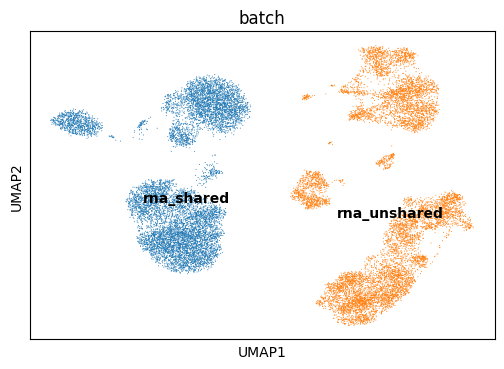

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


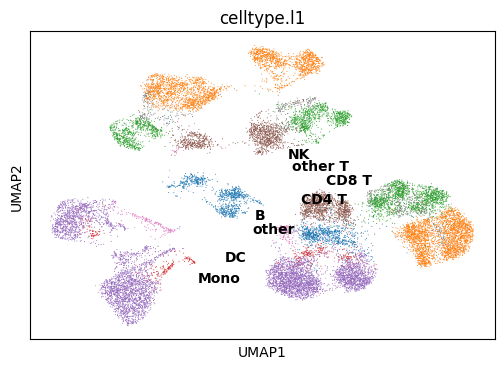

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


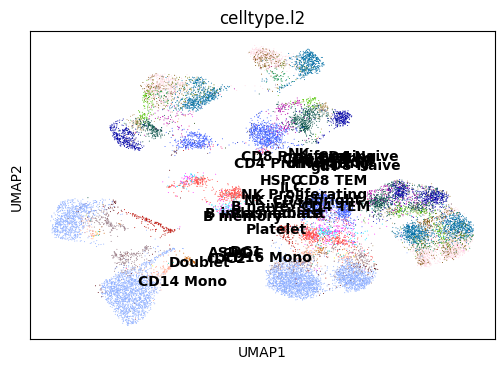

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


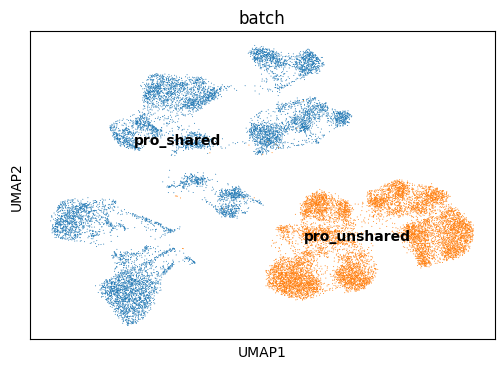

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For All matchings: lv1 matching acc: 0.621,
lv2 matching acc: 0.442.
For All matchings: FOSCTTM score: 0.30696667, 
Knn Alignment score: [0.0014 0.002  0.0029 0.0038 0.0046 0.0049 0.0054 0.0063 0.0074 0.0082
 0.0087 0.0096 0.0102 0.0108 0.0117 0.0122 0.0128 0.0134 0.0141 0.0148
 0.0154 0.0163 0.0173 0.0187 0.0198]
For All matchings: Silhouette F1 score for lv1: 0.4772515613146694, 
Silhouette F1 score for lv2: 0.46519472834171205



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  4.185525894165039
Matchings are reduced to 5000 after filtering...


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:423: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[matchings[0]], labels_l1[matchings[1]])
C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For only filtered matchings: lv1 matching acc: 0.723,
lv2 matching acc: 0.536.



Matches are being propagated....


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:460: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[filtered_matchings[0]], labels_l1[filtered_matchings[1]])
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scipy\sparse\_index.py:143: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


Done!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For all matchings after propagation: lv1 matching acc: 0.723,
lv2 matching acc: 0.512.


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:495: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[propagated_matchings[0]], labels_l1[propagated_matchings[1]])


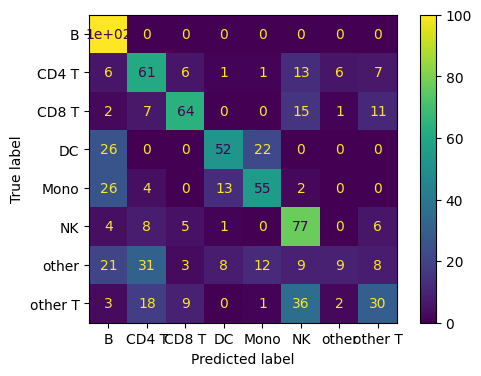

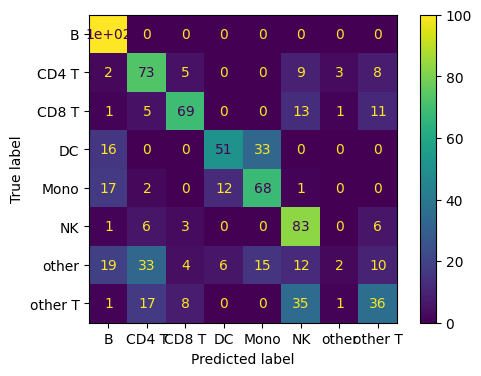

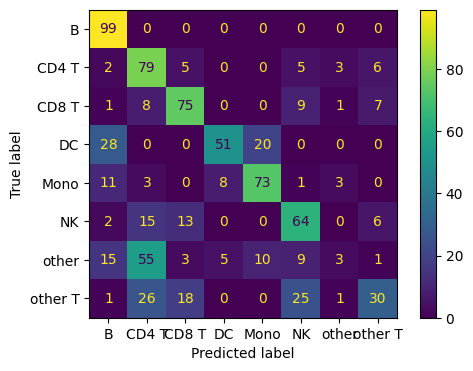

Epoch: 301: 0it [00:00, ?it/s]C:\Users\vinee\AppData\Local\Temp\ipykernel_2144\3129631169.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return {"x_unshared":self.unshared_data[idx], "x_shared":self.shared_data[idx], "l1":self.labels_l1[idx], "l2":self.labels_l2[idx], "mean": self.local_mean[idx], "var": self.local_var[idx], "batch": self.batch[idx]}
Epoch: 301: 40it [00:13,  2.96it/s]


RNA Recon Loss: 2.0536, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4659, Protein Recon Loss: 0.4922, Protein KL Div Back Pro: 0.8642, Protein KL Div Z: 0.6311, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5780, Shared Recon Loss Gene: 0.2640, Shared Recon Loss Protein: 1.8100 Cross Loss Protein: 0.5430


Epoch: 302: 40it [00:12,  3.19it/s]


RNA Recon Loss: 2.0493, RNA KL Div L: 0.0152, RNA KL Div Z: 0.4656, Protein Recon Loss: 0.4921, Protein KL Div Back Pro: 0.8644, Protein KL Div Z: 0.6323, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5783, Shared Recon Loss Gene: 0.2635, Shared Recon Loss Protein: 1.8095 Cross Loss Protein: 0.5428


Epoch: 303: 40it [00:13,  2.90it/s]


RNA Recon Loss: 2.0566, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4666, Protein Recon Loss: 0.4918, Protein KL Div Back Pro: 0.8628, Protein KL Div Z: 0.6331, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5778, Shared Recon Loss Gene: 0.2648, Shared Recon Loss Protein: 1.8139 Cross Loss Protein: 0.5430


Epoch: 304: 40it [00:13,  2.86it/s]


RNA Recon Loss: 2.0495, RNA KL Div L: 0.0152, RNA KL Div Z: 0.4667, Protein Recon Loss: 0.4927, Protein KL Div Back Pro: 0.8643, Protein KL Div Z: 0.6347, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5788, Shared Recon Loss Gene: 0.2637, Shared Recon Loss Protein: 1.8188 Cross Loss Protein: 0.5443


Epoch: 305: 40it [00:13,  3.04it/s]


RNA Recon Loss: 2.0443, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4653, Protein Recon Loss: 0.4916, Protein KL Div Back Pro: 0.8605, Protein KL Div Z: 0.6346, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5823, Shared Recon Loss Gene: 0.2634, Shared Recon Loss Protein: 1.8184 Cross Loss Protein: 0.5438


Epoch: 306: 40it [00:12,  3.22it/s]


RNA Recon Loss: 2.0515, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4642, Protein Recon Loss: 0.4914, Protein KL Div Back Pro: 0.8598, Protein KL Div Z: 0.6343, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5791, Shared Recon Loss Gene: 0.2636, Shared Recon Loss Protein: 1.8099 Cross Loss Protein: 0.5425


Epoch: 307: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.0518, RNA KL Div L: 0.0152, RNA KL Div Z: 0.4648, Protein Recon Loss: 0.4911, Protein KL Div Back Pro: 0.8582, Protein KL Div Z: 0.6361, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5786, Shared Recon Loss Gene: 0.2638, Shared Recon Loss Protein: 1.8100 Cross Loss Protein: 0.5428


Epoch: 308: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.0495, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4638, Protein Recon Loss: 0.4919, Protein KL Div Back Pro: 0.8594, Protein KL Div Z: 0.6374, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5795, Shared Recon Loss Gene: 0.2640, Shared Recon Loss Protein: 1.8122 Cross Loss Protein: 0.5433


Epoch: 309: 40it [00:13,  3.07it/s]


RNA Recon Loss: 2.0634, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4639, Protein Recon Loss: 0.4927, Protein KL Div Back Pro: 0.8607, Protein KL Div Z: 0.6372, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5785, Shared Recon Loss Gene: 0.2647, Shared Recon Loss Protein: 1.8092 Cross Loss Protein: 0.5431


Epoch: 310: 40it [00:14,  2.81it/s]


RNA Recon Loss: 2.0489, RNA KL Div L: 0.0153, RNA KL Div Z: 0.4665, Protein Recon Loss: 0.4923, Protein KL Div Back Pro: 0.8578, Protein KL Div Z: 0.6370, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5794, Shared Recon Loss Gene: 0.2629, Shared Recon Loss Protein: 1.8112 Cross Loss Protein: 0.5434


Epoch: 311: 40it [00:13,  2.93it/s]


RNA Recon Loss: 2.0430, RNA KL Div L: 0.0152, RNA KL Div Z: 0.4648, Protein Recon Loss: 0.4918, Protein KL Div Back Pro: 0.8598, Protein KL Div Z: 0.6376, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5786, Shared Recon Loss Gene: 0.2632, Shared Recon Loss Protein: 1.8096 Cross Loss Protein: 0.5428


Epoch: 312: 40it [00:12,  3.22it/s]


RNA Recon Loss: 2.0443, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4638, Protein Recon Loss: 0.4916, Protein KL Div Back Pro: 0.8594, Protein KL Div Z: 0.6383, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5794, Shared Recon Loss Gene: 0.2629, Shared Recon Loss Protein: 1.8109 Cross Loss Protein: 0.5433


Epoch: 313: 40it [00:13,  3.05it/s]


RNA Recon Loss: 2.0470, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4644, Protein Recon Loss: 0.4916, Protein KL Div Back Pro: 0.8595, Protein KL Div Z: 0.6393, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5796, Shared Recon Loss Gene: 0.2634, Shared Recon Loss Protein: 1.8122 Cross Loss Protein: 0.5426


Epoch: 314: 40it [00:13,  2.98it/s]


RNA Recon Loss: 2.0447, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4631, Protein Recon Loss: 0.4906, Protein KL Div Back Pro: 0.8576, Protein KL Div Z: 0.6389, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5784, Shared Recon Loss Gene: 0.2633, Shared Recon Loss Protein: 1.8135 Cross Loss Protein: 0.5431


Epoch: 315: 40it [00:13,  2.97it/s]


RNA Recon Loss: 2.0466, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4619, Protein Recon Loss: 0.4902, Protein KL Div Back Pro: 0.8585, Protein KL Div Z: 0.6395, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5790, Shared Recon Loss Gene: 0.2636, Shared Recon Loss Protein: 1.8085 Cross Loss Protein: 0.5418


Epoch: 316: 40it [00:13,  3.05it/s]


RNA Recon Loss: 2.0611, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4633, Protein Recon Loss: 0.4920, Protein KL Div Back Pro: 0.8607, Protein KL Div Z: 0.6400, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5779, Shared Recon Loss Gene: 0.2645, Shared Recon Loss Protein: 1.8128 Cross Loss Protein: 0.5435


Epoch: 317: 40it [00:13,  2.90it/s]


RNA Recon Loss: 2.0508, RNA KL Div L: 0.0153, RNA KL Div Z: 0.4639, Protein Recon Loss: 0.4908, Protein KL Div Back Pro: 0.8628, Protein KL Div Z: 0.6423, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5798, Shared Recon Loss Gene: 0.2648, Shared Recon Loss Protein: 1.8108 Cross Loss Protein: 0.5427


Epoch: 318: 40it [00:12,  3.10it/s]


RNA Recon Loss: 2.0469, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4638, Protein Recon Loss: 0.4911, Protein KL Div Back Pro: 0.8586, Protein KL Div Z: 0.6393, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5782, Shared Recon Loss Gene: 0.2641, Shared Recon Loss Protein: 1.8088 Cross Loss Protein: 0.5421


Epoch: 319: 40it [00:13,  3.04it/s]


RNA Recon Loss: 2.0575, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4626, Protein Recon Loss: 0.4917, Protein KL Div Back Pro: 0.8609, Protein KL Div Z: 0.6413, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5786, Shared Recon Loss Gene: 0.2647, Shared Recon Loss Protein: 1.8137 Cross Loss Protein: 0.5439


Epoch: 320: 40it [00:12,  3.08it/s]


RNA Recon Loss: 2.0443, RNA KL Div L: 0.0152, RNA KL Div Z: 0.4618, Protein Recon Loss: 0.4909, Protein KL Div Back Pro: 0.8611, Protein KL Div Z: 0.6409, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5790, Shared Recon Loss Gene: 0.2629, Shared Recon Loss Protein: 1.8107 Cross Loss Protein: 0.5428


Epoch: 321: 40it [00:13,  3.05it/s]


RNA Recon Loss: 2.0486, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4620, Protein Recon Loss: 0.4907, Protein KL Div Back Pro: 0.8645, Protein KL Div Z: 0.6410, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5792, Shared Recon Loss Gene: 0.2633, Shared Recon Loss Protein: 1.8092 Cross Loss Protein: 0.5425


Epoch: 322: 40it [00:13,  2.98it/s]


RNA Recon Loss: 2.0456, RNA KL Div L: 0.0152, RNA KL Div Z: 0.4619, Protein Recon Loss: 0.4915, Protein KL Div Back Pro: 0.8637, Protein KL Div Z: 0.6409, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5780, Shared Recon Loss Gene: 0.2637, Shared Recon Loss Protein: 1.8096 Cross Loss Protein: 0.5424


Epoch: 323: 40it [00:13,  2.95it/s]


RNA Recon Loss: 2.0569, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4623, Protein Recon Loss: 0.4915, Protein KL Div Back Pro: 0.8611, Protein KL Div Z: 0.6412, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5788, Shared Recon Loss Gene: 0.2645, Shared Recon Loss Protein: 1.8106 Cross Loss Protein: 0.5436


Epoch: 324: 40it [00:12,  3.08it/s]


RNA Recon Loss: 2.0446, RNA KL Div L: 0.0153, RNA KL Div Z: 0.4615, Protein Recon Loss: 0.4914, Protein KL Div Back Pro: 0.8654, Protein KL Div Z: 0.6434, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5777, Shared Recon Loss Gene: 0.2630, Shared Recon Loss Protein: 1.8157 Cross Loss Protein: 0.5439


Epoch: 325: 40it [00:12,  3.09it/s]


RNA Recon Loss: 2.0426, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4611, Protein Recon Loss: 0.4910, Protein KL Div Back Pro: 0.8621, Protein KL Div Z: 0.6417, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5777, Shared Recon Loss Gene: 0.2636, Shared Recon Loss Protein: 1.8096 Cross Loss Protein: 0.5428


Epoch: 326: 40it [00:12,  3.09it/s]


RNA Recon Loss: 2.0455, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4617, Protein Recon Loss: 0.4906, Protein KL Div Back Pro: 0.8633, Protein KL Div Z: 0.6421, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5775, Shared Recon Loss Gene: 0.2634, Shared Recon Loss Protein: 1.8100 Cross Loss Protein: 0.5424


Epoch: 327: 40it [00:13,  3.04it/s]


RNA Recon Loss: 2.0485, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4622, Protein Recon Loss: 0.4907, Protein KL Div Back Pro: 0.8626, Protein KL Div Z: 0.6420, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5771, Shared Recon Loss Gene: 0.2635, Shared Recon Loss Protein: 1.8111 Cross Loss Protein: 0.5434


Epoch: 328: 40it [00:13,  3.04it/s]


RNA Recon Loss: 2.0477, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4612, Protein Recon Loss: 0.4910, Protein KL Div Back Pro: 0.8645, Protein KL Div Z: 0.6425, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5778, Shared Recon Loss Gene: 0.2640, Shared Recon Loss Protein: 1.8156 Cross Loss Protein: 0.5433


Epoch: 329: 40it [00:13,  3.04it/s]


RNA Recon Loss: 2.0443, RNA KL Div L: 0.0154, RNA KL Div Z: 0.4616, Protein Recon Loss: 0.4914, Protein KL Div Back Pro: 0.8614, Protein KL Div Z: 0.6430, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5766, Shared Recon Loss Gene: 0.2630, Shared Recon Loss Protein: 1.8172 Cross Loss Protein: 0.5437


Epoch: 330: 40it [00:13,  3.05it/s]


RNA Recon Loss: 2.0407, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4607, Protein Recon Loss: 0.4930, Protein KL Div Back Pro: 0.8603, Protein KL Div Z: 0.6415, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5783, Shared Recon Loss Gene: 0.2628, Shared Recon Loss Protein: 1.8151 Cross Loss Protein: 0.5434


Epoch: 331: 40it [00:12,  3.14it/s]


RNA Recon Loss: 2.0516, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4613, Protein Recon Loss: 0.4921, Protein KL Div Back Pro: 0.8624, Protein KL Div Z: 0.6410, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5774, Shared Recon Loss Gene: 0.2646, Shared Recon Loss Protein: 1.8103 Cross Loss Protein: 0.5428


Epoch: 332: 40it [00:12,  3.16it/s]


RNA Recon Loss: 2.0414, RNA KL Div L: 0.0153, RNA KL Div Z: 0.4612, Protein Recon Loss: 0.4912, Protein KL Div Back Pro: 0.8603, Protein KL Div Z: 0.6419, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5776, Shared Recon Loss Gene: 0.2631, Shared Recon Loss Protein: 1.8118 Cross Loss Protein: 0.5425


Epoch: 333: 40it [00:12,  3.11it/s]


RNA Recon Loss: 2.0473, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4604, Protein Recon Loss: 0.4910, Protein KL Div Back Pro: 0.8631, Protein KL Div Z: 0.6433, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5785, Shared Recon Loss Gene: 0.2627, Shared Recon Loss Protein: 1.8116 Cross Loss Protein: 0.5426


Epoch: 334: 40it [00:12,  3.12it/s]


RNA Recon Loss: 2.0417, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4602, Protein Recon Loss: 0.4916, Protein KL Div Back Pro: 0.8630, Protein KL Div Z: 0.6436, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5793, Shared Recon Loss Gene: 0.2625, Shared Recon Loss Protein: 1.8122 Cross Loss Protein: 0.5436


Epoch: 335: 40it [00:12,  3.13it/s]


RNA Recon Loss: 2.0475, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4609, Protein Recon Loss: 0.4914, Protein KL Div Back Pro: 0.8593, Protein KL Div Z: 0.6439, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5772, Shared Recon Loss Gene: 0.2641, Shared Recon Loss Protein: 1.8112 Cross Loss Protein: 0.5430


Epoch: 336: 40it [00:12,  3.21it/s]


RNA Recon Loss: 2.0409, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4590, Protein Recon Loss: 0.4935, Protein KL Div Back Pro: 0.8564, Protein KL Div Z: 0.6422, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5768, Shared Recon Loss Gene: 0.2624, Shared Recon Loss Protein: 1.8141 Cross Loss Protein: 0.5435


Epoch: 337: 40it [00:13,  3.06it/s]


RNA Recon Loss: 2.0425, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4590, Protein Recon Loss: 0.4916, Protein KL Div Back Pro: 0.8591, Protein KL Div Z: 0.6405, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5787, Shared Recon Loss Gene: 0.2633, Shared Recon Loss Protein: 1.8121 Cross Loss Protein: 0.5429


Epoch: 338: 40it [00:13,  3.06it/s]


RNA Recon Loss: 2.0380, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4589, Protein Recon Loss: 0.4908, Protein KL Div Back Pro: 0.8572, Protein KL Div Z: 0.6410, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5772, Shared Recon Loss Gene: 0.2621, Shared Recon Loss Protein: 1.8117 Cross Loss Protein: 0.5431


Epoch: 339: 40it [00:12,  3.15it/s]


RNA Recon Loss: 2.0370, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4594, Protein Recon Loss: 0.4902, Protein KL Div Back Pro: 0.8542, Protein KL Div Z: 0.6416, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5774, Shared Recon Loss Gene: 0.2633, Shared Recon Loss Protein: 1.8069 Cross Loss Protein: 0.5420


Epoch: 340: 40it [00:12,  3.17it/s]


RNA Recon Loss: 2.0440, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4588, Protein Recon Loss: 0.4916, Protein KL Div Back Pro: 0.8533, Protein KL Div Z: 0.6411, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5783, Shared Recon Loss Gene: 0.2639, Shared Recon Loss Protein: 1.8120 Cross Loss Protein: 0.5434


Epoch: 341: 40it [00:12,  3.18it/s]


RNA Recon Loss: 2.0428, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4594, Protein Recon Loss: 0.4908, Protein KL Div Back Pro: 0.8564, Protein KL Div Z: 0.6404, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5776, Shared Recon Loss Gene: 0.2632, Shared Recon Loss Protein: 1.8084 Cross Loss Protein: 0.5431


Epoch: 342: 40it [00:12,  3.17it/s]


RNA Recon Loss: 2.0529, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4595, Protein Recon Loss: 0.4912, Protein KL Div Back Pro: 0.8564, Protein KL Div Z: 0.6412, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5777, Shared Recon Loss Gene: 0.2639, Shared Recon Loss Protein: 1.8094 Cross Loss Protein: 0.5424


Epoch: 343: 40it [00:13,  3.06it/s]


RNA Recon Loss: 2.0418, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4604, Protein Recon Loss: 0.4904, Protein KL Div Back Pro: 0.8566, Protein KL Div Z: 0.6419, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5766, Shared Recon Loss Gene: 0.2626, Shared Recon Loss Protein: 1.8085 Cross Loss Protein: 0.5427


Epoch: 344: 40it [00:13,  2.93it/s]


RNA Recon Loss: 2.0457, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4594, Protein Recon Loss: 0.4908, Protein KL Div Back Pro: 0.8573, Protein KL Div Z: 0.6416, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5770, Shared Recon Loss Gene: 0.2636, Shared Recon Loss Protein: 1.8099 Cross Loss Protein: 0.5429


Epoch: 345: 40it [00:13,  3.03it/s]


RNA Recon Loss: 2.0431, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4589, Protein Recon Loss: 0.4929, Protein KL Div Back Pro: 0.8587, Protein KL Div Z: 0.6407, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5760, Shared Recon Loss Gene: 0.2627, Shared Recon Loss Protein: 1.8189 Cross Loss Protein: 0.5444


Epoch: 346: 40it [00:12,  3.13it/s]


RNA Recon Loss: 2.0378, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4593, Protein Recon Loss: 0.4927, Protein KL Div Back Pro: 0.8609, Protein KL Div Z: 0.6402, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5770, Shared Recon Loss Gene: 0.2637, Shared Recon Loss Protein: 1.8195 Cross Loss Protein: 0.5449


Epoch: 347: 40it [00:12,  3.22it/s]


RNA Recon Loss: 2.0403, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4591, Protein Recon Loss: 0.4907, Protein KL Div Back Pro: 0.8584, Protein KL Div Z: 0.6413, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5761, Shared Recon Loss Gene: 0.2629, Shared Recon Loss Protein: 1.8114 Cross Loss Protein: 0.5430


Epoch: 348: 40it [00:13,  2.90it/s]


RNA Recon Loss: 2.0422, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4588, Protein Recon Loss: 0.4900, Protein KL Div Back Pro: 0.8589, Protein KL Div Z: 0.6430, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5760, Shared Recon Loss Gene: 0.2629, Shared Recon Loss Protein: 1.8085 Cross Loss Protein: 0.5423


Epoch: 349: 40it [00:12,  3.08it/s]


RNA Recon Loss: 2.0459, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4596, Protein Recon Loss: 0.4913, Protein KL Div Back Pro: 0.8570, Protein KL Div Z: 0.6410, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5764, Shared Recon Loss Gene: 0.2629, Shared Recon Loss Protein: 1.8097 Cross Loss Protein: 0.5426


Epoch: 350: 40it [00:13,  3.00it/s]


RNA Recon Loss: 2.0461, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4576, Protein Recon Loss: 0.4915, Protein KL Div Back Pro: 0.8579, Protein KL Div Z: 0.6431, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5753, Shared Recon Loss Gene: 0.2632, Shared Recon Loss Protein: 1.8083 Cross Loss Protein: 0.5426


Epoch: 351: 40it [00:12,  3.24it/s]


RNA Recon Loss: 2.0428, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4577, Protein Recon Loss: 0.4912, Protein KL Div Back Pro: 0.8567, Protein KL Div Z: 0.6410, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5764, Shared Recon Loss Gene: 0.2625, Shared Recon Loss Protein: 1.8101 Cross Loss Protein: 0.5432


Epoch: 352: 40it [00:12,  3.24it/s]


RNA Recon Loss: 2.0460, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4572, Protein Recon Loss: 0.4901, Protein KL Div Back Pro: 0.8568, Protein KL Div Z: 0.6419, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5773, Shared Recon Loss Gene: 0.2626, Shared Recon Loss Protein: 1.8082 Cross Loss Protein: 0.5421


Epoch: 353: 40it [00:13,  2.92it/s]


RNA Recon Loss: 2.0386, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4582, Protein Recon Loss: 0.4908, Protein KL Div Back Pro: 0.8594, Protein KL Div Z: 0.6412, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5761, Shared Recon Loss Gene: 0.2626, Shared Recon Loss Protein: 1.8126 Cross Loss Protein: 0.5430


Epoch: 354: 40it [00:13,  2.99it/s]


RNA Recon Loss: 2.0404, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4574, Protein Recon Loss: 0.4902, Protein KL Div Back Pro: 0.8590, Protein KL Div Z: 0.6410, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5761, Shared Recon Loss Gene: 0.2626, Shared Recon Loss Protein: 1.8094 Cross Loss Protein: 0.5421


Epoch: 355: 40it [00:12,  3.19it/s]


RNA Recon Loss: 2.0513, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4566, Protein Recon Loss: 0.4929, Protein KL Div Back Pro: 0.8619, Protein KL Div Z: 0.6426, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5749, Shared Recon Loss Gene: 0.2625, Shared Recon Loss Protein: 1.8118 Cross Loss Protein: 0.5433


Epoch: 356: 40it [00:12,  3.24it/s]


RNA Recon Loss: 2.0420, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4585, Protein Recon Loss: 0.4935, Protein KL Div Back Pro: 0.8694, Protein KL Div Z: 0.6441, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5770, Shared Recon Loss Gene: 0.2629, Shared Recon Loss Protein: 1.8142 Cross Loss Protein: 0.5444


Epoch: 357: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.0376, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4574, Protein Recon Loss: 0.4926, Protein KL Div Back Pro: 0.8637, Protein KL Div Z: 0.6417, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5759, Shared Recon Loss Gene: 0.2625, Shared Recon Loss Protein: 1.8095 Cross Loss Protein: 0.5441


Epoch: 358: 40it [00:13,  2.93it/s]


RNA Recon Loss: 2.0377, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4567, Protein Recon Loss: 0.4909, Protein KL Div Back Pro: 0.8630, Protein KL Div Z: 0.6424, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5759, Shared Recon Loss Gene: 0.2620, Shared Recon Loss Protein: 1.8099 Cross Loss Protein: 0.5426


Epoch: 359: 40it [00:14,  2.82it/s]


RNA Recon Loss: 2.0390, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4577, Protein Recon Loss: 0.4913, Protein KL Div Back Pro: 0.8588, Protein KL Div Z: 0.6417, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5754, Shared Recon Loss Gene: 0.2630, Shared Recon Loss Protein: 1.8087 Cross Loss Protein: 0.5431


Epoch: 360: 40it [00:13,  3.02it/s]


RNA Recon Loss: 2.0447, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4577, Protein Recon Loss: 0.4904, Protein KL Div Back Pro: 0.8569, Protein KL Div Z: 0.6408, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5752, Shared Recon Loss Gene: 0.2638, Shared Recon Loss Protein: 1.8060 Cross Loss Protein: 0.5420


Epoch: 361: 40it [00:12,  3.16it/s]


RNA Recon Loss: 2.0450, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4564, Protein Recon Loss: 0.4902, Protein KL Div Back Pro: 0.8596, Protein KL Div Z: 0.6424, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5750, Shared Recon Loss Gene: 0.2631, Shared Recon Loss Protein: 1.8074 Cross Loss Protein: 0.5419


Epoch: 362: 40it [00:12,  3.16it/s]


RNA Recon Loss: 2.0572, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4569, Protein Recon Loss: 0.4901, Protein KL Div Back Pro: 0.8592, Protein KL Div Z: 0.6431, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5749, Shared Recon Loss Gene: 0.2637, Shared Recon Loss Protein: 1.8115 Cross Loss Protein: 0.5426


Epoch: 363: 40it [00:13,  3.04it/s]


RNA Recon Loss: 2.0476, RNA KL Div L: 0.0152, RNA KL Div Z: 0.4581, Protein Recon Loss: 0.4915, Protein KL Div Back Pro: 0.8590, Protein KL Div Z: 0.6422, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5739, Shared Recon Loss Gene: 0.2628, Shared Recon Loss Protein: 1.8171 Cross Loss Protein: 0.5442


Epoch: 364: 40it [00:12,  3.16it/s]


RNA Recon Loss: 2.0456, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4566, Protein Recon Loss: 0.4908, Protein KL Div Back Pro: 0.8629, Protein KL Div Z: 0.6434, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5767, Shared Recon Loss Gene: 0.2632, Shared Recon Loss Protein: 1.8125 Cross Loss Protein: 0.5434


Epoch: 365: 40it [00:12,  3.10it/s]


RNA Recon Loss: 2.0449, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4564, Protein Recon Loss: 0.4910, Protein KL Div Back Pro: 0.8618, Protein KL Div Z: 0.6429, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5748, Shared Recon Loss Gene: 0.2629, Shared Recon Loss Protein: 1.8132 Cross Loss Protein: 0.5431


Epoch: 366: 40it [00:13,  2.97it/s]


RNA Recon Loss: 2.0417, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4548, Protein Recon Loss: 0.4903, Protein KL Div Back Pro: 0.8590, Protein KL Div Z: 0.6425, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5760, Shared Recon Loss Gene: 0.2621, Shared Recon Loss Protein: 1.8095 Cross Loss Protein: 0.5426


Epoch: 367: 40it [00:12,  3.11it/s]


RNA Recon Loss: 2.0403, RNA KL Div L: 0.0153, RNA KL Div Z: 0.4554, Protein Recon Loss: 0.4898, Protein KL Div Back Pro: 0.8579, Protein KL Div Z: 0.6424, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5744, Shared Recon Loss Gene: 0.2619, Shared Recon Loss Protein: 1.8093 Cross Loss Protein: 0.5420


Epoch: 368: 40it [00:12,  3.23it/s]


RNA Recon Loss: 2.0462, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4565, Protein Recon Loss: 0.4913, Protein KL Div Back Pro: 0.8587, Protein KL Div Z: 0.6425, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5759, Shared Recon Loss Gene: 0.2625, Shared Recon Loss Protein: 1.8132 Cross Loss Protein: 0.5433


Epoch: 369: 40it [00:13,  2.99it/s]


RNA Recon Loss: 2.0502, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4568, Protein Recon Loss: 0.4907, Protein KL Div Back Pro: 0.8578, Protein KL Div Z: 0.6436, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5757, Shared Recon Loss Gene: 0.2628, Shared Recon Loss Protein: 1.8104 Cross Loss Protein: 0.5429


Epoch: 370: 40it [00:12,  3.12it/s]


RNA Recon Loss: 2.0450, RNA KL Div L: 0.0152, RNA KL Div Z: 0.4572, Protein Recon Loss: 0.4915, Protein KL Div Back Pro: 0.8525, Protein KL Div Z: 0.6430, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5742, Shared Recon Loss Gene: 0.2623, Shared Recon Loss Protein: 1.8118 Cross Loss Protein: 0.5442


Epoch: 371: 40it [00:13,  3.03it/s]


RNA Recon Loss: 2.0412, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4569, Protein Recon Loss: 0.4907, Protein KL Div Back Pro: 0.8547, Protein KL Div Z: 0.6424, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5741, Shared Recon Loss Gene: 0.2630, Shared Recon Loss Protein: 1.8121 Cross Loss Protein: 0.5430


Epoch: 372: 40it [00:14,  2.67it/s]


RNA Recon Loss: 2.0474, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4579, Protein Recon Loss: 0.4908, Protein KL Div Back Pro: 0.8521, Protein KL Div Z: 0.6415, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5753, Shared Recon Loss Gene: 0.2631, Shared Recon Loss Protein: 1.8117 Cross Loss Protein: 0.5430


Epoch: 373: 40it [00:12,  3.14it/s]


RNA Recon Loss: 2.0438, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4568, Protein Recon Loss: 0.4913, Protein KL Div Back Pro: 0.8533, Protein KL Div Z: 0.6423, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5749, Shared Recon Loss Gene: 0.2626, Shared Recon Loss Protein: 1.8091 Cross Loss Protein: 0.5433


Epoch: 374: 40it [00:12,  3.12it/s]


RNA Recon Loss: 2.0367, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4569, Protein Recon Loss: 0.4905, Protein KL Div Back Pro: 0.8569, Protein KL Div Z: 0.6418, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5739, Shared Recon Loss Gene: 0.2622, Shared Recon Loss Protein: 1.8103 Cross Loss Protein: 0.5429


Epoch: 375: 40it [00:12,  3.08it/s]


RNA Recon Loss: 2.0399, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4552, Protein Recon Loss: 0.4907, Protein KL Div Back Pro: 0.8551, Protein KL Div Z: 0.6402, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5747, Shared Recon Loss Gene: 0.2628, Shared Recon Loss Protein: 1.8093 Cross Loss Protein: 0.5424


Epoch: 376: 40it [00:12,  3.13it/s]


RNA Recon Loss: 2.0456, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4567, Protein Recon Loss: 0.4904, Protein KL Div Back Pro: 0.8586, Protein KL Div Z: 0.6420, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5738, Shared Recon Loss Gene: 0.2631, Shared Recon Loss Protein: 1.8062 Cross Loss Protein: 0.5418


Epoch: 377: 40it [00:13,  3.07it/s]


RNA Recon Loss: 2.0395, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4563, Protein Recon Loss: 0.4910, Protein KL Div Back Pro: 0.8574, Protein KL Div Z: 0.6421, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5740, Shared Recon Loss Gene: 0.2623, Shared Recon Loss Protein: 1.8073 Cross Loss Protein: 0.5434


Epoch: 378: 40it [00:13,  3.07it/s]


RNA Recon Loss: 2.0365, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4559, Protein Recon Loss: 0.4904, Protein KL Div Back Pro: 0.8564, Protein KL Div Z: 0.6402, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5736, Shared Recon Loss Gene: 0.2628, Shared Recon Loss Protein: 1.8071 Cross Loss Protein: 0.5422


Epoch: 379: 40it [00:12,  3.22it/s]


RNA Recon Loss: 2.0438, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4553, Protein Recon Loss: 0.4910, Protein KL Div Back Pro: 0.8553, Protein KL Div Z: 0.6406, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5727, Shared Recon Loss Gene: 0.2626, Shared Recon Loss Protein: 1.8106 Cross Loss Protein: 0.5430


Epoch: 380: 40it [00:12,  3.30it/s]


RNA Recon Loss: 2.0381, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4558, Protein Recon Loss: 0.4901, Protein KL Div Back Pro: 0.8571, Protein KL Div Z: 0.6415, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5735, Shared Recon Loss Gene: 0.2625, Shared Recon Loss Protein: 1.8086 Cross Loss Protein: 0.5425


Epoch: 381: 40it [00:12,  3.30it/s]


RNA Recon Loss: 2.0374, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4546, Protein Recon Loss: 0.4899, Protein KL Div Back Pro: 0.8579, Protein KL Div Z: 0.6427, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5724, Shared Recon Loss Gene: 0.2621, Shared Recon Loss Protein: 1.8082 Cross Loss Protein: 0.5423


Epoch: 382: 40it [00:12,  3.31it/s]


RNA Recon Loss: 2.0352, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4548, Protein Recon Loss: 0.4915, Protein KL Div Back Pro: 0.8566, Protein KL Div Z: 0.6420, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5732, Shared Recon Loss Gene: 0.2623, Shared Recon Loss Protein: 1.8077 Cross Loss Protein: 0.5433


Epoch: 383: 40it [00:12,  3.32it/s]


RNA Recon Loss: 2.0362, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4553, Protein Recon Loss: 0.4903, Protein KL Div Back Pro: 0.8578, Protein KL Div Z: 0.6415, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5736, Shared Recon Loss Gene: 0.2627, Shared Recon Loss Protein: 1.8092 Cross Loss Protein: 0.5419


Epoch: 384: 40it [00:11,  3.36it/s]


RNA Recon Loss: 2.0419, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4548, Protein Recon Loss: 0.4911, Protein KL Div Back Pro: 0.8528, Protein KL Div Z: 0.6403, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5730, Shared Recon Loss Gene: 0.2626, Shared Recon Loss Protein: 1.8107 Cross Loss Protein: 0.5428


Epoch: 385: 40it [00:12,  3.31it/s]


RNA Recon Loss: 2.0452, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4543, Protein Recon Loss: 0.4910, Protein KL Div Back Pro: 0.8523, Protein KL Div Z: 0.6412, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5734, Shared Recon Loss Gene: 0.2627, Shared Recon Loss Protein: 1.8108 Cross Loss Protein: 0.5427


Epoch: 386: 40it [00:11,  3.34it/s]


RNA Recon Loss: 2.0380, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4545, Protein Recon Loss: 0.4898, Protein KL Div Back Pro: 0.8562, Protein KL Div Z: 0.6407, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5730, Shared Recon Loss Gene: 0.2624, Shared Recon Loss Protein: 1.8083 Cross Loss Protein: 0.5420


Epoch: 387: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.0330, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4538, Protein Recon Loss: 0.4912, Protein KL Div Back Pro: 0.8527, Protein KL Div Z: 0.6399, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5715, Shared Recon Loss Gene: 0.2621, Shared Recon Loss Protein: 1.8124 Cross Loss Protein: 0.5430


Epoch: 388: 40it [00:12,  3.31it/s]


RNA Recon Loss: 2.0393, RNA KL Div L: 0.0152, RNA KL Div Z: 0.4538, Protein Recon Loss: 0.4921, Protein KL Div Back Pro: 0.8536, Protein KL Div Z: 0.6408, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5733, Shared Recon Loss Gene: 0.2621, Shared Recon Loss Protein: 1.8115 Cross Loss Protein: 0.5439


Epoch: 389: 40it [00:12,  3.31it/s]


RNA Recon Loss: 2.0364, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4539, Protein Recon Loss: 0.4913, Protein KL Div Back Pro: 0.8555, Protein KL Div Z: 0.6401, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5723, Shared Recon Loss Gene: 0.2624, Shared Recon Loss Protein: 1.8082 Cross Loss Protein: 0.5428


Epoch: 390: 40it [00:12,  3.32it/s]


RNA Recon Loss: 2.0441, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4537, Protein Recon Loss: 0.4906, Protein KL Div Back Pro: 0.8551, Protein KL Div Z: 0.6401, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5719, Shared Recon Loss Gene: 0.2628, Shared Recon Loss Protein: 1.8091 Cross Loss Protein: 0.5430


Epoch: 391: 40it [00:12,  3.31it/s]


RNA Recon Loss: 2.0507, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4537, Protein Recon Loss: 0.4904, Protein KL Div Back Pro: 0.8568, Protein KL Div Z: 0.6408, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5715, Shared Recon Loss Gene: 0.2632, Shared Recon Loss Protein: 1.8105 Cross Loss Protein: 0.5422


Epoch: 392: 40it [00:12,  3.30it/s]


RNA Recon Loss: 2.0450, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4545, Protein Recon Loss: 0.4910, Protein KL Div Back Pro: 0.8529, Protein KL Div Z: 0.6386, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5702, Shared Recon Loss Gene: 0.2634, Shared Recon Loss Protein: 1.8133 Cross Loss Protein: 0.5432


Epoch: 393: 40it [00:11,  3.37it/s]


RNA Recon Loss: 2.0438, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4527, Protein Recon Loss: 0.4916, Protein KL Div Back Pro: 0.8583, Protein KL Div Z: 0.6407, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5711, Shared Recon Loss Gene: 0.2622, Shared Recon Loss Protein: 1.8093 Cross Loss Protein: 0.5425


Epoch: 394: 40it [00:12,  3.32it/s]


RNA Recon Loss: 2.0360, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4539, Protein Recon Loss: 0.4901, Protein KL Div Back Pro: 0.8551, Protein KL Div Z: 0.6375, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5709, Shared Recon Loss Gene: 0.2612, Shared Recon Loss Protein: 1.8069 Cross Loss Protein: 0.5421


Epoch: 395: 40it [00:11,  3.34it/s]


RNA Recon Loss: 2.0381, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4531, Protein Recon Loss: 0.4895, Protein KL Div Back Pro: 0.8522, Protein KL Div Z: 0.6387, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5708, Shared Recon Loss Gene: 0.2620, Shared Recon Loss Protein: 1.8094 Cross Loss Protein: 0.5425


Epoch: 396: 40it [00:11,  3.35it/s]


RNA Recon Loss: 2.0353, RNA KL Div L: 0.0152, RNA KL Div Z: 0.4515, Protein Recon Loss: 0.4897, Protein KL Div Back Pro: 0.8552, Protein KL Div Z: 0.6393, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5699, Shared Recon Loss Gene: 0.2628, Shared Recon Loss Protein: 1.8083 Cross Loss Protein: 0.5417


Epoch: 397: 40it [00:12,  3.31it/s]


RNA Recon Loss: 2.0380, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4533, Protein Recon Loss: 0.4907, Protein KL Div Back Pro: 0.8556, Protein KL Div Z: 0.6393, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5706, Shared Recon Loss Gene: 0.2618, Shared Recon Loss Protein: 1.8082 Cross Loss Protein: 0.5424


Epoch: 398: 40it [00:12,  3.31it/s]


RNA Recon Loss: 2.0322, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4525, Protein Recon Loss: 0.4916, Protein KL Div Back Pro: 0.8537, Protein KL Div Z: 0.6383, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5698, Shared Recon Loss Gene: 0.2619, Shared Recon Loss Protein: 1.8067 Cross Loss Protein: 0.5417


Epoch: 399: 40it [00:12,  3.27it/s]


RNA Recon Loss: 2.0370, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4521, Protein Recon Loss: 0.4917, Protein KL Div Back Pro: 0.8552, Protein KL Div Z: 0.6357, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5700, Shared Recon Loss Gene: 0.2628, Shared Recon Loss Protein: 1.8132 Cross Loss Protein: 0.5437


Epoch: 400: 40it [00:12,  3.19it/s]


RNA Recon Loss: 2.0545, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4529, Protein Recon Loss: 0.4917, Protein KL Div Back Pro: 0.8548, Protein KL Div Z: 0.6384, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5694, Shared Recon Loss Gene: 0.2644, Shared Recon Loss Protein: 1.8100 Cross Loss Protein: 0.5435


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


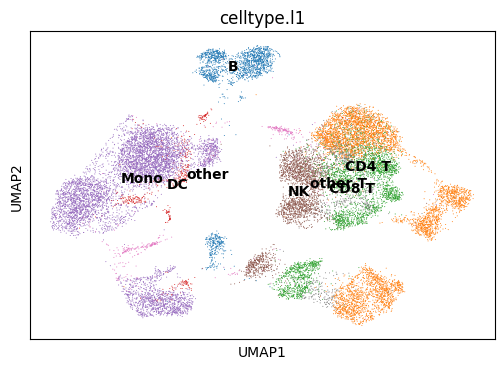

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


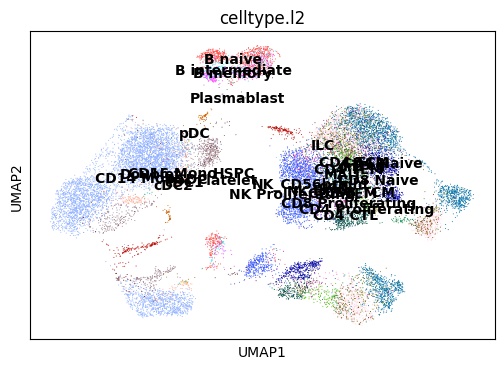

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


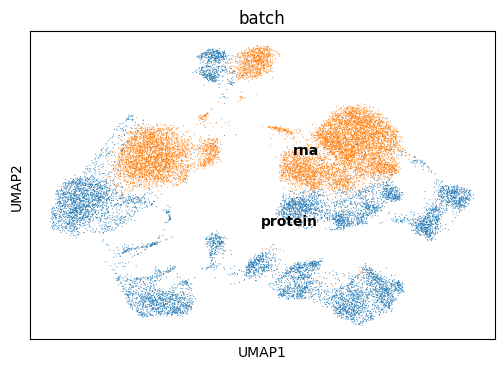

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


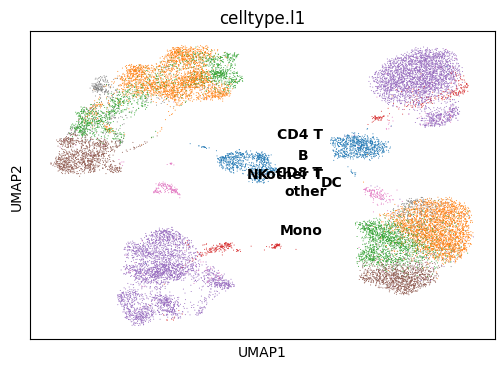

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


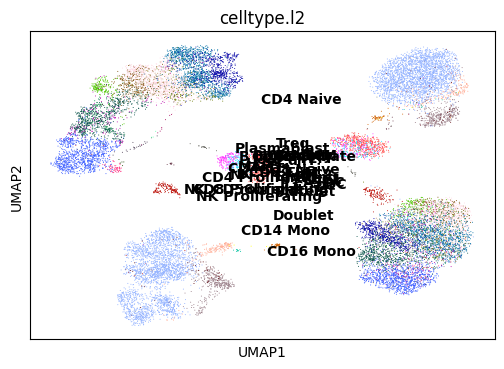

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


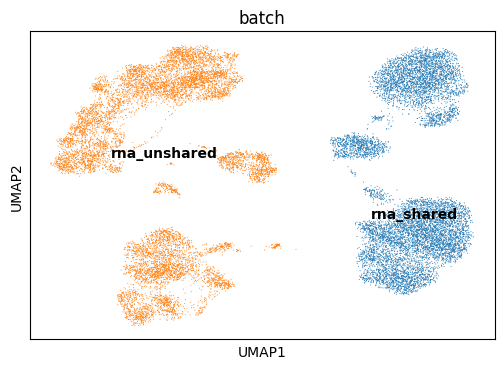

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


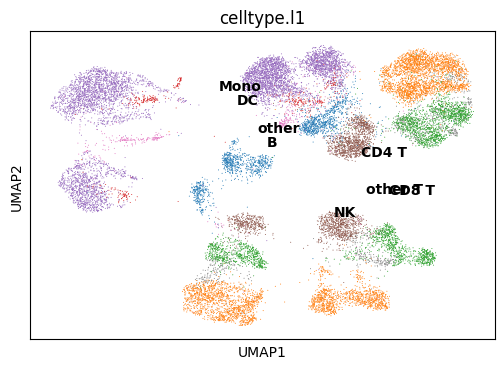

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


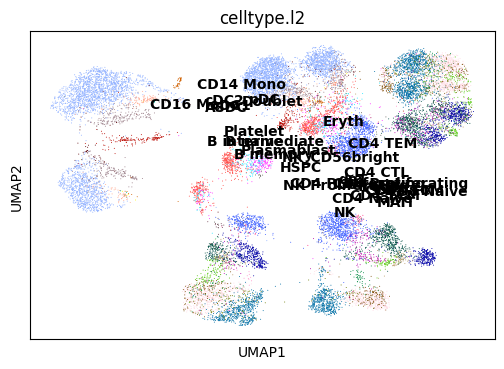

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


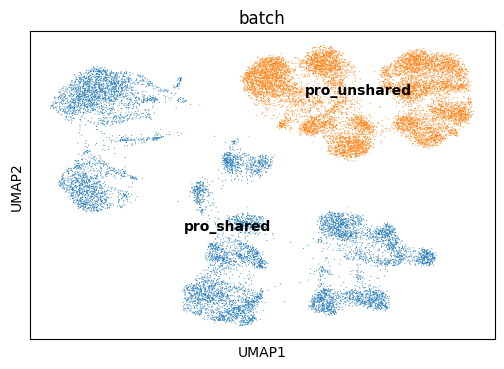

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For All matchings: lv1 matching acc: 0.692,
lv2 matching acc: 0.492.
For All matchings: FOSCTTM score: 0.28736935, 
Knn Alignment score: [0.0014 0.0022 0.0025 0.0032 0.0037 0.0045 0.005  0.0058 0.0065 0.0077
 0.008  0.0085 0.0089 0.0102 0.0109 0.0119 0.0129 0.0142 0.0147 0.0157
 0.0164 0.0172 0.0183 0.019  0.0197]
For All matchings: Silhouette F1 score for lv1: 0.48502948751377606, 
Silhouette F1 score for lv2: 0.4723736686770469



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  3.9614652395248413
Matchings are reduced to 5000 after filtering...


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:423: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[matchings[0]], labels_l1[matchings[1]])
C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For only filtered matchings: lv1 matching acc: 0.793,
lv2 matching acc: 0.590.



Matches are being propagated....


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:460: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[filtered_matchings[0]], labels_l1[filtered_matchings[1]])
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scipy\sparse\_index.py:143: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


Done!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For all matchings after propagation: lv1 matching acc: 0.743,
lv2 matching acc: 0.509.


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:495: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[propagated_matchings[0]], labels_l1[propagated_matchings[1]])


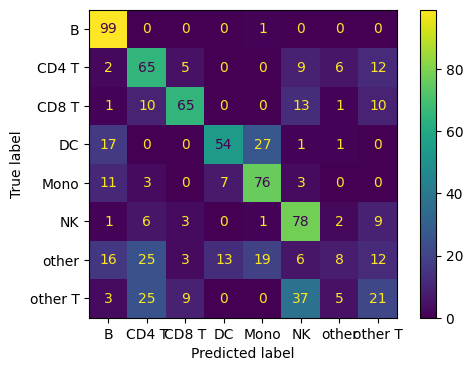

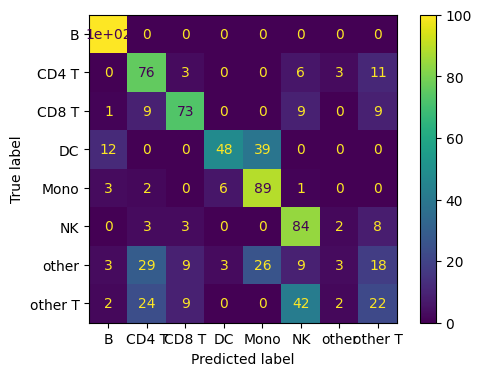

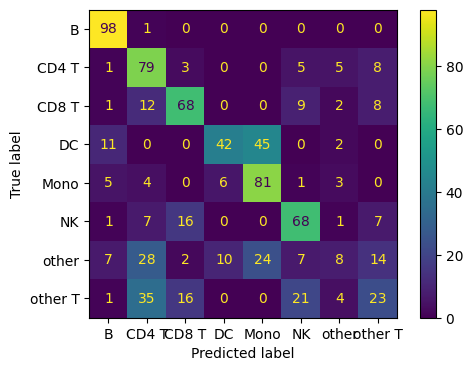

Epoch: 401: 0it [00:00, ?it/s]C:\Users\vinee\AppData\Local\Temp\ipykernel_2144\3129631169.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return {"x_unshared":self.unshared_data[idx], "x_shared":self.shared_data[idx], "l1":self.labels_l1[idx], "l2":self.labels_l2[idx], "mean": self.local_mean[idx], "var": self.local_var[idx], "batch": self.batch[idx]}
Epoch: 401: 40it [00:11,  3.37it/s]


RNA Recon Loss: 2.0389, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4526, Protein Recon Loss: 0.4910, Protein KL Div Back Pro: 0.8542, Protein KL Div Z: 0.6371, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5693, Shared Recon Loss Gene: 0.2619, Shared Recon Loss Protein: 1.8096 Cross Loss Protein: 0.5428


Epoch: 402: 40it [00:11,  3.41it/s]


RNA Recon Loss: 2.0376, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4526, Protein Recon Loss: 0.4906, Protein KL Div Back Pro: 0.8549, Protein KL Div Z: 0.6381, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5695, Shared Recon Loss Gene: 0.2622, Shared Recon Loss Protein: 1.8078 Cross Loss Protein: 0.5424


Epoch: 403: 40it [00:11,  3.40it/s]


RNA Recon Loss: 2.0391, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4519, Protein Recon Loss: 0.4899, Protein KL Div Back Pro: 0.8537, Protein KL Div Z: 0.6379, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5699, Shared Recon Loss Gene: 0.2625, Shared Recon Loss Protein: 1.8075 Cross Loss Protein: 0.5421


Epoch: 404: 40it [00:11,  3.36it/s]


RNA Recon Loss: 2.0344, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4504, Protein Recon Loss: 0.4898, Protein KL Div Back Pro: 0.8556, Protein KL Div Z: 0.6397, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5695, Shared Recon Loss Gene: 0.2615, Shared Recon Loss Protein: 1.8059 Cross Loss Protein: 0.5418


Epoch: 405: 40it [00:11,  3.35it/s]


RNA Recon Loss: 2.0376, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4506, Protein Recon Loss: 0.4913, Protein KL Div Back Pro: 0.8521, Protein KL Div Z: 0.6383, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5694, Shared Recon Loss Gene: 0.2631, Shared Recon Loss Protein: 1.8074 Cross Loss Protein: 0.5427


Epoch: 406: 40it [00:11,  3.34it/s]


RNA Recon Loss: 2.0367, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4515, Protein Recon Loss: 0.4908, Protein KL Div Back Pro: 0.8521, Protein KL Div Z: 0.6372, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5687, Shared Recon Loss Gene: 0.2624, Shared Recon Loss Protein: 1.8094 Cross Loss Protein: 0.5426


Epoch: 407: 40it [00:11,  3.39it/s]


RNA Recon Loss: 2.0355, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4508, Protein Recon Loss: 0.4900, Protein KL Div Back Pro: 0.8522, Protein KL Div Z: 0.6394, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5699, Shared Recon Loss Gene: 0.2615, Shared Recon Loss Protein: 1.8079 Cross Loss Protein: 0.5418


Epoch: 408: 40it [00:12,  3.31it/s]


RNA Recon Loss: 2.0309, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4497, Protein Recon Loss: 0.4897, Protein KL Div Back Pro: 0.8509, Protein KL Div Z: 0.6389, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5692, Shared Recon Loss Gene: 0.2610, Shared Recon Loss Protein: 1.8093 Cross Loss Protein: 0.5427


Epoch: 409: 40it [00:11,  3.36it/s]


RNA Recon Loss: 2.0335, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4506, Protein Recon Loss: 0.4922, Protein KL Div Back Pro: 0.8505, Protein KL Div Z: 0.6394, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5688, Shared Recon Loss Gene: 0.2620, Shared Recon Loss Protein: 1.8109 Cross Loss Protein: 0.5436


Epoch: 410: 40it [00:11,  3.37it/s]


RNA Recon Loss: 2.0340, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4500, Protein Recon Loss: 0.4905, Protein KL Div Back Pro: 0.8494, Protein KL Div Z: 0.6379, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5691, Shared Recon Loss Gene: 0.2617, Shared Recon Loss Protein: 1.8075 Cross Loss Protein: 0.5422


Epoch: 411: 40it [00:12,  3.33it/s]


RNA Recon Loss: 2.0379, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4496, Protein Recon Loss: 0.4922, Protein KL Div Back Pro: 0.8464, Protein KL Div Z: 0.6359, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5684, Shared Recon Loss Gene: 0.2623, Shared Recon Loss Protein: 1.8105 Cross Loss Protein: 0.5441


Epoch: 412: 40it [00:12,  3.32it/s]


RNA Recon Loss: 2.0375, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4504, Protein Recon Loss: 0.4921, Protein KL Div Back Pro: 0.8564, Protein KL Div Z: 0.6371, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5698, Shared Recon Loss Gene: 0.2624, Shared Recon Loss Protein: 1.8110 Cross Loss Protein: 0.5438


Epoch: 413: 40it [00:11,  3.35it/s]


RNA Recon Loss: 2.0378, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4504, Protein Recon Loss: 0.4902, Protein KL Div Back Pro: 0.8548, Protein KL Div Z: 0.6371, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5692, Shared Recon Loss Gene: 0.2623, Shared Recon Loss Protein: 1.8094 Cross Loss Protein: 0.5428


Epoch: 414: 40it [00:11,  3.36it/s]


RNA Recon Loss: 2.0410, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4502, Protein Recon Loss: 0.4894, Protein KL Div Back Pro: 0.8540, Protein KL Div Z: 0.6362, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5693, Shared Recon Loss Gene: 0.2623, Shared Recon Loss Protein: 1.8061 Cross Loss Protein: 0.5417


Epoch: 415: 40it [00:11,  3.33it/s]


RNA Recon Loss: 2.0352, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4502, Protein Recon Loss: 0.4901, Protein KL Div Back Pro: 0.8521, Protein KL Div Z: 0.6383, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5683, Shared Recon Loss Gene: 0.2617, Shared Recon Loss Protein: 1.8077 Cross Loss Protein: 0.5424


Epoch: 416: 40it [00:12,  3.30it/s]


RNA Recon Loss: 2.0484, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4494, Protein Recon Loss: 0.4907, Protein KL Div Back Pro: 0.8535, Protein KL Div Z: 0.6381, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5681, Shared Recon Loss Gene: 0.2622, Shared Recon Loss Protein: 1.8058 Cross Loss Protein: 0.5416


Epoch: 417: 40it [00:12,  3.31it/s]


RNA Recon Loss: 2.0379, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4519, Protein Recon Loss: 0.4921, Protein KL Div Back Pro: 0.8471, Protein KL Div Z: 0.6345, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5671, Shared Recon Loss Gene: 0.2619, Shared Recon Loss Protein: 1.8105 Cross Loss Protein: 0.5426


Epoch: 418: 40it [00:12,  3.27it/s]


RNA Recon Loss: 2.0334, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4497, Protein Recon Loss: 0.4900, Protein KL Div Back Pro: 0.8501, Protein KL Div Z: 0.6346, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5675, Shared Recon Loss Gene: 0.2619, Shared Recon Loss Protein: 1.8065 Cross Loss Protein: 0.5414


Epoch: 419: 40it [00:11,  3.36it/s]


RNA Recon Loss: 2.0385, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4495, Protein Recon Loss: 0.4906, Protein KL Div Back Pro: 0.8540, Protein KL Div Z: 0.6360, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5668, Shared Recon Loss Gene: 0.2629, Shared Recon Loss Protein: 1.8084 Cross Loss Protein: 0.5429


Epoch: 420: 40it [00:12,  3.28it/s]


RNA Recon Loss: 2.0319, RNA KL Div L: 0.0151, RNA KL Div Z: 0.4482, Protein Recon Loss: 0.4904, Protein KL Div Back Pro: 0.8582, Protein KL Div Z: 0.6380, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5687, Shared Recon Loss Gene: 0.2617, Shared Recon Loss Protein: 1.8097 Cross Loss Protein: 0.5426


Epoch: 421: 40it [00:12,  3.27it/s]


RNA Recon Loss: 2.0329, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4498, Protein Recon Loss: 0.4901, Protein KL Div Back Pro: 0.8502, Protein KL Div Z: 0.6350, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5675, Shared Recon Loss Gene: 0.2618, Shared Recon Loss Protein: 1.8071 Cross Loss Protein: 0.5417


Epoch: 422: 40it [00:12,  3.31it/s]


RNA Recon Loss: 2.0331, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4497, Protein Recon Loss: 0.4900, Protein KL Div Back Pro: 0.8511, Protein KL Div Z: 0.6348, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5681, Shared Recon Loss Gene: 0.2611, Shared Recon Loss Protein: 1.8076 Cross Loss Protein: 0.5424


Epoch: 423: 40it [00:11,  3.35it/s]


RNA Recon Loss: 2.0434, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4495, Protein Recon Loss: 0.4900, Protein KL Div Back Pro: 0.8503, Protein KL Div Z: 0.6351, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5692, Shared Recon Loss Gene: 0.2628, Shared Recon Loss Protein: 1.8064 Cross Loss Protein: 0.5423


Epoch: 424: 40it [00:12,  3.33it/s]


RNA Recon Loss: 2.0365, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4493, Protein Recon Loss: 0.4901, Protein KL Div Back Pro: 0.8470, Protein KL Div Z: 0.6363, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5666, Shared Recon Loss Gene: 0.2618, Shared Recon Loss Protein: 1.8072 Cross Loss Protein: 0.5421


Epoch: 425: 40it [00:11,  3.41it/s]


RNA Recon Loss: 2.0342, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4480, Protein Recon Loss: 0.4908, Protein KL Div Back Pro: 0.8409, Protein KL Div Z: 0.6346, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5676, Shared Recon Loss Gene: 0.2616, Shared Recon Loss Protein: 1.8057 Cross Loss Protein: 0.5427


Epoch: 426: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.0386, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4489, Protein Recon Loss: 0.4898, Protein KL Div Back Pro: 0.8442, Protein KL Div Z: 0.6351, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5678, Shared Recon Loss Gene: 0.2623, Shared Recon Loss Protein: 1.8061 Cross Loss Protein: 0.5420


Epoch: 427: 40it [00:11,  3.35it/s]


RNA Recon Loss: 2.0289, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4481, Protein Recon Loss: 0.4900, Protein KL Div Back Pro: 0.8428, Protein KL Div Z: 0.6347, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5666, Shared Recon Loss Gene: 0.2607, Shared Recon Loss Protein: 1.8075 Cross Loss Protein: 0.5421


Epoch: 428: 40it [00:12,  3.30it/s]


RNA Recon Loss: 2.0318, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4484, Protein Recon Loss: 0.4897, Protein KL Div Back Pro: 0.8437, Protein KL Div Z: 0.6349, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5672, Shared Recon Loss Gene: 0.2617, Shared Recon Loss Protein: 1.8101 Cross Loss Protein: 0.5425


Epoch: 429: 40it [00:11,  3.37it/s]


RNA Recon Loss: 2.0364, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4467, Protein Recon Loss: 0.4899, Protein KL Div Back Pro: 0.8468, Protein KL Div Z: 0.6353, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5670, Shared Recon Loss Gene: 0.2621, Shared Recon Loss Protein: 1.8064 Cross Loss Protein: 0.5422


Epoch: 430: 40it [00:11,  3.37it/s]


RNA Recon Loss: 2.0285, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4473, Protein Recon Loss: 0.4901, Protein KL Div Back Pro: 0.8473, Protein KL Div Z: 0.6354, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5670, Shared Recon Loss Gene: 0.2611, Shared Recon Loss Protein: 1.8092 Cross Loss Protein: 0.5428


Epoch: 431: 40it [00:11,  3.34it/s]


RNA Recon Loss: 2.0382, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4483, Protein Recon Loss: 0.4899, Protein KL Div Back Pro: 0.8456, Protein KL Div Z: 0.6351, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5673, Shared Recon Loss Gene: 0.2620, Shared Recon Loss Protein: 1.8060 Cross Loss Protein: 0.5421


Epoch: 432: 40it [00:11,  3.37it/s]


RNA Recon Loss: 2.0360, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4480, Protein Recon Loss: 0.4904, Protein KL Div Back Pro: 0.8489, Protein KL Div Z: 0.6368, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5664, Shared Recon Loss Gene: 0.2619, Shared Recon Loss Protein: 1.8064 Cross Loss Protein: 0.5418


Epoch: 433: 40it [00:11,  3.34it/s]


RNA Recon Loss: 2.0311, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4474, Protein Recon Loss: 0.4904, Protein KL Div Back Pro: 0.8484, Protein KL Div Z: 0.6342, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5661, Shared Recon Loss Gene: 0.2618, Shared Recon Loss Protein: 1.8083 Cross Loss Protein: 0.5425


Epoch: 434: 40it [00:11,  3.38it/s]


RNA Recon Loss: 2.0288, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4466, Protein Recon Loss: 0.4901, Protein KL Div Back Pro: 0.8484, Protein KL Div Z: 0.6354, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5658, Shared Recon Loss Gene: 0.2612, Shared Recon Loss Protein: 1.8076 Cross Loss Protein: 0.5424


Epoch: 435: 40it [00:11,  3.34it/s]


RNA Recon Loss: 2.0314, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4468, Protein Recon Loss: 0.4892, Protein KL Div Back Pro: 0.8491, Protein KL Div Z: 0.6336, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5662, Shared Recon Loss Gene: 0.2615, Shared Recon Loss Protein: 1.8063 Cross Loss Protein: 0.5419


Epoch: 436: 40it [00:11,  3.37it/s]


RNA Recon Loss: 2.0330, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4468, Protein Recon Loss: 0.4896, Protein KL Div Back Pro: 0.8495, Protein KL Div Z: 0.6354, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5663, Shared Recon Loss Gene: 0.2616, Shared Recon Loss Protein: 1.8075 Cross Loss Protein: 0.5422


Epoch: 437: 40it [00:11,  3.38it/s]


RNA Recon Loss: 2.0356, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4455, Protein Recon Loss: 0.4906, Protein KL Div Back Pro: 0.8485, Protein KL Div Z: 0.6351, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5649, Shared Recon Loss Gene: 0.2617, Shared Recon Loss Protein: 1.8084 Cross Loss Protein: 0.5430


Epoch: 438: 40it [00:11,  3.36it/s]


RNA Recon Loss: 2.0423, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4465, Protein Recon Loss: 0.4905, Protein KL Div Back Pro: 0.8495, Protein KL Div Z: 0.6338, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5647, Shared Recon Loss Gene: 0.2620, Shared Recon Loss Protein: 1.8103 Cross Loss Protein: 0.5430


Epoch: 439: 40it [00:12,  3.30it/s]


RNA Recon Loss: 2.0306, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4470, Protein Recon Loss: 0.4902, Protein KL Div Back Pro: 0.8488, Protein KL Div Z: 0.6344, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5642, Shared Recon Loss Gene: 0.2615, Shared Recon Loss Protein: 1.8089 Cross Loss Protein: 0.5430


Epoch: 440: 40it [00:12,  3.32it/s]


RNA Recon Loss: 2.0260, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4469, Protein Recon Loss: 0.4892, Protein KL Div Back Pro: 0.8454, Protein KL Div Z: 0.6316, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5650, Shared Recon Loss Gene: 0.2606, Shared Recon Loss Protein: 1.8069 Cross Loss Protein: 0.5418


Epoch: 441: 40it [00:12,  3.32it/s]


RNA Recon Loss: 2.0309, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4476, Protein Recon Loss: 0.4918, Protein KL Div Back Pro: 0.8528, Protein KL Div Z: 0.6353, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5637, Shared Recon Loss Gene: 0.2611, Shared Recon Loss Protein: 1.8155 Cross Loss Protein: 0.5437


Epoch: 442: 40it [00:12,  3.33it/s]


RNA Recon Loss: 2.0314, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4466, Protein Recon Loss: 0.4921, Protein KL Div Back Pro: 0.8594, Protein KL Div Z: 0.6343, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5690, Shared Recon Loss Gene: 0.2625, Shared Recon Loss Protein: 1.8157 Cross Loss Protein: 0.5432


Epoch: 443: 40it [00:12,  3.32it/s]


RNA Recon Loss: 2.0312, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4464, Protein Recon Loss: 0.4908, Protein KL Div Back Pro: 0.8510, Protein KL Div Z: 0.6322, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5655, Shared Recon Loss Gene: 0.2617, Shared Recon Loss Protein: 1.8090 Cross Loss Protein: 0.5424


Epoch: 444: 40it [00:11,  3.33it/s]


RNA Recon Loss: 2.0280, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4456, Protein Recon Loss: 0.4907, Protein KL Div Back Pro: 0.8500, Protein KL Div Z: 0.6319, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5645, Shared Recon Loss Gene: 0.2616, Shared Recon Loss Protein: 1.8093 Cross Loss Protein: 0.5425


Epoch: 445: 40it [00:11,  3.34it/s]


RNA Recon Loss: 2.0287, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4457, Protein Recon Loss: 0.4898, Protein KL Div Back Pro: 0.8495, Protein KL Div Z: 0.6333, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5655, Shared Recon Loss Gene: 0.2617, Shared Recon Loss Protein: 1.8079 Cross Loss Protein: 0.5424


Epoch: 446: 40it [00:12,  3.31it/s]


RNA Recon Loss: 2.0264, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4459, Protein Recon Loss: 0.4902, Protein KL Div Back Pro: 0.8488, Protein KL Div Z: 0.6328, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5644, Shared Recon Loss Gene: 0.2610, Shared Recon Loss Protein: 1.8087 Cross Loss Protein: 0.5432


Epoch: 447: 40it [00:12,  3.33it/s]


RNA Recon Loss: 2.0268, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4463, Protein Recon Loss: 0.4900, Protein KL Div Back Pro: 0.8524, Protein KL Div Z: 0.6333, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5658, Shared Recon Loss Gene: 0.2616, Shared Recon Loss Protein: 1.8079 Cross Loss Protein: 0.5422


Epoch: 448: 40it [00:11,  3.34it/s]


RNA Recon Loss: 2.0281, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4464, Protein Recon Loss: 0.4901, Protein KL Div Back Pro: 0.8468, Protein KL Div Z: 0.6314, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5647, Shared Recon Loss Gene: 0.2620, Shared Recon Loss Protein: 1.8070 Cross Loss Protein: 0.5418


Epoch: 449: 40it [00:12,  3.32it/s]


RNA Recon Loss: 2.0288, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4461, Protein Recon Loss: 0.4897, Protein KL Div Back Pro: 0.8485, Protein KL Div Z: 0.6319, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5649, Shared Recon Loss Gene: 0.2611, Shared Recon Loss Protein: 1.8055 Cross Loss Protein: 0.5416


Epoch: 450: 40it [00:11,  3.34it/s]


RNA Recon Loss: 2.0306, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4459, Protein Recon Loss: 0.4893, Protein KL Div Back Pro: 0.8492, Protein KL Div Z: 0.6326, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5643, Shared Recon Loss Gene: 0.2615, Shared Recon Loss Protein: 1.8066 Cross Loss Protein: 0.5419


Epoch: 451: 40it [00:12,  3.33it/s]


RNA Recon Loss: 2.0395, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4461, Protein Recon Loss: 0.4902, Protein KL Div Back Pro: 0.8489, Protein KL Div Z: 0.6332, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5649, Shared Recon Loss Gene: 0.2631, Shared Recon Loss Protein: 1.8072 Cross Loss Protein: 0.5427


Epoch: 452: 40it [00:12,  3.33it/s]


RNA Recon Loss: 2.0329, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4463, Protein Recon Loss: 0.4895, Protein KL Div Back Pro: 0.8477, Protein KL Div Z: 0.6317, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5641, Shared Recon Loss Gene: 0.2619, Shared Recon Loss Protein: 1.8068 Cross Loss Protein: 0.5423


Epoch: 453: 40it [00:11,  3.37it/s]


RNA Recon Loss: 2.0330, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4451, Protein Recon Loss: 0.4894, Protein KL Div Back Pro: 0.8419, Protein KL Div Z: 0.6318, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5631, Shared Recon Loss Gene: 0.2612, Shared Recon Loss Protein: 1.8055 Cross Loss Protein: 0.5422


Epoch: 454: 40it [00:12,  3.19it/s]


RNA Recon Loss: 2.0320, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4456, Protein Recon Loss: 0.4891, Protein KL Div Back Pro: 0.8459, Protein KL Div Z: 0.6323, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5625, Shared Recon Loss Gene: 0.2620, Shared Recon Loss Protein: 1.8052 Cross Loss Protein: 0.5415


Epoch: 455: 40it [00:11,  3.34it/s]


RNA Recon Loss: 2.0332, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4461, Protein Recon Loss: 0.4923, Protein KL Div Back Pro: 0.8464, Protein KL Div Z: 0.6313, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5634, Shared Recon Loss Gene: 0.2625, Shared Recon Loss Protein: 1.8089 Cross Loss Protein: 0.5425


Epoch: 456: 40it [00:11,  3.37it/s]


RNA Recon Loss: 2.0321, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4456, Protein Recon Loss: 0.4913, Protein KL Div Back Pro: 0.8513, Protein KL Div Z: 0.6306, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5636, Shared Recon Loss Gene: 0.2616, Shared Recon Loss Protein: 1.8093 Cross Loss Protein: 0.5431


Epoch: 457: 40it [00:11,  3.34it/s]


RNA Recon Loss: 2.0260, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4449, Protein Recon Loss: 0.4894, Protein KL Div Back Pro: 0.8466, Protein KL Div Z: 0.6306, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5625, Shared Recon Loss Gene: 0.2612, Shared Recon Loss Protein: 1.8070 Cross Loss Protein: 0.5423


Epoch: 458: 40it [00:12,  3.29it/s]


RNA Recon Loss: 2.0273, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4458, Protein Recon Loss: 0.4901, Protein KL Div Back Pro: 0.8461, Protein KL Div Z: 0.6310, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5628, Shared Recon Loss Gene: 0.2611, Shared Recon Loss Protein: 1.8066 Cross Loss Protein: 0.5429


Epoch: 459: 40it [00:12,  3.32it/s]


RNA Recon Loss: 2.0264, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4455, Protein Recon Loss: 0.4897, Protein KL Div Back Pro: 0.8472, Protein KL Div Z: 0.6319, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5628, Shared Recon Loss Gene: 0.2610, Shared Recon Loss Protein: 1.8059 Cross Loss Protein: 0.5421


Epoch: 460: 40it [00:12,  3.33it/s]


RNA Recon Loss: 2.0272, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4459, Protein Recon Loss: 0.4894, Protein KL Div Back Pro: 0.8484, Protein KL Div Z: 0.6321, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5626, Shared Recon Loss Gene: 0.2610, Shared Recon Loss Protein: 1.8050 Cross Loss Protein: 0.5414


Epoch: 461: 40it [00:12,  3.31it/s]


RNA Recon Loss: 2.0353, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4462, Protein Recon Loss: 0.4903, Protein KL Div Back Pro: 0.8476, Protein KL Div Z: 0.6317, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5628, Shared Recon Loss Gene: 0.2614, Shared Recon Loss Protein: 1.8054 Cross Loss Protein: 0.5427


Epoch: 462: 40it [00:12,  3.31it/s]


RNA Recon Loss: 2.0332, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4453, Protein Recon Loss: 0.4895, Protein KL Div Back Pro: 0.8463, Protein KL Div Z: 0.6318, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5633, Shared Recon Loss Gene: 0.2614, Shared Recon Loss Protein: 1.8054 Cross Loss Protein: 0.5414


Epoch: 463: 40it [00:11,  3.34it/s]


RNA Recon Loss: 2.0251, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4453, Protein Recon Loss: 0.4894, Protein KL Div Back Pro: 0.8481, Protein KL Div Z: 0.6335, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5622, Shared Recon Loss Gene: 0.2608, Shared Recon Loss Protein: 1.8060 Cross Loss Protein: 0.5417


Epoch: 464: 40it [00:12,  3.30it/s]


RNA Recon Loss: 2.0306, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4463, Protein Recon Loss: 0.4925, Protein KL Div Back Pro: 0.8467, Protein KL Div Z: 0.6303, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5618, Shared Recon Loss Gene: 0.2621, Shared Recon Loss Protein: 1.8118 Cross Loss Protein: 0.5441


Epoch: 465: 40it [00:12,  3.33it/s]


RNA Recon Loss: 2.0261, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4447, Protein Recon Loss: 0.4906, Protein KL Div Back Pro: 0.8492, Protein KL Div Z: 0.6296, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5633, Shared Recon Loss Gene: 0.2618, Shared Recon Loss Protein: 1.8054 Cross Loss Protein: 0.5428


Epoch: 466: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.0266, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4443, Protein Recon Loss: 0.4899, Protein KL Div Back Pro: 0.8451, Protein KL Div Z: 0.6283, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5623, Shared Recon Loss Gene: 0.2616, Shared Recon Loss Protein: 1.8076 Cross Loss Protein: 0.5418


Epoch: 467: 40it [00:12,  3.24it/s]


RNA Recon Loss: 2.0323, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4443, Protein Recon Loss: 0.4899, Protein KL Div Back Pro: 0.8489, Protein KL Div Z: 0.6295, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5625, Shared Recon Loss Gene: 0.2614, Shared Recon Loss Protein: 1.8072 Cross Loss Protein: 0.5425


Epoch: 468: 40it [00:12,  3.33it/s]


RNA Recon Loss: 2.0254, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4445, Protein Recon Loss: 0.4897, Protein KL Div Back Pro: 0.8487, Protein KL Div Z: 0.6304, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5625, Shared Recon Loss Gene: 0.2612, Shared Recon Loss Protein: 1.8066 Cross Loss Protein: 0.5422


Epoch: 469: 40it [00:12,  3.30it/s]


RNA Recon Loss: 2.0276, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4436, Protein Recon Loss: 0.4906, Protein KL Div Back Pro: 0.8492, Protein KL Div Z: 0.6296, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5606, Shared Recon Loss Gene: 0.2618, Shared Recon Loss Protein: 1.8054 Cross Loss Protein: 0.5419


Epoch: 470: 40it [00:12,  3.31it/s]


RNA Recon Loss: 2.0347, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4444, Protein Recon Loss: 0.4911, Protein KL Div Back Pro: 0.8502, Protein KL Div Z: 0.6291, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5616, Shared Recon Loss Gene: 0.2616, Shared Recon Loss Protein: 1.8100 Cross Loss Protein: 0.5423


Epoch: 471: 40it [00:12,  3.31it/s]


RNA Recon Loss: 2.0252, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4447, Protein Recon Loss: 0.4903, Protein KL Div Back Pro: 0.8500, Protein KL Div Z: 0.6281, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5617, Shared Recon Loss Gene: 0.2610, Shared Recon Loss Protein: 1.8073 Cross Loss Protein: 0.5421


Epoch: 472: 40it [00:11,  3.36it/s]


RNA Recon Loss: 2.0353, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4442, Protein Recon Loss: 0.4903, Protein KL Div Back Pro: 0.8498, Protein KL Div Z: 0.6281, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5606, Shared Recon Loss Gene: 0.2617, Shared Recon Loss Protein: 1.8093 Cross Loss Protein: 0.5428


Epoch: 473: 40it [00:12,  3.32it/s]


RNA Recon Loss: 2.0264, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4449, Protein Recon Loss: 0.4902, Protein KL Div Back Pro: 0.8486, Protein KL Div Z: 0.6285, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5617, Shared Recon Loss Gene: 0.2606, Shared Recon Loss Protein: 1.8089 Cross Loss Protein: 0.5421


Epoch: 474: 40it [00:12,  3.33it/s]


RNA Recon Loss: 2.0260, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4447, Protein Recon Loss: 0.4905, Protein KL Div Back Pro: 0.8497, Protein KL Div Z: 0.6294, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5621, Shared Recon Loss Gene: 0.2610, Shared Recon Loss Protein: 1.8101 Cross Loss Protein: 0.5434


Epoch: 475: 40it [00:11,  3.33it/s]


RNA Recon Loss: 2.0286, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4436, Protein Recon Loss: 0.4892, Protein KL Div Back Pro: 0.8466, Protein KL Div Z: 0.6271, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5606, Shared Recon Loss Gene: 0.2614, Shared Recon Loss Protein: 1.8056 Cross Loss Protein: 0.5420


Epoch: 476: 40it [00:12,  3.27it/s]


RNA Recon Loss: 2.0223, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4440, Protein Recon Loss: 0.4897, Protein KL Div Back Pro: 0.8446, Protein KL Div Z: 0.6280, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5609, Shared Recon Loss Gene: 0.2607, Shared Recon Loss Protein: 1.8059 Cross Loss Protein: 0.5419


Epoch: 477: 40it [00:11,  3.35it/s]


RNA Recon Loss: 2.0329, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4443, Protein Recon Loss: 0.4895, Protein KL Div Back Pro: 0.8444, Protein KL Div Z: 0.6292, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5606, Shared Recon Loss Gene: 0.2615, Shared Recon Loss Protein: 1.8062 Cross Loss Protein: 0.5417


Epoch: 478: 40it [00:11,  3.37it/s]


RNA Recon Loss: 2.0252, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4439, Protein Recon Loss: 0.4899, Protein KL Div Back Pro: 0.8452, Protein KL Div Z: 0.6290, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5603, Shared Recon Loss Gene: 0.2610, Shared Recon Loss Protein: 1.8059 Cross Loss Protein: 0.5421


Epoch: 479: 40it [00:12,  3.31it/s]


RNA Recon Loss: 2.0275, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4435, Protein Recon Loss: 0.4896, Protein KL Div Back Pro: 0.8464, Protein KL Div Z: 0.6303, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5608, Shared Recon Loss Gene: 0.2618, Shared Recon Loss Protein: 1.8060 Cross Loss Protein: 0.5428


Epoch: 480: 40it [00:12,  3.30it/s]


RNA Recon Loss: 2.0267, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4431, Protein Recon Loss: 0.4898, Protein KL Div Back Pro: 0.8442, Protein KL Div Z: 0.6292, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5613, Shared Recon Loss Gene: 0.2610, Shared Recon Loss Protein: 1.8064 Cross Loss Protein: 0.5418


Epoch: 481: 40it [00:12,  3.33it/s]


RNA Recon Loss: 2.0272, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4433, Protein Recon Loss: 0.4898, Protein KL Div Back Pro: 0.8439, Protein KL Div Z: 0.6288, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5612, Shared Recon Loss Gene: 0.2614, Shared Recon Loss Protein: 1.8062 Cross Loss Protein: 0.5420


Epoch: 482: 40it [00:12,  3.32it/s]


RNA Recon Loss: 2.0283, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4432, Protein Recon Loss: 0.4912, Protein KL Div Back Pro: 0.8459, Protein KL Div Z: 0.6285, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5596, Shared Recon Loss Gene: 0.2611, Shared Recon Loss Protein: 1.8074 Cross Loss Protein: 0.5435


Epoch: 483: 40it [00:11,  3.35it/s]


RNA Recon Loss: 2.0238, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4435, Protein Recon Loss: 0.4901, Protein KL Div Back Pro: 0.8459, Protein KL Div Z: 0.6284, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5614, Shared Recon Loss Gene: 0.2606, Shared Recon Loss Protein: 1.8096 Cross Loss Protein: 0.5428


Epoch: 484: 40it [00:12,  3.30it/s]


RNA Recon Loss: 2.0253, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4428, Protein Recon Loss: 0.4899, Protein KL Div Back Pro: 0.8467, Protein KL Div Z: 0.6295, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5604, Shared Recon Loss Gene: 0.2613, Shared Recon Loss Protein: 1.8085 Cross Loss Protein: 0.5422


Epoch: 485: 40it [00:12,  3.31it/s]


RNA Recon Loss: 2.0278, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4430, Protein Recon Loss: 0.4901, Protein KL Div Back Pro: 0.8459, Protein KL Div Z: 0.6276, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5609, Shared Recon Loss Gene: 0.2617, Shared Recon Loss Protein: 1.8079 Cross Loss Protein: 0.5424


Epoch: 486: 40it [00:12,  3.32it/s]


RNA Recon Loss: 2.0258, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4432, Protein Recon Loss: 0.4901, Protein KL Div Back Pro: 0.8471, Protein KL Div Z: 0.6269, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5594, Shared Recon Loss Gene: 0.2604, Shared Recon Loss Protein: 1.8084 Cross Loss Protein: 0.5422


Epoch: 487: 40it [00:12,  3.33it/s]


RNA Recon Loss: 2.0253, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4423, Protein Recon Loss: 0.4896, Protein KL Div Back Pro: 0.8475, Protein KL Div Z: 0.6258, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5598, Shared Recon Loss Gene: 0.2609, Shared Recon Loss Protein: 1.8058 Cross Loss Protein: 0.5422


Epoch: 488: 40it [00:12,  3.32it/s]


RNA Recon Loss: 2.0256, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4430, Protein Recon Loss: 0.4887, Protein KL Div Back Pro: 0.8483, Protein KL Div Z: 0.6275, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5600, Shared Recon Loss Gene: 0.2605, Shared Recon Loss Protein: 1.8037 Cross Loss Protein: 0.5410


Epoch: 489: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.0341, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4432, Protein Recon Loss: 0.4898, Protein KL Div Back Pro: 0.8456, Protein KL Div Z: 0.6258, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5600, Shared Recon Loss Gene: 0.2617, Shared Recon Loss Protein: 1.8117 Cross Loss Protein: 0.5423


Epoch: 490: 40it [00:11,  3.34it/s]


RNA Recon Loss: 2.0236, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4419, Protein Recon Loss: 0.4897, Protein KL Div Back Pro: 0.8479, Protein KL Div Z: 0.6279, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5632, Shared Recon Loss Gene: 0.2613, Shared Recon Loss Protein: 1.8158 Cross Loss Protein: 0.5432


Epoch: 491: 40it [00:12,  3.32it/s]


RNA Recon Loss: 2.0273, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4427, Protein Recon Loss: 0.4903, Protein KL Div Back Pro: 0.8465, Protein KL Div Z: 0.6277, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5615, Shared Recon Loss Gene: 0.2609, Shared Recon Loss Protein: 1.8073 Cross Loss Protein: 0.5427


Epoch: 492: 40it [00:12,  3.32it/s]


RNA Recon Loss: 2.0314, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4420, Protein Recon Loss: 0.4891, Protein KL Div Back Pro: 0.8414, Protein KL Div Z: 0.6243, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5604, Shared Recon Loss Gene: 0.2611, Shared Recon Loss Protein: 1.8057 Cross Loss Protein: 0.5414


Epoch: 493: 40it [00:11,  3.36it/s]


RNA Recon Loss: 2.0329, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4427, Protein Recon Loss: 0.4908, Protein KL Div Back Pro: 0.8429, Protein KL Div Z: 0.6274, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5609, Shared Recon Loss Gene: 0.2615, Shared Recon Loss Protein: 1.8101 Cross Loss Protein: 0.5434


Epoch: 494: 40it [00:12,  3.33it/s]


RNA Recon Loss: 2.0262, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4417, Protein Recon Loss: 0.4905, Protein KL Div Back Pro: 0.8466, Protein KL Div Z: 0.6259, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5601, Shared Recon Loss Gene: 0.2602, Shared Recon Loss Protein: 1.8058 Cross Loss Protein: 0.5417


Epoch: 495: 40it [00:11,  3.34it/s]


RNA Recon Loss: 2.0263, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4426, Protein Recon Loss: 0.4899, Protein KL Div Back Pro: 0.8426, Protein KL Div Z: 0.6258, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5600, Shared Recon Loss Gene: 0.2610, Shared Recon Loss Protein: 1.8085 Cross Loss Protein: 0.5425


Epoch: 496: 40it [00:12,  3.30it/s]


RNA Recon Loss: 2.0387, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4418, Protein Recon Loss: 0.4909, Protein KL Div Back Pro: 0.8429, Protein KL Div Z: 0.6244, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5591, Shared Recon Loss Gene: 0.2626, Shared Recon Loss Protein: 1.8069 Cross Loss Protein: 0.5436


Epoch: 497: 40it [00:12,  3.33it/s]


RNA Recon Loss: 2.0230, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4427, Protein Recon Loss: 0.4894, Protein KL Div Back Pro: 0.8477, Protein KL Div Z: 0.6251, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5583, Shared Recon Loss Gene: 0.2606, Shared Recon Loss Protein: 1.8056 Cross Loss Protein: 0.5422


Epoch: 498: 40it [00:11,  3.36it/s]


RNA Recon Loss: 2.0261, RNA KL Div L: 0.0150, RNA KL Div Z: 0.4422, Protein Recon Loss: 0.4900, Protein KL Div Back Pro: 0.8448, Protein KL Div Z: 0.6257, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5583, Shared Recon Loss Gene: 0.2597, Shared Recon Loss Protein: 1.8049 Cross Loss Protein: 0.5421


Epoch: 499: 40it [00:12,  3.31it/s]


RNA Recon Loss: 2.0234, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4421, Protein Recon Loss: 0.4892, Protein KL Div Back Pro: 0.8438, Protein KL Div Z: 0.6252, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5583, Shared Recon Loss Gene: 0.2605, Shared Recon Loss Protein: 1.8078 Cross Loss Protein: 0.5420


Epoch: 500: 40it [00:13,  3.07it/s]


RNA Recon Loss: 2.0239, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4418, Protein Recon Loss: 0.4891, Protein KL Div Back Pro: 0.8433, Protein KL Div Z: 0.6245, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5588, Shared Recon Loss Gene: 0.2607, Shared Recon Loss Protein: 1.8075 Cross Loss Protein: 0.5422


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


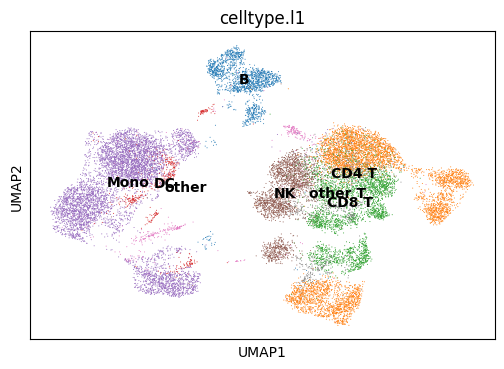

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


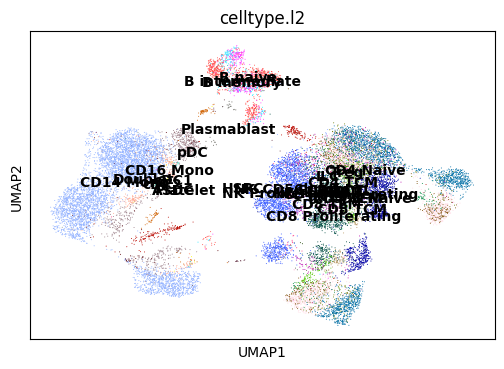

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


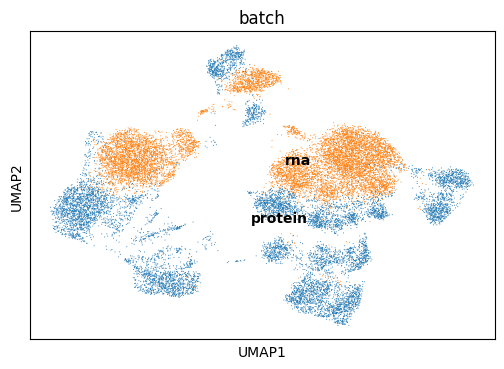

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


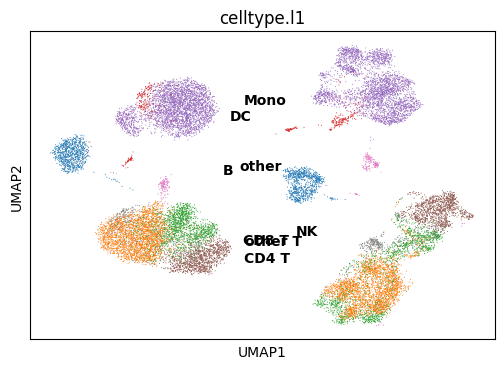

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


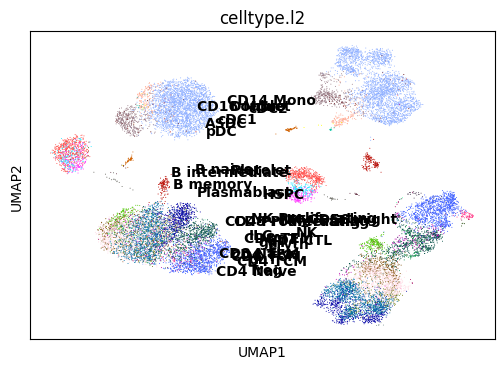

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


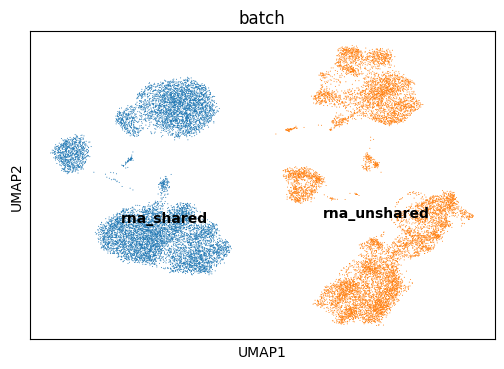

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


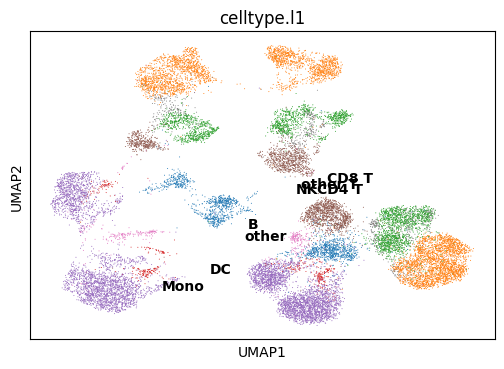

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


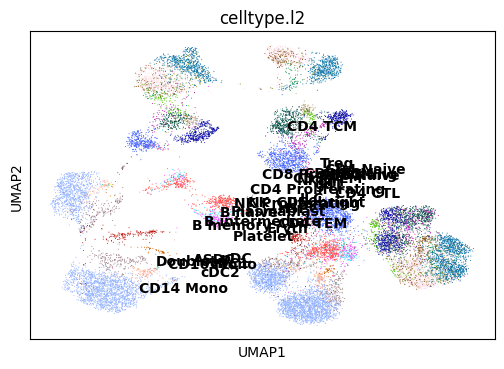

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


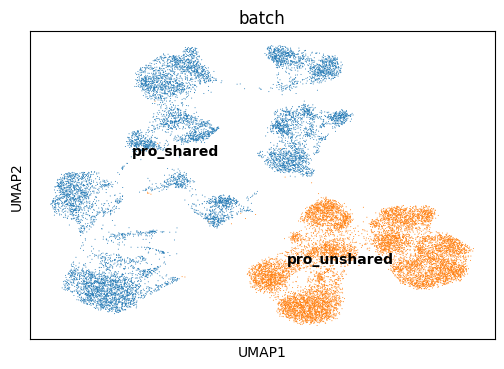

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For All matchings: lv1 matching acc: 0.692,
lv2 matching acc: 0.507.
For All matchings: FOSCTTM score: 0.28295008000000005, 
Knn Alignment score: [0.0014 0.0022 0.0027 0.0037 0.0044 0.0052 0.0057 0.0073 0.0082 0.0089
 0.0096 0.0102 0.0116 0.013  0.0135 0.0141 0.015  0.0162 0.017  0.018
 0.0188 0.0192 0.0202 0.0206 0.0217]
For All matchings: Silhouette F1 score for lv1: 0.4901305221325622, 
Silhouette F1 score for lv2: 0.47780316357126107



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  3.802458167076111
Matchings are reduced to 5000 after filtering...


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:423: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[matchings[0]], labels_l1[matchings[1]])
C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For only filtered matchings: lv1 matching acc: 0.795,
lv2 matching acc: 0.593.



Matches are being propagated....


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:460: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[filtered_matchings[0]], labels_l1[filtered_matchings[1]])
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scipy\sparse\_index.py:143: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


Done!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For all matchings after propagation: lv1 matching acc: 0.757,
lv2 matching acc: 0.564.


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:495: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[propagated_matchings[0]], labels_l1[propagated_matchings[1]])


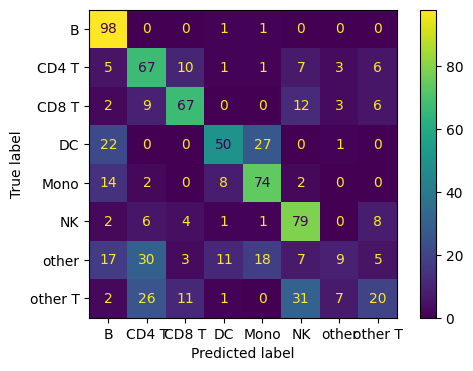

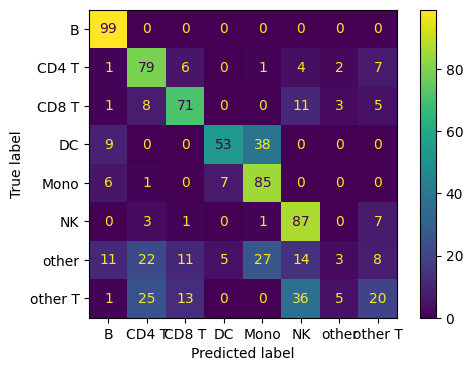

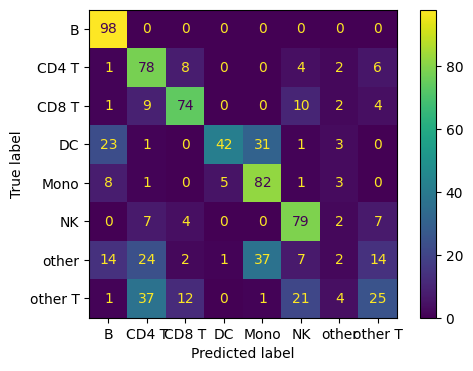

Epoch: 501: 0it [00:00, ?it/s]C:\Users\vinee\AppData\Local\Temp\ipykernel_2144\3129631169.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return {"x_unshared":self.unshared_data[idx], "x_shared":self.shared_data[idx], "l1":self.labels_l1[idx], "l2":self.labels_l2[idx], "mean": self.local_mean[idx], "var": self.local_var[idx], "batch": self.batch[idx]}
Epoch: 501: 40it [00:11,  3.45it/s]


RNA Recon Loss: 2.0275, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4422, Protein Recon Loss: 0.4892, Protein KL Div Back Pro: 0.8434, Protein KL Div Z: 0.6248, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5586, Shared Recon Loss Gene: 0.2616, Shared Recon Loss Protein: 1.8060 Cross Loss Protein: 0.5420


Epoch: 502: 40it [00:11,  3.37it/s]


RNA Recon Loss: 2.0295, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4419, Protein Recon Loss: 0.4900, Protein KL Div Back Pro: 0.8438, Protein KL Div Z: 0.6254, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5592, Shared Recon Loss Gene: 0.2615, Shared Recon Loss Protein: 1.8066 Cross Loss Protein: 0.5434


Epoch: 503: 40it [00:11,  3.39it/s]


RNA Recon Loss: 2.0277, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4419, Protein Recon Loss: 0.4901, Protein KL Div Back Pro: 0.8470, Protein KL Div Z: 0.6245, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5571, Shared Recon Loss Gene: 0.2622, Shared Recon Loss Protein: 1.8076 Cross Loss Protein: 0.5431


Epoch: 504: 40it [00:11,  3.36it/s]


RNA Recon Loss: 2.0251, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4408, Protein Recon Loss: 0.4904, Protein KL Div Back Pro: 0.8433, Protein KL Div Z: 0.6246, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5571, Shared Recon Loss Gene: 0.2616, Shared Recon Loss Protein: 1.8066 Cross Loss Protein: 0.5418


Epoch: 505: 40it [00:11,  3.36it/s]


RNA Recon Loss: 2.0203, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4419, Protein Recon Loss: 0.4907, Protein KL Div Back Pro: 0.8396, Protein KL Div Z: 0.6215, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5573, Shared Recon Loss Gene: 0.2603, Shared Recon Loss Protein: 1.8073 Cross Loss Protein: 0.5423


Epoch: 506: 40it [00:11,  3.34it/s]


RNA Recon Loss: 2.0312, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4410, Protein Recon Loss: 0.4894, Protein KL Div Back Pro: 0.8435, Protein KL Div Z: 0.6222, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5570, Shared Recon Loss Gene: 0.2621, Shared Recon Loss Protein: 1.8028 Cross Loss Protein: 0.5409


Epoch: 507: 40it [00:11,  3.36it/s]


RNA Recon Loss: 2.0267, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4410, Protein Recon Loss: 0.4910, Protein KL Div Back Pro: 0.8461, Protein KL Div Z: 0.6230, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5575, Shared Recon Loss Gene: 0.2607, Shared Recon Loss Protein: 1.8073 Cross Loss Protein: 0.5420


Epoch: 508: 40it [00:12,  3.23it/s]


RNA Recon Loss: 2.0236, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4411, Protein Recon Loss: 0.4910, Protein KL Div Back Pro: 0.8448, Protein KL Div Z: 0.6203, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5579, Shared Recon Loss Gene: 0.2605, Shared Recon Loss Protein: 1.8106 Cross Loss Protein: 0.5434


Epoch: 509: 40it [00:11,  3.36it/s]


RNA Recon Loss: 2.0292, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4411, Protein Recon Loss: 0.4903, Protein KL Div Back Pro: 0.8450, Protein KL Div Z: 0.6212, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5582, Shared Recon Loss Gene: 0.2617, Shared Recon Loss Protein: 1.8114 Cross Loss Protein: 0.5427


Epoch: 510: 40it [00:12,  3.27it/s]


RNA Recon Loss: 2.0259, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4419, Protein Recon Loss: 0.4900, Protein KL Div Back Pro: 0.8464, Protein KL Div Z: 0.6206, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5581, Shared Recon Loss Gene: 0.2617, Shared Recon Loss Protein: 1.8097 Cross Loss Protein: 0.5427


Epoch: 511: 40it [00:12,  3.27it/s]


RNA Recon Loss: 2.0230, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4400, Protein Recon Loss: 0.4899, Protein KL Div Back Pro: 0.8479, Protein KL Div Z: 0.6220, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5578, Shared Recon Loss Gene: 0.2611, Shared Recon Loss Protein: 1.8051 Cross Loss Protein: 0.5418


Epoch: 512: 40it [00:12,  3.30it/s]


RNA Recon Loss: 2.0174, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4408, Protein Recon Loss: 0.4910, Protein KL Div Back Pro: 0.8487, Protein KL Div Z: 0.6231, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5572, Shared Recon Loss Gene: 0.2597, Shared Recon Loss Protein: 1.8110 Cross Loss Protein: 0.5433


Epoch: 513: 40it [00:12,  3.32it/s]


RNA Recon Loss: 2.0282, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4410, Protein Recon Loss: 0.4903, Protein KL Div Back Pro: 0.8500, Protein KL Div Z: 0.6215, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5568, Shared Recon Loss Gene: 0.2616, Shared Recon Loss Protein: 1.8116 Cross Loss Protein: 0.5434


Epoch: 514: 40it [00:12,  3.19it/s]


RNA Recon Loss: 2.0220, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4410, Protein Recon Loss: 0.4897, Protein KL Div Back Pro: 0.8472, Protein KL Div Z: 0.6209, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5576, Shared Recon Loss Gene: 0.2607, Shared Recon Loss Protein: 1.8063 Cross Loss Protein: 0.5424


Epoch: 515: 40it [00:12,  3.28it/s]


RNA Recon Loss: 2.0214, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4399, Protein Recon Loss: 0.4909, Protein KL Div Back Pro: 0.8487, Protein KL Div Z: 0.6221, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5574, Shared Recon Loss Gene: 0.2602, Shared Recon Loss Protein: 1.8071 Cross Loss Protein: 0.5424


Epoch: 516: 40it [00:12,  3.31it/s]


RNA Recon Loss: 2.0222, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4402, Protein Recon Loss: 0.4899, Protein KL Div Back Pro: 0.8472, Protein KL Div Z: 0.6205, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5563, Shared Recon Loss Gene: 0.2604, Shared Recon Loss Protein: 1.8051 Cross Loss Protein: 0.5421


Epoch: 517: 40it [00:12,  3.32it/s]


RNA Recon Loss: 2.0318, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4408, Protein Recon Loss: 0.4902, Protein KL Div Back Pro: 0.8462, Protein KL Div Z: 0.6208, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5570, Shared Recon Loss Gene: 0.2613, Shared Recon Loss Protein: 1.8077 Cross Loss Protein: 0.5428


Epoch: 518: 40it [00:12,  3.32it/s]


RNA Recon Loss: 2.0352, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4410, Protein Recon Loss: 0.4889, Protein KL Div Back Pro: 0.8449, Protein KL Div Z: 0.6215, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5568, Shared Recon Loss Gene: 0.2611, Shared Recon Loss Protein: 1.8055 Cross Loss Protein: 0.5412


Epoch: 519: 40it [00:11,  3.35it/s]


RNA Recon Loss: 2.0239, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4406, Protein Recon Loss: 0.4899, Protein KL Div Back Pro: 0.8423, Protein KL Div Z: 0.6202, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5571, Shared Recon Loss Gene: 0.2604, Shared Recon Loss Protein: 1.8063 Cross Loss Protein: 0.5416


Epoch: 520: 40it [00:12,  3.29it/s]


RNA Recon Loss: 2.0417, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4393, Protein Recon Loss: 0.4904, Protein KL Div Back Pro: 0.8453, Protein KL Div Z: 0.6199, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5568, Shared Recon Loss Gene: 0.2614, Shared Recon Loss Protein: 1.8107 Cross Loss Protein: 0.5432


Epoch: 521: 40it [00:12,  3.31it/s]


RNA Recon Loss: 2.0343, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4409, Protein Recon Loss: 0.4895, Protein KL Div Back Pro: 0.8426, Protein KL Div Z: 0.6212, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5569, Shared Recon Loss Gene: 0.2604, Shared Recon Loss Protein: 1.8032 Cross Loss Protein: 0.5416


Epoch: 522: 40it [00:12,  3.33it/s]


RNA Recon Loss: 2.0254, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4407, Protein Recon Loss: 0.4910, Protein KL Div Back Pro: 0.8413, Protein KL Div Z: 0.6200, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5566, Shared Recon Loss Gene: 0.2608, Shared Recon Loss Protein: 1.8101 Cross Loss Protein: 0.5429


Epoch: 523: 40it [00:11,  3.35it/s]


RNA Recon Loss: 2.0218, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4404, Protein Recon Loss: 0.4899, Protein KL Div Back Pro: 0.8416, Protein KL Div Z: 0.6217, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5549, Shared Recon Loss Gene: 0.2604, Shared Recon Loss Protein: 1.8082 Cross Loss Protein: 0.5427


Epoch: 524: 40it [00:12,  3.30it/s]


RNA Recon Loss: 2.0236, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4398, Protein Recon Loss: 0.4891, Protein KL Div Back Pro: 0.8426, Protein KL Div Z: 0.6205, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5568, Shared Recon Loss Gene: 0.2605, Shared Recon Loss Protein: 1.8033 Cross Loss Protein: 0.5411


Epoch: 525: 40it [00:11,  3.39it/s]


RNA Recon Loss: 2.0205, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4408, Protein Recon Loss: 0.4883, Protein KL Div Back Pro: 0.8427, Protein KL Div Z: 0.6190, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5557, Shared Recon Loss Gene: 0.2602, Shared Recon Loss Protein: 1.8033 Cross Loss Protein: 0.5411


Epoch: 526: 40it [00:11,  3.36it/s]


RNA Recon Loss: 2.0214, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4408, Protein Recon Loss: 0.4899, Protein KL Div Back Pro: 0.8430, Protein KL Div Z: 0.6203, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5558, Shared Recon Loss Gene: 0.2608, Shared Recon Loss Protein: 1.8071 Cross Loss Protein: 0.5423


Epoch: 527: 40it [00:12,  3.28it/s]


RNA Recon Loss: 2.0222, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4408, Protein Recon Loss: 0.4891, Protein KL Div Back Pro: 0.8434, Protein KL Div Z: 0.6210, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5557, Shared Recon Loss Gene: 0.2604, Shared Recon Loss Protein: 1.8075 Cross Loss Protein: 0.5421


Epoch: 528: 40it [00:11,  3.35it/s]


RNA Recon Loss: 2.0195, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4398, Protein Recon Loss: 0.4893, Protein KL Div Back Pro: 0.8413, Protein KL Div Z: 0.6204, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5563, Shared Recon Loss Gene: 0.2602, Shared Recon Loss Protein: 1.8045 Cross Loss Protein: 0.5418


Epoch: 529: 40it [00:12,  3.29it/s]


RNA Recon Loss: 2.0249, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4407, Protein Recon Loss: 0.4916, Protein KL Div Back Pro: 0.8442, Protein KL Div Z: 0.6236, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5564, Shared Recon Loss Gene: 0.2604, Shared Recon Loss Protein: 1.8100 Cross Loss Protein: 0.5442


Epoch: 530: 40it [00:12,  3.24it/s]


RNA Recon Loss: 2.0226, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4407, Protein Recon Loss: 0.4916, Protein KL Div Back Pro: 0.8423, Protein KL Div Z: 0.6208, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5551, Shared Recon Loss Gene: 0.2598, Shared Recon Loss Protein: 1.8103 Cross Loss Protein: 0.5431


Epoch: 531: 40it [00:12,  3.31it/s]


RNA Recon Loss: 2.0252, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4410, Protein Recon Loss: 0.4896, Protein KL Div Back Pro: 0.8399, Protein KL Div Z: 0.6185, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5557, Shared Recon Loss Gene: 0.2605, Shared Recon Loss Protein: 1.8064 Cross Loss Protein: 0.5424


Epoch: 532: 40it [00:12,  3.31it/s]


RNA Recon Loss: 2.0244, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4415, Protein Recon Loss: 0.4890, Protein KL Div Back Pro: 0.8426, Protein KL Div Z: 0.6206, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5560, Shared Recon Loss Gene: 0.2608, Shared Recon Loss Protein: 1.8062 Cross Loss Protein: 0.5422


Epoch: 533: 40it [00:12,  3.20it/s]


RNA Recon Loss: 2.0172, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4412, Protein Recon Loss: 0.4904, Protein KL Div Back Pro: 0.8430, Protein KL Div Z: 0.6205, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5565, Shared Recon Loss Gene: 0.2598, Shared Recon Loss Protein: 1.8067 Cross Loss Protein: 0.5420


Epoch: 534: 40it [00:12,  3.30it/s]


RNA Recon Loss: 2.0178, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4414, Protein Recon Loss: 0.4892, Protein KL Div Back Pro: 0.8431, Protein KL Div Z: 0.6209, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5557, Shared Recon Loss Gene: 0.2603, Shared Recon Loss Protein: 1.8039 Cross Loss Protein: 0.5420


Epoch: 535: 40it [00:12,  3.31it/s]


RNA Recon Loss: 2.0148, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4399, Protein Recon Loss: 0.4918, Protein KL Div Back Pro: 0.8394, Protein KL Div Z: 0.6207, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5541, Shared Recon Loss Gene: 0.2589, Shared Recon Loss Protein: 1.8110 Cross Loss Protein: 0.5435


Epoch: 536: 40it [00:12,  3.29it/s]


RNA Recon Loss: 2.0163, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4406, Protein Recon Loss: 0.4902, Protein KL Div Back Pro: 0.8410, Protein KL Div Z: 0.6203, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5558, Shared Recon Loss Gene: 0.2608, Shared Recon Loss Protein: 1.8115 Cross Loss Protein: 0.5432


Epoch: 537: 40it [00:12,  3.29it/s]


RNA Recon Loss: 2.0246, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4407, Protein Recon Loss: 0.4891, Protein KL Div Back Pro: 0.8399, Protein KL Div Z: 0.6208, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5543, Shared Recon Loss Gene: 0.2604, Shared Recon Loss Protein: 1.8060 Cross Loss Protein: 0.5419


Epoch: 538: 40it [00:12,  3.29it/s]


RNA Recon Loss: 2.0200, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4402, Protein Recon Loss: 0.4888, Protein KL Div Back Pro: 0.8398, Protein KL Div Z: 0.6193, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5544, Shared Recon Loss Gene: 0.2603, Shared Recon Loss Protein: 1.8034 Cross Loss Protein: 0.5413


Epoch: 539: 40it [00:12,  3.31it/s]


RNA Recon Loss: 2.0327, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4403, Protein Recon Loss: 0.4899, Protein KL Div Back Pro: 0.8388, Protein KL Div Z: 0.6199, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5549, Shared Recon Loss Gene: 0.2600, Shared Recon Loss Protein: 1.8051 Cross Loss Protein: 0.5416


Epoch: 540: 40it [00:12,  3.29it/s]


RNA Recon Loss: 2.0285, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4413, Protein Recon Loss: 0.4889, Protein KL Div Back Pro: 0.8395, Protein KL Div Z: 0.6201, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5553, Shared Recon Loss Gene: 0.2606, Shared Recon Loss Protein: 1.8053 Cross Loss Protein: 0.5417


Epoch: 541: 40it [00:12,  3.27it/s]


RNA Recon Loss: 2.0242, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4412, Protein Recon Loss: 0.4887, Protein KL Div Back Pro: 0.8407, Protein KL Div Z: 0.6196, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5554, Shared Recon Loss Gene: 0.2607, Shared Recon Loss Protein: 1.8048 Cross Loss Protein: 0.5416


Epoch: 542: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.0271, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4405, Protein Recon Loss: 0.4896, Protein KL Div Back Pro: 0.8388, Protein KL Div Z: 0.6192, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5535, Shared Recon Loss Gene: 0.2602, Shared Recon Loss Protein: 1.8042 Cross Loss Protein: 0.5419


Epoch: 543: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.0253, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4408, Protein Recon Loss: 0.4901, Protein KL Div Back Pro: 0.8398, Protein KL Div Z: 0.6196, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5540, Shared Recon Loss Gene: 0.2605, Shared Recon Loss Protein: 1.8055 Cross Loss Protein: 0.5420


Epoch: 544: 40it [00:12,  3.28it/s]


RNA Recon Loss: 2.0214, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4406, Protein Recon Loss: 0.4900, Protein KL Div Back Pro: 0.8393, Protein KL Div Z: 0.6178, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5548, Shared Recon Loss Gene: 0.2601, Shared Recon Loss Protein: 1.8059 Cross Loss Protein: 0.5418


Epoch: 545: 40it [00:12,  3.32it/s]


RNA Recon Loss: 2.0344, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4404, Protein Recon Loss: 0.4904, Protein KL Div Back Pro: 0.8403, Protein KL Div Z: 0.6184, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5541, Shared Recon Loss Gene: 0.2613, Shared Recon Loss Protein: 1.8051 Cross Loss Protein: 0.5421


Epoch: 546: 40it [00:12,  3.30it/s]


RNA Recon Loss: 2.0241, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4411, Protein Recon Loss: 0.4909, Protein KL Div Back Pro: 0.8403, Protein KL Div Z: 0.6186, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5543, Shared Recon Loss Gene: 0.2601, Shared Recon Loss Protein: 1.8083 Cross Loss Protein: 0.5424


Epoch: 547: 40it [00:12,  3.29it/s]


RNA Recon Loss: 2.0209, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4399, Protein Recon Loss: 0.4898, Protein KL Div Back Pro: 0.8415, Protein KL Div Z: 0.6203, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5543, Shared Recon Loss Gene: 0.2604, Shared Recon Loss Protein: 1.8080 Cross Loss Protein: 0.5423


Epoch: 548: 40it [00:12,  3.31it/s]


RNA Recon Loss: 2.0203, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4399, Protein Recon Loss: 0.4889, Protein KL Div Back Pro: 0.8421, Protein KL Div Z: 0.6192, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5541, Shared Recon Loss Gene: 0.2607, Shared Recon Loss Protein: 1.8043 Cross Loss Protein: 0.5413


Epoch: 549: 40it [00:12,  3.27it/s]


RNA Recon Loss: 2.0254, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4398, Protein Recon Loss: 0.4898, Protein KL Div Back Pro: 0.8416, Protein KL Div Z: 0.6185, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5533, Shared Recon Loss Gene: 0.2599, Shared Recon Loss Protein: 1.8055 Cross Loss Protein: 0.5421


Epoch: 550: 40it [00:12,  3.24it/s]


RNA Recon Loss: 2.0224, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4393, Protein Recon Loss: 0.4888, Protein KL Div Back Pro: 0.8442, Protein KL Div Z: 0.6184, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5534, Shared Recon Loss Gene: 0.2606, Shared Recon Loss Protein: 1.8046 Cross Loss Protein: 0.5419


Epoch: 551: 40it [00:12,  3.30it/s]


RNA Recon Loss: 2.0228, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4388, Protein Recon Loss: 0.4887, Protein KL Div Back Pro: 0.8439, Protein KL Div Z: 0.6190, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5537, Shared Recon Loss Gene: 0.2608, Shared Recon Loss Protein: 1.8049 Cross Loss Protein: 0.5416


Epoch: 552: 40it [00:12,  3.29it/s]


RNA Recon Loss: 2.0204, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4394, Protein Recon Loss: 0.4900, Protein KL Div Back Pro: 0.8446, Protein KL Div Z: 0.6188, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5518, Shared Recon Loss Gene: 0.2611, Shared Recon Loss Protein: 1.8122 Cross Loss Protein: 0.5428


Epoch: 553: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.0224, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4390, Protein Recon Loss: 0.4903, Protein KL Div Back Pro: 0.8447, Protein KL Div Z: 0.6188, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5527, Shared Recon Loss Gene: 0.2604, Shared Recon Loss Protein: 1.8087 Cross Loss Protein: 0.5427


Epoch: 554: 40it [00:12,  3.28it/s]


RNA Recon Loss: 2.0234, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4398, Protein Recon Loss: 0.4899, Protein KL Div Back Pro: 0.8469, Protein KL Div Z: 0.6194, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5526, Shared Recon Loss Gene: 0.2613, Shared Recon Loss Protein: 1.8054 Cross Loss Protein: 0.5425


Epoch: 555: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.0196, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4393, Protein Recon Loss: 0.4902, Protein KL Div Back Pro: 0.8414, Protein KL Div Z: 0.6171, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5524, Shared Recon Loss Gene: 0.2602, Shared Recon Loss Protein: 1.8064 Cross Loss Protein: 0.5433


Epoch: 556: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.0269, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4393, Protein Recon Loss: 0.4896, Protein KL Div Back Pro: 0.8407, Protein KL Div Z: 0.6194, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5522, Shared Recon Loss Gene: 0.2608, Shared Recon Loss Protein: 1.8044 Cross Loss Protein: 0.5421


Epoch: 557: 40it [00:12,  3.27it/s]


RNA Recon Loss: 2.0191, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4394, Protein Recon Loss: 0.4900, Protein KL Div Back Pro: 0.8396, Protein KL Div Z: 0.6172, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5519, Shared Recon Loss Gene: 0.2603, Shared Recon Loss Protein: 1.8049 Cross Loss Protein: 0.5412


Epoch: 558: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.0267, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4394, Protein Recon Loss: 0.4898, Protein KL Div Back Pro: 0.8397, Protein KL Div Z: 0.6173, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5512, Shared Recon Loss Gene: 0.2608, Shared Recon Loss Protein: 1.8096 Cross Loss Protein: 0.5425


Epoch: 559: 40it [00:12,  3.27it/s]


RNA Recon Loss: 2.0169, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4380, Protein Recon Loss: 0.4898, Protein KL Div Back Pro: 0.8408, Protein KL Div Z: 0.6191, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5519, Shared Recon Loss Gene: 0.2604, Shared Recon Loss Protein: 1.8112 Cross Loss Protein: 0.5437


Epoch: 560: 40it [00:12,  3.27it/s]


RNA Recon Loss: 2.0140, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4395, Protein Recon Loss: 0.4895, Protein KL Div Back Pro: 0.8401, Protein KL Div Z: 0.6173, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5521, Shared Recon Loss Gene: 0.2600, Shared Recon Loss Protein: 1.8065 Cross Loss Protein: 0.5422


Epoch: 561: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.0178, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4386, Protein Recon Loss: 0.4904, Protein KL Div Back Pro: 0.8403, Protein KL Div Z: 0.6174, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5511, Shared Recon Loss Gene: 0.2601, Shared Recon Loss Protein: 1.8083 Cross Loss Protein: 0.5424


Epoch: 562: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.0217, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4385, Protein Recon Loss: 0.4892, Protein KL Div Back Pro: 0.8393, Protein KL Div Z: 0.6159, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5508, Shared Recon Loss Gene: 0.2603, Shared Recon Loss Protein: 1.8096 Cross Loss Protein: 0.5419


Epoch: 563: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.0212, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4389, Protein Recon Loss: 0.4889, Protein KL Div Back Pro: 0.8427, Protein KL Div Z: 0.6177, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5521, Shared Recon Loss Gene: 0.2607, Shared Recon Loss Protein: 1.8052 Cross Loss Protein: 0.5420


Epoch: 564: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.0187, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4385, Protein Recon Loss: 0.4887, Protein KL Div Back Pro: 0.8400, Protein KL Div Z: 0.6181, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5511, Shared Recon Loss Gene: 0.2605, Shared Recon Loss Protein: 1.8036 Cross Loss Protein: 0.5411


Epoch: 565: 40it [00:12,  3.31it/s]


RNA Recon Loss: 2.0127, RNA KL Div L: 0.0149, RNA KL Div Z: 0.4393, Protein Recon Loss: 0.4895, Protein KL Div Back Pro: 0.8393, Protein KL Div Z: 0.6163, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5507, Shared Recon Loss Gene: 0.2593, Shared Recon Loss Protein: 1.8034 Cross Loss Protein: 0.5411


Epoch: 566: 40it [00:12,  3.28it/s]


RNA Recon Loss: 2.0168, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4381, Protein Recon Loss: 0.4889, Protein KL Div Back Pro: 0.8383, Protein KL Div Z: 0.6164, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5514, Shared Recon Loss Gene: 0.2598, Shared Recon Loss Protein: 1.8022 Cross Loss Protein: 0.5413


Epoch: 567: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.0253, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4387, Protein Recon Loss: 0.4892, Protein KL Div Back Pro: 0.8374, Protein KL Div Z: 0.6158, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5506, Shared Recon Loss Gene: 0.2612, Shared Recon Loss Protein: 1.8045 Cross Loss Protein: 0.5410


Epoch: 568: 40it [00:12,  3.28it/s]


RNA Recon Loss: 2.0251, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4376, Protein Recon Loss: 0.4889, Protein KL Div Back Pro: 0.8393, Protein KL Div Z: 0.6182, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5487, Shared Recon Loss Gene: 0.2608, Shared Recon Loss Protein: 1.8059 Cross Loss Protein: 0.5420


Epoch: 569: 40it [00:12,  3.28it/s]


RNA Recon Loss: 2.0260, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4379, Protein Recon Loss: 0.4889, Protein KL Div Back Pro: 0.8384, Protein KL Div Z: 0.6175, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5513, Shared Recon Loss Gene: 0.2605, Shared Recon Loss Protein: 1.8070 Cross Loss Protein: 0.5425


Epoch: 570: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.0220, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4383, Protein Recon Loss: 0.4887, Protein KL Div Back Pro: 0.8377, Protein KL Div Z: 0.6177, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5495, Shared Recon Loss Gene: 0.2603, Shared Recon Loss Protein: 1.8027 Cross Loss Protein: 0.5415


Epoch: 571: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.0192, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4387, Protein Recon Loss: 0.4897, Protein KL Div Back Pro: 0.8386, Protein KL Div Z: 0.6175, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5503, Shared Recon Loss Gene: 0.2602, Shared Recon Loss Protein: 1.8045 Cross Loss Protein: 0.5424


Epoch: 572: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.0186, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4378, Protein Recon Loss: 0.4891, Protein KL Div Back Pro: 0.8422, Protein KL Div Z: 0.6167, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5500, Shared Recon Loss Gene: 0.2595, Shared Recon Loss Protein: 1.8033 Cross Loss Protein: 0.5418


Epoch: 573: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.0192, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4377, Protein Recon Loss: 0.4890, Protein KL Div Back Pro: 0.8417, Protein KL Div Z: 0.6181, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5501, Shared Recon Loss Gene: 0.2595, Shared Recon Loss Protein: 1.8075 Cross Loss Protein: 0.5422


Epoch: 574: 40it [00:12,  3.28it/s]


RNA Recon Loss: 2.0277, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4380, Protein Recon Loss: 0.4894, Protein KL Div Back Pro: 0.8410, Protein KL Div Z: 0.6162, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5494, Shared Recon Loss Gene: 0.2620, Shared Recon Loss Protein: 1.8043 Cross Loss Protein: 0.5412


Epoch: 575: 40it [00:12,  3.27it/s]


RNA Recon Loss: 2.0139, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4382, Protein Recon Loss: 0.4890, Protein KL Div Back Pro: 0.8429, Protein KL Div Z: 0.6177, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5487, Shared Recon Loss Gene: 0.2597, Shared Recon Loss Protein: 1.8036 Cross Loss Protein: 0.5415


Epoch: 576: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.0254, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4375, Protein Recon Loss: 0.4884, Protein KL Div Back Pro: 0.8406, Protein KL Div Z: 0.6156, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5484, Shared Recon Loss Gene: 0.2600, Shared Recon Loss Protein: 1.8033 Cross Loss Protein: 0.5412


Epoch: 577: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.0216, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4388, Protein Recon Loss: 0.4893, Protein KL Div Back Pro: 0.8426, Protein KL Div Z: 0.6174, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5498, Shared Recon Loss Gene: 0.2599, Shared Recon Loss Protein: 1.8038 Cross Loss Protein: 0.5420


Epoch: 578: 40it [00:12,  3.27it/s]


RNA Recon Loss: 2.0193, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4380, Protein Recon Loss: 0.4891, Protein KL Div Back Pro: 0.8436, Protein KL Div Z: 0.6171, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5487, Shared Recon Loss Gene: 0.2605, Shared Recon Loss Protein: 1.8042 Cross Loss Protein: 0.5410


Epoch: 579: 40it [00:12,  3.22it/s]


RNA Recon Loss: 2.0147, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4378, Protein Recon Loss: 0.4893, Protein KL Div Back Pro: 0.8390, Protein KL Div Z: 0.6155, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5484, Shared Recon Loss Gene: 0.2594, Shared Recon Loss Protein: 1.8039 Cross Loss Protein: 0.5407


Epoch: 580: 40it [00:12,  3.20it/s]


RNA Recon Loss: 2.0208, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4376, Protein Recon Loss: 0.4891, Protein KL Div Back Pro: 0.8423, Protein KL Div Z: 0.6163, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5479, Shared Recon Loss Gene: 0.2608, Shared Recon Loss Protein: 1.8074 Cross Loss Protein: 0.5421


Epoch: 581: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.0179, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4377, Protein Recon Loss: 0.4896, Protein KL Div Back Pro: 0.8430, Protein KL Div Z: 0.6171, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5482, Shared Recon Loss Gene: 0.2601, Shared Recon Loss Protein: 1.8045 Cross Loss Protein: 0.5412


Epoch: 582: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.0241, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4387, Protein Recon Loss: 0.4906, Protein KL Div Back Pro: 0.8420, Protein KL Div Z: 0.6142, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5476, Shared Recon Loss Gene: 0.2608, Shared Recon Loss Protein: 1.8033 Cross Loss Protein: 0.5412


Epoch: 583: 40it [00:12,  3.27it/s]


RNA Recon Loss: 2.0193, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4377, Protein Recon Loss: 0.4894, Protein KL Div Back Pro: 0.8407, Protein KL Div Z: 0.6166, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5484, Shared Recon Loss Gene: 0.2602, Shared Recon Loss Protein: 1.8037 Cross Loss Protein: 0.5418


Epoch: 584: 40it [00:12,  3.28it/s]


RNA Recon Loss: 2.0243, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4374, Protein Recon Loss: 0.4890, Protein KL Div Back Pro: 0.8362, Protein KL Div Z: 0.6149, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5477, Shared Recon Loss Gene: 0.2603, Shared Recon Loss Protein: 1.8052 Cross Loss Protein: 0.5423


Epoch: 585: 40it [00:12,  3.28it/s]


RNA Recon Loss: 2.0330, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4372, Protein Recon Loss: 0.4919, Protein KL Div Back Pro: 0.8371, Protein KL Div Z: 0.6142, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5483, Shared Recon Loss Gene: 0.2612, Shared Recon Loss Protein: 1.8120 Cross Loss Protein: 0.5435


Epoch: 586: 40it [00:12,  3.24it/s]


RNA Recon Loss: 2.0174, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4375, Protein Recon Loss: 0.4901, Protein KL Div Back Pro: 0.8445, Protein KL Div Z: 0.6144, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5489, Shared Recon Loss Gene: 0.2608, Shared Recon Loss Protein: 1.8114 Cross Loss Protein: 0.5434


Epoch: 587: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.0146, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4373, Protein Recon Loss: 0.4890, Protein KL Div Back Pro: 0.8423, Protein KL Div Z: 0.6154, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5464, Shared Recon Loss Gene: 0.2600, Shared Recon Loss Protein: 1.8077 Cross Loss Protein: 0.5424


Epoch: 588: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.0137, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4372, Protein Recon Loss: 0.4893, Protein KL Div Back Pro: 0.8396, Protein KL Div Z: 0.6150, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5472, Shared Recon Loss Gene: 0.2593, Shared Recon Loss Protein: 1.8044 Cross Loss Protein: 0.5423


Epoch: 589: 40it [00:12,  3.32it/s]


RNA Recon Loss: 2.0166, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4363, Protein Recon Loss: 0.4888, Protein KL Div Back Pro: 0.8369, Protein KL Div Z: 0.6152, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5476, Shared Recon Loss Gene: 0.2597, Shared Recon Loss Protein: 1.8041 Cross Loss Protein: 0.5418


Epoch: 590: 40it [00:12,  3.24it/s]


RNA Recon Loss: 2.0115, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4367, Protein Recon Loss: 0.4893, Protein KL Div Back Pro: 0.8419, Protein KL Div Z: 0.6154, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5468, Shared Recon Loss Gene: 0.2596, Shared Recon Loss Protein: 1.8025 Cross Loss Protein: 0.5416


Epoch: 591: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.0153, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4368, Protein Recon Loss: 0.4884, Protein KL Div Back Pro: 0.8373, Protein KL Div Z: 0.6139, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5466, Shared Recon Loss Gene: 0.2595, Shared Recon Loss Protein: 1.8046 Cross Loss Protein: 0.5417


Epoch: 592: 40it [00:12,  3.27it/s]


RNA Recon Loss: 2.0161, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4365, Protein Recon Loss: 0.4892, Protein KL Div Back Pro: 0.8334, Protein KL Div Z: 0.6126, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5473, Shared Recon Loss Gene: 0.2599, Shared Recon Loss Protein: 1.8034 Cross Loss Protein: 0.5417


Epoch: 593: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.0172, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4366, Protein Recon Loss: 0.4889, Protein KL Div Back Pro: 0.8388, Protein KL Div Z: 0.6136, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5466, Shared Recon Loss Gene: 0.2598, Shared Recon Loss Protein: 1.8018 Cross Loss Protein: 0.5414


Epoch: 594: 40it [00:12,  3.24it/s]


RNA Recon Loss: 2.0349, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4356, Protein Recon Loss: 0.4905, Protein KL Div Back Pro: 0.8386, Protein KL Div Z: 0.6126, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5468, Shared Recon Loss Gene: 0.2610, Shared Recon Loss Protein: 1.8078 Cross Loss Protein: 0.5431


Epoch: 595: 40it [00:12,  3.27it/s]


RNA Recon Loss: 2.0160, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4372, Protein Recon Loss: 0.4897, Protein KL Div Back Pro: 0.8383, Protein KL Div Z: 0.6139, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5458, Shared Recon Loss Gene: 0.2605, Shared Recon Loss Protein: 1.8066 Cross Loss Protein: 0.5419


Epoch: 596: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.0126, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4362, Protein Recon Loss: 0.4901, Protein KL Div Back Pro: 0.8387, Protein KL Div Z: 0.6138, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5469, Shared Recon Loss Gene: 0.2599, Shared Recon Loss Protein: 1.8114 Cross Loss Protein: 0.5422


Epoch: 597: 40it [00:12,  3.28it/s]


RNA Recon Loss: 2.0186, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4360, Protein Recon Loss: 0.4894, Protein KL Div Back Pro: 0.8352, Protein KL Div Z: 0.6126, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5458, Shared Recon Loss Gene: 0.2604, Shared Recon Loss Protein: 1.8078 Cross Loss Protein: 0.5421


Epoch: 598: 40it [00:12,  3.28it/s]


RNA Recon Loss: 2.0329, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4366, Protein Recon Loss: 0.4890, Protein KL Div Back Pro: 0.8355, Protein KL Div Z: 0.6118, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5463, Shared Recon Loss Gene: 0.2607, Shared Recon Loss Protein: 1.8026 Cross Loss Protein: 0.5409


Epoch: 599: 40it [00:12,  3.22it/s]


RNA Recon Loss: 2.0192, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4384, Protein Recon Loss: 0.4887, Protein KL Div Back Pro: 0.8358, Protein KL Div Z: 0.6114, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5469, Shared Recon Loss Gene: 0.2593, Shared Recon Loss Protein: 1.8030 Cross Loss Protein: 0.5412


Epoch: 600: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.0195, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4368, Protein Recon Loss: 0.4892, Protein KL Div Back Pro: 0.8402, Protein KL Div Z: 0.6115, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5483, Shared Recon Loss Gene: 0.2601, Shared Recon Loss Protein: 1.8044 Cross Loss Protein: 0.5424


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


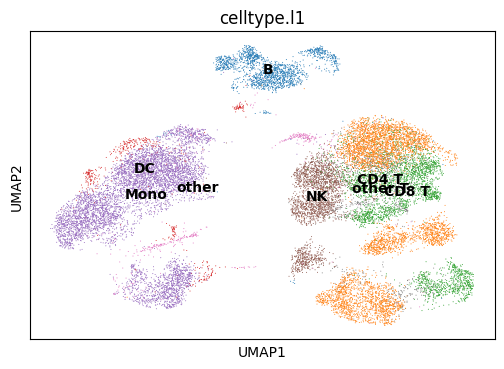

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


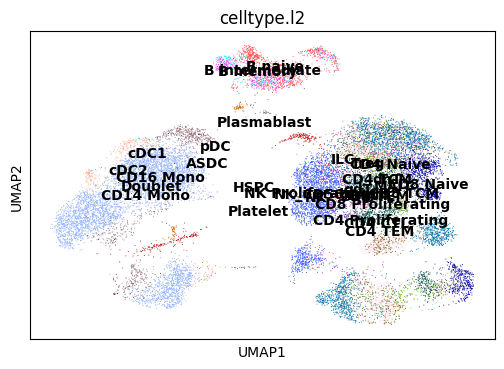

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


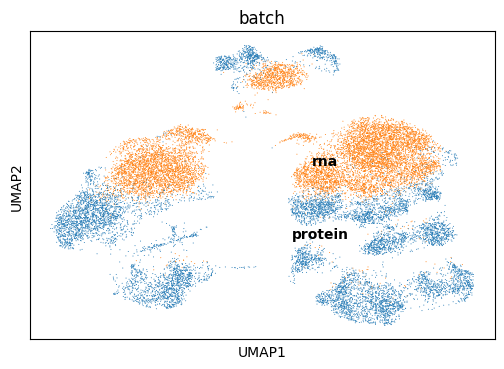

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


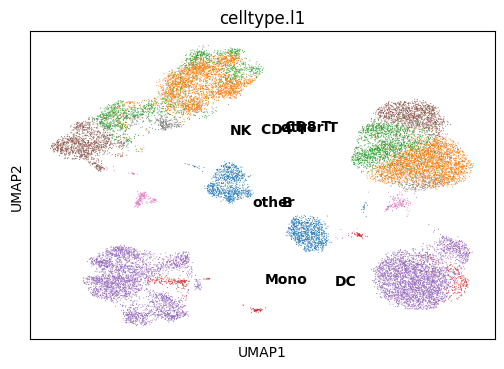

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


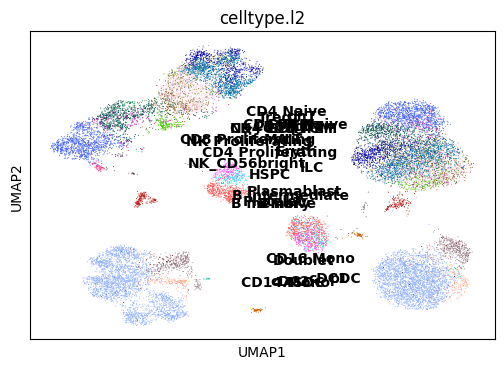

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


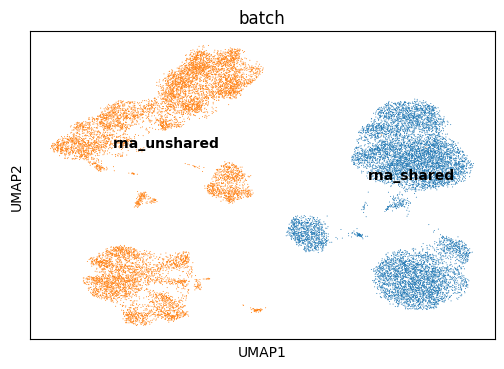

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


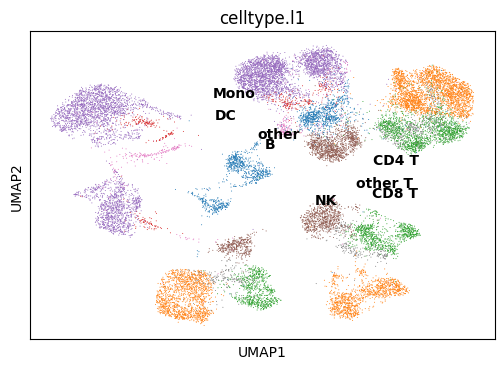

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


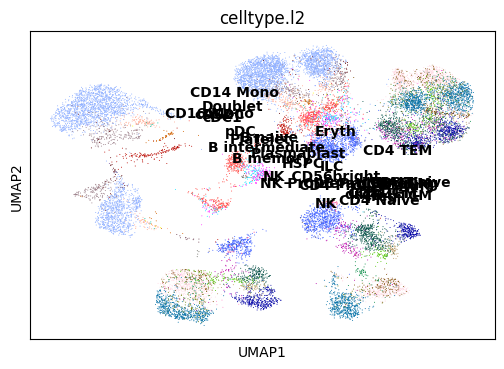

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


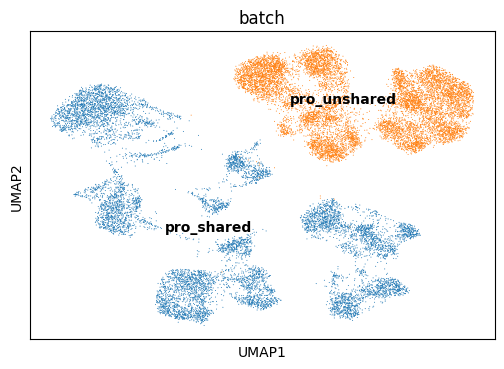

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For All matchings: lv1 matching acc: 0.688,
lv2 matching acc: 0.504.
For All matchings: FOSCTTM score: 0.27572870000000005, 
Knn Alignment score: [0.0016 0.0027 0.0035 0.0046 0.0057 0.0063 0.0075 0.0076 0.0084 0.0093
 0.0105 0.0108 0.0118 0.013  0.0137 0.0143 0.0152 0.0157 0.0163 0.0177
 0.0183 0.0193 0.02   0.0211 0.0219]
For All matchings: Silhouette F1 score for lv1: 0.49472374773087796, 
Silhouette F1 score for lv2: 0.4820497151304721



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  3.672705054283142
Matchings are reduced to 5000 after filtering...


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:423: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[matchings[0]], labels_l1[matchings[1]])
C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For only filtered matchings: lv1 matching acc: 0.798,
lv2 matching acc: 0.593.



Matches are being propagated....


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:460: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[filtered_matchings[0]], labels_l1[filtered_matchings[1]])


Done!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For all matchings after propagation: lv1 matching acc: 0.759,
lv2 matching acc: 0.560.


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:495: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[propagated_matchings[0]], labels_l1[propagated_matchings[1]])


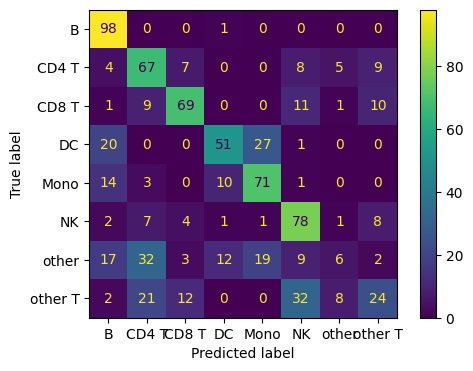

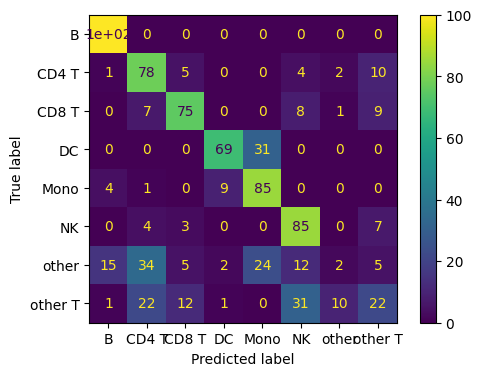

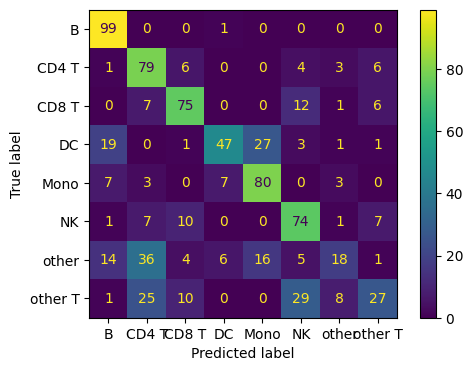

Epoch: 601: 0it [00:00, ?it/s]C:\Users\vinee\AppData\Local\Temp\ipykernel_2144\3129631169.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return {"x_unshared":self.unshared_data[idx], "x_shared":self.shared_data[idx], "l1":self.labels_l1[idx], "l2":self.labels_l2[idx], "mean": self.local_mean[idx], "var": self.local_var[idx], "batch": self.batch[idx]}
Epoch: 601: 40it [00:12,  3.28it/s]


RNA Recon Loss: 2.0116, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4365, Protein Recon Loss: 0.4877, Protein KL Div Back Pro: 0.8403, Protein KL Div Z: 0.6129, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5471, Shared Recon Loss Gene: 0.2592, Shared Recon Loss Protein: 1.8006 Cross Loss Protein: 0.5407


Epoch: 602: 40it [00:12,  3.30it/s]


RNA Recon Loss: 2.0352, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4368, Protein Recon Loss: 0.4878, Protein KL Div Back Pro: 0.8371, Protein KL Div Z: 0.6110, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5462, Shared Recon Loss Gene: 0.2610, Shared Recon Loss Protein: 1.8021 Cross Loss Protein: 0.5409


Epoch: 603: 40it [00:12,  3.30it/s]


RNA Recon Loss: 2.0209, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4381, Protein Recon Loss: 0.4874, Protein KL Div Back Pro: 0.8405, Protein KL Div Z: 0.6134, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5467, Shared Recon Loss Gene: 0.2599, Shared Recon Loss Protein: 1.8022 Cross Loss Protein: 0.5408


Epoch: 604: 40it [00:12,  3.32it/s]


RNA Recon Loss: 2.0149, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4367, Protein Recon Loss: 0.4881, Protein KL Div Back Pro: 0.8395, Protein KL Div Z: 0.6138, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5462, Shared Recon Loss Gene: 0.2594, Shared Recon Loss Protein: 1.8000 Cross Loss Protein: 0.5410


Epoch: 605: 40it [00:12,  3.27it/s]


RNA Recon Loss: 2.0174, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4364, Protein Recon Loss: 0.4880, Protein KL Div Back Pro: 0.8373, Protein KL Div Z: 0.6130, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5462, Shared Recon Loss Gene: 0.2601, Shared Recon Loss Protein: 1.8033 Cross Loss Protein: 0.5411


Epoch: 606: 40it [00:12,  3.24it/s]


RNA Recon Loss: 2.0194, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4364, Protein Recon Loss: 0.4880, Protein KL Div Back Pro: 0.8395, Protein KL Div Z: 0.6146, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5465, Shared Recon Loss Gene: 0.2597, Shared Recon Loss Protein: 1.8016 Cross Loss Protein: 0.5404


Epoch: 607: 40it [00:12,  3.24it/s]


RNA Recon Loss: 2.0132, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4362, Protein Recon Loss: 0.4882, Protein KL Div Back Pro: 0.8375, Protein KL Div Z: 0.6144, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5464, Shared Recon Loss Gene: 0.2588, Shared Recon Loss Protein: 1.8033 Cross Loss Protein: 0.5409


Epoch: 608: 40it [00:12,  3.24it/s]


RNA Recon Loss: 2.0211, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4361, Protein Recon Loss: 0.4884, Protein KL Div Back Pro: 0.8378, Protein KL Div Z: 0.6141, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5472, Shared Recon Loss Gene: 0.2600, Shared Recon Loss Protein: 1.8014 Cross Loss Protein: 0.5414


Epoch: 609: 40it [00:12,  3.27it/s]


RNA Recon Loss: 2.0137, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4372, Protein Recon Loss: 0.4877, Protein KL Div Back Pro: 0.8413, Protein KL Div Z: 0.6151, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5461, Shared Recon Loss Gene: 0.2595, Shared Recon Loss Protein: 1.8016 Cross Loss Protein: 0.5412


Epoch: 610: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.0189, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4359, Protein Recon Loss: 0.4876, Protein KL Div Back Pro: 0.8376, Protein KL Div Z: 0.6149, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5460, Shared Recon Loss Gene: 0.2596, Shared Recon Loss Protein: 1.8014 Cross Loss Protein: 0.5407


Epoch: 611: 40it [00:12,  3.19it/s]


RNA Recon Loss: 2.0150, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4364, Protein Recon Loss: 0.4882, Protein KL Div Back Pro: 0.8381, Protein KL Div Z: 0.6148, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5462, Shared Recon Loss Gene: 0.2593, Shared Recon Loss Protein: 1.8008 Cross Loss Protein: 0.5406


Epoch: 612: 40it [00:12,  3.29it/s]


RNA Recon Loss: 2.0320, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4368, Protein Recon Loss: 0.4880, Protein KL Div Back Pro: 0.8369, Protein KL Div Z: 0.6144, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5458, Shared Recon Loss Gene: 0.2606, Shared Recon Loss Protein: 1.8027 Cross Loss Protein: 0.5409


Epoch: 613: 40it [00:12,  3.29it/s]


RNA Recon Loss: 2.0152, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4366, Protein Recon Loss: 0.4882, Protein KL Div Back Pro: 0.8379, Protein KL Div Z: 0.6153, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5459, Shared Recon Loss Gene: 0.2601, Shared Recon Loss Protein: 1.8049 Cross Loss Protein: 0.5422


Epoch: 614: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.0167, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4362, Protein Recon Loss: 0.4897, Protein KL Div Back Pro: 0.8421, Protein KL Div Z: 0.6179, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5469, Shared Recon Loss Gene: 0.2592, Shared Recon Loss Protein: 1.8035 Cross Loss Protein: 0.5417


Epoch: 615: 40it [00:12,  3.31it/s]


RNA Recon Loss: 2.0102, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4357, Protein Recon Loss: 0.4882, Protein KL Div Back Pro: 0.8420, Protein KL Div Z: 0.6169, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5464, Shared Recon Loss Gene: 0.2593, Shared Recon Loss Protein: 1.8009 Cross Loss Protein: 0.5418


Epoch: 616: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.0179, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4357, Protein Recon Loss: 0.4891, Protein KL Div Back Pro: 0.8380, Protein KL Div Z: 0.6163, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5457, Shared Recon Loss Gene: 0.2600, Shared Recon Loss Protein: 1.8043 Cross Loss Protein: 0.5416


Epoch: 617: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.0141, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4363, Protein Recon Loss: 0.4875, Protein KL Div Back Pro: 0.8392, Protein KL Div Z: 0.6164, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5462, Shared Recon Loss Gene: 0.2593, Shared Recon Loss Protein: 1.8000 Cross Loss Protein: 0.5408


Epoch: 618: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.0109, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4361, Protein Recon Loss: 0.4881, Protein KL Div Back Pro: 0.8361, Protein KL Div Z: 0.6156, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5451, Shared Recon Loss Gene: 0.2603, Shared Recon Loss Protein: 1.8010 Cross Loss Protein: 0.5407


Epoch: 619: 40it [00:12,  3.27it/s]


RNA Recon Loss: 2.0170, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4357, Protein Recon Loss: 0.4877, Protein KL Div Back Pro: 0.8374, Protein KL Div Z: 0.6162, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5461, Shared Recon Loss Gene: 0.2595, Shared Recon Loss Protein: 1.8018 Cross Loss Protein: 0.5414


Epoch: 620: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.0101, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4361, Protein Recon Loss: 0.4881, Protein KL Div Back Pro: 0.8382, Protein KL Div Z: 0.6146, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5460, Shared Recon Loss Gene: 0.2589, Shared Recon Loss Protein: 1.8026 Cross Loss Protein: 0.5408


Epoch: 621: 40it [00:12,  3.20it/s]


RNA Recon Loss: 2.0152, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4358, Protein Recon Loss: 0.4884, Protein KL Div Back Pro: 0.8411, Protein KL Div Z: 0.6165, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5464, Shared Recon Loss Gene: 0.2597, Shared Recon Loss Protein: 1.8002 Cross Loss Protein: 0.5410


Epoch: 622: 40it [00:12,  3.20it/s]


RNA Recon Loss: 2.0151, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4356, Protein Recon Loss: 0.4880, Protein KL Div Back Pro: 0.8376, Protein KL Div Z: 0.6158, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5471, Shared Recon Loss Gene: 0.2594, Shared Recon Loss Protein: 1.8006 Cross Loss Protein: 0.5408


Epoch: 623: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.0150, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4360, Protein Recon Loss: 0.4881, Protein KL Div Back Pro: 0.8397, Protein KL Div Z: 0.6172, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5468, Shared Recon Loss Gene: 0.2598, Shared Recon Loss Protein: 1.8029 Cross Loss Protein: 0.5412


Epoch: 624: 40it [00:12,  3.28it/s]


RNA Recon Loss: 2.0069, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4352, Protein Recon Loss: 0.4884, Protein KL Div Back Pro: 0.8380, Protein KL Div Z: 0.6174, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5467, Shared Recon Loss Gene: 0.2586, Shared Recon Loss Protein: 1.8027 Cross Loss Protein: 0.5413


Epoch: 625: 40it [00:12,  3.27it/s]


RNA Recon Loss: 2.0259, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4353, Protein Recon Loss: 0.4890, Protein KL Div Back Pro: 0.8354, Protein KL Div Z: 0.6162, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5468, Shared Recon Loss Gene: 0.2608, Shared Recon Loss Protein: 1.8031 Cross Loss Protein: 0.5413


Epoch: 626: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.0174, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4354, Protein Recon Loss: 0.4879, Protein KL Div Back Pro: 0.8363, Protein KL Div Z: 0.6174, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5457, Shared Recon Loss Gene: 0.2600, Shared Recon Loss Protein: 1.8023 Cross Loss Protein: 0.5411


Epoch: 627: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.0078, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4339, Protein Recon Loss: 0.4879, Protein KL Div Back Pro: 0.8344, Protein KL Div Z: 0.6159, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5448, Shared Recon Loss Gene: 0.2587, Shared Recon Loss Protein: 1.8011 Cross Loss Protein: 0.5412


Epoch: 628: 40it [00:12,  3.28it/s]


RNA Recon Loss: 2.0080, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4348, Protein Recon Loss: 0.4882, Protein KL Div Back Pro: 0.8346, Protein KL Div Z: 0.6176, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5449, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.8005 Cross Loss Protein: 0.5425


Epoch: 629: 40it [00:12,  3.27it/s]


RNA Recon Loss: 2.0153, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4347, Protein Recon Loss: 0.4902, Protein KL Div Back Pro: 0.8371, Protein KL Div Z: 0.6172, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5453, Shared Recon Loss Gene: 0.2598, Shared Recon Loss Protein: 1.8100 Cross Loss Protein: 0.5427


Epoch: 630: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.0150, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4349, Protein Recon Loss: 0.4882, Protein KL Div Back Pro: 0.8392, Protein KL Div Z: 0.6192, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5469, Shared Recon Loss Gene: 0.2595, Shared Recon Loss Protein: 1.8056 Cross Loss Protein: 0.5414


Epoch: 631: 40it [00:12,  3.17it/s]


RNA Recon Loss: 2.0253, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4337, Protein Recon Loss: 0.4885, Protein KL Div Back Pro: 0.8332, Protein KL Div Z: 0.6161, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5458, Shared Recon Loss Gene: 0.2606, Shared Recon Loss Protein: 1.7992 Cross Loss Protein: 0.5417


Epoch: 632: 40it [00:12,  3.21it/s]


RNA Recon Loss: 2.0131, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4343, Protein Recon Loss: 0.4876, Protein KL Div Back Pro: 0.8364, Protein KL Div Z: 0.6171, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5468, Shared Recon Loss Gene: 0.2587, Shared Recon Loss Protein: 1.8008 Cross Loss Protein: 0.5408


Epoch: 633: 40it [00:12,  3.28it/s]


RNA Recon Loss: 2.0162, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4342, Protein Recon Loss: 0.4880, Protein KL Div Back Pro: 0.8359, Protein KL Div Z: 0.6177, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5461, Shared Recon Loss Gene: 0.2598, Shared Recon Loss Protein: 1.8022 Cross Loss Protein: 0.5410


Epoch: 634: 40it [00:12,  3.24it/s]


RNA Recon Loss: 2.0123, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4350, Protein Recon Loss: 0.4875, Protein KL Div Back Pro: 0.8352, Protein KL Div Z: 0.6173, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5463, Shared Recon Loss Gene: 0.2589, Shared Recon Loss Protein: 1.8003 Cross Loss Protein: 0.5409


Epoch: 635: 40it [00:12,  3.23it/s]


RNA Recon Loss: 2.0067, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4344, Protein Recon Loss: 0.4877, Protein KL Div Back Pro: 0.8356, Protein KL Div Z: 0.6157, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5463, Shared Recon Loss Gene: 0.2591, Shared Recon Loss Protein: 1.7995 Cross Loss Protein: 0.5408


Epoch: 636: 40it [00:12,  3.29it/s]


RNA Recon Loss: 2.0091, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4339, Protein Recon Loss: 0.4877, Protein KL Div Back Pro: 0.8368, Protein KL Div Z: 0.6187, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5452, Shared Recon Loss Gene: 0.2590, Shared Recon Loss Protein: 1.8014 Cross Loss Protein: 0.5410


Epoch: 637: 40it [00:13,  2.95it/s]


RNA Recon Loss: 2.0062, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4341, Protein Recon Loss: 0.4892, Protein KL Div Back Pro: 0.8350, Protein KL Div Z: 0.6165, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5458, Shared Recon Loss Gene: 0.2587, Shared Recon Loss Protein: 1.8076 Cross Loss Protein: 0.5417


Epoch: 638: 40it [00:13,  2.98it/s]


RNA Recon Loss: 2.0186, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4347, Protein Recon Loss: 0.4883, Protein KL Div Back Pro: 0.8380, Protein KL Div Z: 0.6181, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5453, Shared Recon Loss Gene: 0.2601, Shared Recon Loss Protein: 1.8040 Cross Loss Protein: 0.5419


Epoch: 639: 40it [00:13,  3.07it/s]


RNA Recon Loss: 2.0098, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4338, Protein Recon Loss: 0.4885, Protein KL Div Back Pro: 0.8339, Protein KL Div Z: 0.6174, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5461, Shared Recon Loss Gene: 0.2586, Shared Recon Loss Protein: 1.8022 Cross Loss Protein: 0.5419


Epoch: 640: 40it [00:13,  2.96it/s]


RNA Recon Loss: 2.0163, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4345, Protein Recon Loss: 0.4877, Protein KL Div Back Pro: 0.8345, Protein KL Div Z: 0.6182, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5461, Shared Recon Loss Gene: 0.2603, Shared Recon Loss Protein: 1.8014 Cross Loss Protein: 0.5410


Epoch: 641: 40it [00:12,  3.12it/s]


RNA Recon Loss: 2.0115, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4352, Protein Recon Loss: 0.4877, Protein KL Div Back Pro: 0.8326, Protein KL Div Z: 0.6170, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5455, Shared Recon Loss Gene: 0.2591, Shared Recon Loss Protein: 1.8010 Cross Loss Protein: 0.5410


Epoch: 642: 40it [00:12,  3.21it/s]


RNA Recon Loss: 2.0196, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4345, Protein Recon Loss: 0.4875, Protein KL Div Back Pro: 0.8355, Protein KL Div Z: 0.6171, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5453, Shared Recon Loss Gene: 0.2602, Shared Recon Loss Protein: 1.8004 Cross Loss Protein: 0.5401


Epoch: 643: 40it [00:13,  3.06it/s]


RNA Recon Loss: 2.0086, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4348, Protein Recon Loss: 0.4882, Protein KL Div Back Pro: 0.8344, Protein KL Div Z: 0.6174, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5461, Shared Recon Loss Gene: 0.2586, Shared Recon Loss Protein: 1.8005 Cross Loss Protein: 0.5418


Epoch: 644: 40it [00:12,  3.14it/s]


RNA Recon Loss: 2.0176, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4352, Protein Recon Loss: 0.4879, Protein KL Div Back Pro: 0.8360, Protein KL Div Z: 0.6183, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5466, Shared Recon Loss Gene: 0.2597, Shared Recon Loss Protein: 1.8020 Cross Loss Protein: 0.5416


Epoch: 645: 40it [00:14,  2.85it/s]


RNA Recon Loss: 2.0122, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4351, Protein Recon Loss: 0.4883, Protein KL Div Back Pro: 0.8354, Protein KL Div Z: 0.6182, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5464, Shared Recon Loss Gene: 0.2592, Shared Recon Loss Protein: 1.8026 Cross Loss Protein: 0.5417


Epoch: 647: 40it [00:13,  2.89it/s]


RNA Recon Loss: 2.0056, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4347, Protein Recon Loss: 0.4872, Protein KL Div Back Pro: 0.8353, Protein KL Div Z: 0.6193, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5457, Shared Recon Loss Gene: 0.2587, Shared Recon Loss Protein: 1.8005 Cross Loss Protein: 0.5407


Epoch: 648: 40it [00:12,  3.23it/s]


RNA Recon Loss: 2.0102, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4351, Protein Recon Loss: 0.4875, Protein KL Div Back Pro: 0.8340, Protein KL Div Z: 0.6195, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5456, Shared Recon Loss Gene: 0.2589, Shared Recon Loss Protein: 1.8019 Cross Loss Protein: 0.5413


Epoch: 649: 40it [00:12,  3.08it/s]


RNA Recon Loss: 2.0208, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4349, Protein Recon Loss: 0.4879, Protein KL Div Back Pro: 0.8342, Protein KL Div Z: 0.6196, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5459, Shared Recon Loss Gene: 0.2600, Shared Recon Loss Protein: 1.8008 Cross Loss Protein: 0.5401


Epoch: 650: 40it [00:14,  2.85it/s]


RNA Recon Loss: 2.0268, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4347, Protein Recon Loss: 0.4889, Protein KL Div Back Pro: 0.8331, Protein KL Div Z: 0.6186, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5456, Shared Recon Loss Gene: 0.2600, Shared Recon Loss Protein: 1.8009 Cross Loss Protein: 0.5414


Epoch: 651: 40it [00:13,  3.02it/s]


RNA Recon Loss: 2.0212, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4356, Protein Recon Loss: 0.4884, Protein KL Div Back Pro: 0.8351, Protein KL Div Z: 0.6191, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5455, Shared Recon Loss Gene: 0.2600, Shared Recon Loss Protein: 1.8021 Cross Loss Protein: 0.5421


Epoch: 652: 40it [00:13,  2.99it/s]


RNA Recon Loss: 2.0083, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4352, Protein Recon Loss: 0.4881, Protein KL Div Back Pro: 0.8351, Protein KL Div Z: 0.6200, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5463, Shared Recon Loss Gene: 0.2590, Shared Recon Loss Protein: 1.8015 Cross Loss Protein: 0.5414


Epoch: 653: 40it [00:13,  3.03it/s]


RNA Recon Loss: 2.0122, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4342, Protein Recon Loss: 0.4880, Protein KL Div Back Pro: 0.8352, Protein KL Div Z: 0.6189, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5456, Shared Recon Loss Gene: 0.2593, Shared Recon Loss Protein: 1.8026 Cross Loss Protein: 0.5412


Epoch: 654: 40it [00:13,  3.02it/s]


RNA Recon Loss: 2.0126, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4353, Protein Recon Loss: 0.4879, Protein KL Div Back Pro: 0.8331, Protein KL Div Z: 0.6171, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5459, Shared Recon Loss Gene: 0.2599, Shared Recon Loss Protein: 1.8007 Cross Loss Protein: 0.5407


Epoch: 655: 40it [00:15,  2.63it/s]


RNA Recon Loss: 2.0098, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4336, Protein Recon Loss: 0.4882, Protein KL Div Back Pro: 0.8379, Protein KL Div Z: 0.6212, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5456, Shared Recon Loss Gene: 0.2592, Shared Recon Loss Protein: 1.8042 Cross Loss Protein: 0.5416


Epoch: 656: 40it [00:17,  2.30it/s]


RNA Recon Loss: 2.0125, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4341, Protein Recon Loss: 0.4875, Protein KL Div Back Pro: 0.8341, Protein KL Div Z: 0.6188, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5456, Shared Recon Loss Gene: 0.2596, Shared Recon Loss Protein: 1.7975 Cross Loss Protein: 0.5403


Epoch: 657: 40it [00:13,  2.95it/s]


RNA Recon Loss: 2.0056, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4338, Protein Recon Loss: 0.4880, Protein KL Div Back Pro: 0.8346, Protein KL Div Z: 0.6187, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5444, Shared Recon Loss Gene: 0.2586, Shared Recon Loss Protein: 1.8024 Cross Loss Protein: 0.5408


Epoch: 658: 40it [00:12,  3.09it/s]


RNA Recon Loss: 2.0116, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4335, Protein Recon Loss: 0.4872, Protein KL Div Back Pro: 0.8362, Protein KL Div Z: 0.6191, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5460, Shared Recon Loss Gene: 0.2588, Shared Recon Loss Protein: 1.8012 Cross Loss Protein: 0.5401


Epoch: 659: 40it [00:12,  3.11it/s]


RNA Recon Loss: 2.0227, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4332, Protein Recon Loss: 0.4898, Protein KL Div Back Pro: 0.8346, Protein KL Div Z: 0.6194, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5450, Shared Recon Loss Gene: 0.2609, Shared Recon Loss Protein: 1.8091 Cross Loss Protein: 0.5425


Epoch: 660: 40it [00:12,  3.17it/s]


RNA Recon Loss: 2.0115, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4341, Protein Recon Loss: 0.4880, Protein KL Div Back Pro: 0.8399, Protein KL Div Z: 0.6209, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5457, Shared Recon Loss Gene: 0.2599, Shared Recon Loss Protein: 1.8048 Cross Loss Protein: 0.5421


Epoch: 661: 40it [00:12,  3.11it/s]


RNA Recon Loss: 2.0167, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4328, Protein Recon Loss: 0.4877, Protein KL Div Back Pro: 0.8333, Protein KL Div Z: 0.6190, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5449, Shared Recon Loss Gene: 0.2598, Shared Recon Loss Protein: 1.8031 Cross Loss Protein: 0.5409


Epoch: 662: 40it [00:12,  3.08it/s]


RNA Recon Loss: 2.0144, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4335, Protein Recon Loss: 0.4872, Protein KL Div Back Pro: 0.8352, Protein KL Div Z: 0.6196, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5457, Shared Recon Loss Gene: 0.2593, Shared Recon Loss Protein: 1.8004 Cross Loss Protein: 0.5406


Epoch: 663: 40it [00:13,  3.07it/s]


RNA Recon Loss: 2.0087, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4335, Protein Recon Loss: 0.4877, Protein KL Div Back Pro: 0.8333, Protein KL Div Z: 0.6193, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5443, Shared Recon Loss Gene: 0.2588, Shared Recon Loss Protein: 1.8045 Cross Loss Protein: 0.5410


Epoch: 664: 40it [00:13,  2.87it/s]


RNA Recon Loss: 2.0096, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4336, Protein Recon Loss: 0.4876, Protein KL Div Back Pro: 0.8376, Protein KL Div Z: 0.6198, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5464, Shared Recon Loss Gene: 0.2591, Shared Recon Loss Protein: 1.8014 Cross Loss Protein: 0.5413


Epoch: 665: 40it [00:13,  3.00it/s]


RNA Recon Loss: 2.0136, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4339, Protein Recon Loss: 0.4873, Protein KL Div Back Pro: 0.8358, Protein KL Div Z: 0.6187, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5456, Shared Recon Loss Gene: 0.2594, Shared Recon Loss Protein: 1.8013 Cross Loss Protein: 0.5405


Epoch: 666: 40it [00:12,  3.12it/s]


RNA Recon Loss: 2.0095, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4332, Protein Recon Loss: 0.4879, Protein KL Div Back Pro: 0.8376, Protein KL Div Z: 0.6202, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5451, Shared Recon Loss Gene: 0.2594, Shared Recon Loss Protein: 1.8068 Cross Loss Protein: 0.5413


Epoch: 667: 40it [00:12,  3.16it/s]


RNA Recon Loss: 2.0116, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4336, Protein Recon Loss: 0.4883, Protein KL Div Back Pro: 0.8383, Protein KL Div Z: 0.6200, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5464, Shared Recon Loss Gene: 0.2596, Shared Recon Loss Protein: 1.8056 Cross Loss Protein: 0.5412


Epoch: 668: 40it [00:12,  3.19it/s]


RNA Recon Loss: 2.0128, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4335, Protein Recon Loss: 0.4886, Protein KL Div Back Pro: 0.8347, Protein KL Div Z: 0.6198, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5453, Shared Recon Loss Gene: 0.2591, Shared Recon Loss Protein: 1.8029 Cross Loss Protein: 0.5420


Epoch: 669: 40it [00:13,  3.08it/s]


RNA Recon Loss: 2.0154, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4335, Protein Recon Loss: 0.4879, Protein KL Div Back Pro: 0.8351, Protein KL Div Z: 0.6198, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5449, Shared Recon Loss Gene: 0.2590, Shared Recon Loss Protein: 1.8006 Cross Loss Protein: 0.5413


Epoch: 670: 40it [00:12,  3.27it/s]


RNA Recon Loss: 2.0115, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4337, Protein Recon Loss: 0.4880, Protein KL Div Back Pro: 0.8354, Protein KL Div Z: 0.6192, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5460, Shared Recon Loss Gene: 0.2589, Shared Recon Loss Protein: 1.8025 Cross Loss Protein: 0.5414


Epoch: 671: 40it [00:12,  3.14it/s]


RNA Recon Loss: 2.0114, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4333, Protein Recon Loss: 0.4884, Protein KL Div Back Pro: 0.8360, Protein KL Div Z: 0.6210, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5449, Shared Recon Loss Gene: 0.2591, Shared Recon Loss Protein: 1.8014 Cross Loss Protein: 0.5418


Epoch: 672: 40it [00:12,  3.24it/s]


RNA Recon Loss: 2.0048, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4329, Protein Recon Loss: 0.4878, Protein KL Div Back Pro: 0.8359, Protein KL Div Z: 0.6198, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5452, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.7998 Cross Loss Protein: 0.5406


Epoch: 673: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.0130, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4326, Protein Recon Loss: 0.4879, Protein KL Div Back Pro: 0.8358, Protein KL Div Z: 0.6197, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5453, Shared Recon Loss Gene: 0.2589, Shared Recon Loss Protein: 1.8034 Cross Loss Protein: 0.5411


Epoch: 674: 40it [00:12,  3.19it/s]


RNA Recon Loss: 2.0047, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4327, Protein Recon Loss: 0.4884, Protein KL Div Back Pro: 0.8352, Protein KL Div Z: 0.6199, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5462, Shared Recon Loss Gene: 0.2586, Shared Recon Loss Protein: 1.8037 Cross Loss Protein: 0.5417


Epoch: 675: 40it [00:12,  3.27it/s]


RNA Recon Loss: 2.0103, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4329, Protein Recon Loss: 0.4891, Protein KL Div Back Pro: 0.8370, Protein KL Div Z: 0.6222, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5454, Shared Recon Loss Gene: 0.2598, Shared Recon Loss Protein: 1.8003 Cross Loss Protein: 0.5415


Epoch: 676: 40it [00:12,  3.28it/s]


RNA Recon Loss: 2.0061, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4325, Protein Recon Loss: 0.4876, Protein KL Div Back Pro: 0.8382, Protein KL Div Z: 0.6212, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5460, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.8007 Cross Loss Protein: 0.5405


Epoch: 677: 40it [00:12,  3.20it/s]


RNA Recon Loss: 2.0095, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4328, Protein Recon Loss: 0.4882, Protein KL Div Back Pro: 0.8321, Protein KL Div Z: 0.6187, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5453, Shared Recon Loss Gene: 0.2592, Shared Recon Loss Protein: 1.8010 Cross Loss Protein: 0.5411


Epoch: 678: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.0072, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4327, Protein Recon Loss: 0.4876, Protein KL Div Back Pro: 0.8367, Protein KL Div Z: 0.6212, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5454, Shared Recon Loss Gene: 0.2588, Shared Recon Loss Protein: 1.8022 Cross Loss Protein: 0.5413


Epoch: 679: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.0142, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4327, Protein Recon Loss: 0.4871, Protein KL Div Back Pro: 0.8353, Protein KL Div Z: 0.6199, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5442, Shared Recon Loss Gene: 0.2598, Shared Recon Loss Protein: 1.8011 Cross Loss Protein: 0.5401


Epoch: 680: 40it [00:12,  3.28it/s]


RNA Recon Loss: 2.0134, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4333, Protein Recon Loss: 0.4875, Protein KL Div Back Pro: 0.8367, Protein KL Div Z: 0.6209, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5447, Shared Recon Loss Gene: 0.2589, Shared Recon Loss Protein: 1.8009 Cross Loss Protein: 0.5408


Epoch: 681: 40it [00:12,  3.28it/s]


RNA Recon Loss: 2.0103, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4325, Protein Recon Loss: 0.4875, Protein KL Div Back Pro: 0.8365, Protein KL Div Z: 0.6205, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5450, Shared Recon Loss Gene: 0.2594, Shared Recon Loss Protein: 1.8010 Cross Loss Protein: 0.5405


Epoch: 682: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.0146, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4328, Protein Recon Loss: 0.4876, Protein KL Div Back Pro: 0.8357, Protein KL Div Z: 0.6196, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5450, Shared Recon Loss Gene: 0.2592, Shared Recon Loss Protein: 1.8009 Cross Loss Protein: 0.5412


Epoch: 683: 40it [00:12,  3.17it/s]


RNA Recon Loss: 2.0074, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4321, Protein Recon Loss: 0.4890, Protein KL Div Back Pro: 0.8347, Protein KL Div Z: 0.6197, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5444, Shared Recon Loss Gene: 0.2585, Shared Recon Loss Protein: 1.8038 Cross Loss Protein: 0.5414


Epoch: 684: 40it [00:12,  3.27it/s]


RNA Recon Loss: 2.0130, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4328, Protein Recon Loss: 0.4881, Protein KL Div Back Pro: 0.8384, Protein KL Div Z: 0.6216, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5452, Shared Recon Loss Gene: 0.2592, Shared Recon Loss Protein: 1.7997 Cross Loss Protein: 0.5408


Epoch: 685: 40it [00:12,  3.29it/s]


RNA Recon Loss: 2.0095, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4329, Protein Recon Loss: 0.4877, Protein KL Div Back Pro: 0.8345, Protein KL Div Z: 0.6189, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5439, Shared Recon Loss Gene: 0.2588, Shared Recon Loss Protein: 1.8019 Cross Loss Protein: 0.5413


Epoch: 686: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.0102, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4328, Protein Recon Loss: 0.4876, Protein KL Div Back Pro: 0.8355, Protein KL Div Z: 0.6199, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5447, Shared Recon Loss Gene: 0.2585, Shared Recon Loss Protein: 1.8006 Cross Loss Protein: 0.5408


Epoch: 687: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.0113, RNA KL Div L: 0.0148, RNA KL Div Z: 0.4317, Protein Recon Loss: 0.4880, Protein KL Div Back Pro: 0.8364, Protein KL Div Z: 0.6197, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5440, Shared Recon Loss Gene: 0.2583, Shared Recon Loss Protein: 1.7997 Cross Loss Protein: 0.5408


Epoch: 688: 40it [00:12,  3.29it/s]


RNA Recon Loss: 2.0099, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4330, Protein Recon Loss: 0.4884, Protein KL Div Back Pro: 0.8376, Protein KL Div Z: 0.6201, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5442, Shared Recon Loss Gene: 0.2591, Shared Recon Loss Protein: 1.8057 Cross Loss Protein: 0.5413


Epoch: 689: 40it [00:11,  3.34it/s]


RNA Recon Loss: 2.0076, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4329, Protein Recon Loss: 0.4876, Protein KL Div Back Pro: 0.8393, Protein KL Div Z: 0.6207, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5443, Shared Recon Loss Gene: 0.2592, Shared Recon Loss Protein: 1.8023 Cross Loss Protein: 0.5414


Epoch: 690: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.0093, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4323, Protein Recon Loss: 0.4877, Protein KL Div Back Pro: 0.8338, Protein KL Div Z: 0.6191, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5436, Shared Recon Loss Gene: 0.2587, Shared Recon Loss Protein: 1.8013 Cross Loss Protein: 0.5415


Epoch: 691: 40it [00:12,  3.33it/s]


RNA Recon Loss: 2.0093, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4321, Protein Recon Loss: 0.4878, Protein KL Div Back Pro: 0.8355, Protein KL Div Z: 0.6191, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5447, Shared Recon Loss Gene: 0.2585, Shared Recon Loss Protein: 1.8022 Cross Loss Protein: 0.5416


Epoch: 692: 40it [00:12,  3.28it/s]


RNA Recon Loss: 2.0086, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4318, Protein Recon Loss: 0.4878, Protein KL Div Back Pro: 0.8351, Protein KL Div Z: 0.6190, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5450, Shared Recon Loss Gene: 0.2586, Shared Recon Loss Protein: 1.8011 Cross Loss Protein: 0.5406


Epoch: 693: 40it [00:12,  3.31it/s]


RNA Recon Loss: 2.0091, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4326, Protein Recon Loss: 0.4872, Protein KL Div Back Pro: 0.8337, Protein KL Div Z: 0.6194, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5445, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.7997 Cross Loss Protein: 0.5406


Epoch: 694: 40it [00:12,  3.27it/s]


RNA Recon Loss: 2.0140, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4310, Protein Recon Loss: 0.4873, Protein KL Div Back Pro: 0.8351, Protein KL Div Z: 0.6196, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5445, Shared Recon Loss Gene: 0.2593, Shared Recon Loss Protein: 1.8002 Cross Loss Protein: 0.5411


Epoch: 695: 40it [00:12,  3.22it/s]


RNA Recon Loss: 2.0106, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4325, Protein Recon Loss: 0.4879, Protein KL Div Back Pro: 0.8345, Protein KL Div Z: 0.6202, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5443, Shared Recon Loss Gene: 0.2592, Shared Recon Loss Protein: 1.8023 Cross Loss Protein: 0.5415


Epoch: 696: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.0117, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4318, Protein Recon Loss: 0.4873, Protein KL Div Back Pro: 0.8331, Protein KL Div Z: 0.6192, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5432, Shared Recon Loss Gene: 0.2593, Shared Recon Loss Protein: 1.7988 Cross Loss Protein: 0.5407


Epoch: 697: 40it [00:12,  3.28it/s]


RNA Recon Loss: 2.0047, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4322, Protein Recon Loss: 0.4874, Protein KL Div Back Pro: 0.8347, Protein KL Div Z: 0.6191, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5443, Shared Recon Loss Gene: 0.2591, Shared Recon Loss Protein: 1.7998 Cross Loss Protein: 0.5406


Epoch: 698: 40it [00:12,  3.30it/s]


RNA Recon Loss: 2.0079, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4322, Protein Recon Loss: 0.4879, Protein KL Div Back Pro: 0.8341, Protein KL Div Z: 0.6186, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5437, Shared Recon Loss Gene: 0.2587, Shared Recon Loss Protein: 1.7996 Cross Loss Protein: 0.5407


Epoch: 699: 40it [00:11,  3.33it/s]


RNA Recon Loss: 2.0194, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4320, Protein Recon Loss: 0.4879, Protein KL Div Back Pro: 0.8340, Protein KL Div Z: 0.6184, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5442, Shared Recon Loss Gene: 0.2590, Shared Recon Loss Protein: 1.8033 Cross Loss Protein: 0.5416


Epoch: 700: 40it [00:11,  3.34it/s]


RNA Recon Loss: 2.0130, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4322, Protein Recon Loss: 0.4880, Protein KL Div Back Pro: 0.8369, Protein KL Div Z: 0.6207, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5441, Shared Recon Loss Gene: 0.2592, Shared Recon Loss Protein: 1.7997 Cross Loss Protein: 0.5406


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


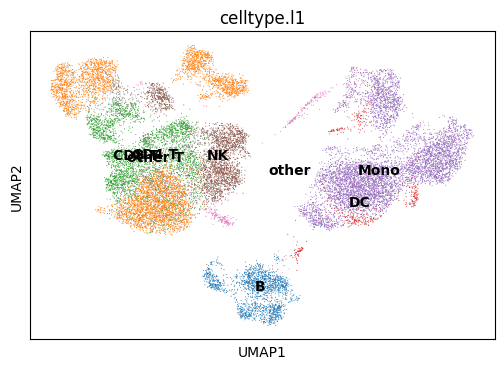

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


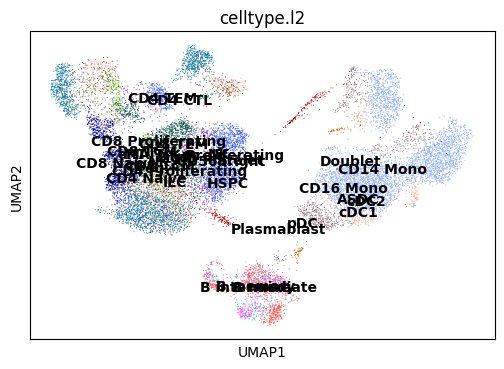

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


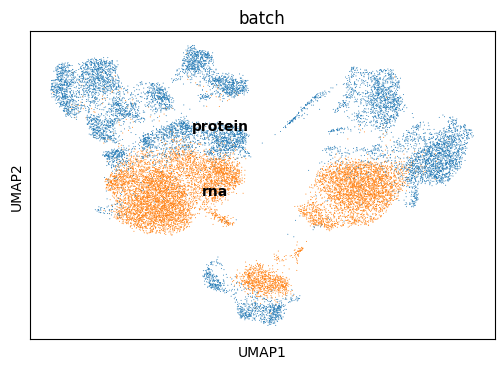

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


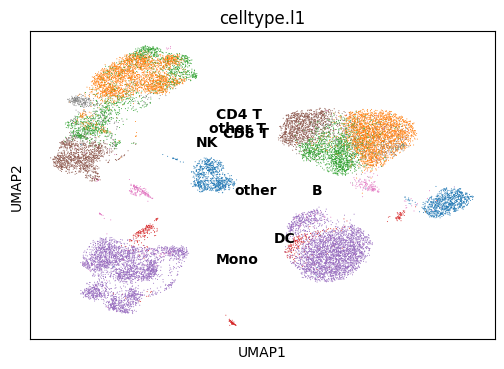

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


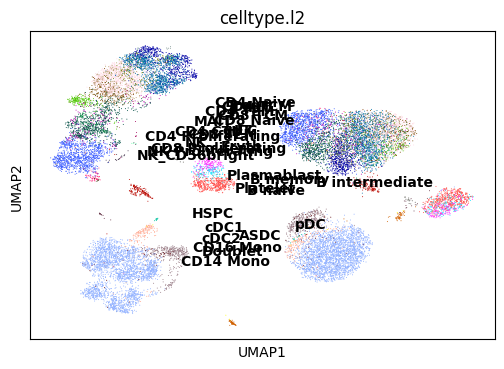

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


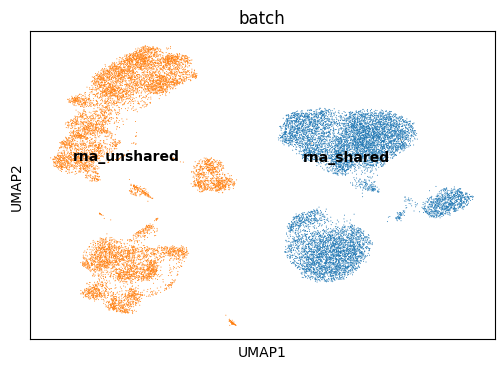

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


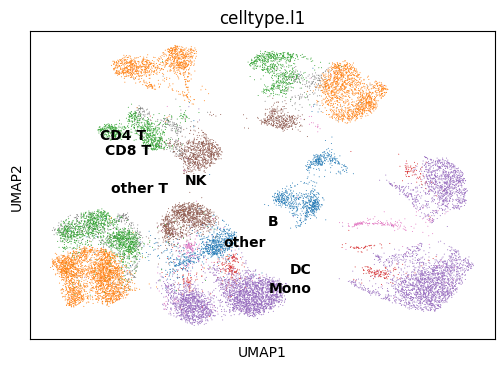

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


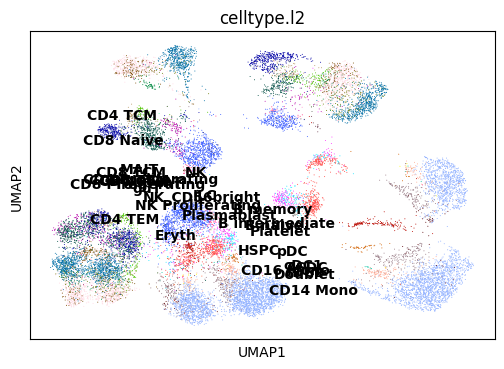

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


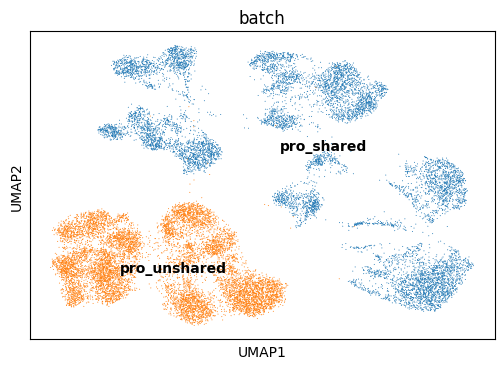

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For All matchings: lv1 matching acc: 0.705,
lv2 matching acc: 0.523.
For All matchings: FOSCTTM score: 0.25875857999999996, 
Knn Alignment score: [0.0005 0.0012 0.0024 0.0039 0.0048 0.0061 0.0072 0.0077 0.0085 0.0097
 0.0106 0.0112 0.012  0.0128 0.0135 0.0146 0.0151 0.0158 0.0165 0.0177
 0.0189 0.0195 0.0203 0.021  0.0219]
For All matchings: Silhouette F1 score for lv1: 0.4996188974849953, 
Silhouette F1 score for lv2: 0.4868205181671921



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  3.5681008100509644
Matchings are reduced to 5000 after filtering...


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:423: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[matchings[0]], labels_l1[matchings[1]])
C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For only filtered matchings: lv1 matching acc: 0.798,
lv2 matching acc: 0.615.



Matches are being propagated....


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:460: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[filtered_matchings[0]], labels_l1[filtered_matchings[1]])
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scipy\sparse\_index.py:143: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


Done!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For all matchings after propagation: lv1 matching acc: 0.770,
lv2 matching acc: 0.555.


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:495: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[propagated_matchings[0]], labels_l1[propagated_matchings[1]])


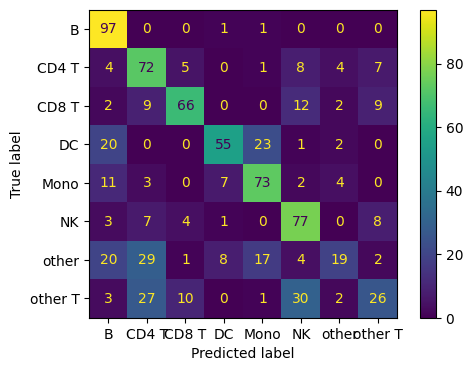

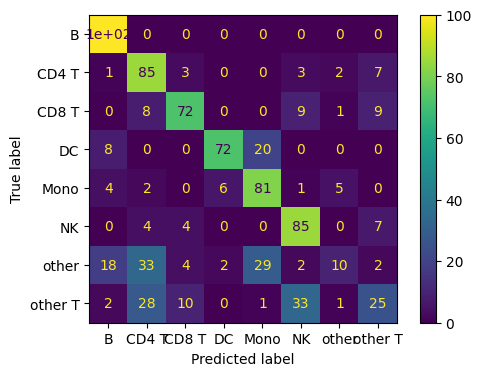

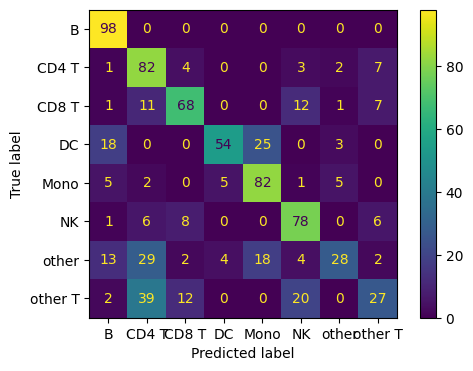

Epoch: 701: 0it [00:00, ?it/s]C:\Users\vinee\AppData\Local\Temp\ipykernel_2144\3129631169.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return {"x_unshared":self.unshared_data[idx], "x_shared":self.shared_data[idx], "l1":self.labels_l1[idx], "l2":self.labels_l2[idx], "mean": self.local_mean[idx], "var": self.local_var[idx], "batch": self.batch[idx]}
Epoch: 701: 40it [00:12,  3.32it/s]


RNA Recon Loss: 2.0102, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4323, Protein Recon Loss: 0.4895, Protein KL Div Back Pro: 0.8326, Protein KL Div Z: 0.6186, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5446, Shared Recon Loss Gene: 0.2585, Shared Recon Loss Protein: 1.8037 Cross Loss Protein: 0.5421


Epoch: 702: 40it [00:11,  3.35it/s]


RNA Recon Loss: 2.0070, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4319, Protein Recon Loss: 0.4879, Protein KL Div Back Pro: 0.8365, Protein KL Div Z: 0.6205, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5441, Shared Recon Loss Gene: 0.2587, Shared Recon Loss Protein: 1.8020 Cross Loss Protein: 0.5414


Epoch: 703: 40it [00:11,  3.34it/s]


RNA Recon Loss: 2.0102, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4319, Protein Recon Loss: 0.4875, Protein KL Div Back Pro: 0.8346, Protein KL Div Z: 0.6197, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5442, Shared Recon Loss Gene: 0.2586, Shared Recon Loss Protein: 1.8011 Cross Loss Protein: 0.5408


Epoch: 704: 40it [00:11,  3.36it/s]


RNA Recon Loss: 2.0112, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4319, Protein Recon Loss: 0.4875, Protein KL Div Back Pro: 0.8358, Protein KL Div Z: 0.6196, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5437, Shared Recon Loss Gene: 0.2590, Shared Recon Loss Protein: 1.8008 Cross Loss Protein: 0.5406


Epoch: 705: 40it [00:12,  3.33it/s]


RNA Recon Loss: 2.0084, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4315, Protein Recon Loss: 0.4886, Protein KL Div Back Pro: 0.8328, Protein KL Div Z: 0.6210, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5441, Shared Recon Loss Gene: 0.2589, Shared Recon Loss Protein: 1.8003 Cross Loss Protein: 0.5418


Epoch: 706: 40it [00:12,  3.28it/s]


RNA Recon Loss: 2.0081, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4318, Protein Recon Loss: 0.4875, Protein KL Div Back Pro: 0.8324, Protein KL Div Z: 0.6195, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5432, Shared Recon Loss Gene: 0.2589, Shared Recon Loss Protein: 1.7999 Cross Loss Protein: 0.5411


Epoch: 707: 40it [00:12,  3.30it/s]


RNA Recon Loss: 2.0061, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4321, Protein Recon Loss: 0.4876, Protein KL Div Back Pro: 0.8335, Protein KL Div Z: 0.6200, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5438, Shared Recon Loss Gene: 0.2585, Shared Recon Loss Protein: 1.8014 Cross Loss Protein: 0.5412


Epoch: 708: 40it [00:12,  3.29it/s]


RNA Recon Loss: 2.0076, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4317, Protein Recon Loss: 0.4887, Protein KL Div Back Pro: 0.8312, Protein KL Div Z: 0.6186, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5433, Shared Recon Loss Gene: 0.2587, Shared Recon Loss Protein: 1.8047 Cross Loss Protein: 0.5418


Epoch: 709: 40it [00:12,  3.29it/s]


RNA Recon Loss: 2.0114, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4324, Protein Recon Loss: 0.4874, Protein KL Div Back Pro: 0.8337, Protein KL Div Z: 0.6217, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5438, Shared Recon Loss Gene: 0.2592, Shared Recon Loss Protein: 1.8015 Cross Loss Protein: 0.5410


Epoch: 710: 40it [00:12,  3.29it/s]


RNA Recon Loss: 2.0102, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4318, Protein Recon Loss: 0.4870, Protein KL Div Back Pro: 0.8317, Protein KL Div Z: 0.6198, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5436, Shared Recon Loss Gene: 0.2595, Shared Recon Loss Protein: 1.7998 Cross Loss Protein: 0.5400


Epoch: 711: 40it [00:12,  3.30it/s]


RNA Recon Loss: 2.0054, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4320, Protein Recon Loss: 0.4875, Protein KL Div Back Pro: 0.8314, Protein KL Div Z: 0.6194, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5433, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.8004 Cross Loss Protein: 0.5405


Epoch: 712: 40it [00:12,  3.31it/s]


RNA Recon Loss: 2.0057, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4322, Protein Recon Loss: 0.4879, Protein KL Div Back Pro: 0.8346, Protein KL Div Z: 0.6193, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5441, Shared Recon Loss Gene: 0.2585, Shared Recon Loss Protein: 1.8010 Cross Loss Protein: 0.5409


Epoch: 713: 40it [00:12,  3.18it/s]


RNA Recon Loss: 2.0050, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4317, Protein Recon Loss: 0.4873, Protein KL Div Back Pro: 0.8348, Protein KL Div Z: 0.6201, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5432, Shared Recon Loss Gene: 0.2587, Shared Recon Loss Protein: 1.7997 Cross Loss Protein: 0.5403


Epoch: 714: 40it [00:12,  3.21it/s]


RNA Recon Loss: 2.0106, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4315, Protein Recon Loss: 0.4883, Protein KL Div Back Pro: 0.8352, Protein KL Div Z: 0.6186, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5435, Shared Recon Loss Gene: 0.2589, Shared Recon Loss Protein: 1.8027 Cross Loss Protein: 0.5420


Epoch: 715: 40it [00:12,  3.30it/s]


RNA Recon Loss: 2.0063, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4316, Protein Recon Loss: 0.4880, Protein KL Div Back Pro: 0.8354, Protein KL Div Z: 0.6187, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5438, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.8021 Cross Loss Protein: 0.5411


Epoch: 716: 40it [00:12,  3.28it/s]


RNA Recon Loss: 2.0067, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4312, Protein Recon Loss: 0.4881, Protein KL Div Back Pro: 0.8363, Protein KL Div Z: 0.6192, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5440, Shared Recon Loss Gene: 0.2592, Shared Recon Loss Protein: 1.8010 Cross Loss Protein: 0.5411


Epoch: 717: 40it [00:12,  3.30it/s]


RNA Recon Loss: 2.0112, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4324, Protein Recon Loss: 0.4885, Protein KL Div Back Pro: 0.8351, Protein KL Div Z: 0.6177, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5437, Shared Recon Loss Gene: 0.2594, Shared Recon Loss Protein: 1.8007 Cross Loss Protein: 0.5418


Epoch: 718: 40it [00:12,  3.24it/s]


RNA Recon Loss: 2.0139, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4318, Protein Recon Loss: 0.4874, Protein KL Div Back Pro: 0.8374, Protein KL Div Z: 0.6199, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5446, Shared Recon Loss Gene: 0.2588, Shared Recon Loss Protein: 1.8001 Cross Loss Protein: 0.5415


Epoch: 719: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.0075, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4317, Protein Recon Loss: 0.4875, Protein KL Div Back Pro: 0.8363, Protein KL Div Z: 0.6193, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5432, Shared Recon Loss Gene: 0.2585, Shared Recon Loss Protein: 1.8006 Cross Loss Protein: 0.5411


Epoch: 720: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.0117, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4321, Protein Recon Loss: 0.4874, Protein KL Div Back Pro: 0.8365, Protein KL Div Z: 0.6207, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5437, Shared Recon Loss Gene: 0.2593, Shared Recon Loss Protein: 1.7999 Cross Loss Protein: 0.5411


Epoch: 721: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.0096, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4317, Protein Recon Loss: 0.4876, Protein KL Div Back Pro: 0.8355, Protein KL Div Z: 0.6191, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5432, Shared Recon Loss Gene: 0.2590, Shared Recon Loss Protein: 1.8017 Cross Loss Protein: 0.5407


Epoch: 722: 40it [00:12,  3.28it/s]


RNA Recon Loss: 2.0101, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4314, Protein Recon Loss: 0.4872, Protein KL Div Back Pro: 0.8343, Protein KL Div Z: 0.6188, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5435, Shared Recon Loss Gene: 0.2588, Shared Recon Loss Protein: 1.7996 Cross Loss Protein: 0.5403


Epoch: 723: 40it [00:12,  3.29it/s]


RNA Recon Loss: 2.0088, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4314, Protein Recon Loss: 0.4890, Protein KL Div Back Pro: 0.8348, Protein KL Div Z: 0.6193, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5426, Shared Recon Loss Gene: 0.2583, Shared Recon Loss Protein: 1.8028 Cross Loss Protein: 0.5419


Epoch: 724: 40it [00:12,  3.28it/s]


RNA Recon Loss: 2.0087, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4313, Protein Recon Loss: 0.4871, Protein KL Div Back Pro: 0.8371, Protein KL Div Z: 0.6197, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5427, Shared Recon Loss Gene: 0.2586, Shared Recon Loss Protein: 1.7998 Cross Loss Protein: 0.5406


Epoch: 725: 40it [00:12,  3.28it/s]


RNA Recon Loss: 2.0076, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4316, Protein Recon Loss: 0.4870, Protein KL Div Back Pro: 0.8348, Protein KL Div Z: 0.6187, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5432, Shared Recon Loss Gene: 0.2588, Shared Recon Loss Protein: 1.7987 Cross Loss Protein: 0.5406


Epoch: 726: 40it [00:12,  3.24it/s]


RNA Recon Loss: 2.0086, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4314, Protein Recon Loss: 0.4878, Protein KL Div Back Pro: 0.8360, Protein KL Div Z: 0.6201, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5428, Shared Recon Loss Gene: 0.2593, Shared Recon Loss Protein: 1.8022 Cross Loss Protein: 0.5409


Epoch: 727: 40it [00:12,  3.28it/s]


RNA Recon Loss: 2.0068, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4313, Protein Recon Loss: 0.4871, Protein KL Div Back Pro: 0.8352, Protein KL Div Z: 0.6198, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5429, Shared Recon Loss Gene: 0.2588, Shared Recon Loss Protein: 1.8014 Cross Loss Protein: 0.5409


Epoch: 728: 40it [00:12,  3.20it/s]


RNA Recon Loss: 2.0052, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4316, Protein Recon Loss: 0.4873, Protein KL Div Back Pro: 0.8339, Protein KL Div Z: 0.6200, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5423, Shared Recon Loss Gene: 0.2583, Shared Recon Loss Protein: 1.7989 Cross Loss Protein: 0.5401


Epoch: 729: 40it [00:12,  3.30it/s]


RNA Recon Loss: 2.0056, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4314, Protein Recon Loss: 0.4879, Protein KL Div Back Pro: 0.8341, Protein KL Div Z: 0.6192, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5422, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.7990 Cross Loss Protein: 0.5407


Epoch: 730: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.0035, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4309, Protein Recon Loss: 0.4883, Protein KL Div Back Pro: 0.8346, Protein KL Div Z: 0.6189, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5417, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.8018 Cross Loss Protein: 0.5416


Epoch: 731: 40it [00:12,  3.24it/s]


RNA Recon Loss: 2.0105, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4316, Protein Recon Loss: 0.4875, Protein KL Div Back Pro: 0.8363, Protein KL Div Z: 0.6202, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5429, Shared Recon Loss Gene: 0.2590, Shared Recon Loss Protein: 1.7991 Cross Loss Protein: 0.5408


Epoch: 732: 40it [00:12,  3.16it/s]


RNA Recon Loss: 2.0130, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4309, Protein Recon Loss: 0.4877, Protein KL Div Back Pro: 0.8334, Protein KL Div Z: 0.6191, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5432, Shared Recon Loss Gene: 0.2595, Shared Recon Loss Protein: 1.8007 Cross Loss Protein: 0.5407


Epoch: 733: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.0069, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4317, Protein Recon Loss: 0.4874, Protein KL Div Back Pro: 0.8352, Protein KL Div Z: 0.6186, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5427, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.7996 Cross Loss Protein: 0.5409


Epoch: 734: 40it [00:12,  3.22it/s]


RNA Recon Loss: 2.0130, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4317, Protein Recon Loss: 0.4875, Protein KL Div Back Pro: 0.8347, Protein KL Div Z: 0.6197, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5433, Shared Recon Loss Gene: 0.2592, Shared Recon Loss Protein: 1.8031 Cross Loss Protein: 0.5407


Epoch: 735: 40it [00:12,  3.24it/s]


RNA Recon Loss: 2.0117, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4313, Protein Recon Loss: 0.4871, Protein KL Div Back Pro: 0.8328, Protein KL Div Z: 0.6182, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5416, Shared Recon Loss Gene: 0.2591, Shared Recon Loss Protein: 1.8008 Cross Loss Protein: 0.5406


Epoch: 736: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.0081, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4309, Protein Recon Loss: 0.4872, Protein KL Div Back Pro: 0.8343, Protein KL Div Z: 0.6200, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5429, Shared Recon Loss Gene: 0.2587, Shared Recon Loss Protein: 1.8000 Cross Loss Protein: 0.5406


Epoch: 737: 40it [00:12,  3.22it/s]


RNA Recon Loss: 2.0072, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4304, Protein Recon Loss: 0.4877, Protein KL Div Back Pro: 0.8360, Protein KL Div Z: 0.6197, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5423, Shared Recon Loss Gene: 0.2592, Shared Recon Loss Protein: 1.8015 Cross Loss Protein: 0.5409


Epoch: 738: 40it [00:12,  3.21it/s]


RNA Recon Loss: 2.0113, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4307, Protein Recon Loss: 0.4880, Protein KL Div Back Pro: 0.8350, Protein KL Div Z: 0.6199, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5419, Shared Recon Loss Gene: 0.2589, Shared Recon Loss Protein: 1.8012 Cross Loss Protein: 0.5413


Epoch: 739: 40it [00:12,  3.24it/s]


RNA Recon Loss: 2.0056, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4309, Protein Recon Loss: 0.4880, Protein KL Div Back Pro: 0.8339, Protein KL Div Z: 0.6193, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5414, Shared Recon Loss Gene: 0.2590, Shared Recon Loss Protein: 1.8002 Cross Loss Protein: 0.5406


Epoch: 740: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.0071, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4308, Protein Recon Loss: 0.4879, Protein KL Div Back Pro: 0.8321, Protein KL Div Z: 0.6196, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5417, Shared Recon Loss Gene: 0.2582, Shared Recon Loss Protein: 1.8024 Cross Loss Protein: 0.5413


Epoch: 741: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.0124, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4306, Protein Recon Loss: 0.4879, Protein KL Div Back Pro: 0.8332, Protein KL Div Z: 0.6196, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5419, Shared Recon Loss Gene: 0.2591, Shared Recon Loss Protein: 1.7995 Cross Loss Protein: 0.5399


Epoch: 742: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.0120, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4307, Protein Recon Loss: 0.4876, Protein KL Div Back Pro: 0.8318, Protein KL Div Z: 0.6177, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5422, Shared Recon Loss Gene: 0.2591, Shared Recon Loss Protein: 1.8000 Cross Loss Protein: 0.5409


Epoch: 743: 40it [00:12,  3.23it/s]


RNA Recon Loss: 2.0035, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4303, Protein Recon Loss: 0.4879, Protein KL Div Back Pro: 0.8357, Protein KL Div Z: 0.6188, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5415, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.8003 Cross Loss Protein: 0.5404


Epoch: 744: 40it [00:12,  3.22it/s]


RNA Recon Loss: 2.0084, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4309, Protein Recon Loss: 0.4868, Protein KL Div Back Pro: 0.8348, Protein KL Div Z: 0.6187, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5422, Shared Recon Loss Gene: 0.2586, Shared Recon Loss Protein: 1.8008 Cross Loss Protein: 0.5406


Epoch: 745: 40it [00:12,  3.24it/s]


RNA Recon Loss: 2.0030, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4302, Protein Recon Loss: 0.4871, Protein KL Div Back Pro: 0.8352, Protein KL Div Z: 0.6188, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5418, Shared Recon Loss Gene: 0.2577, Shared Recon Loss Protein: 1.8000 Cross Loss Protein: 0.5406


Epoch: 746: 40it [00:12,  3.23it/s]


RNA Recon Loss: 2.0246, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4308, Protein Recon Loss: 0.4878, Protein KL Div Back Pro: 0.8335, Protein KL Div Z: 0.6194, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5415, Shared Recon Loss Gene: 0.2599, Shared Recon Loss Protein: 1.8014 Cross Loss Protein: 0.5411


Epoch: 747: 40it [00:12,  3.18it/s]


RNA Recon Loss: 2.0080, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4312, Protein Recon Loss: 0.4878, Protein KL Div Back Pro: 0.8344, Protein KL Div Z: 0.6199, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5421, Shared Recon Loss Gene: 0.2588, Shared Recon Loss Protein: 1.8032 Cross Loss Protein: 0.5412


Epoch: 748: 40it [00:12,  3.15it/s]


RNA Recon Loss: 2.0102, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4303, Protein Recon Loss: 0.4873, Protein KL Div Back Pro: 0.8335, Protein KL Div Z: 0.6201, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5421, Shared Recon Loss Gene: 0.2585, Shared Recon Loss Protein: 1.8004 Cross Loss Protein: 0.5404


Epoch: 749: 40it [00:12,  3.16it/s]


RNA Recon Loss: 2.0065, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4299, Protein Recon Loss: 0.4879, Protein KL Div Back Pro: 0.8339, Protein KL Div Z: 0.6193, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5410, Shared Recon Loss Gene: 0.2581, Shared Recon Loss Protein: 1.8019 Cross Loss Protein: 0.5410


Epoch: 750: 40it [00:12,  3.18it/s]


RNA Recon Loss: 2.0033, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4301, Protein Recon Loss: 0.4892, Protein KL Div Back Pro: 0.8372, Protein KL Div Z: 0.6196, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5420, Shared Recon Loss Gene: 0.2585, Shared Recon Loss Protein: 1.8046 Cross Loss Protein: 0.5416


Epoch: 751: 40it [00:12,  3.20it/s]


RNA Recon Loss: 2.0111, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4304, Protein Recon Loss: 0.4877, Protein KL Div Back Pro: 0.8352, Protein KL Div Z: 0.6184, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5431, Shared Recon Loss Gene: 0.2589, Shared Recon Loss Protein: 1.8018 Cross Loss Protein: 0.5413


Epoch: 752: 40it [00:12,  3.23it/s]


RNA Recon Loss: 2.0094, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4298, Protein Recon Loss: 0.4881, Protein KL Div Back Pro: 0.8356, Protein KL Div Z: 0.6190, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5421, Shared Recon Loss Gene: 0.2587, Shared Recon Loss Protein: 1.7994 Cross Loss Protein: 0.5411


Epoch: 753: 40it [00:12,  3.22it/s]


RNA Recon Loss: 2.0106, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4301, Protein Recon Loss: 0.4872, Protein KL Div Back Pro: 0.8346, Protein KL Div Z: 0.6186, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5421, Shared Recon Loss Gene: 0.2588, Shared Recon Loss Protein: 1.8004 Cross Loss Protein: 0.5406


Epoch: 754: 40it [00:12,  3.22it/s]


RNA Recon Loss: 2.0038, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4305, Protein Recon Loss: 0.4869, Protein KL Div Back Pro: 0.8350, Protein KL Div Z: 0.6190, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5416, Shared Recon Loss Gene: 0.2582, Shared Recon Loss Protein: 1.7999 Cross Loss Protein: 0.5408


Epoch: 755: 40it [00:12,  3.18it/s]


RNA Recon Loss: 2.0066, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4309, Protein Recon Loss: 0.4877, Protein KL Div Back Pro: 0.8355, Protein KL Div Z: 0.6202, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5417, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.8032 Cross Loss Protein: 0.5417


Epoch: 756: 40it [00:12,  3.23it/s]


RNA Recon Loss: 2.0182, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4308, Protein Recon Loss: 0.4878, Protein KL Div Back Pro: 0.8348, Protein KL Div Z: 0.6192, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5418, Shared Recon Loss Gene: 0.2596, Shared Recon Loss Protein: 1.8013 Cross Loss Protein: 0.5411


Epoch: 757: 40it [00:12,  3.13it/s]


RNA Recon Loss: 2.0095, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4306, Protein Recon Loss: 0.4884, Protein KL Div Back Pro: 0.8364, Protein KL Div Z: 0.6198, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5418, Shared Recon Loss Gene: 0.2588, Shared Recon Loss Protein: 1.8020 Cross Loss Protein: 0.5422


Epoch: 758: 40it [00:12,  3.18it/s]


RNA Recon Loss: 2.0149, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4293, Protein Recon Loss: 0.4873, Protein KL Div Back Pro: 0.8348, Protein KL Div Z: 0.6194, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5421, Shared Recon Loss Gene: 0.2592, Shared Recon Loss Protein: 1.8002 Cross Loss Protein: 0.5409


Epoch: 759: 40it [00:12,  3.22it/s]


RNA Recon Loss: 2.0094, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4298, Protein Recon Loss: 0.4876, Protein KL Div Back Pro: 0.8335, Protein KL Div Z: 0.6191, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5414, Shared Recon Loss Gene: 0.2593, Shared Recon Loss Protein: 1.8042 Cross Loss Protein: 0.5407


Epoch: 760: 40it [00:12,  3.20it/s]


RNA Recon Loss: 2.0041, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4307, Protein Recon Loss: 0.4871, Protein KL Div Back Pro: 0.8315, Protein KL Div Z: 0.6179, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5419, Shared Recon Loss Gene: 0.2588, Shared Recon Loss Protein: 1.8009 Cross Loss Protein: 0.5405


Epoch: 761: 40it [00:12,  3.22it/s]


RNA Recon Loss: 2.0021, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4301, Protein Recon Loss: 0.4883, Protein KL Div Back Pro: 0.8342, Protein KL Div Z: 0.6213, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5413, Shared Recon Loss Gene: 0.2577, Shared Recon Loss Protein: 1.8041 Cross Loss Protein: 0.5415


Epoch: 762: 40it [00:12,  3.17it/s]


RNA Recon Loss: 2.0076, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4297, Protein Recon Loss: 0.4874, Protein KL Div Back Pro: 0.8342, Protein KL Div Z: 0.6184, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5419, Shared Recon Loss Gene: 0.2585, Shared Recon Loss Protein: 1.8001 Cross Loss Protein: 0.5405


Epoch: 763: 40it [00:12,  3.21it/s]


RNA Recon Loss: 2.0193, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4304, Protein Recon Loss: 0.4871, Protein KL Div Back Pro: 0.8361, Protein KL Div Z: 0.6201, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5424, Shared Recon Loss Gene: 0.2594, Shared Recon Loss Protein: 1.8006 Cross Loss Protein: 0.5409


Epoch: 764: 40it [00:12,  3.24it/s]


RNA Recon Loss: 2.0105, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4300, Protein Recon Loss: 0.4869, Protein KL Div Back Pro: 0.8323, Protein KL Div Z: 0.6189, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5414, Shared Recon Loss Gene: 0.2586, Shared Recon Loss Protein: 1.7979 Cross Loss Protein: 0.5400


Epoch: 765: 40it [00:12,  3.27it/s]


RNA Recon Loss: 2.0075, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4298, Protein Recon Loss: 0.4881, Protein KL Div Back Pro: 0.8361, Protein KL Div Z: 0.6205, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5421, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.8024 Cross Loss Protein: 0.5416


Epoch: 766: 40it [00:12,  3.21it/s]


RNA Recon Loss: 2.0074, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4300, Protein Recon Loss: 0.4868, Protein KL Div Back Pro: 0.8321, Protein KL Div Z: 0.6181, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5413, Shared Recon Loss Gene: 0.2581, Shared Recon Loss Protein: 1.7997 Cross Loss Protein: 0.5405


Epoch: 767: 40it [00:12,  3.19it/s]


RNA Recon Loss: 2.0058, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4295, Protein Recon Loss: 0.4870, Protein KL Div Back Pro: 0.8328, Protein KL Div Z: 0.6177, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5416, Shared Recon Loss Gene: 0.2583, Shared Recon Loss Protein: 1.8008 Cross Loss Protein: 0.5406


Epoch: 768: 40it [00:12,  3.21it/s]


RNA Recon Loss: 2.0069, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4296, Protein Recon Loss: 0.4880, Protein KL Div Back Pro: 0.8338, Protein KL Div Z: 0.6189, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5414, Shared Recon Loss Gene: 0.2587, Shared Recon Loss Protein: 1.8019 Cross Loss Protein: 0.5411


Epoch: 769: 40it [00:12,  3.24it/s]


RNA Recon Loss: 2.0056, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4296, Protein Recon Loss: 0.4871, Protein KL Div Back Pro: 0.8352, Protein KL Div Z: 0.6188, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5416, Shared Recon Loss Gene: 0.2590, Shared Recon Loss Protein: 1.8004 Cross Loss Protein: 0.5408


Epoch: 770: 40it [00:12,  3.24it/s]


RNA Recon Loss: 2.0059, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4292, Protein Recon Loss: 0.4869, Protein KL Div Back Pro: 0.8344, Protein KL Div Z: 0.6205, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5415, Shared Recon Loss Gene: 0.2585, Shared Recon Loss Protein: 1.7986 Cross Loss Protein: 0.5414


Epoch: 771: 40it [00:12,  3.24it/s]


RNA Recon Loss: 2.0064, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4290, Protein Recon Loss: 0.4870, Protein KL Div Back Pro: 0.8344, Protein KL Div Z: 0.6194, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5407, Shared Recon Loss Gene: 0.2583, Shared Recon Loss Protein: 1.7995 Cross Loss Protein: 0.5404


Epoch: 772: 40it [00:12,  3.24it/s]


RNA Recon Loss: 2.0081, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4292, Protein Recon Loss: 0.4873, Protein KL Div Back Pro: 0.8340, Protein KL Div Z: 0.6189, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5406, Shared Recon Loss Gene: 0.2586, Shared Recon Loss Protein: 1.8015 Cross Loss Protein: 0.5410


Epoch: 773: 40it [00:12,  3.24it/s]


RNA Recon Loss: 2.0051, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4289, Protein Recon Loss: 0.4872, Protein KL Div Back Pro: 0.8344, Protein KL Div Z: 0.6192, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5418, Shared Recon Loss Gene: 0.2586, Shared Recon Loss Protein: 1.7990 Cross Loss Protein: 0.5407


Epoch: 774: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.0066, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4291, Protein Recon Loss: 0.4905, Protein KL Div Back Pro: 0.8333, Protein KL Div Z: 0.6185, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5411, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.8112 Cross Loss Protein: 0.5435


Epoch: 775: 40it [00:12,  3.22it/s]


RNA Recon Loss: 2.0065, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4300, Protein Recon Loss: 0.4877, Protein KL Div Back Pro: 0.8361, Protein KL Div Z: 0.6187, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5416, Shared Recon Loss Gene: 0.2595, Shared Recon Loss Protein: 1.8051 Cross Loss Protein: 0.5419


Epoch: 776: 40it [00:12,  3.22it/s]


RNA Recon Loss: 2.0075, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4294, Protein Recon Loss: 0.4875, Protein KL Div Back Pro: 0.8333, Protein KL Div Z: 0.6194, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5398, Shared Recon Loss Gene: 0.2586, Shared Recon Loss Protein: 1.8024 Cross Loss Protein: 0.5408


Epoch: 777: 40it [00:12,  3.16it/s]


RNA Recon Loss: 2.0079, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4294, Protein Recon Loss: 0.4868, Protein KL Div Back Pro: 0.8319, Protein KL Div Z: 0.6179, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5413, Shared Recon Loss Gene: 0.2588, Shared Recon Loss Protein: 1.8006 Cross Loss Protein: 0.5402


Epoch: 778: 40it [00:12,  3.19it/s]


RNA Recon Loss: 2.0025, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4297, Protein Recon Loss: 0.4876, Protein KL Div Back Pro: 0.8331, Protein KL Div Z: 0.6190, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5412, Shared Recon Loss Gene: 0.2581, Shared Recon Loss Protein: 1.7985 Cross Loss Protein: 0.5402


Epoch: 779: 40it [00:12,  3.15it/s]


RNA Recon Loss: 2.0076, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4291, Protein Recon Loss: 0.4876, Protein KL Div Back Pro: 0.8311, Protein KL Div Z: 0.6187, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5410, Shared Recon Loss Gene: 0.2585, Shared Recon Loss Protein: 1.8014 Cross Loss Protein: 0.5406


Epoch: 780: 40it [00:12,  3.21it/s]


RNA Recon Loss: 2.0093, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4293, Protein Recon Loss: 0.4873, Protein KL Div Back Pro: 0.8338, Protein KL Div Z: 0.6189, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5407, Shared Recon Loss Gene: 0.2588, Shared Recon Loss Protein: 1.8022 Cross Loss Protein: 0.5406


Epoch: 781: 40it [00:12,  3.19it/s]


RNA Recon Loss: 2.0057, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4293, Protein Recon Loss: 0.4874, Protein KL Div Back Pro: 0.8320, Protein KL Div Z: 0.6192, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5406, Shared Recon Loss Gene: 0.2590, Shared Recon Loss Protein: 1.7995 Cross Loss Protein: 0.5404


Epoch: 782: 40it [00:12,  3.20it/s]


RNA Recon Loss: 2.0059, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4297, Protein Recon Loss: 0.4877, Protein KL Div Back Pro: 0.8361, Protein KL Div Z: 0.6186, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5407, Shared Recon Loss Gene: 0.2586, Shared Recon Loss Protein: 1.8007 Cross Loss Protein: 0.5408


Epoch: 783: 40it [00:12,  3.17it/s]


RNA Recon Loss: 2.0153, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4289, Protein Recon Loss: 0.4880, Protein KL Div Back Pro: 0.8350, Protein KL Div Z: 0.6177, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5410, Shared Recon Loss Gene: 0.2597, Shared Recon Loss Protein: 1.8054 Cross Loss Protein: 0.5415


Epoch: 784: 40it [00:12,  3.19it/s]


RNA Recon Loss: 2.0069, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4289, Protein Recon Loss: 0.4875, Protein KL Div Back Pro: 0.8325, Protein KL Div Z: 0.6168, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5402, Shared Recon Loss Gene: 0.2589, Shared Recon Loss Protein: 1.8023 Cross Loss Protein: 0.5410


Epoch: 785: 40it [00:12,  3.20it/s]


RNA Recon Loss: 2.0143, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4294, Protein Recon Loss: 0.4878, Protein KL Div Back Pro: 0.8359, Protein KL Div Z: 0.6180, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5404, Shared Recon Loss Gene: 0.2594, Shared Recon Loss Protein: 1.8020 Cross Loss Protein: 0.5410


Epoch: 786: 40it [00:12,  3.19it/s]


RNA Recon Loss: 2.0045, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4293, Protein Recon Loss: 0.4874, Protein KL Div Back Pro: 0.8340, Protein KL Div Z: 0.6180, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5398, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.7992 Cross Loss Protein: 0.5407


Epoch: 787: 40it [00:12,  3.22it/s]


RNA Recon Loss: 2.0028, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4292, Protein Recon Loss: 0.4873, Protein KL Div Back Pro: 0.8319, Protein KL Div Z: 0.6185, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5399, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.8006 Cross Loss Protein: 0.5405


Epoch: 788: 40it [00:12,  3.22it/s]


RNA Recon Loss: 2.0024, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4294, Protein Recon Loss: 0.4874, Protein KL Div Back Pro: 0.8339, Protein KL Div Z: 0.6185, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5395, Shared Recon Loss Gene: 0.2585, Shared Recon Loss Protein: 1.8010 Cross Loss Protein: 0.5410


Epoch: 789: 40it [00:12,  3.23it/s]


RNA Recon Loss: 2.0155, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4282, Protein Recon Loss: 0.4873, Protein KL Div Back Pro: 0.8337, Protein KL Div Z: 0.6185, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5393, Shared Recon Loss Gene: 0.2592, Shared Recon Loss Protein: 1.7989 Cross Loss Protein: 0.5406


Epoch: 790: 40it [00:12,  3.24it/s]


RNA Recon Loss: 2.0077, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4296, Protein Recon Loss: 0.4876, Protein KL Div Back Pro: 0.8347, Protein KL Div Z: 0.6179, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5400, Shared Recon Loss Gene: 0.2590, Shared Recon Loss Protein: 1.7998 Cross Loss Protein: 0.5411


Epoch: 791: 40it [00:12,  3.23it/s]


RNA Recon Loss: 2.0026, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4293, Protein Recon Loss: 0.4886, Protein KL Div Back Pro: 0.8337, Protein KL Div Z: 0.6191, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5382, Shared Recon Loss Gene: 0.2583, Shared Recon Loss Protein: 1.8039 Cross Loss Protein: 0.5417


Epoch: 792: 40it [00:12,  3.24it/s]


RNA Recon Loss: 2.0015, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4285, Protein Recon Loss: 0.4880, Protein KL Div Back Pro: 0.8368, Protein KL Div Z: 0.6195, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5395, Shared Recon Loss Gene: 0.2583, Shared Recon Loss Protein: 1.8034 Cross Loss Protein: 0.5420


Epoch: 793: 40it [00:12,  3.22it/s]


RNA Recon Loss: 2.0074, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4288, Protein Recon Loss: 0.4869, Protein KL Div Back Pro: 0.8371, Protein KL Div Z: 0.6207, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5399, Shared Recon Loss Gene: 0.2596, Shared Recon Loss Protein: 1.8014 Cross Loss Protein: 0.5403


Epoch: 794: 40it [00:12,  3.23it/s]


RNA Recon Loss: 2.0050, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4294, Protein Recon Loss: 0.4870, Protein KL Div Back Pro: 0.8342, Protein KL Div Z: 0.6180, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5403, Shared Recon Loss Gene: 0.2586, Shared Recon Loss Protein: 1.8000 Cross Loss Protein: 0.5404


Epoch: 795: 40it [00:12,  3.21it/s]


RNA Recon Loss: 2.0025, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4293, Protein Recon Loss: 0.4883, Protein KL Div Back Pro: 0.8358, Protein KL Div Z: 0.6196, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5396, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.8036 Cross Loss Protein: 0.5413


Epoch: 796: 40it [00:12,  3.19it/s]


RNA Recon Loss: 2.0152, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4286, Protein Recon Loss: 0.4870, Protein KL Div Back Pro: 0.8351, Protein KL Div Z: 0.6187, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5405, Shared Recon Loss Gene: 0.2589, Shared Recon Loss Protein: 1.8001 Cross Loss Protein: 0.5404


Epoch: 797: 40it [00:12,  3.23it/s]


RNA Recon Loss: 2.0097, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4298, Protein Recon Loss: 0.4872, Protein KL Div Back Pro: 0.8316, Protein KL Div Z: 0.6169, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5398, Shared Recon Loss Gene: 0.2587, Shared Recon Loss Protein: 1.7989 Cross Loss Protein: 0.5403


Epoch: 798: 40it [00:12,  3.20it/s]


RNA Recon Loss: 2.0047, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4290, Protein Recon Loss: 0.4879, Protein KL Div Back Pro: 0.8319, Protein KL Div Z: 0.6177, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5392, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.8020 Cross Loss Protein: 0.5419


Epoch: 799: 40it [00:12,  3.22it/s]


RNA Recon Loss: 2.0034, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4283, Protein Recon Loss: 0.4873, Protein KL Div Back Pro: 0.8330, Protein KL Div Z: 0.6180, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5395, Shared Recon Loss Gene: 0.2580, Shared Recon Loss Protein: 1.8001 Cross Loss Protein: 0.5412


Epoch: 800: 40it [00:12,  3.21it/s]


RNA Recon Loss: 2.0153, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4291, Protein Recon Loss: 0.4886, Protein KL Div Back Pro: 0.8304, Protein KL Div Z: 0.6176, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5402, Shared Recon Loss Gene: 0.2602, Shared Recon Loss Protein: 1.8022 Cross Loss Protein: 0.5419


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


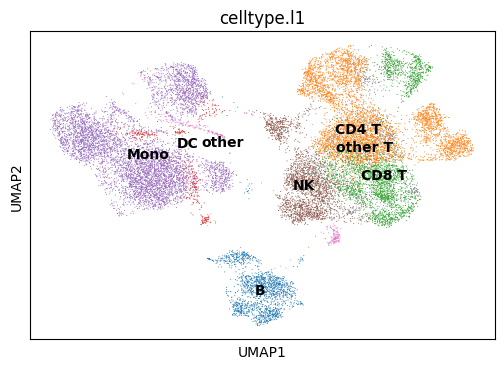

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


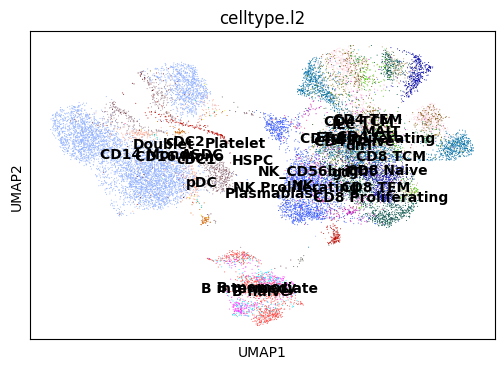

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


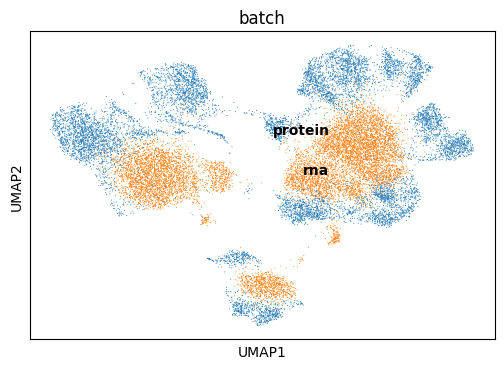

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


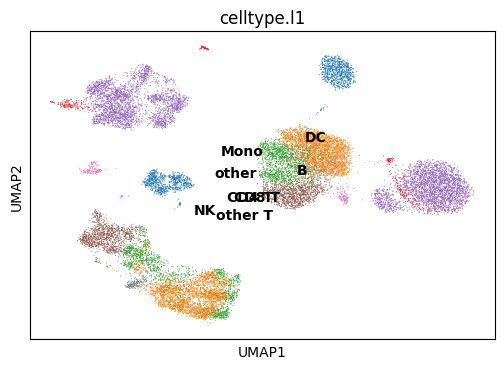

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


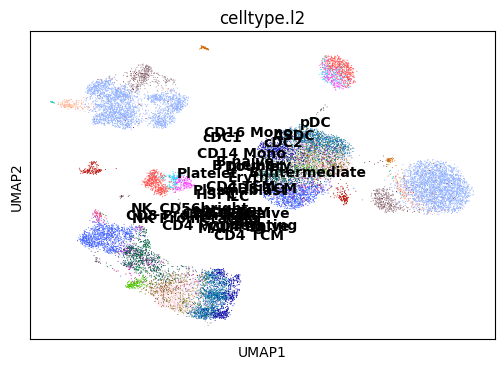

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


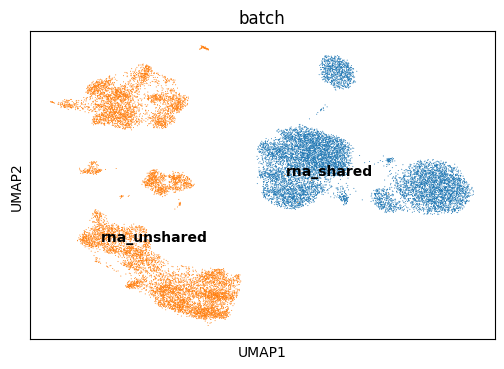

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


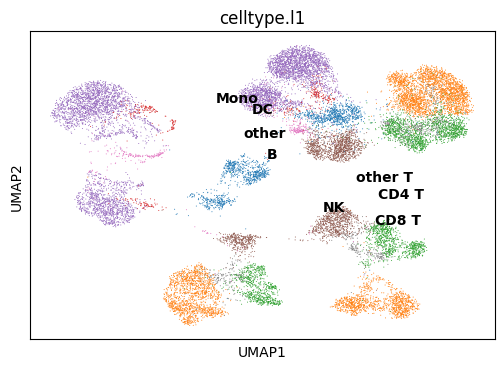

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


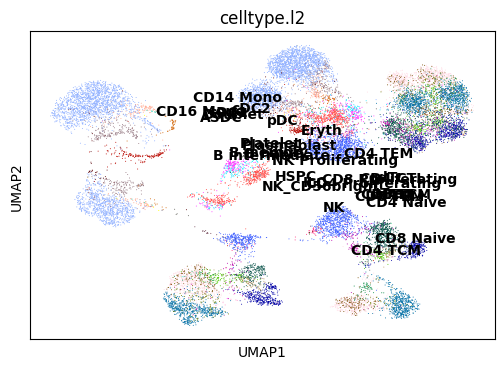

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


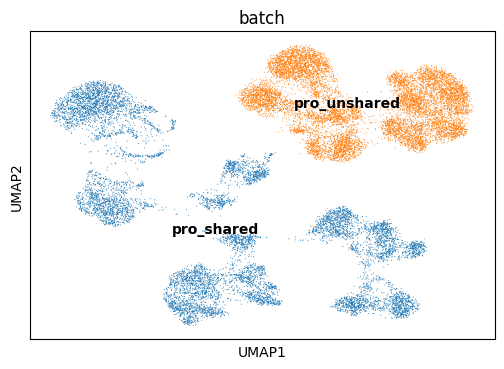

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For All matchings: lv1 matching acc: 0.718,
lv2 matching acc: 0.523.
For All matchings: FOSCTTM score: 0.26977656, 
Knn Alignment score: [0.0016 0.0026 0.0039 0.0045 0.0053 0.006  0.0071 0.008  0.0088 0.0096
 0.0109 0.0114 0.0128 0.0134 0.0141 0.0151 0.0159 0.0167 0.0174 0.0183
 0.0191 0.0196 0.0208 0.0218 0.0229]
For All matchings: Silhouette F1 score for lv1: 0.4993006093995047, 
Silhouette F1 score for lv2: 0.4869252146316082



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  3.5520042181015015
Matchings are reduced to 5000 after filtering...


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:423: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[matchings[0]], labels_l1[matchings[1]])
C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For only filtered matchings: lv1 matching acc: 0.816,
lv2 matching acc: 0.601.



Matches are being propagated....


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:460: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[filtered_matchings[0]], labels_l1[filtered_matchings[1]])


Done!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For all matchings after propagation: lv1 matching acc: 0.744,
lv2 matching acc: 0.552.


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:495: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[propagated_matchings[0]], labels_l1[propagated_matchings[1]])


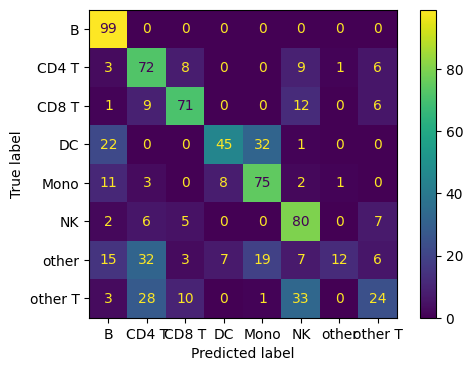

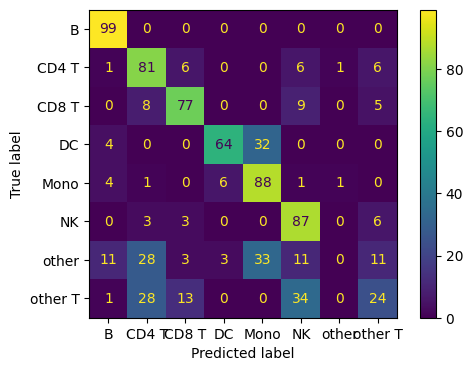

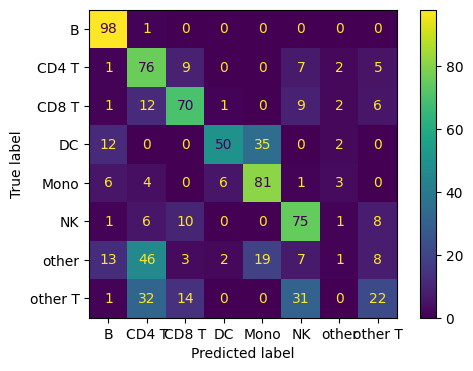

Epoch: 801: 0it [00:00, ?it/s]C:\Users\vinee\AppData\Local\Temp\ipykernel_2144\3129631169.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return {"x_unshared":self.unshared_data[idx], "x_shared":self.shared_data[idx], "l1":self.labels_l1[idx], "l2":self.labels_l2[idx], "mean": self.local_mean[idx], "var": self.local_var[idx], "batch": self.batch[idx]}
Epoch: 801: 40it [00:13,  2.94it/s]


RNA Recon Loss: 2.0086, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4287, Protein Recon Loss: 0.4884, Protein KL Div Back Pro: 0.8338, Protein KL Div Z: 0.6180, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5387, Shared Recon Loss Gene: 0.2588, Shared Recon Loss Protein: 1.7998 Cross Loss Protein: 0.5409


Epoch: 802: 40it [00:13,  2.91it/s]


RNA Recon Loss: 2.0063, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4286, Protein Recon Loss: 0.4880, Protein KL Div Back Pro: 0.8302, Protein KL Div Z: 0.6172, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5396, Shared Recon Loss Gene: 0.2586, Shared Recon Loss Protein: 1.8014 Cross Loss Protein: 0.5413


Epoch: 803: 40it [00:13,  2.87it/s]


RNA Recon Loss: 2.0046, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4288, Protein Recon Loss: 0.4873, Protein KL Div Back Pro: 0.8314, Protein KL Div Z: 0.6184, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5396, Shared Recon Loss Gene: 0.2585, Shared Recon Loss Protein: 1.7994 Cross Loss Protein: 0.5405


Epoch: 804: 40it [00:13,  2.86it/s]


RNA Recon Loss: 2.0076, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4282, Protein Recon Loss: 0.4873, Protein KL Div Back Pro: 0.8303, Protein KL Div Z: 0.6173, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5403, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.8026 Cross Loss Protein: 0.5412


Epoch: 805: 40it [00:13,  2.96it/s]


RNA Recon Loss: 2.0097, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4294, Protein Recon Loss: 0.4869, Protein KL Div Back Pro: 0.8292, Protein KL Div Z: 0.6170, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5395, Shared Recon Loss Gene: 0.2591, Shared Recon Loss Protein: 1.8016 Cross Loss Protein: 0.5401


Epoch: 806: 40it [00:14,  2.84it/s]


RNA Recon Loss: 2.0093, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4293, Protein Recon Loss: 0.4873, Protein KL Div Back Pro: 0.8291, Protein KL Div Z: 0.6167, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5384, Shared Recon Loss Gene: 0.2583, Shared Recon Loss Protein: 1.7992 Cross Loss Protein: 0.5403


Epoch: 807: 40it [00:14,  2.79it/s]


RNA Recon Loss: 2.0014, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4287, Protein Recon Loss: 0.4867, Protein KL Div Back Pro: 0.8304, Protein KL Div Z: 0.6172, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5399, Shared Recon Loss Gene: 0.2585, Shared Recon Loss Protein: 1.7991 Cross Loss Protein: 0.5405


Epoch: 808: 40it [00:14,  2.77it/s]


RNA Recon Loss: 2.0072, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4287, Protein Recon Loss: 0.4874, Protein KL Div Back Pro: 0.8318, Protein KL Div Z: 0.6173, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5401, Shared Recon Loss Gene: 0.2589, Shared Recon Loss Protein: 1.8000 Cross Loss Protein: 0.5411


Epoch: 809: 40it [00:14,  2.79it/s]


RNA Recon Loss: 2.0128, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4293, Protein Recon Loss: 0.4867, Protein KL Div Back Pro: 0.8292, Protein KL Div Z: 0.6172, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5401, Shared Recon Loss Gene: 0.2593, Shared Recon Loss Protein: 1.7992 Cross Loss Protein: 0.5405


Epoch: 810: 40it [00:14,  2.85it/s]


RNA Recon Loss: 2.0028, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4285, Protein Recon Loss: 0.4871, Protein KL Div Back Pro: 0.8303, Protein KL Div Z: 0.6161, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5389, Shared Recon Loss Gene: 0.2582, Shared Recon Loss Protein: 1.8008 Cross Loss Protein: 0.5405


Epoch: 811: 40it [00:14,  2.75it/s]


RNA Recon Loss: 2.0072, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4282, Protein Recon Loss: 0.4869, Protein KL Div Back Pro: 0.8330, Protein KL Div Z: 0.6176, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5391, Shared Recon Loss Gene: 0.2591, Shared Recon Loss Protein: 1.7987 Cross Loss Protein: 0.5404


Epoch: 812: 40it [00:14,  2.80it/s]


RNA Recon Loss: 2.0053, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4283, Protein Recon Loss: 0.4873, Protein KL Div Back Pro: 0.8345, Protein KL Div Z: 0.6179, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5398, Shared Recon Loss Gene: 0.2589, Shared Recon Loss Protein: 1.8000 Cross Loss Protein: 0.5408


Epoch: 813: 40it [00:14,  2.78it/s]


RNA Recon Loss: 2.0137, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4285, Protein Recon Loss: 0.4876, Protein KL Div Back Pro: 0.8356, Protein KL Div Z: 0.6180, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5390, Shared Recon Loss Gene: 0.2592, Shared Recon Loss Protein: 1.7993 Cross Loss Protein: 0.5408


Epoch: 814: 40it [00:13,  2.86it/s]


RNA Recon Loss: 2.0062, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4289, Protein Recon Loss: 0.4870, Protein KL Div Back Pro: 0.8360, Protein KL Div Z: 0.6185, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5394, Shared Recon Loss Gene: 0.2585, Shared Recon Loss Protein: 1.8019 Cross Loss Protein: 0.5404


Epoch: 815: 40it [00:13,  2.88it/s]


RNA Recon Loss: 2.0114, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4289, Protein Recon Loss: 0.4874, Protein KL Div Back Pro: 0.8330, Protein KL Div Z: 0.6182, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5389, Shared Recon Loss Gene: 0.2594, Shared Recon Loss Protein: 1.8039 Cross Loss Protein: 0.5411


Epoch: 816: 40it [00:14,  2.77it/s]


RNA Recon Loss: 1.9992, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4282, Protein Recon Loss: 0.4876, Protein KL Div Back Pro: 0.8331, Protein KL Div Z: 0.6176, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5388, Shared Recon Loss Gene: 0.2579, Shared Recon Loss Protein: 1.8060 Cross Loss Protein: 0.5411


Epoch: 817: 40it [00:14,  2.76it/s]


RNA Recon Loss: 2.0005, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4281, Protein Recon Loss: 0.4873, Protein KL Div Back Pro: 0.8359, Protein KL Div Z: 0.6187, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5392, Shared Recon Loss Gene: 0.2587, Shared Recon Loss Protein: 1.8033 Cross Loss Protein: 0.5415


Epoch: 818: 40it [00:14,  2.81it/s]


RNA Recon Loss: 2.0102, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4290, Protein Recon Loss: 0.4875, Protein KL Div Back Pro: 0.8336, Protein KL Div Z: 0.6186, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5394, Shared Recon Loss Gene: 0.2591, Shared Recon Loss Protein: 1.8025 Cross Loss Protein: 0.5414


Epoch: 819: 40it [00:14,  2.77it/s]


RNA Recon Loss: 2.0059, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4295, Protein Recon Loss: 0.4882, Protein KL Div Back Pro: 0.8335, Protein KL Div Z: 0.6176, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5393, Shared Recon Loss Gene: 0.2591, Shared Recon Loss Protein: 1.7983 Cross Loss Protein: 0.5407


Epoch: 820: 40it [00:14,  2.78it/s]


RNA Recon Loss: 2.0067, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4282, Protein Recon Loss: 0.4879, Protein KL Div Back Pro: 0.8375, Protein KL Div Z: 0.6175, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5398, Shared Recon Loss Gene: 0.2586, Shared Recon Loss Protein: 1.8010 Cross Loss Protein: 0.5413


Epoch: 821: 40it [00:13,  2.87it/s]


RNA Recon Loss: 2.0104, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4287, Protein Recon Loss: 0.4890, Protein KL Div Back Pro: 0.8347, Protein KL Div Z: 0.6187, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5392, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.8031 Cross Loss Protein: 0.5416


Epoch: 822: 40it [00:13,  2.89it/s]


RNA Recon Loss: 2.0029, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4282, Protein Recon Loss: 0.4877, Protein KL Div Back Pro: 0.8345, Protein KL Div Z: 0.6162, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5397, Shared Recon Loss Gene: 0.2581, Shared Recon Loss Protein: 1.7993 Cross Loss Protein: 0.5406


Epoch: 823: 40it [00:13,  2.96it/s]


RNA Recon Loss: 2.0076, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4282, Protein Recon Loss: 0.4869, Protein KL Div Back Pro: 0.8317, Protein KL Div Z: 0.6150, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5389, Shared Recon Loss Gene: 0.2583, Shared Recon Loss Protein: 1.7985 Cross Loss Protein: 0.5408


Epoch: 824: 40it [00:12,  3.18it/s]


RNA Recon Loss: 2.0065, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4277, Protein Recon Loss: 0.4881, Protein KL Div Back Pro: 0.8318, Protein KL Div Z: 0.6168, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5396, Shared Recon Loss Gene: 0.2578, Shared Recon Loss Protein: 1.8017 Cross Loss Protein: 0.5414


Epoch: 825: 40it [00:12,  3.17it/s]


RNA Recon Loss: 2.0058, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4285, Protein Recon Loss: 0.4874, Protein KL Div Back Pro: 0.8309, Protein KL Div Z: 0.6158, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5399, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.7986 Cross Loss Protein: 0.5407


Epoch: 826: 40it [00:12,  3.20it/s]


RNA Recon Loss: 2.0027, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4288, Protein Recon Loss: 0.4886, Protein KL Div Back Pro: 0.8287, Protein KL Div Z: 0.6142, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5391, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.8049 Cross Loss Protein: 0.5422


Epoch: 827: 40it [00:12,  3.20it/s]


RNA Recon Loss: 2.0102, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4283, Protein Recon Loss: 0.4879, Protein KL Div Back Pro: 0.8329, Protein KL Div Z: 0.6172, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5389, Shared Recon Loss Gene: 0.2591, Shared Recon Loss Protein: 1.8037 Cross Loss Protein: 0.5420


Epoch: 828: 40it [00:12,  3.18it/s]


RNA Recon Loss: 2.0060, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4279, Protein Recon Loss: 0.4877, Protein KL Div Back Pro: 0.8320, Protein KL Div Z: 0.6154, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5399, Shared Recon Loss Gene: 0.2585, Shared Recon Loss Protein: 1.8055 Cross Loss Protein: 0.5416


Epoch: 829: 40it [00:12,  3.17it/s]


RNA Recon Loss: 2.0083, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4275, Protein Recon Loss: 0.4870, Protein KL Div Back Pro: 0.8319, Protein KL Div Z: 0.6170, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5398, Shared Recon Loss Gene: 0.2589, Shared Recon Loss Protein: 1.7998 Cross Loss Protein: 0.5406


Epoch: 830: 40it [00:12,  3.18it/s]


RNA Recon Loss: 2.0072, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4276, Protein Recon Loss: 0.4877, Protein KL Div Back Pro: 0.8308, Protein KL Div Z: 0.6178, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5396, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.8007 Cross Loss Protein: 0.5410


Epoch: 831: 40it [00:12,  3.21it/s]


RNA Recon Loss: 2.0016, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4276, Protein Recon Loss: 0.4875, Protein KL Div Back Pro: 0.8351, Protein KL Div Z: 0.6156, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5395, Shared Recon Loss Gene: 0.2581, Shared Recon Loss Protein: 1.8006 Cross Loss Protein: 0.5406


Epoch: 832: 40it [00:12,  3.14it/s]


RNA Recon Loss: 2.0035, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4280, Protein Recon Loss: 0.4875, Protein KL Div Back Pro: 0.8313, Protein KL Div Z: 0.6161, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5391, Shared Recon Loss Gene: 0.2591, Shared Recon Loss Protein: 1.8017 Cross Loss Protein: 0.5408


Epoch: 833: 40it [00:12,  3.20it/s]


RNA Recon Loss: 2.0095, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4280, Protein Recon Loss: 0.4869, Protein KL Div Back Pro: 0.8331, Protein KL Div Z: 0.6170, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5395, Shared Recon Loss Gene: 0.2589, Shared Recon Loss Protein: 1.7992 Cross Loss Protein: 0.5406


Epoch: 834: 40it [00:12,  3.20it/s]


RNA Recon Loss: 2.0050, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4285, Protein Recon Loss: 0.4874, Protein KL Div Back Pro: 0.8333, Protein KL Div Z: 0.6167, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5390, Shared Recon Loss Gene: 0.2581, Shared Recon Loss Protein: 1.7995 Cross Loss Protein: 0.5404


Epoch: 835: 40it [00:12,  3.20it/s]


RNA Recon Loss: 2.0019, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4277, Protein Recon Loss: 0.4871, Protein KL Div Back Pro: 0.8299, Protein KL Div Z: 0.6153, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5386, Shared Recon Loss Gene: 0.2582, Shared Recon Loss Protein: 1.7975 Cross Loss Protein: 0.5404


Epoch: 836: 40it [00:12,  3.19it/s]


RNA Recon Loss: 2.0098, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4279, Protein Recon Loss: 0.4875, Protein KL Div Back Pro: 0.8320, Protein KL Div Z: 0.6156, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5381, Shared Recon Loss Gene: 0.2588, Shared Recon Loss Protein: 1.7991 Cross Loss Protein: 0.5401


Epoch: 837: 40it [00:12,  3.21it/s]


RNA Recon Loss: 1.9992, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4272, Protein Recon Loss: 0.4870, Protein KL Div Back Pro: 0.8339, Protein KL Div Z: 0.6175, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5395, Shared Recon Loss Gene: 0.2582, Shared Recon Loss Protein: 1.7996 Cross Loss Protein: 0.5406


Epoch: 838: 40it [00:12,  3.20it/s]


RNA Recon Loss: 2.0046, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4277, Protein Recon Loss: 0.4877, Protein KL Div Back Pro: 0.8320, Protein KL Div Z: 0.6162, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5387, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.7993 Cross Loss Protein: 0.5408


Epoch: 839: 40it [00:12,  3.19it/s]


RNA Recon Loss: 2.0045, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4279, Protein Recon Loss: 0.4876, Protein KL Div Back Pro: 0.8311, Protein KL Div Z: 0.6160, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5388, Shared Recon Loss Gene: 0.2580, Shared Recon Loss Protein: 1.8000 Cross Loss Protein: 0.5407


Epoch: 840: 40it [00:12,  3.16it/s]


RNA Recon Loss: 2.0070, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4284, Protein Recon Loss: 0.4879, Protein KL Div Back Pro: 0.8325, Protein KL Div Z: 0.6152, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5393, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.8003 Cross Loss Protein: 0.5410


Epoch: 841: 40it [00:12,  3.17it/s]


RNA Recon Loss: 2.0026, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4280, Protein Recon Loss: 0.4881, Protein KL Div Back Pro: 0.8343, Protein KL Div Z: 0.6171, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5390, Shared Recon Loss Gene: 0.2580, Shared Recon Loss Protein: 1.8020 Cross Loss Protein: 0.5415


Epoch: 842: 40it [00:12,  3.08it/s]


RNA Recon Loss: 2.0096, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4281, Protein Recon Loss: 0.4879, Protein KL Div Back Pro: 0.8359, Protein KL Div Z: 0.6168, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5392, Shared Recon Loss Gene: 0.2592, Shared Recon Loss Protein: 1.7991 Cross Loss Protein: 0.5401


Epoch: 843: 40it [00:12,  3.18it/s]


RNA Recon Loss: 2.0071, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4275, Protein Recon Loss: 0.4883, Protein KL Div Back Pro: 0.8311, Protein KL Div Z: 0.6157, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5389, Shared Recon Loss Gene: 0.2594, Shared Recon Loss Protein: 1.8000 Cross Loss Protein: 0.5406


Epoch: 844: 40it [00:12,  3.18it/s]


RNA Recon Loss: 2.0127, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4284, Protein Recon Loss: 0.4866, Protein KL Div Back Pro: 0.8335, Protein KL Div Z: 0.6149, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5391, Shared Recon Loss Gene: 0.2596, Shared Recon Loss Protein: 1.7986 Cross Loss Protein: 0.5404


Epoch: 845: 40it [00:12,  3.16it/s]


RNA Recon Loss: 2.0043, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4275, Protein Recon Loss: 0.4874, Protein KL Div Back Pro: 0.8342, Protein KL Div Z: 0.6164, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5391, Shared Recon Loss Gene: 0.2580, Shared Recon Loss Protein: 1.8008 Cross Loss Protein: 0.5411


Epoch: 846: 40it [00:12,  3.18it/s]


RNA Recon Loss: 2.0012, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4271, Protein Recon Loss: 0.4877, Protein KL Div Back Pro: 0.8359, Protein KL Div Z: 0.6168, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5395, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7993 Cross Loss Protein: 0.5410


Epoch: 847: 40it [00:12,  3.16it/s]


RNA Recon Loss: 1.9985, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4279, Protein Recon Loss: 0.4873, Protein KL Div Back Pro: 0.8319, Protein KL Div Z: 0.6158, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5386, Shared Recon Loss Gene: 0.2578, Shared Recon Loss Protein: 1.8002 Cross Loss Protein: 0.5410


Epoch: 848: 40it [00:12,  3.18it/s]


RNA Recon Loss: 2.0027, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4279, Protein Recon Loss: 0.4875, Protein KL Div Back Pro: 0.8303, Protein KL Div Z: 0.6160, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5386, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.7991 Cross Loss Protein: 0.5409


Epoch: 849: 40it [00:12,  3.20it/s]


RNA Recon Loss: 2.0022, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4273, Protein Recon Loss: 0.4869, Protein KL Div Back Pro: 0.8315, Protein KL Div Z: 0.6167, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5379, Shared Recon Loss Gene: 0.2581, Shared Recon Loss Protein: 1.7996 Cross Loss Protein: 0.5402


Epoch: 850: 40it [00:12,  3.16it/s]


RNA Recon Loss: 2.0044, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4272, Protein Recon Loss: 0.4868, Protein KL Div Back Pro: 0.8292, Protein KL Div Z: 0.6163, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5386, Shared Recon Loss Gene: 0.2581, Shared Recon Loss Protein: 1.7992 Cross Loss Protein: 0.5403


Epoch: 851: 40it [00:12,  3.14it/s]


RNA Recon Loss: 2.0072, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4273, Protein Recon Loss: 0.4865, Protein KL Div Back Pro: 0.8293, Protein KL Div Z: 0.6151, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5380, Shared Recon Loss Gene: 0.2592, Shared Recon Loss Protein: 1.7990 Cross Loss Protein: 0.5403


Epoch: 852: 40it [00:12,  3.17it/s]


RNA Recon Loss: 2.0029, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4277, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8301, Protein KL Div Z: 0.6158, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5376, Shared Recon Loss Gene: 0.2585, Shared Recon Loss Protein: 1.7982 Cross Loss Protein: 0.5399


Epoch: 853: 40it [00:12,  3.17it/s]


RNA Recon Loss: 2.0115, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4274, Protein Recon Loss: 0.4873, Protein KL Div Back Pro: 0.8287, Protein KL Div Z: 0.6164, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5385, Shared Recon Loss Gene: 0.2590, Shared Recon Loss Protein: 1.8000 Cross Loss Protein: 0.5415


Epoch: 854: 40it [00:12,  3.15it/s]


RNA Recon Loss: 2.0049, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4277, Protein Recon Loss: 0.4879, Protein KL Div Back Pro: 0.8304, Protein KL Div Z: 0.6154, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5376, Shared Recon Loss Gene: 0.2581, Shared Recon Loss Protein: 1.8003 Cross Loss Protein: 0.5408


Epoch: 855: 40it [00:12,  3.17it/s]


RNA Recon Loss: 2.0046, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4276, Protein Recon Loss: 0.4872, Protein KL Div Back Pro: 0.8344, Protein KL Div Z: 0.6163, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5375, Shared Recon Loss Gene: 0.2588, Shared Recon Loss Protein: 1.7979 Cross Loss Protein: 0.5408


Epoch: 856: 40it [00:15,  2.57it/s]


RNA Recon Loss: 2.0094, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4275, Protein Recon Loss: 0.4880, Protein KL Div Back Pro: 0.8308, Protein KL Div Z: 0.6155, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5374, Shared Recon Loss Gene: 0.2590, Shared Recon Loss Protein: 1.8025 Cross Loss Protein: 0.5413


Epoch: 857: 40it [22:43, 34.09s/it] 


RNA Recon Loss: 2.0027, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4280, Protein Recon Loss: 0.4874, Protein KL Div Back Pro: 0.8337, Protein KL Div Z: 0.6145, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5375, Shared Recon Loss Gene: 0.2585, Shared Recon Loss Protein: 1.8002 Cross Loss Protein: 0.5412


Epoch: 858: 40it [00:13,  3.04it/s]


RNA Recon Loss: 1.9991, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4277, Protein Recon Loss: 0.4875, Protein KL Div Back Pro: 0.8335, Protein KL Div Z: 0.6167, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5376, Shared Recon Loss Gene: 0.2580, Shared Recon Loss Protein: 1.7997 Cross Loss Protein: 0.5404


Epoch: 859: 40it [00:13,  2.94it/s]


RNA Recon Loss: 2.0092, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4270, Protein Recon Loss: 0.4876, Protein KL Div Back Pro: 0.8335, Protein KL Div Z: 0.6158, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5370, Shared Recon Loss Gene: 0.2585, Shared Recon Loss Protein: 1.8006 Cross Loss Protein: 0.5410


Epoch: 860: 40it [00:13,  2.97it/s]


RNA Recon Loss: 2.0012, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4276, Protein Recon Loss: 0.4873, Protein KL Div Back Pro: 0.8336, Protein KL Div Z: 0.6151, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5374, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.8010 Cross Loss Protein: 0.5413


Epoch: 861: 40it [00:17,  2.32it/s]


RNA Recon Loss: 2.0100, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4277, Protein Recon Loss: 0.4889, Protein KL Div Back Pro: 0.8326, Protein KL Div Z: 0.6149, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5361, Shared Recon Loss Gene: 0.2588, Shared Recon Loss Protein: 1.8032 Cross Loss Protein: 0.5418


Epoch: 862: 40it [00:12,  3.12it/s]


RNA Recon Loss: 2.0041, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4272, Protein Recon Loss: 0.4876, Protein KL Div Back Pro: 0.8319, Protein KL Div Z: 0.6161, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5368, Shared Recon Loss Gene: 0.2581, Shared Recon Loss Protein: 1.8027 Cross Loss Protein: 0.5413


Epoch: 863: 40it [00:12,  3.14it/s]


RNA Recon Loss: 2.0097, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4281, Protein Recon Loss: 0.4870, Protein KL Div Back Pro: 0.8323, Protein KL Div Z: 0.6147, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5368, Shared Recon Loss Gene: 0.2591, Shared Recon Loss Protein: 1.8001 Cross Loss Protein: 0.5410


Epoch: 864: 40it [00:12,  3.15it/s]


RNA Recon Loss: 2.0070, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4277, Protein Recon Loss: 0.4870, Protein KL Div Back Pro: 0.8309, Protein KL Div Z: 0.6144, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5369, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.7996 Cross Loss Protein: 0.5405


Epoch: 865: 40it [00:12,  3.17it/s]


RNA Recon Loss: 2.0048, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4279, Protein Recon Loss: 0.4868, Protein KL Div Back Pro: 0.8325, Protein KL Div Z: 0.6142, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5367, Shared Recon Loss Gene: 0.2588, Shared Recon Loss Protein: 1.7983 Cross Loss Protein: 0.5406


Epoch: 866: 40it [00:12,  3.30it/s]


RNA Recon Loss: 2.0044, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4272, Protein Recon Loss: 0.4869, Protein KL Div Back Pro: 0.8316, Protein KL Div Z: 0.6148, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5367, Shared Recon Loss Gene: 0.2579, Shared Recon Loss Protein: 1.7989 Cross Loss Protein: 0.5404


Epoch: 867: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.0020, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4277, Protein Recon Loss: 0.4874, Protein KL Div Back Pro: 0.8293, Protein KL Div Z: 0.6159, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5370, Shared Recon Loss Gene: 0.2583, Shared Recon Loss Protein: 1.8016 Cross Loss Protein: 0.5416


Epoch: 868: 40it [00:12,  3.09it/s]


RNA Recon Loss: 2.0062, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4277, Protein Recon Loss: 0.4870, Protein KL Div Back Pro: 0.8299, Protein KL Div Z: 0.6156, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5358, Shared Recon Loss Gene: 0.2587, Shared Recon Loss Protein: 1.8026 Cross Loss Protein: 0.5404


Epoch: 869: 40it [00:13,  2.98it/s]


RNA Recon Loss: 2.0015, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4272, Protein Recon Loss: 0.4878, Protein KL Div Back Pro: 0.8284, Protein KL Div Z: 0.6158, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5366, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.8001 Cross Loss Protein: 0.5404


Epoch: 870: 40it [00:12,  3.13it/s]


RNA Recon Loss: 2.0031, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4269, Protein Recon Loss: 0.4873, Protein KL Div Back Pro: 0.8284, Protein KL Div Z: 0.6143, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5364, Shared Recon Loss Gene: 0.2586, Shared Recon Loss Protein: 1.7988 Cross Loss Protein: 0.5406


Epoch: 871: 40it [00:12,  3.12it/s]


RNA Recon Loss: 1.9972, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4268, Protein Recon Loss: 0.4871, Protein KL Div Back Pro: 0.8316, Protein KL Div Z: 0.6164, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5362, Shared Recon Loss Gene: 0.2577, Shared Recon Loss Protein: 1.7999 Cross Loss Protein: 0.5407


Epoch: 872: 40it [00:13,  2.96it/s]


RNA Recon Loss: 2.0055, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4263, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8303, Protein KL Div Z: 0.6149, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5357, Shared Recon Loss Gene: 0.2582, Shared Recon Loss Protein: 1.8004 Cross Loss Protein: 0.5403


Epoch: 873: 40it [00:13,  3.07it/s]


RNA Recon Loss: 2.0111, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4270, Protein Recon Loss: 0.4876, Protein KL Div Back Pro: 0.8300, Protein KL Div Z: 0.6156, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5358, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.8009 Cross Loss Protein: 0.5415


Epoch: 874: 40it [00:12,  3.12it/s]


RNA Recon Loss: 2.0172, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4269, Protein Recon Loss: 0.4866, Protein KL Div Back Pro: 0.8348, Protein KL Div Z: 0.6157, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5371, Shared Recon Loss Gene: 0.2593, Shared Recon Loss Protein: 1.7999 Cross Loss Protein: 0.5400


Epoch: 875: 40it [00:12,  3.11it/s]


RNA Recon Loss: 2.0043, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4273, Protein Recon Loss: 0.4876, Protein KL Div Back Pro: 0.8323, Protein KL Div Z: 0.6139, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5365, Shared Recon Loss Gene: 0.2579, Shared Recon Loss Protein: 1.8005 Cross Loss Protein: 0.5410


Epoch: 876: 40it [00:12,  3.09it/s]


RNA Recon Loss: 1.9986, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4268, Protein Recon Loss: 0.4884, Protein KL Div Back Pro: 0.8316, Protein KL Div Z: 0.6145, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5366, Shared Recon Loss Gene: 0.2579, Shared Recon Loss Protein: 1.8030 Cross Loss Protein: 0.5412


Epoch: 877: 40it [00:12,  3.09it/s]


RNA Recon Loss: 2.0032, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4268, Protein Recon Loss: 0.4872, Protein KL Div Back Pro: 0.8349, Protein KL Div Z: 0.6156, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5367, Shared Recon Loss Gene: 0.2586, Shared Recon Loss Protein: 1.7991 Cross Loss Protein: 0.5408


Epoch: 878: 40it [00:13,  2.94it/s]


RNA Recon Loss: 2.0007, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4263, Protein Recon Loss: 0.4881, Protein KL Div Back Pro: 0.8305, Protein KL Div Z: 0.6131, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5360, Shared Recon Loss Gene: 0.2585, Shared Recon Loss Protein: 1.7968 Cross Loss Protein: 0.5418


Epoch: 879: 40it [00:14,  2.85it/s]


RNA Recon Loss: 2.0158, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4267, Protein Recon Loss: 0.4873, Protein KL Div Back Pro: 0.8351, Protein KL Div Z: 0.6159, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5360, Shared Recon Loss Gene: 0.2593, Shared Recon Loss Protein: 1.8003 Cross Loss Protein: 0.5414


Epoch: 880: 40it [00:15,  2.61it/s]


RNA Recon Loss: 2.0000, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4269, Protein Recon Loss: 0.4873, Protein KL Div Back Pro: 0.8324, Protein KL Div Z: 0.6143, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5373, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7990 Cross Loss Protein: 0.5411


Epoch: 881: 40it [00:13,  2.96it/s]


RNA Recon Loss: 2.0016, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4266, Protein Recon Loss: 0.4870, Protein KL Div Back Pro: 0.8322, Protein KL Div Z: 0.6153, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5366, Shared Recon Loss Gene: 0.2579, Shared Recon Loss Protein: 1.8001 Cross Loss Protein: 0.5406


Epoch: 882: 40it [00:14,  2.68it/s]


RNA Recon Loss: 2.0007, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4263, Protein Recon Loss: 0.4868, Protein KL Div Back Pro: 0.8299, Protein KL Div Z: 0.6146, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5376, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7981 Cross Loss Protein: 0.5405


Epoch: 883: 40it [00:15,  2.53it/s]


RNA Recon Loss: 2.0044, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4265, Protein Recon Loss: 0.4868, Protein KL Div Back Pro: 0.8291, Protein KL Div Z: 0.6143, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5365, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.7994 Cross Loss Protein: 0.5399


Epoch: 884: 40it [00:17,  2.23it/s]


RNA Recon Loss: 1.9995, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4265, Protein Recon Loss: 0.4872, Protein KL Div Back Pro: 0.8302, Protein KL Div Z: 0.6152, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5363, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7997 Cross Loss Protein: 0.5407


Epoch: 885: 40it [00:13,  3.05it/s]


RNA Recon Loss: 2.0102, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4264, Protein Recon Loss: 0.4880, Protein KL Div Back Pro: 0.8291, Protein KL Div Z: 0.6144, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5362, Shared Recon Loss Gene: 0.2588, Shared Recon Loss Protein: 1.7987 Cross Loss Protein: 0.5403


Epoch: 886: 40it [00:13,  2.86it/s]


RNA Recon Loss: 2.0013, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4268, Protein Recon Loss: 0.4873, Protein KL Div Back Pro: 0.8289, Protein KL Div Z: 0.6143, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5364, Shared Recon Loss Gene: 0.2578, Shared Recon Loss Protein: 1.8012 Cross Loss Protein: 0.5412


Epoch: 887: 40it [00:14,  2.85it/s]


RNA Recon Loss: 2.0052, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4267, Protein Recon Loss: 0.4874, Protein KL Div Back Pro: 0.8282, Protein KL Div Z: 0.6149, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5362, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.8003 Cross Loss Protein: 0.5409


Epoch: 888: 40it [00:13,  2.94it/s]


RNA Recon Loss: 2.0086, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4273, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8294, Protein KL Div Z: 0.6146, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5359, Shared Recon Loss Gene: 0.2592, Shared Recon Loss Protein: 1.7993 Cross Loss Protein: 0.5402


Epoch: 889: 40it [00:14,  2.79it/s]


RNA Recon Loss: 2.0090, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4270, Protein Recon Loss: 0.4868, Protein KL Div Back Pro: 0.8298, Protein KL Div Z: 0.6143, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5355, Shared Recon Loss Gene: 0.2587, Shared Recon Loss Protein: 1.7974 Cross Loss Protein: 0.5405


Epoch: 890: 40it [00:13,  2.95it/s]


RNA Recon Loss: 2.0040, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4261, Protein Recon Loss: 0.4866, Protein KL Div Back Pro: 0.8278, Protein KL Div Z: 0.6141, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5361, Shared Recon Loss Gene: 0.2580, Shared Recon Loss Protein: 1.7977 Cross Loss Protein: 0.5405


Epoch: 891: 40it [00:13,  2.90it/s]


RNA Recon Loss: 2.0081, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4269, Protein Recon Loss: 0.4867, Protein KL Div Back Pro: 0.8267, Protein KL Div Z: 0.6131, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5354, Shared Recon Loss Gene: 0.2585, Shared Recon Loss Protein: 1.7979 Cross Loss Protein: 0.5400


Epoch: 892: 40it [00:14,  2.80it/s]


RNA Recon Loss: 2.0088, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4264, Protein Recon Loss: 0.4878, Protein KL Div Back Pro: 0.8297, Protein KL Div Z: 0.6152, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5361, Shared Recon Loss Gene: 0.2587, Shared Recon Loss Protein: 1.8013 Cross Loss Protein: 0.5411


Epoch: 893: 40it [00:14,  2.75it/s]


RNA Recon Loss: 2.0018, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4264, Protein Recon Loss: 0.4875, Protein KL Div Back Pro: 0.8295, Protein KL Div Z: 0.6152, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5359, Shared Recon Loss Gene: 0.2582, Shared Recon Loss Protein: 1.8019 Cross Loss Protein: 0.5413


Epoch: 894: 40it [00:13,  2.95it/s]


RNA Recon Loss: 2.0068, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4255, Protein Recon Loss: 0.4875, Protein KL Div Back Pro: 0.8304, Protein KL Div Z: 0.6146, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5357, Shared Recon Loss Gene: 0.2590, Shared Recon Loss Protein: 1.8007 Cross Loss Protein: 0.5413


Epoch: 895: 40it [00:13,  2.93it/s]


RNA Recon Loss: 2.0104, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4267, Protein Recon Loss: 0.4872, Protein KL Div Back Pro: 0.8322, Protein KL Div Z: 0.6141, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5354, Shared Recon Loss Gene: 0.2587, Shared Recon Loss Protein: 1.7999 Cross Loss Protein: 0.5409


Epoch: 896: 40it [00:15,  2.61it/s]


RNA Recon Loss: 2.0011, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4263, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8300, Protein KL Div Z: 0.6153, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5357, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7986 Cross Loss Protein: 0.5401


Epoch: 897: 40it [00:14,  2.69it/s]


RNA Recon Loss: 2.0154, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4269, Protein Recon Loss: 0.4872, Protein KL Div Back Pro: 0.8319, Protein KL Div Z: 0.6161, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5356, Shared Recon Loss Gene: 0.2594, Shared Recon Loss Protein: 1.7983 Cross Loss Protein: 0.5410


Epoch: 898: 40it [00:14,  2.68it/s]


RNA Recon Loss: 2.0019, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4271, Protein Recon Loss: 0.4873, Protein KL Div Back Pro: 0.8305, Protein KL Div Z: 0.6157, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5354, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.8000 Cross Loss Protein: 0.5412


Epoch: 899: 40it [00:14,  2.69it/s]


RNA Recon Loss: 2.0023, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4263, Protein Recon Loss: 0.4872, Protein KL Div Back Pro: 0.8296, Protein KL Div Z: 0.6148, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5351, Shared Recon Loss Gene: 0.2585, Shared Recon Loss Protein: 1.8003 Cross Loss Protein: 0.5409


Epoch: 900: 40it [00:15,  2.63it/s]


RNA Recon Loss: 2.0005, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4260, Protein Recon Loss: 0.4872, Protein KL Div Back Pro: 0.8332, Protein KL Div Z: 0.6149, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5355, Shared Recon Loss Gene: 0.2577, Shared Recon Loss Protein: 1.7999 Cross Loss Protein: 0.5408


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


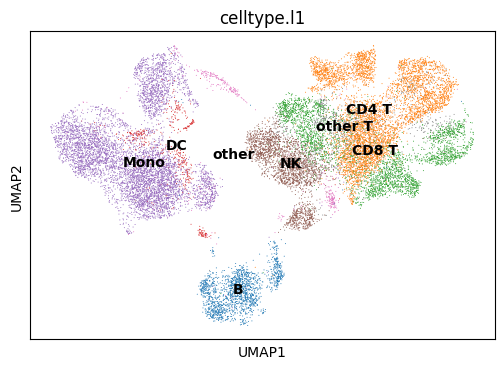

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


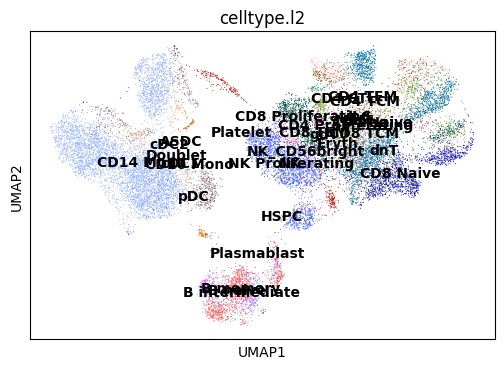

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


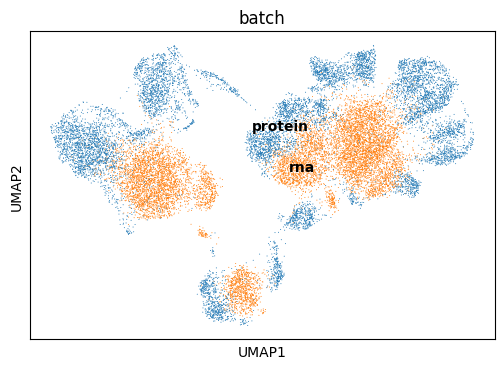

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


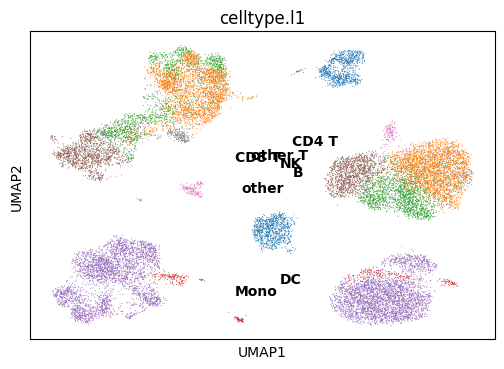

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


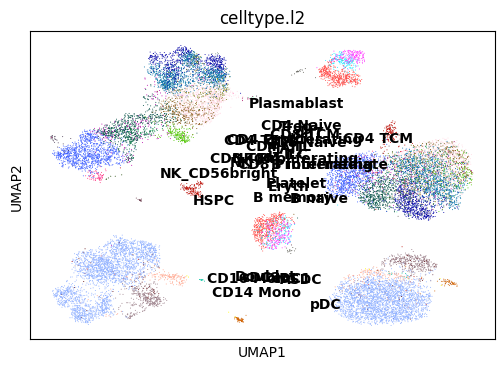

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


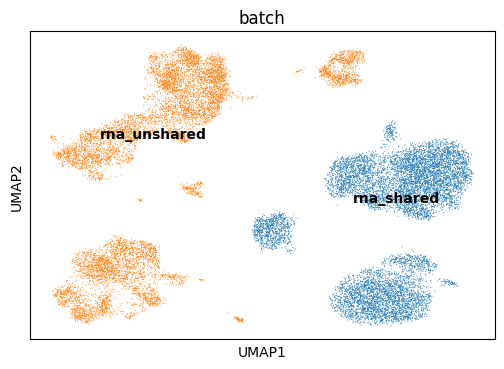

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


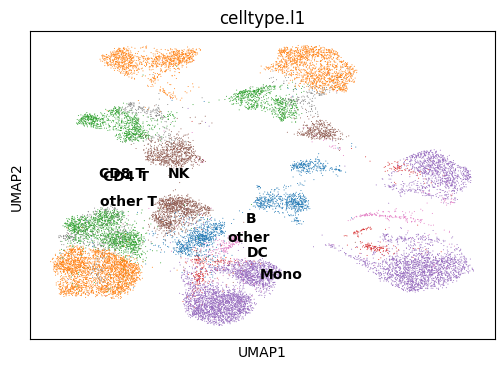

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


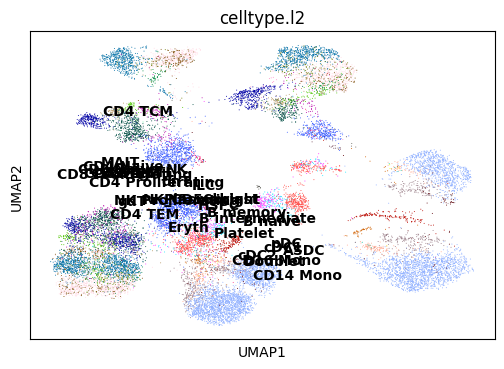

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


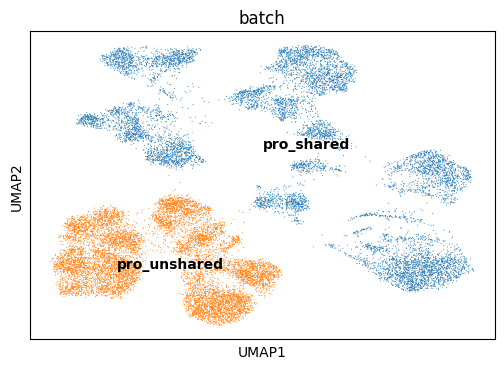

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For All matchings: lv1 matching acc: 0.721,
lv2 matching acc: 0.540.
For All matchings: FOSCTTM score: 0.25094093, 
Knn Alignment score: [0.0015 0.0025 0.0032 0.0043 0.0048 0.006  0.007  0.0086 0.0091 0.0103
 0.0111 0.0116 0.0121 0.0135 0.0146 0.0158 0.0169 0.0176 0.0188 0.0193
 0.0199 0.0206 0.0216 0.0223 0.0231]
For All matchings: Silhouette F1 score for lv1: 0.5034192204845065, 
Silhouette F1 score for lv2: 0.49061668112406187



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  3.4652156829833984
Matchings are reduced to 5000 after filtering...


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:423: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[matchings[0]], labels_l1[matchings[1]])
C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For only filtered matchings: lv1 matching acc: 0.805,
lv2 matching acc: 0.610.



Matches are being propagated....


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:460: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[filtered_matchings[0]], labels_l1[filtered_matchings[1]])


Done!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For all matchings after propagation: lv1 matching acc: 0.760,
lv2 matching acc: 0.547.


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:495: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[propagated_matchings[0]], labels_l1[propagated_matchings[1]])


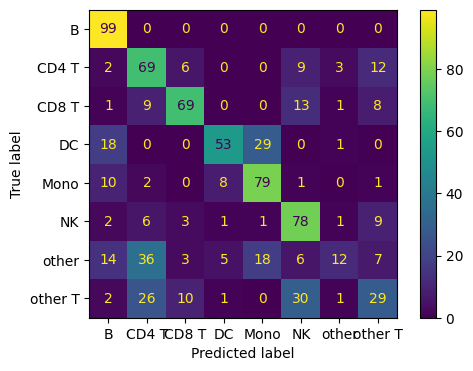

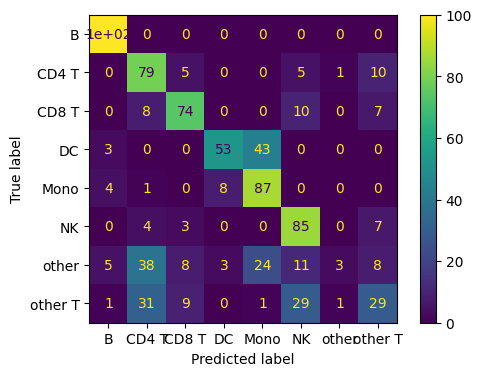

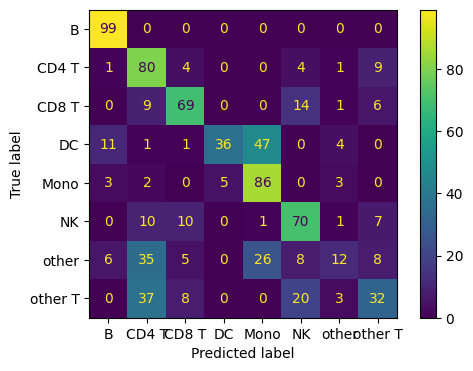

Epoch: 901: 0it [00:00, ?it/s]C:\Users\vinee\AppData\Local\Temp\ipykernel_2144\3129631169.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return {"x_unshared":self.unshared_data[idx], "x_shared":self.shared_data[idx], "l1":self.labels_l1[idx], "l2":self.labels_l2[idx], "mean": self.local_mean[idx], "var": self.local_var[idx], "batch": self.batch[idx]}
Epoch: 901: 40it [00:15,  2.66it/s]


RNA Recon Loss: 2.0056, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4267, Protein Recon Loss: 0.4866, Protein KL Div Back Pro: 0.8322, Protein KL Div Z: 0.6148, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5355, Shared Recon Loss Gene: 0.2587, Shared Recon Loss Protein: 1.7985 Cross Loss Protein: 0.5406


Epoch: 902: 40it [00:15,  2.64it/s]


RNA Recon Loss: 2.0009, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4260, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8305, Protein KL Div Z: 0.6141, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5352, Shared Recon Loss Gene: 0.2578, Shared Recon Loss Protein: 1.7962 Cross Loss Protein: 0.5396


Epoch: 903: 40it [00:12,  3.19it/s]


RNA Recon Loss: 1.9974, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4265, Protein Recon Loss: 0.4872, Protein KL Div Back Pro: 0.8299, Protein KL Div Z: 0.6147, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5357, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7979 Cross Loss Protein: 0.5402


Epoch: 904: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.0014, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4262, Protein Recon Loss: 0.4867, Protein KL Div Back Pro: 0.8293, Protein KL Div Z: 0.6145, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5358, Shared Recon Loss Gene: 0.2578, Shared Recon Loss Protein: 1.7969 Cross Loss Protein: 0.5399


Epoch: 905: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.0010, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4260, Protein Recon Loss: 0.4871, Protein KL Div Back Pro: 0.8269, Protein KL Div Z: 0.6143, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5353, Shared Recon Loss Gene: 0.2582, Shared Recon Loss Protein: 1.7991 Cross Loss Protein: 0.5404


Epoch: 906: 40it [00:12,  3.27it/s]


RNA Recon Loss: 2.0054, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4261, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8304, Protein KL Div Z: 0.6153, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5355, Shared Recon Loss Gene: 0.2586, Shared Recon Loss Protein: 1.7982 Cross Loss Protein: 0.5395


Epoch: 907: 40it [00:12,  3.23it/s]


RNA Recon Loss: 2.0084, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4263, Protein Recon Loss: 0.4868, Protein KL Div Back Pro: 0.8265, Protein KL Div Z: 0.6144, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5358, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.7967 Cross Loss Protein: 0.5404


Epoch: 908: 40it [00:12,  3.27it/s]


RNA Recon Loss: 2.0145, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4261, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8328, Protein KL Div Z: 0.6147, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5357, Shared Recon Loss Gene: 0.2589, Shared Recon Loss Protein: 1.7987 Cross Loss Protein: 0.5399


Epoch: 909: 40it [00:12,  3.28it/s]


RNA Recon Loss: 2.0008, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4255, Protein Recon Loss: 0.4871, Protein KL Div Back Pro: 0.8309, Protein KL Div Z: 0.6154, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5358, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.8004 Cross Loss Protein: 0.5409


Epoch: 910: 40it [00:12,  3.23it/s]


RNA Recon Loss: 1.9990, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4259, Protein Recon Loss: 0.4868, Protein KL Div Back Pro: 0.8300, Protein KL Div Z: 0.6144, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5356, Shared Recon Loss Gene: 0.2579, Shared Recon Loss Protein: 1.7980 Cross Loss Protein: 0.5401


Epoch: 911: 40it [00:12,  3.29it/s]


RNA Recon Loss: 2.0038, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4256, Protein Recon Loss: 0.4866, Protein KL Div Back Pro: 0.8296, Protein KL Div Z: 0.6148, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5350, Shared Recon Loss Gene: 0.2581, Shared Recon Loss Protein: 1.7961 Cross Loss Protein: 0.5401


Epoch: 912: 40it [00:12,  3.30it/s]


RNA Recon Loss: 1.9994, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4259, Protein Recon Loss: 0.4869, Protein KL Div Back Pro: 0.8308, Protein KL Div Z: 0.6168, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5358, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7981 Cross Loss Protein: 0.5405


Epoch: 913: 40it [00:12,  3.29it/s]


RNA Recon Loss: 1.9970, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4255, Protein Recon Loss: 0.4866, Protein KL Div Back Pro: 0.8304, Protein KL Div Z: 0.6166, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5350, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7988 Cross Loss Protein: 0.5406


Epoch: 914: 40it [00:12,  3.24it/s]


RNA Recon Loss: 1.9990, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4249, Protein Recon Loss: 0.4863, Protein KL Div Back Pro: 0.8301, Protein KL Div Z: 0.6155, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5356, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7983 Cross Loss Protein: 0.5405


Epoch: 915: 40it [00:12,  3.26it/s]


RNA Recon Loss: 2.0005, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4258, Protein Recon Loss: 0.4865, Protein KL Div Back Pro: 0.8305, Protein KL Div Z: 0.6159, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5355, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.8001 Cross Loss Protein: 0.5403


Epoch: 916: 40it [00:12,  3.11it/s]


RNA Recon Loss: 1.9962, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4260, Protein Recon Loss: 0.4880, Protein KL Div Back Pro: 0.8300, Protein KL Div Z: 0.6155, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5349, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.8020 Cross Loss Protein: 0.5416


Epoch: 917: 40it [00:13,  3.08it/s]


RNA Recon Loss: 2.0065, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4258, Protein Recon Loss: 0.4865, Protein KL Div Back Pro: 0.8309, Protein KL Div Z: 0.6158, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5350, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7981 Cross Loss Protein: 0.5403


Epoch: 918: 40it [00:14,  2.83it/s]


RNA Recon Loss: 2.0031, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4262, Protein Recon Loss: 0.4876, Protein KL Div Back Pro: 0.8324, Protein KL Div Z: 0.6162, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5343, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.8006 Cross Loss Protein: 0.5428


Epoch: 919: 40it [00:13,  2.91it/s]


RNA Recon Loss: 2.0013, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4255, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8310, Protein KL Div Z: 0.6160, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5356, Shared Recon Loss Gene: 0.2579, Shared Recon Loss Protein: 1.7986 Cross Loss Protein: 0.5405


Epoch: 920: 40it [00:12,  3.13it/s]


RNA Recon Loss: 1.9945, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4256, Protein Recon Loss: 0.4867, Protein KL Div Back Pro: 0.8303, Protein KL Div Z: 0.6158, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5349, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7972 Cross Loss Protein: 0.5403


Epoch: 921: 40it [00:14,  2.78it/s]


RNA Recon Loss: 2.0085, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4256, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8287, Protein KL Div Z: 0.6168, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5345, Shared Recon Loss Gene: 0.2580, Shared Recon Loss Protein: 1.7971 Cross Loss Protein: 0.5400


Epoch: 922: 40it [00:13,  3.05it/s]


RNA Recon Loss: 1.9961, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4257, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8306, Protein KL Div Z: 0.6163, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5352, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7960 Cross Loss Protein: 0.5400


Epoch: 923: 40it [00:13,  3.06it/s]


RNA Recon Loss: 1.9973, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4251, Protein Recon Loss: 0.4869, Protein KL Div Back Pro: 0.8308, Protein KL Div Z: 0.6181, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5352, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7996 Cross Loss Protein: 0.5405


Epoch: 924: 40it [00:13,  2.93it/s]


RNA Recon Loss: 2.0003, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4259, Protein Recon Loss: 0.4871, Protein KL Div Back Pro: 0.8285, Protein KL Div Z: 0.6151, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5351, Shared Recon Loss Gene: 0.2580, Shared Recon Loss Protein: 1.7981 Cross Loss Protein: 0.5401


Epoch: 925: 40it [00:15,  2.58it/s]


RNA Recon Loss: 1.9940, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4255, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8287, Protein KL Div Z: 0.6158, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5358, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7974 Cross Loss Protein: 0.5406


Epoch: 926: 40it [00:16,  2.43it/s]


RNA Recon Loss: 1.9967, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4258, Protein Recon Loss: 0.4878, Protein KL Div Back Pro: 0.8305, Protein KL Div Z: 0.6166, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5352, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.8028 Cross Loss Protein: 0.5411


Epoch: 927: 40it [00:17,  2.24it/s]


RNA Recon Loss: 2.0005, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4252, Protein Recon Loss: 0.4867, Protein KL Div Back Pro: 0.8328, Protein KL Div Z: 0.6162, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5361, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.8006 Cross Loss Protein: 0.5411


Epoch: 928: 40it [00:17,  2.26it/s]


RNA Recon Loss: 2.0000, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4258, Protein Recon Loss: 0.4872, Protein KL Div Back Pro: 0.8302, Protein KL Div Z: 0.6169, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5354, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.8002 Cross Loss Protein: 0.5407


Epoch: 929: 40it [00:17,  2.24it/s]


RNA Recon Loss: 1.9998, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4252, Protein Recon Loss: 0.4869, Protein KL Div Back Pro: 0.8304, Protein KL Div Z: 0.6159, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5343, Shared Recon Loss Gene: 0.2579, Shared Recon Loss Protein: 1.7992 Cross Loss Protein: 0.5407


Epoch: 930: 40it [00:15,  2.56it/s]


RNA Recon Loss: 1.9956, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4251, Protein Recon Loss: 0.4866, Protein KL Div Back Pro: 0.8275, Protein KL Div Z: 0.6151, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5356, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7989 Cross Loss Protein: 0.5407


Epoch: 931: 40it [00:16,  2.40it/s]


RNA Recon Loss: 1.9953, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4253, Protein Recon Loss: 0.4868, Protein KL Div Back Pro: 0.8310, Protein KL Div Z: 0.6176, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5349, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7984 Cross Loss Protein: 0.5407


Epoch: 932: 40it [00:13,  3.01it/s]


RNA Recon Loss: 2.0022, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4256, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8306, Protein KL Div Z: 0.6168, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5349, Shared Recon Loss Gene: 0.2581, Shared Recon Loss Protein: 1.7966 Cross Loss Protein: 0.5394


Epoch: 933: 40it [00:13,  2.89it/s]


RNA Recon Loss: 2.0042, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4252, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8276, Protein KL Div Z: 0.6156, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5352, Shared Recon Loss Gene: 0.2581, Shared Recon Loss Protein: 1.7978 Cross Loss Protein: 0.5399


Epoch: 934: 40it [00:12,  3.12it/s]


RNA Recon Loss: 2.0056, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4259, Protein Recon Loss: 0.4874, Protein KL Div Back Pro: 0.8302, Protein KL Div Z: 0.6175, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5351, Shared Recon Loss Gene: 0.2588, Shared Recon Loss Protein: 1.7987 Cross Loss Protein: 0.5410


Epoch: 935: 40it [00:13,  3.07it/s]


RNA Recon Loss: 2.0044, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4254, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8286, Protein KL Div Z: 0.6164, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5349, Shared Recon Loss Gene: 0.2588, Shared Recon Loss Protein: 1.7971 Cross Loss Protein: 0.5403


Epoch: 936: 40it [00:13,  3.03it/s]


RNA Recon Loss: 2.0006, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4253, Protein Recon Loss: 0.4867, Protein KL Div Back Pro: 0.8305, Protein KL Div Z: 0.6180, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5352, Shared Recon Loss Gene: 0.2581, Shared Recon Loss Protein: 1.7970 Cross Loss Protein: 0.5407


Epoch: 937: 40it [00:14,  2.67it/s]


RNA Recon Loss: 2.0040, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4254, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8296, Protein KL Div Z: 0.6178, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5348, Shared Recon Loss Gene: 0.2581, Shared Recon Loss Protein: 1.7977 Cross Loss Protein: 0.5403


Epoch: 938: 40it [00:15,  2.59it/s]


RNA Recon Loss: 2.0003, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4251, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8313, Protein KL Div Z: 0.6169, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5344, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7960 Cross Loss Protein: 0.5396


Epoch: 939: 40it [00:16,  2.49it/s]


RNA Recon Loss: 1.9975, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4246, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8298, Protein KL Div Z: 0.6175, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5347, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7976 Cross Loss Protein: 0.5404


Epoch: 940: 40it [00:15,  2.62it/s]


RNA Recon Loss: 2.0015, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4246, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8287, Protein KL Div Z: 0.6171, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5341, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7961 Cross Loss Protein: 0.5400


Epoch: 941: 40it [00:14,  2.81it/s]


RNA Recon Loss: 1.9982, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4253, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8304, Protein KL Div Z: 0.6166, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5349, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7966 Cross Loss Protein: 0.5402


Epoch: 942: 40it [00:16,  2.46it/s]


RNA Recon Loss: 2.0011, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4258, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8288, Protein KL Div Z: 0.6164, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5349, Shared Recon Loss Gene: 0.2582, Shared Recon Loss Protein: 1.7977 Cross Loss Protein: 0.5396


Epoch: 943: 40it [00:15,  2.52it/s]


RNA Recon Loss: 2.0013, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4253, Protein Recon Loss: 0.4869, Protein KL Div Back Pro: 0.8309, Protein KL Div Z: 0.6179, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5345, Shared Recon Loss Gene: 0.2581, Shared Recon Loss Protein: 1.7977 Cross Loss Protein: 0.5403


Epoch: 944: 40it [00:14,  2.68it/s]


RNA Recon Loss: 2.0092, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4252, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8314, Protein KL Div Z: 0.6170, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5350, Shared Recon Loss Gene: 0.2585, Shared Recon Loss Protein: 1.7991 Cross Loss Protein: 0.5401


Epoch: 945: 40it [00:15,  2.64it/s]


RNA Recon Loss: 1.9985, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4252, Protein Recon Loss: 0.4881, Protein KL Div Back Pro: 0.8344, Protein KL Div Z: 0.6184, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5341, Shared Recon Loss Gene: 0.2577, Shared Recon Loss Protein: 1.8022 Cross Loss Protein: 0.5416


Epoch: 946: 40it [00:16,  2.46it/s]


RNA Recon Loss: 2.0013, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4260, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8322, Protein KL Div Z: 0.6174, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5354, Shared Recon Loss Gene: 0.2581, Shared Recon Loss Protein: 1.7952 Cross Loss Protein: 0.5400


Epoch: 947: 40it [00:16,  2.49it/s]


RNA Recon Loss: 1.9989, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4257, Protein Recon Loss: 0.4878, Protein KL Div Back Pro: 0.8278, Protein KL Div Z: 0.6158, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5347, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.7969 Cross Loss Protein: 0.5408


Epoch: 948: 40it [00:17,  2.30it/s]


RNA Recon Loss: 1.9991, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4253, Protein Recon Loss: 0.4865, Protein KL Div Back Pro: 0.8361, Protein KL Div Z: 0.6182, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5343, Shared Recon Loss Gene: 0.2580, Shared Recon Loss Protein: 1.7963 Cross Loss Protein: 0.5400


Epoch: 949: 40it [00:23,  1.71it/s]


RNA Recon Loss: 2.0072, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4251, Protein Recon Loss: 0.4872, Protein KL Div Back Pro: 0.8307, Protein KL Div Z: 0.6162, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5342, Shared Recon Loss Gene: 0.2587, Shared Recon Loss Protein: 1.7942 Cross Loss Protein: 0.5395


Epoch: 950: 40it [00:16,  2.37it/s]


RNA Recon Loss: 1.9985, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4249, Protein Recon Loss: 0.4876, Protein KL Div Back Pro: 0.8305, Protein KL Div Z: 0.6172, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5349, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.8009 Cross Loss Protein: 0.5409


Epoch: 951: 40it [00:16,  2.48it/s]


RNA Recon Loss: 1.9948, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4251, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8330, Protein KL Div Z: 0.6175, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5346, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7978 Cross Loss Protein: 0.5406


Epoch: 952: 40it [00:16,  2.41it/s]


RNA Recon Loss: 1.9949, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4244, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8315, Protein KL Div Z: 0.6197, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5339, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7970 Cross Loss Protein: 0.5398


Epoch: 953: 40it [00:15,  2.62it/s]


RNA Recon Loss: 2.0071, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4249, Protein Recon Loss: 0.4872, Protein KL Div Back Pro: 0.8303, Protein KL Div Z: 0.6166, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5347, Shared Recon Loss Gene: 0.2586, Shared Recon Loss Protein: 1.7947 Cross Loss Protein: 0.5407


Epoch: 954: 40it [00:15,  2.64it/s]


RNA Recon Loss: 2.0037, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4255, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8295, Protein KL Div Z: 0.6166, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5343, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7968 Cross Loss Protein: 0.5399


Epoch: 955: 40it [00:15,  2.66it/s]


RNA Recon Loss: 1.9980, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4252, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8298, Protein KL Div Z: 0.6163, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5345, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7993 Cross Loss Protein: 0.5402


Epoch: 956: 40it [00:14,  2.68it/s]


RNA Recon Loss: 2.0017, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4255, Protein Recon Loss: 0.4863, Protein KL Div Back Pro: 0.8288, Protein KL Div Z: 0.6174, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5351, Shared Recon Loss Gene: 0.2583, Shared Recon Loss Protein: 1.7976 Cross Loss Protein: 0.5400


Epoch: 957: 40it [00:15,  2.62it/s]


RNA Recon Loss: 2.0014, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4250, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8300, Protein KL Div Z: 0.6173, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5344, Shared Recon Loss Gene: 0.2580, Shared Recon Loss Protein: 1.7975 Cross Loss Protein: 0.5400


Epoch: 958: 40it [00:15,  2.58it/s]


RNA Recon Loss: 1.9965, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4248, Protein Recon Loss: 0.4878, Protein KL Div Back Pro: 0.8269, Protein KL Div Z: 0.6157, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5334, Shared Recon Loss Gene: 0.2577, Shared Recon Loss Protein: 1.8027 Cross Loss Protein: 0.5407


Epoch: 959: 40it [00:15,  2.66it/s]


RNA Recon Loss: 2.0034, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4242, Protein Recon Loss: 0.4874, Protein KL Div Back Pro: 0.8325, Protein KL Div Z: 0.6182, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5341, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7958 Cross Loss Protein: 0.5402


Epoch: 960: 40it [00:14,  2.71it/s]


RNA Recon Loss: 2.0051, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4254, Protein Recon Loss: 0.4865, Protein KL Div Back Pro: 0.8304, Protein KL Div Z: 0.6181, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5342, Shared Recon Loss Gene: 0.2583, Shared Recon Loss Protein: 1.7973 Cross Loss Protein: 0.5402


Epoch: 961: 40it [00:14,  2.74it/s]


RNA Recon Loss: 2.0075, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4252, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8315, Protein KL Div Z: 0.6180, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5345, Shared Recon Loss Gene: 0.2586, Shared Recon Loss Protein: 1.7974 Cross Loss Protein: 0.5398


Epoch: 962: 40it [00:15,  2.66it/s]


RNA Recon Loss: 2.0035, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4246, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8293, Protein KL Div Z: 0.6176, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5343, Shared Recon Loss Gene: 0.2579, Shared Recon Loss Protein: 1.7959 Cross Loss Protein: 0.5399


Epoch: 963: 40it [00:15,  2.66it/s]


RNA Recon Loss: 1.9973, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4245, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8297, Protein KL Div Z: 0.6181, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5338, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7979 Cross Loss Protein: 0.5403


Epoch: 964: 40it [00:15,  2.63it/s]


RNA Recon Loss: 1.9972, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4240, Protein Recon Loss: 0.4865, Protein KL Div Back Pro: 0.8295, Protein KL Div Z: 0.6162, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5351, Shared Recon Loss Gene: 0.2579, Shared Recon Loss Protein: 1.7996 Cross Loss Protein: 0.5403


Epoch: 965: 40it [00:14,  2.72it/s]


RNA Recon Loss: 1.9959, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4250, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8312, Protein KL Div Z: 0.6195, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5349, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7982 Cross Loss Protein: 0.5401


Epoch: 966: 40it [00:15,  2.64it/s]


RNA Recon Loss: 1.9968, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4246, Protein Recon Loss: 0.4867, Protein KL Div Back Pro: 0.8296, Protein KL Div Z: 0.6186, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5340, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7982 Cross Loss Protein: 0.5407


Epoch: 967: 40it [00:15,  2.61it/s]


RNA Recon Loss: 2.0029, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4246, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8316, Protein KL Div Z: 0.6188, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5342, Shared Recon Loss Gene: 0.2580, Shared Recon Loss Protein: 1.7960 Cross Loss Protein: 0.5406


Epoch: 968: 40it [00:14,  2.70it/s]


RNA Recon Loss: 2.0052, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4248, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8294, Protein KL Div Z: 0.6180, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5341, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.7971 Cross Loss Protein: 0.5401


Epoch: 969: 40it [00:13,  2.99it/s]


RNA Recon Loss: 2.0038, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4255, Protein Recon Loss: 0.4868, Protein KL Div Back Pro: 0.8314, Protein KL Div Z: 0.6199, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5345, Shared Recon Loss Gene: 0.2579, Shared Recon Loss Protein: 1.7998 Cross Loss Protein: 0.5407


Epoch: 970: 40it [00:13,  2.95it/s]


RNA Recon Loss: 2.0019, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4257, Protein Recon Loss: 0.4865, Protein KL Div Back Pro: 0.8316, Protein KL Div Z: 0.6179, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5338, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.8002 Cross Loss Protein: 0.5406


Epoch: 971: 40it [00:14,  2.83it/s]


RNA Recon Loss: 1.9974, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4244, Protein Recon Loss: 0.4878, Protein KL Div Back Pro: 0.8329, Protein KL Div Z: 0.6196, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5353, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.8027 Cross Loss Protein: 0.5418


Epoch: 972: 40it [00:15,  2.63it/s]


RNA Recon Loss: 2.0007, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4244, Protein Recon Loss: 0.4869, Protein KL Div Back Pro: 0.8327, Protein KL Div Z: 0.6188, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5345, Shared Recon Loss Gene: 0.2577, Shared Recon Loss Protein: 1.7960 Cross Loss Protein: 0.5400


Epoch: 973: 40it [00:14,  2.78it/s]


RNA Recon Loss: 1.9969, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4249, Protein Recon Loss: 0.4878, Protein KL Div Back Pro: 0.8282, Protein KL Div Z: 0.6178, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5343, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7973 Cross Loss Protein: 0.5416


Epoch: 974: 40it [00:13,  2.92it/s]


RNA Recon Loss: 2.0015, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4252, Protein Recon Loss: 0.4871, Protein KL Div Back Pro: 0.8335, Protein KL Div Z: 0.6185, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5347, Shared Recon Loss Gene: 0.2579, Shared Recon Loss Protein: 1.7979 Cross Loss Protein: 0.5401


Epoch: 975: 40it [00:13,  2.96it/s]


RNA Recon Loss: 2.0007, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4252, Protein Recon Loss: 0.4873, Protein KL Div Back Pro: 0.8296, Protein KL Div Z: 0.6179, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5354, Shared Recon Loss Gene: 0.2578, Shared Recon Loss Protein: 1.7993 Cross Loss Protein: 0.5408


Epoch: 976: 40it [00:13,  2.86it/s]


RNA Recon Loss: 2.0001, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4246, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8306, Protein KL Div Z: 0.6177, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5342, Shared Recon Loss Gene: 0.2579, Shared Recon Loss Protein: 1.7967 Cross Loss Protein: 0.5403


Epoch: 977: 40it [00:14,  2.73it/s]


RNA Recon Loss: 1.9979, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4244, Protein Recon Loss: 0.4878, Protein KL Div Back Pro: 0.8294, Protein KL Div Z: 0.6171, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5344, Shared Recon Loss Gene: 0.2579, Shared Recon Loss Protein: 1.8001 Cross Loss Protein: 0.5412


Epoch: 978: 40it [00:12,  3.11it/s]


RNA Recon Loss: 1.9952, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4242, Protein Recon Loss: 0.4879, Protein KL Div Back Pro: 0.8323, Protein KL Div Z: 0.6188, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5344, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7992 Cross Loss Protein: 0.5420


Epoch: 979: 40it [00:13,  3.04it/s]


RNA Recon Loss: 1.9989, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4250, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8305, Protein KL Div Z: 0.6164, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5344, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7970 Cross Loss Protein: 0.5398


Epoch: 980: 40it [00:13,  2.87it/s]


RNA Recon Loss: 1.9995, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4250, Protein Recon Loss: 0.4867, Protein KL Div Back Pro: 0.8305, Protein KL Div Z: 0.6181, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5340, Shared Recon Loss Gene: 0.2577, Shared Recon Loss Protein: 1.7978 Cross Loss Protein: 0.5407


Epoch: 981: 40it [00:13,  3.04it/s]


RNA Recon Loss: 2.0009, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4246, Protein Recon Loss: 0.4865, Protein KL Div Back Pro: 0.8303, Protein KL Div Z: 0.6182, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5343, Shared Recon Loss Gene: 0.2580, Shared Recon Loss Protein: 1.7977 Cross Loss Protein: 0.5402


Epoch: 982: 40it [00:12,  3.15it/s]


RNA Recon Loss: 1.9986, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4247, Protein Recon Loss: 0.4867, Protein KL Div Back Pro: 0.8299, Protein KL Div Z: 0.6179, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5339, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7990 Cross Loss Protein: 0.5402


Epoch: 983: 40it [00:12,  3.09it/s]


RNA Recon Loss: 2.0177, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4247, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8302, Protein KL Div Z: 0.6175, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5344, Shared Recon Loss Gene: 0.2593, Shared Recon Loss Protein: 1.7974 Cross Loss Protein: 0.5397


Epoch: 984: 40it [00:14,  2.86it/s]


RNA Recon Loss: 2.0100, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4246, Protein Recon Loss: 0.4868, Protein KL Div Back Pro: 0.8290, Protein KL Div Z: 0.6176, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5341, Shared Recon Loss Gene: 0.2578, Shared Recon Loss Protein: 1.7980 Cross Loss Protein: 0.5412


Epoch: 985: 40it [00:14,  2.79it/s]


RNA Recon Loss: 2.0055, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4253, Protein Recon Loss: 0.4870, Protein KL Div Back Pro: 0.8317, Protein KL Div Z: 0.6184, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5346, Shared Recon Loss Gene: 0.2579, Shared Recon Loss Protein: 1.7993 Cross Loss Protein: 0.5407


Epoch: 986: 40it [00:14,  2.85it/s]


RNA Recon Loss: 2.0000, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4241, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8279, Protein KL Div Z: 0.6169, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5346, Shared Recon Loss Gene: 0.2580, Shared Recon Loss Protein: 1.7961 Cross Loss Protein: 0.5398


Epoch: 987: 40it [00:15,  2.54it/s]


RNA Recon Loss: 1.9989, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4238, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8295, Protein KL Div Z: 0.6182, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5340, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7964 Cross Loss Protein: 0.5400


Epoch: 988: 40it [00:13,  2.99it/s]


RNA Recon Loss: 2.0038, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4245, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8305, Protein KL Div Z: 0.6181, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5338, Shared Recon Loss Gene: 0.2583, Shared Recon Loss Protein: 1.7983 Cross Loss Protein: 0.5403


Epoch: 989: 40it [00:14,  2.77it/s]


RNA Recon Loss: 2.0083, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4248, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8301, Protein KL Div Z: 0.6184, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5341, Shared Recon Loss Gene: 0.2583, Shared Recon Loss Protein: 1.7954 Cross Loss Protein: 0.5399


Epoch: 990: 40it [00:13,  2.90it/s]


RNA Recon Loss: 2.0015, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4251, Protein Recon Loss: 0.4863, Protein KL Div Back Pro: 0.8288, Protein KL Div Z: 0.6172, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5332, Shared Recon Loss Gene: 0.2588, Shared Recon Loss Protein: 1.7982 Cross Loss Protein: 0.5404


Epoch: 991: 40it [00:15,  2.56it/s]


RNA Recon Loss: 2.0077, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4254, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8313, Protein KL Div Z: 0.6176, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5339, Shared Recon Loss Gene: 0.2585, Shared Recon Loss Protein: 1.7976 Cross Loss Protein: 0.5404


Epoch: 992: 40it [00:14,  2.83it/s]


RNA Recon Loss: 1.9982, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4250, Protein Recon Loss: 0.4866, Protein KL Div Back Pro: 0.8327, Protein KL Div Z: 0.6193, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5338, Shared Recon Loss Gene: 0.2577, Shared Recon Loss Protein: 1.7992 Cross Loss Protein: 0.5404


Epoch: 993: 40it [00:13,  2.97it/s]


RNA Recon Loss: 2.0003, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4243, Protein Recon Loss: 0.4863, Protein KL Div Back Pro: 0.8300, Protein KL Div Z: 0.6176, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5331, Shared Recon Loss Gene: 0.2577, Shared Recon Loss Protein: 1.7971 Cross Loss Protein: 0.5400


Epoch: 994: 40it [00:13,  2.88it/s]


RNA Recon Loss: 2.0010, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4245, Protein Recon Loss: 0.4869, Protein KL Div Back Pro: 0.8290, Protein KL Div Z: 0.6189, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5343, Shared Recon Loss Gene: 0.2581, Shared Recon Loss Protein: 1.7979 Cross Loss Protein: 0.5406


Epoch: 995: 40it [00:12,  3.14it/s]


RNA Recon Loss: 1.9996, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4250, Protein Recon Loss: 0.4870, Protein KL Div Back Pro: 0.8298, Protein KL Div Z: 0.6178, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5336, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7995 Cross Loss Protein: 0.5408


Epoch: 996: 40it [00:13,  2.98it/s]


RNA Recon Loss: 1.9982, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4244, Protein Recon Loss: 0.4874, Protein KL Div Back Pro: 0.8314, Protein KL Div Z: 0.6181, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5338, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.8007 Cross Loss Protein: 0.5410


Epoch: 997: 40it [00:12,  3.11it/s]


RNA Recon Loss: 1.9971, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4244, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8294, Protein KL Div Z: 0.6179, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5340, Shared Recon Loss Gene: 0.2581, Shared Recon Loss Protein: 1.7978 Cross Loss Protein: 0.5401


Epoch: 998: 40it [00:12,  3.15it/s]


RNA Recon Loss: 1.9961, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4243, Protein Recon Loss: 0.4866, Protein KL Div Back Pro: 0.8305, Protein KL Div Z: 0.6191, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5329, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7974 Cross Loss Protein: 0.5402


Epoch: 999: 40it [00:12,  3.08it/s]


RNA Recon Loss: 2.0024, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4239, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8288, Protein KL Div Z: 0.6186, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5334, Shared Recon Loss Gene: 0.2581, Shared Recon Loss Protein: 1.7962 Cross Loss Protein: 0.5396


Epoch: 1000: 40it [00:12,  3.11it/s]


RNA Recon Loss: 2.0020, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4252, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8268, Protein KL Div Z: 0.6185, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5332, Shared Recon Loss Gene: 0.2585, Shared Recon Loss Protein: 1.7980 Cross Loss Protein: 0.5400


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


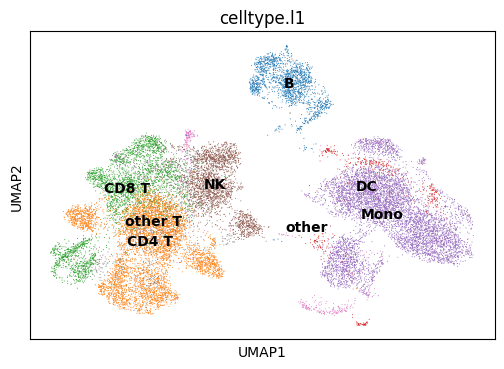

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


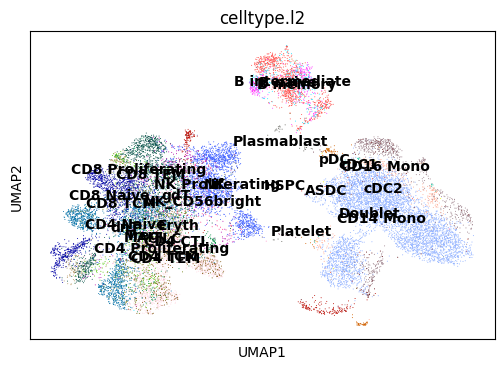

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


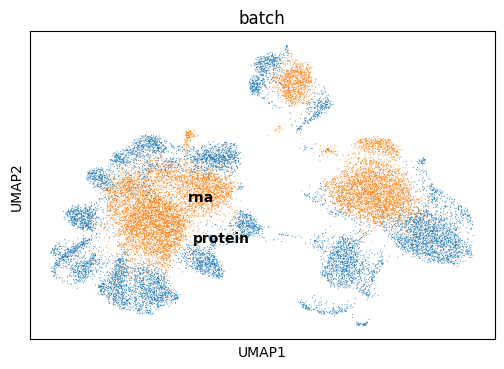

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


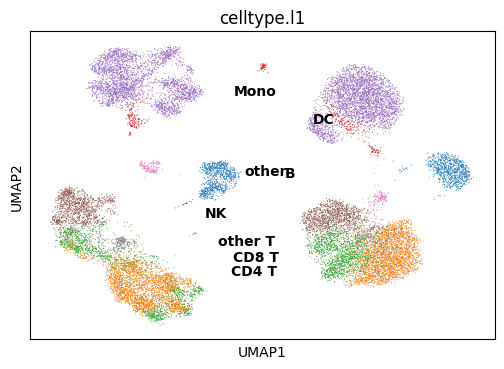

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


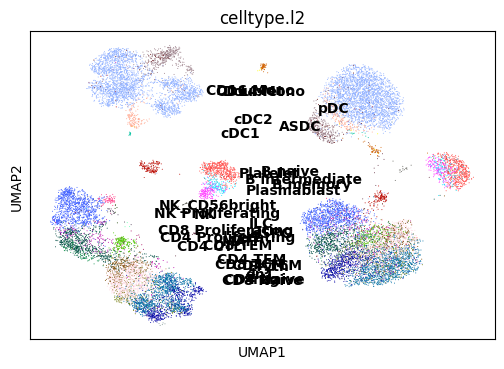

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


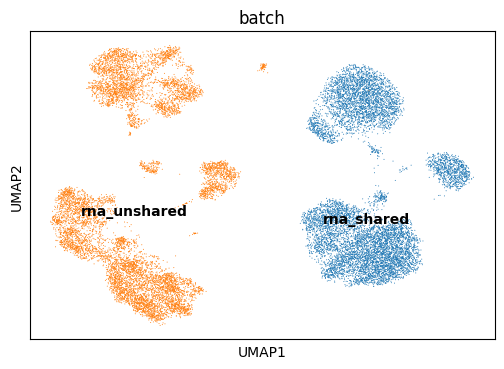

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


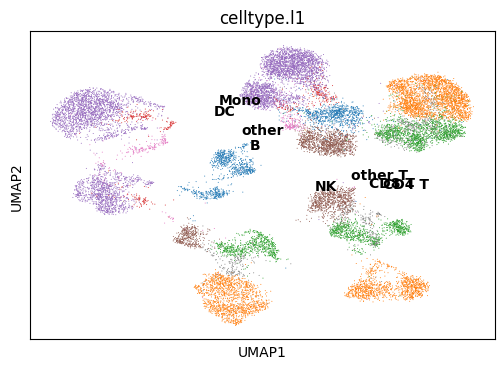

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


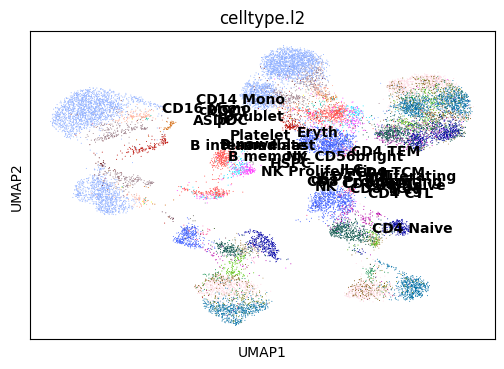

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


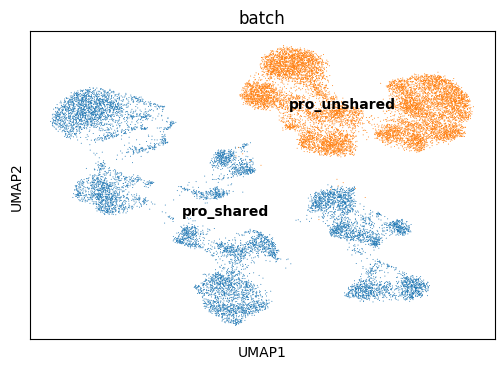

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For All matchings: lv1 matching acc: 0.723,
lv2 matching acc: 0.541.
For All matchings: FOSCTTM score: 0.24328500999999997, 
Knn Alignment score: [0.0012 0.0024 0.0032 0.0038 0.0048 0.0057 0.0072 0.0084 0.0093 0.0102
 0.0105 0.0112 0.0118 0.0127 0.0135 0.0145 0.0156 0.0163 0.0172 0.018
 0.0193 0.0203 0.0211 0.0221 0.0229]
For All matchings: Silhouette F1 score for lv1: 0.5060223591808962, 
Silhouette F1 score for lv2: 0.49291674294639637



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  3.4585793018341064
Matchings are reduced to 5000 after filtering...


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:423: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[matchings[0]], labels_l1[matchings[1]])
C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For only filtered matchings: lv1 matching acc: 0.816,
lv2 matching acc: 0.634.


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:460: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[filtered_matchings[0]], labels_l1[filtered_matchings[1]])





Matches are being propagated....
Done!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For all matchings after propagation: lv1 matching acc: 0.770,
lv2 matching acc: 0.559.


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:495: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[propagated_matchings[0]], labels_l1[propagated_matchings[1]])


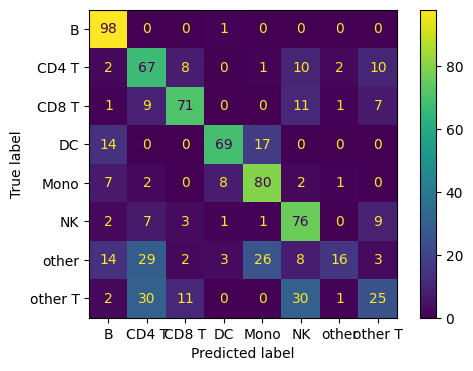

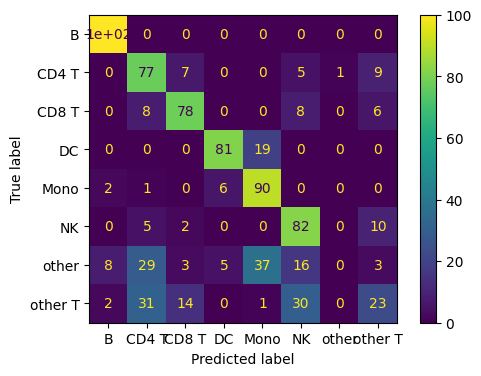

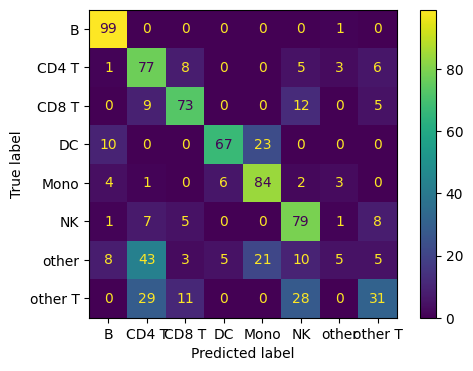

Epoch: 1001: 0it [00:00, ?it/s]C:\Users\vinee\AppData\Local\Temp\ipykernel_2144\3129631169.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return {"x_unshared":self.unshared_data[idx], "x_shared":self.shared_data[idx], "l1":self.labels_l1[idx], "l2":self.labels_l2[idx], "mean": self.local_mean[idx], "var": self.local_var[idx], "batch": self.batch[idx]}
Epoch: 1001: 40it [00:12,  3.18it/s]


RNA Recon Loss: 1.9972, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4248, Protein Recon Loss: 0.4866, Protein KL Div Back Pro: 0.8263, Protein KL Div Z: 0.6179, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5333, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7983 Cross Loss Protein: 0.5411


Epoch: 1002: 40it [00:13,  2.95it/s]


RNA Recon Loss: 1.9973, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4238, Protein Recon Loss: 0.4873, Protein KL Div Back Pro: 0.8294, Protein KL Div Z: 0.6180, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5340, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7992 Cross Loss Protein: 0.5419


Epoch: 1003: 40it [00:15,  2.61it/s]


RNA Recon Loss: 2.0048, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4242, Protein Recon Loss: 0.4867, Protein KL Div Back Pro: 0.8295, Protein KL Div Z: 0.6175, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5332, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.7978 Cross Loss Protein: 0.5409


Epoch: 1004: 40it [00:13,  2.92it/s]


RNA Recon Loss: 2.0041, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4251, Protein Recon Loss: 0.4869, Protein KL Div Back Pro: 0.8326, Protein KL Div Z: 0.6200, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5332, Shared Recon Loss Gene: 0.2582, Shared Recon Loss Protein: 1.7990 Cross Loss Protein: 0.5409


Epoch: 1005: 40it [00:13,  2.99it/s]


RNA Recon Loss: 1.9955, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4246, Protein Recon Loss: 0.4867, Protein KL Div Back Pro: 0.8335, Protein KL Div Z: 0.6190, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5334, Shared Recon Loss Gene: 0.2578, Shared Recon Loss Protein: 1.7957 Cross Loss Protein: 0.5396


Epoch: 1006: 40it [00:15,  2.61it/s]


RNA Recon Loss: 1.9945, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4244, Protein Recon Loss: 0.4866, Protein KL Div Back Pro: 0.8309, Protein KL Div Z: 0.6186, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5332, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7964 Cross Loss Protein: 0.5400


Epoch: 1007: 40it [00:15,  2.60it/s]


RNA Recon Loss: 2.0055, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4246, Protein Recon Loss: 0.4874, Protein KL Div Back Pro: 0.8304, Protein KL Div Z: 0.6188, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5342, Shared Recon Loss Gene: 0.2585, Shared Recon Loss Protein: 1.7983 Cross Loss Protein: 0.5415


Epoch: 1008: 40it [00:15,  2.63it/s]


RNA Recon Loss: 2.0064, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4248, Protein Recon Loss: 0.4875, Protein KL Div Back Pro: 0.8298, Protein KL Div Z: 0.6182, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5335, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.8012 Cross Loss Protein: 0.5409


Epoch: 1009: 40it [00:14,  2.78it/s]


RNA Recon Loss: 1.9960, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4246, Protein Recon Loss: 0.4868, Protein KL Div Back Pro: 0.8334, Protein KL Div Z: 0.6193, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5336, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7986 Cross Loss Protein: 0.5407


Epoch: 1010: 40it [00:15,  2.55it/s]


RNA Recon Loss: 1.9998, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4242, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8316, Protein KL Div Z: 0.6173, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5342, Shared Recon Loss Gene: 0.2581, Shared Recon Loss Protein: 1.7979 Cross Loss Protein: 0.5401


Epoch: 1011: 40it [00:15,  2.53it/s]


RNA Recon Loss: 1.9975, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4241, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8307, Protein KL Div Z: 0.6204, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5342, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7971 Cross Loss Protein: 0.5399


Epoch: 1012: 40it [00:16,  2.47it/s]


RNA Recon Loss: 1.9971, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4245, Protein Recon Loss: 0.4879, Protein KL Div Back Pro: 0.8307, Protein KL Div Z: 0.6198, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5342, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7999 Cross Loss Protein: 0.5408


Epoch: 1013: 40it [00:15,  2.62it/s]


RNA Recon Loss: 1.9945, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4243, Protein Recon Loss: 0.4869, Protein KL Div Back Pro: 0.8327, Protein KL Div Z: 0.6184, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5333, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7975 Cross Loss Protein: 0.5405


Epoch: 1014: 40it [00:16,  2.38it/s]


RNA Recon Loss: 2.0054, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4244, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8306, Protein KL Div Z: 0.6187, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5336, Shared Recon Loss Gene: 0.2588, Shared Recon Loss Protein: 1.7978 Cross Loss Protein: 0.5403


Epoch: 1015: 40it [00:13,  2.97it/s]


RNA Recon Loss: 1.9948, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4246, Protein Recon Loss: 0.4870, Protein KL Div Back Pro: 0.8330, Protein KL Div Z: 0.6207, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5338, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7996 Cross Loss Protein: 0.5415


Epoch: 1016: 40it [00:14,  2.73it/s]


RNA Recon Loss: 1.9958, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4241, Protein Recon Loss: 0.4871, Protein KL Div Back Pro: 0.8311, Protein KL Div Z: 0.6197, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5343, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.8000 Cross Loss Protein: 0.5414


Epoch: 1017: 40it [00:15,  2.58it/s]


RNA Recon Loss: 2.0001, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4245, Protein Recon Loss: 0.4867, Protein KL Div Back Pro: 0.8313, Protein KL Div Z: 0.6199, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5338, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7984 Cross Loss Protein: 0.5403


Epoch: 1018: 40it [00:14,  2.67it/s]


RNA Recon Loss: 1.9951, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4239, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8292, Protein KL Div Z: 0.6191, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5338, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7971 Cross Loss Protein: 0.5407


Epoch: 1019: 40it [00:15,  2.61it/s]


RNA Recon Loss: 1.9972, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4239, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8308, Protein KL Div Z: 0.6204, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5339, Shared Recon Loss Gene: 0.2577, Shared Recon Loss Protein: 1.7980 Cross Loss Protein: 0.5404


Epoch: 1020: 40it [00:15,  2.58it/s]


RNA Recon Loss: 1.9962, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4237, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8285, Protein KL Div Z: 0.6197, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5332, Shared Recon Loss Gene: 0.2577, Shared Recon Loss Protein: 1.7973 Cross Loss Protein: 0.5399


Epoch: 1021: 40it [00:15,  2.66it/s]


RNA Recon Loss: 1.9911, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4236, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8313, Protein KL Div Z: 0.6189, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5335, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7972 Cross Loss Protein: 0.5396


Epoch: 1022: 40it [00:15,  2.55it/s]


RNA Recon Loss: 1.9991, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4231, Protein Recon Loss: 0.4870, Protein KL Div Back Pro: 0.8294, Protein KL Div Z: 0.6187, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5335, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7994 Cross Loss Protein: 0.5409


Epoch: 1023: 40it [00:14,  2.68it/s]


RNA Recon Loss: 1.9931, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4236, Protein Recon Loss: 0.4866, Protein KL Div Back Pro: 0.8313, Protein KL Div Z: 0.6202, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5336, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7994 Cross Loss Protein: 0.5403


Epoch: 1024: 40it [00:15,  2.56it/s]


RNA Recon Loss: 1.9956, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4245, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8313, Protein KL Div Z: 0.6184, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5336, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7967 Cross Loss Protein: 0.5394


Epoch: 1025: 40it [00:14,  2.71it/s]


RNA Recon Loss: 2.0014, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4239, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8286, Protein KL Div Z: 0.6187, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5335, Shared Recon Loss Gene: 0.2578, Shared Recon Loss Protein: 1.7958 Cross Loss Protein: 0.5400


Epoch: 1026: 40it [00:15,  2.52it/s]


RNA Recon Loss: 2.0068, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4242, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8313, Protein KL Div Z: 0.6198, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5334, Shared Recon Loss Gene: 0.2586, Shared Recon Loss Protein: 1.7980 Cross Loss Protein: 0.5405


Epoch: 1027: 40it [00:14,  2.70it/s]


RNA Recon Loss: 2.0043, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4242, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8313, Protein KL Div Z: 0.6201, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5331, Shared Recon Loss Gene: 0.2581, Shared Recon Loss Protein: 1.7961 Cross Loss Protein: 0.5400


Epoch: 1028: 40it [00:15,  2.55it/s]


RNA Recon Loss: 1.9981, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4245, Protein Recon Loss: 0.4873, Protein KL Div Back Pro: 0.8307, Protein KL Div Z: 0.6192, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5336, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.8009 Cross Loss Protein: 0.5405


Epoch: 1029: 40it [00:14,  2.71it/s]


RNA Recon Loss: 2.0012, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4244, Protein Recon Loss: 0.4878, Protein KL Div Back Pro: 0.8305, Protein KL Div Z: 0.6186, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5344, Shared Recon Loss Gene: 0.2579, Shared Recon Loss Protein: 1.8004 Cross Loss Protein: 0.5414


Epoch: 1030: 40it [00:15,  2.54it/s]


RNA Recon Loss: 2.0025, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4240, Protein Recon Loss: 0.4865, Protein KL Div Back Pro: 0.8313, Protein KL Div Z: 0.6194, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5335, Shared Recon Loss Gene: 0.2585, Shared Recon Loss Protein: 1.7972 Cross Loss Protein: 0.5404


Epoch: 1031: 40it [00:14,  2.71it/s]


RNA Recon Loss: 2.0024, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4244, Protein Recon Loss: 0.4866, Protein KL Div Back Pro: 0.8299, Protein KL Div Z: 0.6190, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5338, Shared Recon Loss Gene: 0.2582, Shared Recon Loss Protein: 1.7983 Cross Loss Protein: 0.5407


Epoch: 1032: 40it [00:15,  2.61it/s]


RNA Recon Loss: 1.9947, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4233, Protein Recon Loss: 0.4870, Protein KL Div Back Pro: 0.8319, Protein KL Div Z: 0.6180, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5328, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7997 Cross Loss Protein: 0.5405


Epoch: 1033: 40it [00:14,  2.68it/s]


RNA Recon Loss: 2.0050, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4243, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8325, Protein KL Div Z: 0.6200, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5339, Shared Recon Loss Gene: 0.2580, Shared Recon Loss Protein: 1.7977 Cross Loss Protein: 0.5406


Epoch: 1034: 40it [00:15,  2.54it/s]


RNA Recon Loss: 1.9957, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4239, Protein Recon Loss: 0.4867, Protein KL Div Back Pro: 0.8284, Protein KL Div Z: 0.6191, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5333, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7987 Cross Loss Protein: 0.5408


Epoch: 1035: 40it [00:14,  2.67it/s]


RNA Recon Loss: 1.9958, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4236, Protein Recon Loss: 0.4867, Protein KL Div Back Pro: 0.8291, Protein KL Div Z: 0.6205, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5330, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7977 Cross Loss Protein: 0.5404


Epoch: 1036: 40it [00:15,  2.60it/s]


RNA Recon Loss: 2.0010, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4240, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8306, Protein KL Div Z: 0.6197, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5338, Shared Recon Loss Gene: 0.2578, Shared Recon Loss Protein: 1.7965 Cross Loss Protein: 0.5399


Epoch: 1037: 40it [00:15,  2.60it/s]


RNA Recon Loss: 2.0029, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4245, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8272, Protein KL Div Z: 0.6192, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5335, Shared Recon Loss Gene: 0.2587, Shared Recon Loss Protein: 1.7976 Cross Loss Protein: 0.5404


Epoch: 1038: 40it [00:15,  2.64it/s]


RNA Recon Loss: 2.0042, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4244, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8281, Protein KL Div Z: 0.6191, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5332, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7945 Cross Loss Protein: 0.5394


Epoch: 1039: 40it [00:15,  2.64it/s]


RNA Recon Loss: 2.0003, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4242, Protein Recon Loss: 0.4881, Protein KL Div Back Pro: 0.8286, Protein KL Div Z: 0.6193, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5331, Shared Recon Loss Gene: 0.2581, Shared Recon Loss Protein: 1.8027 Cross Loss Protein: 0.5411


Epoch: 1040: 40it [00:15,  2.63it/s]


RNA Recon Loss: 1.9976, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4238, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8301, Protein KL Div Z: 0.6185, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5323, Shared Recon Loss Gene: 0.2578, Shared Recon Loss Protein: 1.7961 Cross Loss Protein: 0.5397


Epoch: 1041: 40it [00:15,  2.63it/s]


RNA Recon Loss: 1.9948, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4238, Protein Recon Loss: 0.4870, Protein KL Div Back Pro: 0.8287, Protein KL Div Z: 0.6196, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5329, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7977 Cross Loss Protein: 0.5402


Epoch: 1042: 40it [00:15,  2.61it/s]


RNA Recon Loss: 2.0018, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4241, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8276, Protein KL Div Z: 0.6185, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5333, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.7974 Cross Loss Protein: 0.5404


Epoch: 1043: 40it [00:15,  2.54it/s]


RNA Recon Loss: 2.0014, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4238, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8301, Protein KL Div Z: 0.6192, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5327, Shared Recon Loss Gene: 0.2577, Shared Recon Loss Protein: 1.7960 Cross Loss Protein: 0.5395


Epoch: 1044: 40it [00:14,  2.71it/s]


RNA Recon Loss: 1.9927, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4232, Protein Recon Loss: 0.4866, Protein KL Div Back Pro: 0.8265, Protein KL Div Z: 0.6179, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5325, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7980 Cross Loss Protein: 0.5417


Epoch: 1045: 40it [00:15,  2.60it/s]


RNA Recon Loss: 1.9989, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4232, Protein Recon Loss: 0.4865, Protein KL Div Back Pro: 0.8317, Protein KL Div Z: 0.6205, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5327, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7984 Cross Loss Protein: 0.5405


Epoch: 1046: 40it [00:14,  2.69it/s]


RNA Recon Loss: 1.9984, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4233, Protein Recon Loss: 0.4863, Protein KL Div Back Pro: 0.8305, Protein KL Div Z: 0.6200, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5325, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7970 Cross Loss Protein: 0.5399


Epoch: 1047: 40it [00:15,  2.53it/s]


RNA Recon Loss: 1.9969, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4233, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8303, Protein KL Div Z: 0.6194, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5327, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7967 Cross Loss Protein: 0.5396


Epoch: 1048: 40it [00:14,  2.71it/s]


RNA Recon Loss: 1.9933, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4233, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8303, Protein KL Div Z: 0.6186, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5327, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7991 Cross Loss Protein: 0.5401


Epoch: 1049: 40it [00:15,  2.55it/s]


RNA Recon Loss: 2.0033, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4237, Protein Recon Loss: 0.4866, Protein KL Div Back Pro: 0.8322, Protein KL Div Z: 0.6206, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5334, Shared Recon Loss Gene: 0.2585, Shared Recon Loss Protein: 1.7981 Cross Loss Protein: 0.5406


Epoch: 1050: 40it [00:14,  2.69it/s]


RNA Recon Loss: 2.0002, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4245, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8315, Protein KL Div Z: 0.6187, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5326, Shared Recon Loss Gene: 0.2588, Shared Recon Loss Protein: 1.7974 Cross Loss Protein: 0.5407


Epoch: 1051: 40it [00:15,  2.55it/s]


RNA Recon Loss: 1.9991, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4233, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8325, Protein KL Div Z: 0.6196, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5326, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7963 Cross Loss Protein: 0.5403


Epoch: 1052: 40it [00:14,  2.74it/s]


RNA Recon Loss: 1.9963, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4233, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8310, Protein KL Div Z: 0.6178, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5327, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7950 Cross Loss Protein: 0.5400


Epoch: 1053: 40it [00:15,  2.54it/s]


RNA Recon Loss: 1.9978, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4240, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8303, Protein KL Div Z: 0.6196, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5331, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7956 Cross Loss Protein: 0.5398


Epoch: 1054: 40it [00:14,  2.75it/s]


RNA Recon Loss: 1.9937, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4229, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8305, Protein KL Div Z: 0.6188, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5328, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7971 Cross Loss Protein: 0.5406


Epoch: 1055: 40it [00:15,  2.55it/s]


RNA Recon Loss: 1.9920, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4234, Protein Recon Loss: 0.4865, Protein KL Div Back Pro: 0.8318, Protein KL Div Z: 0.6204, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5321, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7973 Cross Loss Protein: 0.5406


Epoch: 1056: 40it [00:14,  2.74it/s]


RNA Recon Loss: 1.9964, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4236, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8286, Protein KL Div Z: 0.6192, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5323, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7945 Cross Loss Protein: 0.5392


Epoch: 1057: 40it [00:15,  2.51it/s]


RNA Recon Loss: 2.0013, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4233, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8288, Protein KL Div Z: 0.6188, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5325, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7954 Cross Loss Protein: 0.5398


Epoch: 1058: 40it [00:14,  2.71it/s]


RNA Recon Loss: 1.9991, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4232, Protein Recon Loss: 0.4867, Protein KL Div Back Pro: 0.8290, Protein KL Div Z: 0.6189, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5330, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7990 Cross Loss Protein: 0.5401


Epoch: 1059: 40it [00:15,  2.55it/s]


RNA Recon Loss: 1.9938, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4237, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8287, Protein KL Div Z: 0.6189, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5331, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7983 Cross Loss Protein: 0.5397


Epoch: 1060: 40it [00:14,  2.74it/s]


RNA Recon Loss: 1.9943, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4230, Protein Recon Loss: 0.4865, Protein KL Div Back Pro: 0.8271, Protein KL Div Z: 0.6180, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5326, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7964 Cross Loss Protein: 0.5405


Epoch: 1061: 40it [00:15,  2.57it/s]


RNA Recon Loss: 1.9939, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4234, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8287, Protein KL Div Z: 0.6200, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5332, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7960 Cross Loss Protein: 0.5403


Epoch: 1062: 40it [00:14,  2.67it/s]


RNA Recon Loss: 2.0008, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4232, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8301, Protein KL Div Z: 0.6189, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5322, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7985 Cross Loss Protein: 0.5402


Epoch: 1063: 40it [00:15,  2.57it/s]


RNA Recon Loss: 1.9989, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4232, Protein Recon Loss: 0.4868, Protein KL Div Back Pro: 0.8299, Protein KL Div Z: 0.6191, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5325, Shared Recon Loss Gene: 0.2578, Shared Recon Loss Protein: 1.7978 Cross Loss Protein: 0.5413


Epoch: 1064: 40it [00:14,  2.68it/s]


RNA Recon Loss: 1.9971, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4233, Protein Recon Loss: 0.4882, Protein KL Div Back Pro: 0.8319, Protein KL Div Z: 0.6188, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5321, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.8016 Cross Loss Protein: 0.5419


Epoch: 1065: 40it [00:15,  2.56it/s]


RNA Recon Loss: 2.0001, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4237, Protein Recon Loss: 0.4863, Protein KL Div Back Pro: 0.8326, Protein KL Div Z: 0.6193, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5329, Shared Recon Loss Gene: 0.2579, Shared Recon Loss Protein: 1.7977 Cross Loss Protein: 0.5402


Epoch: 1066: 40it [00:15,  2.65it/s]


RNA Recon Loss: 1.9977, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4239, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8301, Protein KL Div Z: 0.6196, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5331, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7989 Cross Loss Protein: 0.5405


Epoch: 1067: 40it [00:15,  2.62it/s]


RNA Recon Loss: 2.0013, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4235, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8301, Protein KL Div Z: 0.6200, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5327, Shared Recon Loss Gene: 0.2579, Shared Recon Loss Protein: 1.7966 Cross Loss Protein: 0.5404


Epoch: 1068: 40it [00:15,  2.61it/s]


RNA Recon Loss: 1.9976, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4231, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8316, Protein KL Div Z: 0.6203, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5322, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7960 Cross Loss Protein: 0.5398


Epoch: 1069: 40it [00:15,  2.64it/s]


RNA Recon Loss: 1.9977, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4233, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8310, Protein KL Div Z: 0.6201, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5328, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7983 Cross Loss Protein: 0.5403


Epoch: 1070: 40it [00:14,  2.68it/s]


RNA Recon Loss: 1.9994, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4233, Protein Recon Loss: 0.4869, Protein KL Div Back Pro: 0.8313, Protein KL Div Z: 0.6196, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5332, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.8004 Cross Loss Protein: 0.5413


Epoch: 1071: 40it [00:15,  2.64it/s]


RNA Recon Loss: 1.9968, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4236, Protein Recon Loss: 0.4869, Protein KL Div Back Pro: 0.8310, Protein KL Div Z: 0.6195, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5330, Shared Recon Loss Gene: 0.2580, Shared Recon Loss Protein: 1.7991 Cross Loss Protein: 0.5410


Epoch: 1072: 40it [00:15,  2.63it/s]


RNA Recon Loss: 1.9991, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4230, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8287, Protein KL Div Z: 0.6189, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5320, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7970 Cross Loss Protein: 0.5393


Epoch: 1073: 40it [00:14,  2.67it/s]


RNA Recon Loss: 1.9974, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4230, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8267, Protein KL Div Z: 0.6194, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5320, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7958 Cross Loss Protein: 0.5394


Epoch: 1074: 40it [00:15,  2.61it/s]


RNA Recon Loss: 1.9967, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4236, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8284, Protein KL Div Z: 0.6203, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5317, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7961 Cross Loss Protein: 0.5394


Epoch: 1075: 40it [00:15,  2.66it/s]


RNA Recon Loss: 1.9992, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4231, Protein Recon Loss: 0.4865, Protein KL Div Back Pro: 0.8268, Protein KL Div Z: 0.6195, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5324, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7970 Cross Loss Protein: 0.5399


Epoch: 1076: 40it [00:15,  2.63it/s]


RNA Recon Loss: 1.9977, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4229, Protein Recon Loss: 0.4867, Protein KL Div Back Pro: 0.8263, Protein KL Div Z: 0.6195, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5325, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7962 Cross Loss Protein: 0.5403


Epoch: 1077: 40it [00:15,  2.65it/s]


RNA Recon Loss: 2.0008, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4229, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8297, Protein KL Div Z: 0.6206, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5332, Shared Recon Loss Gene: 0.2581, Shared Recon Loss Protein: 1.7984 Cross Loss Protein: 0.5402


Epoch: 1078: 40it [00:15,  2.64it/s]


RNA Recon Loss: 1.9979, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4231, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8271, Protein KL Div Z: 0.6197, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5322, Shared Recon Loss Gene: 0.2581, Shared Recon Loss Protein: 1.7959 Cross Loss Protein: 0.5397


Epoch: 1079: 40it [00:14,  2.68it/s]


RNA Recon Loss: 1.9949, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4234, Protein Recon Loss: 0.4863, Protein KL Div Back Pro: 0.8292, Protein KL Div Z: 0.6197, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5325, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7989 Cross Loss Protein: 0.5407


Epoch: 1080: 40it [00:15,  2.60it/s]


RNA Recon Loss: 1.9968, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4228, Protein Recon Loss: 0.4871, Protein KL Div Back Pro: 0.8277, Protein KL Div Z: 0.6180, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5317, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.8001 Cross Loss Protein: 0.5409


Epoch: 1081: 40it [00:14,  2.69it/s]


RNA Recon Loss: 1.9991, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4231, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8287, Protein KL Div Z: 0.6189, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5317, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7976 Cross Loss Protein: 0.5403


Epoch: 1082: 40it [00:15,  2.58it/s]


RNA Recon Loss: 1.9963, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4229, Protein Recon Loss: 0.4870, Protein KL Div Back Pro: 0.8282, Protein KL Div Z: 0.6198, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5321, Shared Recon Loss Gene: 0.2579, Shared Recon Loss Protein: 1.7959 Cross Loss Protein: 0.5404


Epoch: 1083: 40it [00:15,  2.66it/s]


RNA Recon Loss: 2.0006, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4235, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8281, Protein KL Div Z: 0.6196, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5325, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7987 Cross Loss Protein: 0.5403


Epoch: 1084: 40it [00:15,  2.57it/s]


RNA Recon Loss: 1.9956, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4232, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8273, Protein KL Div Z: 0.6190, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5320, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7971 Cross Loss Protein: 0.5398


Epoch: 1085: 40it [00:14,  2.73it/s]


RNA Recon Loss: 1.9934, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4229, Protein Recon Loss: 0.4869, Protein KL Div Back Pro: 0.8279, Protein KL Div Z: 0.6200, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5319, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7979 Cross Loss Protein: 0.5412


Epoch: 1086: 40it [00:15,  2.58it/s]


RNA Recon Loss: 2.0045, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4233, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8303, Protein KL Div Z: 0.6199, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5325, Shared Recon Loss Gene: 0.2581, Shared Recon Loss Protein: 1.7971 Cross Loss Protein: 0.5403


Epoch: 1087: 40it [00:14,  2.73it/s]


RNA Recon Loss: 2.0003, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4233, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8289, Protein KL Div Z: 0.6196, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5322, Shared Recon Loss Gene: 0.2581, Shared Recon Loss Protein: 1.7962 Cross Loss Protein: 0.5398


Epoch: 1088: 40it [00:15,  2.52it/s]


RNA Recon Loss: 1.9955, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4226, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8283, Protein KL Div Z: 0.6193, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5316, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7963 Cross Loss Protein: 0.5397


Epoch: 1089: 40it [00:14,  2.69it/s]


RNA Recon Loss: 1.9988, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4230, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8296, Protein KL Div Z: 0.6192, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5317, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7975 Cross Loss Protein: 0.5398


Epoch: 1090: 40it [00:16,  2.43it/s]


RNA Recon Loss: 1.9918, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4231, Protein Recon Loss: 0.4876, Protein KL Div Back Pro: 0.8296, Protein KL Div Z: 0.6206, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5317, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.8005 Cross Loss Protein: 0.5409


Epoch: 1091: 40it [00:15,  2.67it/s]


RNA Recon Loss: 1.9888, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4226, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8304, Protein KL Div Z: 0.6201, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5319, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7977 Cross Loss Protein: 0.5397


Epoch: 1092: 40it [00:15,  2.61it/s]


RNA Recon Loss: 1.9947, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4231, Protein Recon Loss: 0.4866, Protein KL Div Back Pro: 0.8280, Protein KL Div Z: 0.6192, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5318, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7978 Cross Loss Protein: 0.5406


Epoch: 1093: 40it [00:14,  2.68it/s]


RNA Recon Loss: 2.0015, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4229, Protein Recon Loss: 0.4865, Protein KL Div Back Pro: 0.8304, Protein KL Div Z: 0.6191, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5319, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7966 Cross Loss Protein: 0.5399


Epoch: 1094: 40it [00:15,  2.60it/s]


RNA Recon Loss: 1.9980, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4228, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8300, Protein KL Div Z: 0.6185, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5321, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7967 Cross Loss Protein: 0.5402


Epoch: 1095: 40it [00:15,  2.61it/s]


RNA Recon Loss: 1.9942, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4219, Protein Recon Loss: 0.4872, Protein KL Div Back Pro: 0.8286, Protein KL Div Z: 0.6189, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5317, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7970 Cross Loss Protein: 0.5419


Epoch: 1096: 40it [00:15,  2.56it/s]


RNA Recon Loss: 1.9989, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4230, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8274, Protein KL Div Z: 0.6191, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5319, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.7965 Cross Loss Protein: 0.5396


Epoch: 1097: 40it [00:15,  2.63it/s]


RNA Recon Loss: 2.0203, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4230, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8283, Protein KL Div Z: 0.6194, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5319, Shared Recon Loss Gene: 0.2582, Shared Recon Loss Protein: 1.7968 Cross Loss Protein: 0.5402


Epoch: 1098: 40it [00:15,  2.59it/s]


RNA Recon Loss: 2.0005, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4228, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8288, Protein KL Div Z: 0.6194, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5317, Shared Recon Loss Gene: 0.2578, Shared Recon Loss Protein: 1.7966 Cross Loss Protein: 0.5402


Epoch: 1099: 40it [00:15,  2.65it/s]


RNA Recon Loss: 1.9964, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4229, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8309, Protein KL Div Z: 0.6197, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5320, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7974 Cross Loss Protein: 0.5404


Epoch: 1100: 40it [00:15,  2.63it/s]


RNA Recon Loss: 2.0001, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4231, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8307, Protein KL Div Z: 0.6201, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5315, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7965 Cross Loss Protein: 0.5399


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


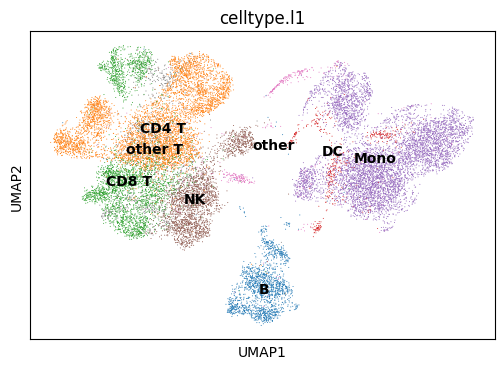

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


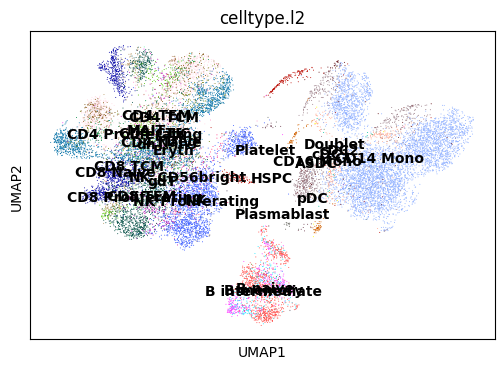

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


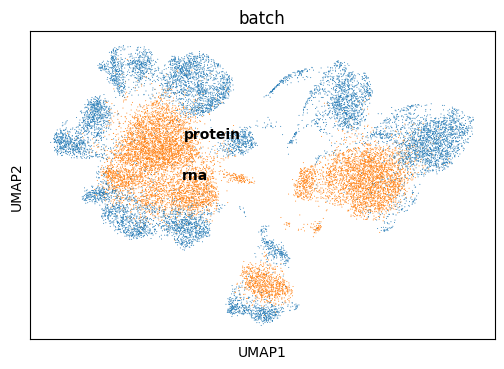

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


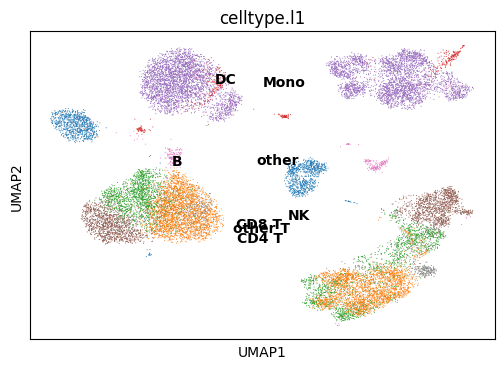

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


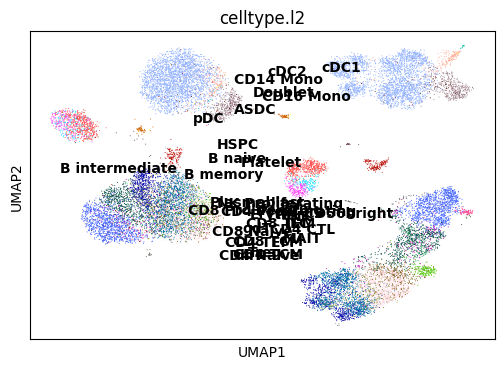

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


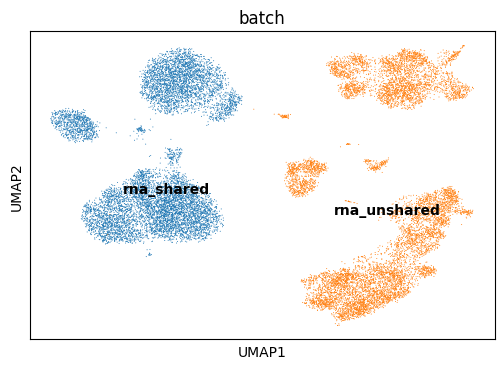

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


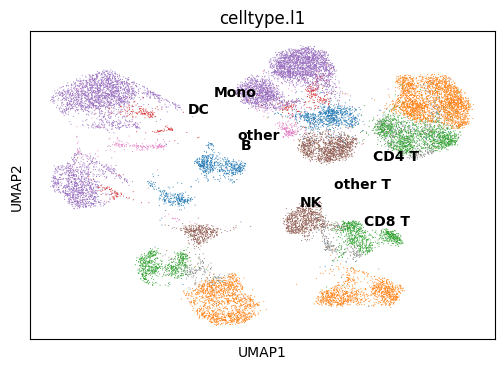

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


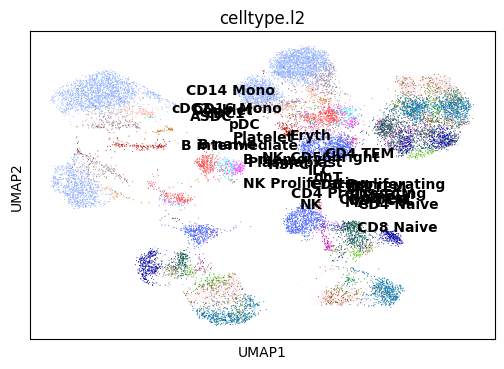

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


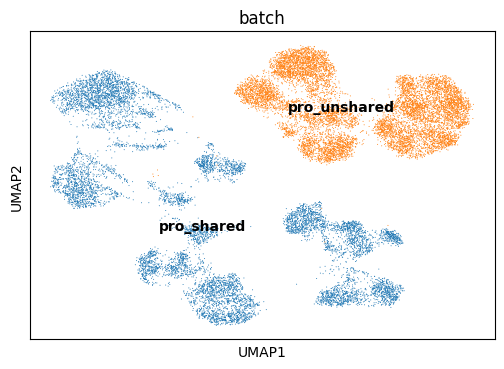

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For All matchings: lv1 matching acc: 0.741,
lv2 matching acc: 0.558.
For All matchings: FOSCTTM score: 0.24301893, 
Knn Alignment score: [0.0013 0.002  0.0034 0.0042 0.0053 0.0063 0.0073 0.009  0.0104 0.011
 0.0119 0.0123 0.0133 0.014  0.015  0.0161 0.017  0.0179 0.0185 0.0195
 0.02   0.0207 0.0213 0.0218 0.0225]
For All matchings: Silhouette F1 score for lv1: 0.5057479990017886, 
Silhouette F1 score for lv2: 0.49289570399239



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  3.423885464668274
Matchings are reduced to 5000 after filtering...


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:423: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[matchings[0]], labels_l1[matchings[1]])
C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For only filtered matchings: lv1 matching acc: 0.839,
lv2 matching acc: 0.645.



Matches are being propagated....


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:460: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[filtered_matchings[0]], labels_l1[filtered_matchings[1]])


Done!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For all matchings after propagation: lv1 matching acc: 0.763,
lv2 matching acc: 0.552.


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:495: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[propagated_matchings[0]], labels_l1[propagated_matchings[1]])


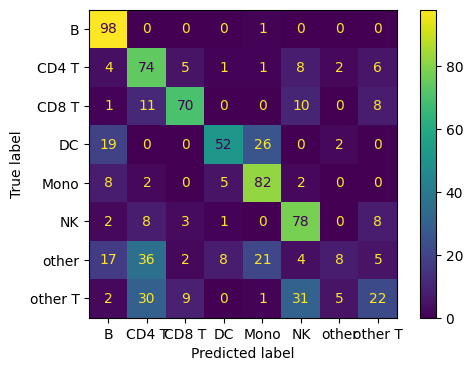

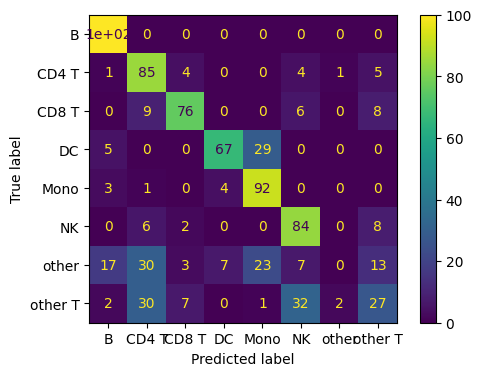

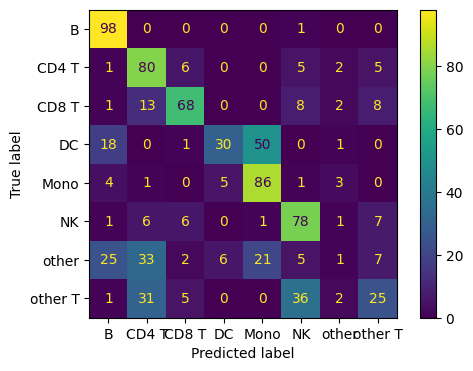

Epoch: 1101: 0it [00:00, ?it/s]C:\Users\vinee\AppData\Local\Temp\ipykernel_2144\3129631169.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return {"x_unshared":self.unshared_data[idx], "x_shared":self.shared_data[idx], "l1":self.labels_l1[idx], "l2":self.labels_l2[idx], "mean": self.local_mean[idx], "var": self.local_var[idx], "batch": self.batch[idx]}
Epoch: 1101: 40it [00:15,  2.56it/s]


RNA Recon Loss: 2.0114, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4229, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8294, Protein KL Div Z: 0.6195, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5325, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.7982 Cross Loss Protein: 0.5397


Epoch: 1102: 40it [00:14,  2.78it/s]


RNA Recon Loss: 1.9963, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4233, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8273, Protein KL Div Z: 0.6194, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5313, Shared Recon Loss Gene: 0.2579, Shared Recon Loss Protein: 1.7973 Cross Loss Protein: 0.5404


Epoch: 1103: 40it [00:15,  2.55it/s]


RNA Recon Loss: 1.9970, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4226, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8277, Protein KL Div Z: 0.6187, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5314, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7967 Cross Loss Protein: 0.5401


Epoch: 1104: 40it [00:14,  2.74it/s]


RNA Recon Loss: 1.9983, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4227, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8287, Protein KL Div Z: 0.6182, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5310, Shared Recon Loss Gene: 0.2579, Shared Recon Loss Protein: 1.7993 Cross Loss Protein: 0.5401


Epoch: 1105: 40it [00:15,  2.53it/s]


RNA Recon Loss: 1.9946, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4229, Protein Recon Loss: 0.4874, Protein KL Div Back Pro: 0.8298, Protein KL Div Z: 0.6201, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5310, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7995 Cross Loss Protein: 0.5409


Epoch: 1106: 40it [00:14,  2.72it/s]


RNA Recon Loss: 1.9945, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4228, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8283, Protein KL Div Z: 0.6190, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5308, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7979 Cross Loss Protein: 0.5402


Epoch: 1107: 40it [00:15,  2.55it/s]


RNA Recon Loss: 2.0021, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4228, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8281, Protein KL Div Z: 0.6192, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5319, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7974 Cross Loss Protein: 0.5394


Epoch: 1108: 40it [00:14,  2.76it/s]


RNA Recon Loss: 1.9979, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4227, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8286, Protein KL Div Z: 0.6194, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5312, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7962 Cross Loss Protein: 0.5398


Epoch: 1109: 40it [00:15,  2.58it/s]


RNA Recon Loss: 1.9941, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4228, Protein Recon Loss: 0.4863, Protein KL Div Back Pro: 0.8275, Protein KL Div Z: 0.6188, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5314, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7952 Cross Loss Protein: 0.5396


Epoch: 1110: 40it [00:14,  2.72it/s]


RNA Recon Loss: 2.0015, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4234, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8287, Protein KL Div Z: 0.6204, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5313, Shared Recon Loss Gene: 0.2577, Shared Recon Loss Protein: 1.7969 Cross Loss Protein: 0.5402


Epoch: 1111: 40it [00:15,  2.58it/s]


RNA Recon Loss: 2.0023, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4234, Protein Recon Loss: 0.4866, Protein KL Div Back Pro: 0.8286, Protein KL Div Z: 0.6202, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5315, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7983 Cross Loss Protein: 0.5403


Epoch: 1112: 40it [00:14,  2.73it/s]


RNA Recon Loss: 1.9945, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4227, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8299, Protein KL Div Z: 0.6205, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5311, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7970 Cross Loss Protein: 0.5400


Epoch: 1113: 40it [00:17,  2.32it/s]


RNA Recon Loss: 1.9944, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4232, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8274, Protein KL Div Z: 0.6194, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5311, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7962 Cross Loss Protein: 0.5400


Epoch: 1114: 40it [00:19,  2.01it/s]


RNA Recon Loss: 1.9977, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4223, Protein Recon Loss: 0.4872, Protein KL Div Back Pro: 0.8276, Protein KL Div Z: 0.6204, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5315, Shared Recon Loss Gene: 0.2579, Shared Recon Loss Protein: 1.7990 Cross Loss Protein: 0.5411


Epoch: 1115: 40it [00:19,  2.03it/s]


RNA Recon Loss: 1.9917, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4222, Protein Recon Loss: 0.4868, Protein KL Div Back Pro: 0.8287, Protein KL Div Z: 0.6196, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5315, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7972 Cross Loss Protein: 0.5407


Epoch: 1116: 40it [00:16,  2.38it/s]


RNA Recon Loss: 1.9934, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4226, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8309, Protein KL Div Z: 0.6205, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5314, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7976 Cross Loss Protein: 0.5402


Epoch: 1117: 40it [00:15,  2.65it/s]


RNA Recon Loss: 1.9937, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4228, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8303, Protein KL Div Z: 0.6207, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5314, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7980 Cross Loss Protein: 0.5399


Epoch: 1118: 40it [00:15,  2.61it/s]


RNA Recon Loss: 1.9995, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4224, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8295, Protein KL Div Z: 0.6202, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5311, Shared Recon Loss Gene: 0.2578, Shared Recon Loss Protein: 1.7970 Cross Loss Protein: 0.5399


Epoch: 1119: 40it [00:15,  2.64it/s]


RNA Recon Loss: 1.9967, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4227, Protein Recon Loss: 0.4877, Protein KL Div Back Pro: 0.8286, Protein KL Div Z: 0.6200, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5312, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7996 Cross Loss Protein: 0.5421


Epoch: 1120: 40it [00:15,  2.61it/s]


RNA Recon Loss: 1.9974, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4224, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8319, Protein KL Div Z: 0.6214, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5307, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7954 Cross Loss Protein: 0.5401


Epoch: 1121: 40it [00:15,  2.66it/s]


RNA Recon Loss: 1.9986, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4234, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8278, Protein KL Div Z: 0.6178, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5311, Shared Recon Loss Gene: 0.2577, Shared Recon Loss Protein: 1.7969 Cross Loss Protein: 0.5405


Epoch: 1122: 40it [00:15,  2.66it/s]


RNA Recon Loss: 2.0024, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4229, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8298, Protein KL Div Z: 0.6191, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5309, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7971 Cross Loss Protein: 0.5399


Epoch: 1123: 40it [00:14,  2.67it/s]


RNA Recon Loss: 1.9914, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4229, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8294, Protein KL Div Z: 0.6198, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5312, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7973 Cross Loss Protein: 0.5402


Epoch: 1124: 40it [00:15,  2.59it/s]


RNA Recon Loss: 1.9923, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4222, Protein Recon Loss: 0.4865, Protein KL Div Back Pro: 0.8279, Protein KL Div Z: 0.6195, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5305, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7982 Cross Loss Protein: 0.5406


Epoch: 1125: 40it [00:14,  2.67it/s]


RNA Recon Loss: 1.9932, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4229, Protein Recon Loss: 0.4868, Protein KL Div Back Pro: 0.8275, Protein KL Div Z: 0.6195, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5315, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7965 Cross Loss Protein: 0.5401


Epoch: 1126: 40it [00:15,  2.62it/s]


RNA Recon Loss: 2.0045, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4222, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8295, Protein KL Div Z: 0.6195, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5305, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7976 Cross Loss Protein: 0.5400


Epoch: 1127: 40it [00:14,  2.68it/s]


RNA Recon Loss: 1.9933, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4223, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8279, Protein KL Div Z: 0.6208, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5321, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7971 Cross Loss Protein: 0.5399


Epoch: 1128: 40it [00:15,  2.57it/s]


RNA Recon Loss: 1.9929, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4219, Protein Recon Loss: 0.4885, Protein KL Div Back Pro: 0.8282, Protein KL Div Z: 0.6186, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5316, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.8025 Cross Loss Protein: 0.5415


Epoch: 1129: 40it [00:14,  2.67it/s]


RNA Recon Loss: 1.9977, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4228, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8292, Protein KL Div Z: 0.6210, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5311, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7966 Cross Loss Protein: 0.5400


Epoch: 1130: 40it [00:15,  2.60it/s]


RNA Recon Loss: 1.9934, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4228, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8266, Protein KL Div Z: 0.6186, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5317, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7956 Cross Loss Protein: 0.5398


Epoch: 1131: 40it [00:14,  2.70it/s]


RNA Recon Loss: 1.9981, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4226, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8251, Protein KL Div Z: 0.6192, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5311, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7958 Cross Loss Protein: 0.5396


Epoch: 1132: 40it [00:15,  2.57it/s]


RNA Recon Loss: 2.0001, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4231, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8261, Protein KL Div Z: 0.6201, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5307, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7953 Cross Loss Protein: 0.5397


Epoch: 1133: 40it [00:14,  2.71it/s]


RNA Recon Loss: 1.9937, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4226, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8263, Protein KL Div Z: 0.6192, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5312, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7968 Cross Loss Protein: 0.5402


Epoch: 1134: 40it [00:15,  2.58it/s]


RNA Recon Loss: 1.9911, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4226, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8271, Protein KL Div Z: 0.6214, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5310, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7989 Cross Loss Protein: 0.5405


Epoch: 1135: 40it [00:14,  2.72it/s]


RNA Recon Loss: 1.9969, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4228, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8260, Protein KL Div Z: 0.6190, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5311, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7978 Cross Loss Protein: 0.5400


Epoch: 1136: 40it [00:15,  2.57it/s]


RNA Recon Loss: 2.0010, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4229, Protein Recon Loss: 0.4863, Protein KL Div Back Pro: 0.8273, Protein KL Div Z: 0.6207, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5308, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7995 Cross Loss Protein: 0.5397


Epoch: 1137: 40it [00:14,  2.68it/s]


RNA Recon Loss: 1.9958, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4222, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8277, Protein KL Div Z: 0.6199, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5309, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7984 Cross Loss Protein: 0.5400


Epoch: 1138: 40it [00:15,  2.53it/s]


RNA Recon Loss: 1.9956, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4224, Protein Recon Loss: 0.4866, Protein KL Div Back Pro: 0.8267, Protein KL Div Z: 0.6192, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5310, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7969 Cross Loss Protein: 0.5402


Epoch: 1139: 40it [00:14,  2.73it/s]


RNA Recon Loss: 1.9970, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4217, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8262, Protein KL Div Z: 0.6200, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5300, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7950 Cross Loss Protein: 0.5393


Epoch: 1140: 40it [00:15,  2.54it/s]


RNA Recon Loss: 1.9919, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4226, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8251, Protein KL Div Z: 0.6198, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5310, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7974 Cross Loss Protein: 0.5403


Epoch: 1141: 40it [00:14,  2.74it/s]


RNA Recon Loss: 2.0029, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4227, Protein Recon Loss: 0.4863, Protein KL Div Back Pro: 0.8261, Protein KL Div Z: 0.6191, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5300, Shared Recon Loss Gene: 0.2578, Shared Recon Loss Protein: 1.7945 Cross Loss Protein: 0.5407


Epoch: 1142: 40it [00:15,  2.57it/s]


RNA Recon Loss: 2.0006, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4231, Protein Recon Loss: 0.4867, Protein KL Div Back Pro: 0.8274, Protein KL Div Z: 0.6207, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5308, Shared Recon Loss Gene: 0.2578, Shared Recon Loss Protein: 1.7990 Cross Loss Protein: 0.5405


Epoch: 1143: 40it [00:14,  2.74it/s]


RNA Recon Loss: 1.9921, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4223, Protein Recon Loss: 0.4863, Protein KL Div Back Pro: 0.8273, Protein KL Div Z: 0.6200, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5305, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7965 Cross Loss Protein: 0.5398


Epoch: 1144: 40it [00:15,  2.57it/s]


RNA Recon Loss: 1.9977, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4225, Protein Recon Loss: 0.4863, Protein KL Div Back Pro: 0.8246, Protein KL Div Z: 0.6200, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5309, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7951 Cross Loss Protein: 0.5400


Epoch: 1145: 40it [00:14,  2.68it/s]


RNA Recon Loss: 1.9978, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4224, Protein Recon Loss: 0.4879, Protein KL Div Back Pro: 0.8252, Protein KL Div Z: 0.6195, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5308, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.8002 Cross Loss Protein: 0.5409


Epoch: 1146: 40it [00:15,  2.57it/s]


RNA Recon Loss: 1.9917, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4224, Protein Recon Loss: 0.4865, Protein KL Div Back Pro: 0.8286, Protein KL Div Z: 0.6199, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5317, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7999 Cross Loss Protein: 0.5406


Epoch: 1147: 40it [00:14,  2.74it/s]


RNA Recon Loss: 1.9913, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4224, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8288, Protein KL Div Z: 0.6192, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5317, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7984 Cross Loss Protein: 0.5401


Epoch: 1148: 40it [00:15,  2.57it/s]


RNA Recon Loss: 1.9935, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4225, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8267, Protein KL Div Z: 0.6209, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5310, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7962 Cross Loss Protein: 0.5400


Epoch: 1149: 40it [00:14,  2.75it/s]


RNA Recon Loss: 1.9920, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4219, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8257, Protein KL Div Z: 0.6189, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5309, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7969 Cross Loss Protein: 0.5396


Epoch: 1150: 40it [00:15,  2.59it/s]


RNA Recon Loss: 1.9990, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4221, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8269, Protein KL Div Z: 0.6192, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5304, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7958 Cross Loss Protein: 0.5396


Epoch: 1151: 40it [00:14,  2.71it/s]


RNA Recon Loss: 1.9973, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4226, Protein Recon Loss: 0.4867, Protein KL Div Back Pro: 0.8265, Protein KL Div Z: 0.6185, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5305, Shared Recon Loss Gene: 0.2578, Shared Recon Loss Protein: 1.7981 Cross Loss Protein: 0.5400


Epoch: 1152: 40it [00:15,  2.57it/s]


RNA Recon Loss: 1.9968, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4221, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8292, Protein KL Div Z: 0.6195, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5306, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7980 Cross Loss Protein: 0.5401


Epoch: 1153: 40it [00:15,  2.61it/s]


RNA Recon Loss: 1.9896, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4229, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8270, Protein KL Div Z: 0.6197, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5306, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7987 Cross Loss Protein: 0.5402


Epoch: 1154: 40it [00:15,  2.62it/s]


RNA Recon Loss: 1.9971, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4223, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8291, Protein KL Div Z: 0.6194, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5302, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7965 Cross Loss Protein: 0.5397


Epoch: 1155: 40it [00:15,  2.64it/s]


RNA Recon Loss: 1.9949, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4230, Protein Recon Loss: 0.4863, Protein KL Div Back Pro: 0.8276, Protein KL Div Z: 0.6188, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5308, Shared Recon Loss Gene: 0.2579, Shared Recon Loss Protein: 1.7987 Cross Loss Protein: 0.5402


Epoch: 1156: 40it [00:15,  2.63it/s]


RNA Recon Loss: 1.9995, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4230, Protein Recon Loss: 0.4868, Protein KL Div Back Pro: 0.8297, Protein KL Div Z: 0.6193, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5311, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.8012 Cross Loss Protein: 0.5406


Epoch: 1157: 40it [00:15,  2.64it/s]


RNA Recon Loss: 1.9938, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4220, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8300, Protein KL Div Z: 0.6203, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5305, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7964 Cross Loss Protein: 0.5402


Epoch: 1158: 40it [00:15,  2.62it/s]


RNA Recon Loss: 2.0073, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4229, Protein Recon Loss: 0.4863, Protein KL Div Back Pro: 0.8285, Protein KL Div Z: 0.6198, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5300, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.7986 Cross Loss Protein: 0.5410


Epoch: 1159: 40it [00:15,  2.61it/s]


RNA Recon Loss: 2.0005, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4229, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8308, Protein KL Div Z: 0.6209, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5307, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7955 Cross Loss Protein: 0.5400


Epoch: 1160: 40it [00:15,  2.62it/s]


RNA Recon Loss: 1.9928, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4218, Protein Recon Loss: 0.4865, Protein KL Div Back Pro: 0.8260, Protein KL Div Z: 0.6182, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5303, Shared Recon Loss Gene: 0.2577, Shared Recon Loss Protein: 1.7993 Cross Loss Protein: 0.5406


Epoch: 1161: 40it [00:15,  2.66it/s]


RNA Recon Loss: 1.9939, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4223, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8322, Protein KL Div Z: 0.6212, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5303, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7969 Cross Loss Protein: 0.5397


Epoch: 1162: 40it [00:15,  2.64it/s]


RNA Recon Loss: 1.9985, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4223, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8290, Protein KL Div Z: 0.6203, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5305, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7948 Cross Loss Protein: 0.5398


Epoch: 1163: 40it [00:15,  2.64it/s]


RNA Recon Loss: 1.9939, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4229, Protein Recon Loss: 0.4879, Protein KL Div Back Pro: 0.8282, Protein KL Div Z: 0.6188, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5304, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7990 Cross Loss Protein: 0.5412


Epoch: 1164: 40it [00:15,  2.63it/s]


RNA Recon Loss: 1.9973, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4219, Protein Recon Loss: 0.4866, Protein KL Div Back Pro: 0.8315, Protein KL Div Z: 0.6201, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5307, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7975 Cross Loss Protein: 0.5404


Epoch: 1165: 40it [00:15,  2.64it/s]


RNA Recon Loss: 2.0024, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4221, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8283, Protein KL Div Z: 0.6190, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5300, Shared Recon Loss Gene: 0.2578, Shared Recon Loss Protein: 1.7953 Cross Loss Protein: 0.5391


Epoch: 1166: 40it [00:15,  2.65it/s]


RNA Recon Loss: 1.9947, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4222, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8300, Protein KL Div Z: 0.6216, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5306, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7971 Cross Loss Protein: 0.5398


Epoch: 1167: 40it [00:15,  2.61it/s]


RNA Recon Loss: 1.9963, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4217, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8294, Protein KL Div Z: 0.6202, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5299, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7957 Cross Loss Protein: 0.5402


Epoch: 1168: 40it [00:15,  2.65it/s]


RNA Recon Loss: 1.9991, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4221, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8296, Protein KL Div Z: 0.6192, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5295, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7954 Cross Loss Protein: 0.5394


Epoch: 1169: 40it [00:15,  2.57it/s]


RNA Recon Loss: 2.0012, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4227, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8272, Protein KL Div Z: 0.6180, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5298, Shared Recon Loss Gene: 0.2579, Shared Recon Loss Protein: 1.7964 Cross Loss Protein: 0.5398


Epoch: 1170: 40it [00:14,  2.71it/s]


RNA Recon Loss: 2.0021, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4224, Protein Recon Loss: 0.4870, Protein KL Div Back Pro: 0.8287, Protein KL Div Z: 0.6194, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5310, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7987 Cross Loss Protein: 0.5410


Epoch: 1171: 40it [00:15,  2.55it/s]


RNA Recon Loss: 1.9935, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4220, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8305, Protein KL Div Z: 0.6197, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5309, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7967 Cross Loss Protein: 0.5398


Epoch: 1172: 40it [00:14,  2.71it/s]


RNA Recon Loss: 1.9914, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4221, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8294, Protein KL Div Z: 0.6203, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5300, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7973 Cross Loss Protein: 0.5403


Epoch: 1173: 40it [00:15,  2.55it/s]


RNA Recon Loss: 2.0023, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4213, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8277, Protein KL Div Z: 0.6188, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5298, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7964 Cross Loss Protein: 0.5398


Epoch: 1174: 40it [00:14,  2.74it/s]


RNA Recon Loss: 1.9937, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4225, Protein Recon Loss: 0.4882, Protein KL Div Back Pro: 0.8289, Protein KL Div Z: 0.6191, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5310, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.8028 Cross Loss Protein: 0.5411


Epoch: 1175: 40it [00:15,  2.58it/s]


RNA Recon Loss: 2.0069, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4222, Protein Recon Loss: 0.4866, Protein KL Div Back Pro: 0.8303, Protein KL Div Z: 0.6210, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5299, Shared Recon Loss Gene: 0.2590, Shared Recon Loss Protein: 1.8001 Cross Loss Protein: 0.5400


Epoch: 1176: 40it [00:14,  2.72it/s]


RNA Recon Loss: 1.9947, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4221, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8280, Protein KL Div Z: 0.6190, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5311, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7988 Cross Loss Protein: 0.5400


Epoch: 1177: 40it [00:15,  2.54it/s]


RNA Recon Loss: 1.9912, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4223, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8266, Protein KL Div Z: 0.6197, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5307, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7977 Cross Loss Protein: 0.5398


Epoch: 1178: 40it [00:14,  2.75it/s]


RNA Recon Loss: 1.9970, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4218, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8294, Protein KL Div Z: 0.6199, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5304, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7975 Cross Loss Protein: 0.5399


Epoch: 1179: 40it [00:15,  2.54it/s]


RNA Recon Loss: 1.9935, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4225, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8307, Protein KL Div Z: 0.6204, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5310, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7969 Cross Loss Protein: 0.5403


Epoch: 1180: 40it [00:14,  2.76it/s]


RNA Recon Loss: 1.9937, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4217, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8291, Protein KL Div Z: 0.6205, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5308, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7953 Cross Loss Protein: 0.5402


Epoch: 1181: 40it [00:15,  2.56it/s]


RNA Recon Loss: 1.9988, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4223, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8281, Protein KL Div Z: 0.6191, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5302, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7963 Cross Loss Protein: 0.5399


Epoch: 1182: 40it [00:14,  2.78it/s]


RNA Recon Loss: 1.9910, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4217, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8263, Protein KL Div Z: 0.6185, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5297, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7963 Cross Loss Protein: 0.5399


Epoch: 1183: 40it [00:15,  2.54it/s]


RNA Recon Loss: 1.9917, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4222, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8279, Protein KL Div Z: 0.6208, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5298, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7972 Cross Loss Protein: 0.5395


Epoch: 1184: 40it [00:14,  2.72it/s]


RNA Recon Loss: 1.9983, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4228, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8282, Protein KL Div Z: 0.6215, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5299, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7979 Cross Loss Protein: 0.5401


Epoch: 1185: 40it [00:15,  2.54it/s]


RNA Recon Loss: 1.9965, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4221, Protein Recon Loss: 0.4875, Protein KL Div Back Pro: 0.8270, Protein KL Div Z: 0.6202, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5299, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7986 Cross Loss Protein: 0.5406


Epoch: 1186: 40it [00:14,  2.77it/s]


RNA Recon Loss: 1.9982, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4223, Protein Recon Loss: 0.4865, Protein KL Div Back Pro: 0.8311, Protein KL Div Z: 0.6211, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5299, Shared Recon Loss Gene: 0.2578, Shared Recon Loss Protein: 1.7964 Cross Loss Protein: 0.5405


Epoch: 1187: 40it [00:15,  2.54it/s]


RNA Recon Loss: 1.9946, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4221, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8283, Protein KL Div Z: 0.6207, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5301, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7980 Cross Loss Protein: 0.5399


Epoch: 1188: 40it [00:14,  2.74it/s]


RNA Recon Loss: 1.9984, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4218, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8284, Protein KL Div Z: 0.6204, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5299, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7967 Cross Loss Protein: 0.5401


Epoch: 1189: 40it [00:15,  2.58it/s]


RNA Recon Loss: 1.9943, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4224, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8264, Protein KL Div Z: 0.6186, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5299, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7964 Cross Loss Protein: 0.5410


Epoch: 1190: 40it [00:14,  2.72it/s]


RNA Recon Loss: 1.9935, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4223, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8264, Protein KL Div Z: 0.6202, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5301, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7949 Cross Loss Protein: 0.5390


Epoch: 1191: 40it [00:15,  2.56it/s]


RNA Recon Loss: 1.9904, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4218, Protein Recon Loss: 0.4874, Protein KL Div Back Pro: 0.8287, Protein KL Div Z: 0.6203, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5304, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7984 Cross Loss Protein: 0.5405


Epoch: 1192: 40it [00:14,  2.69it/s]


RNA Recon Loss: 1.9929, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4223, Protein Recon Loss: 0.4865, Protein KL Div Back Pro: 0.8270, Protein KL Div Z: 0.6198, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5304, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7977 Cross Loss Protein: 0.5412


Epoch: 1193: 40it [00:15,  2.59it/s]


RNA Recon Loss: 1.9931, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4220, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8287, Protein KL Div Z: 0.6211, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5300, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7961 Cross Loss Protein: 0.5398


Epoch: 1194: 40it [00:14,  2.73it/s]


RNA Recon Loss: 1.9956, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4216, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8276, Protein KL Div Z: 0.6186, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5299, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7961 Cross Loss Protein: 0.5399


Epoch: 1195: 40it [00:15,  2.58it/s]


RNA Recon Loss: 1.9975, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4218, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8251, Protein KL Div Z: 0.6185, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5298, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7943 Cross Loss Protein: 0.5396


Epoch: 1196: 40it [00:14,  2.69it/s]


RNA Recon Loss: 1.9987, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4220, Protein Recon Loss: 0.4867, Protein KL Div Back Pro: 0.8271, Protein KL Div Z: 0.6202, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5295, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7996 Cross Loss Protein: 0.5403


Epoch: 1197: 40it [00:15,  2.59it/s]


RNA Recon Loss: 1.9962, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4220, Protein Recon Loss: 0.4863, Protein KL Div Back Pro: 0.8284, Protein KL Div Z: 0.6205, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5303, Shared Recon Loss Gene: 0.2577, Shared Recon Loss Protein: 1.7975 Cross Loss Protein: 0.5400


Epoch: 1198: 40it [00:14,  2.70it/s]


RNA Recon Loss: 1.9970, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4219, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8264, Protein KL Div Z: 0.6203, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5308, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7973 Cross Loss Protein: 0.5398


Epoch: 1199: 40it [00:15,  2.61it/s]


RNA Recon Loss: 1.9928, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4221, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8265, Protein KL Div Z: 0.6182, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5295, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7974 Cross Loss Protein: 0.5403


Epoch: 1200: 40it [00:14,  2.69it/s]


RNA Recon Loss: 1.9967, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4216, Protein Recon Loss: 0.4870, Protein KL Div Back Pro: 0.8273, Protein KL Div Z: 0.6214, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5304, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7987 Cross Loss Protein: 0.5408


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


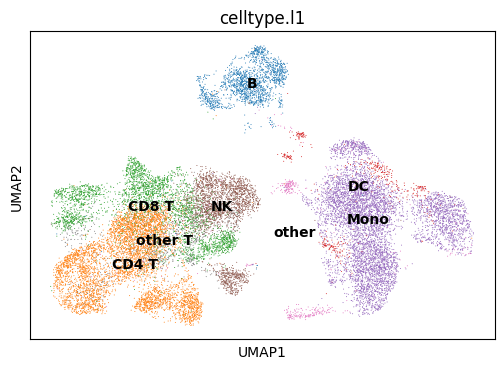

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


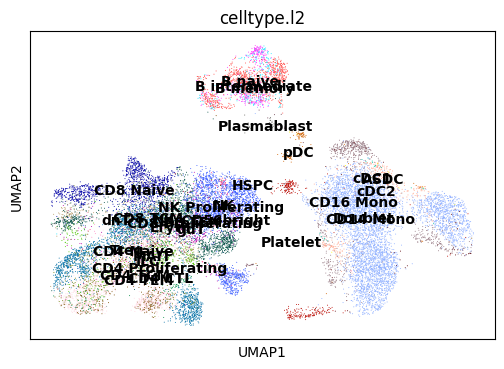

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


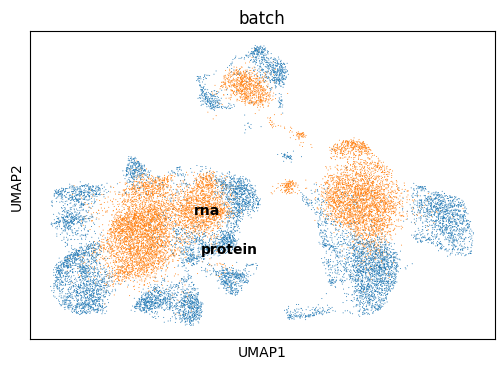

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


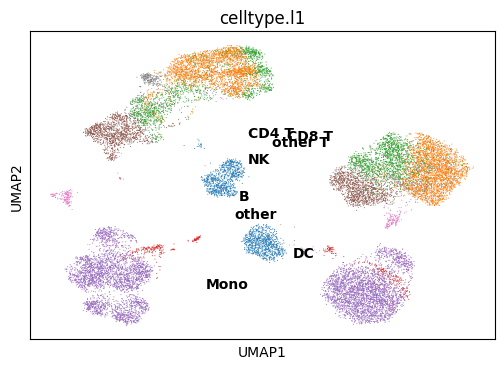

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


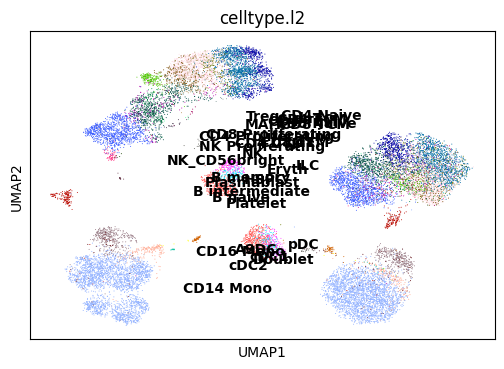

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


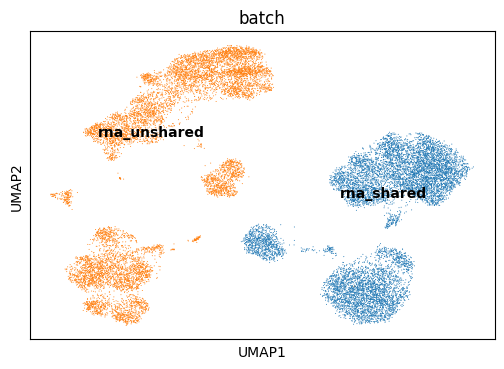

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


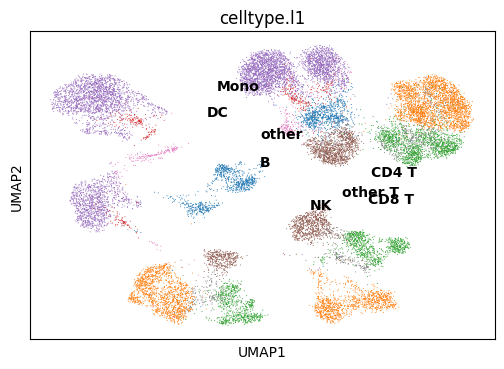

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


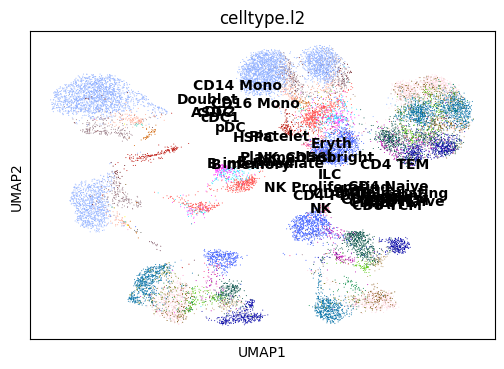

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


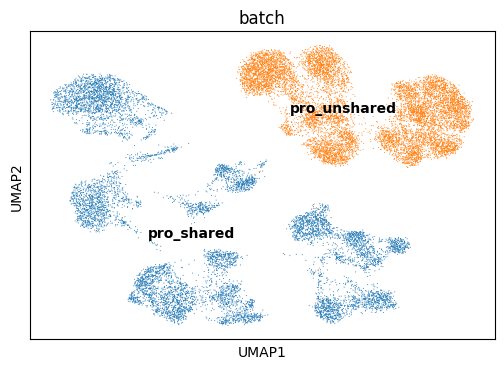

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For All matchings: lv1 matching acc: 0.736,
lv2 matching acc: 0.554.
For All matchings: FOSCTTM score: 0.23803172999999997, 
Knn Alignment score: [0.0008 0.0026 0.0037 0.0046 0.0064 0.008  0.0093 0.0105 0.011  0.0119
 0.0133 0.0141 0.0153 0.0166 0.0178 0.0187 0.0192 0.0199 0.0204 0.0212
 0.0223 0.0231 0.0236 0.0243 0.025 ]
For All matchings: Silhouette F1 score for lv1: 0.507527538285783, 
Silhouette F1 score for lv2: 0.49435620305472483



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  3.4177297353744507
Matchings are reduced to 5000 after filtering...


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:423: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[matchings[0]], labels_l1[matchings[1]])
C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For only filtered matchings: lv1 matching acc: 0.834,
lv2 matching acc: 0.652.



Matches are being propagated....


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:460: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[filtered_matchings[0]], labels_l1[filtered_matchings[1]])


Done!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For all matchings after propagation: lv1 matching acc: 0.772,
lv2 matching acc: 0.556.


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:495: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[propagated_matchings[0]], labels_l1[propagated_matchings[1]])


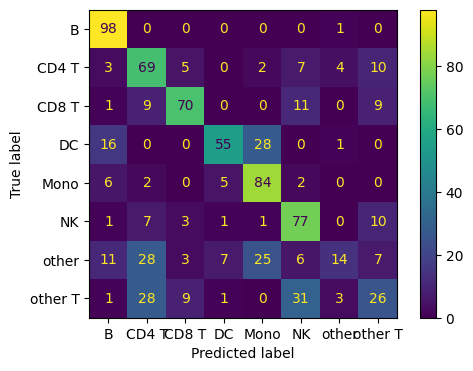

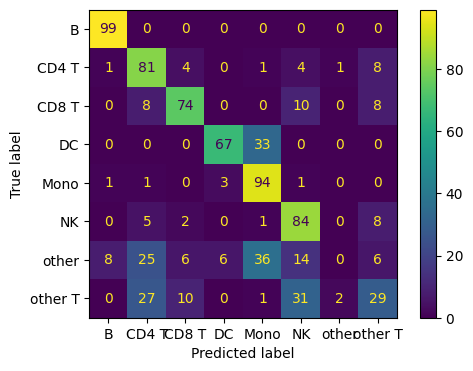

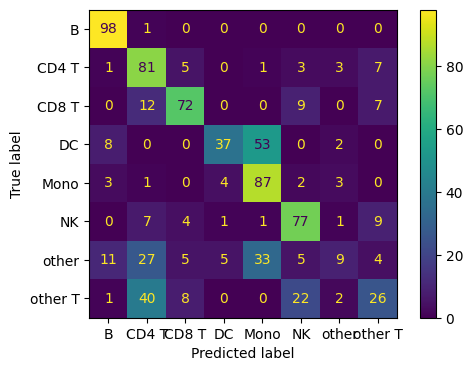

Epoch: 1201: 0it [00:00, ?it/s]C:\Users\vinee\AppData\Local\Temp\ipykernel_2144\3129631169.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return {"x_unshared":self.unshared_data[idx], "x_shared":self.shared_data[idx], "l1":self.labels_l1[idx], "l2":self.labels_l2[idx], "mean": self.local_mean[idx], "var": self.local_var[idx], "batch": self.batch[idx]}
Epoch: 1201: 40it [00:14,  2.78it/s]


RNA Recon Loss: 1.9936, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4219, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8275, Protein KL Div Z: 0.6201, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5300, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7951 Cross Loss Protein: 0.5401


Epoch: 1202: 40it [00:15,  2.62it/s]


RNA Recon Loss: 1.9951, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4211, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8252, Protein KL Div Z: 0.6200, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5301, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7976 Cross Loss Protein: 0.5403


Epoch: 1203: 40it [00:14,  2.70it/s]


RNA Recon Loss: 1.9910, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4215, Protein Recon Loss: 0.4863, Protein KL Div Back Pro: 0.8277, Protein KL Div Z: 0.6196, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5304, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7955 Cross Loss Protein: 0.5405


Epoch: 1204: 40it [00:15,  2.60it/s]


RNA Recon Loss: 1.9974, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4219, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8270, Protein KL Div Z: 0.6199, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5304, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7962 Cross Loss Protein: 0.5395


Epoch: 1205: 40it [00:14,  2.68it/s]


RNA Recon Loss: 1.9927, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4213, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8270, Protein KL Div Z: 0.6203, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5300, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7969 Cross Loss Protein: 0.5398


Epoch: 1206: 40it [00:15,  2.63it/s]


RNA Recon Loss: 1.9918, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4214, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8252, Protein KL Div Z: 0.6204, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5295, Shared Recon Loss Gene: 0.2561, Shared Recon Loss Protein: 1.7954 Cross Loss Protein: 0.5397


Epoch: 1207: 40it [00:14,  2.70it/s]


RNA Recon Loss: 1.9923, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4212, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8265, Protein KL Div Z: 0.6198, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5303, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7944 Cross Loss Protein: 0.5394


Epoch: 1208: 40it [00:15,  2.54it/s]


RNA Recon Loss: 1.9932, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4212, Protein Recon Loss: 0.4868, Protein KL Div Back Pro: 0.8258, Protein KL Div Z: 0.6189, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5301, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7961 Cross Loss Protein: 0.5399


Epoch: 1209: 40it [00:14,  2.68it/s]


RNA Recon Loss: 2.0048, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4215, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8276, Protein KL Div Z: 0.6200, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5300, Shared Recon Loss Gene: 0.2582, Shared Recon Loss Protein: 1.7948 Cross Loss Protein: 0.5398


Epoch: 1210: 40it [00:15,  2.59it/s]


RNA Recon Loss: 1.9934, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4218, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8273, Protein KL Div Z: 0.6201, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5303, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7986 Cross Loss Protein: 0.5405


Epoch: 1211: 40it [00:15,  2.64it/s]


RNA Recon Loss: 1.9923, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4220, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8294, Protein KL Div Z: 0.6206, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5301, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7962 Cross Loss Protein: 0.5401


Epoch: 1212: 40it [00:15,  2.57it/s]


RNA Recon Loss: 1.9939, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4223, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8281, Protein KL Div Z: 0.6205, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5304, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7966 Cross Loss Protein: 0.5399


Epoch: 1213: 40it [00:14,  2.73it/s]


RNA Recon Loss: 1.9930, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4217, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8290, Protein KL Div Z: 0.6207, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5300, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7975 Cross Loss Protein: 0.5394


Epoch: 1214: 40it [00:15,  2.54it/s]


RNA Recon Loss: 2.0081, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4221, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8280, Protein KL Div Z: 0.6203, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5301, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.7946 Cross Loss Protein: 0.5394


Epoch: 1215: 40it [00:14,  2.75it/s]


RNA Recon Loss: 2.0029, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4220, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8274, Protein KL Div Z: 0.6192, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5293, Shared Recon Loss Gene: 0.2579, Shared Recon Loss Protein: 1.7964 Cross Loss Protein: 0.5393


Epoch: 1216: 40it [00:16,  2.49it/s]


RNA Recon Loss: 1.9945, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4220, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8265, Protein KL Div Z: 0.6185, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5301, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7933 Cross Loss Protein: 0.5396


Epoch: 1217: 40it [00:14,  2.74it/s]


RNA Recon Loss: 1.9905, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4218, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8280, Protein KL Div Z: 0.6191, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5303, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7952 Cross Loss Protein: 0.5401


Epoch: 1218: 40it [00:16,  2.39it/s]


RNA Recon Loss: 1.9934, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4217, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8277, Protein KL Div Z: 0.6189, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5299, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7948 Cross Loss Protein: 0.5397


Epoch: 1219: 40it [00:15,  2.62it/s]


RNA Recon Loss: 1.9944, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4215, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8283, Protein KL Div Z: 0.6200, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5301, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7969 Cross Loss Protein: 0.5397


Epoch: 1220: 40it [00:15,  2.63it/s]


RNA Recon Loss: 1.9911, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4209, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8283, Protein KL Div Z: 0.6206, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5295, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7946 Cross Loss Protein: 0.5395


Epoch: 1221: 40it [00:14,  2.67it/s]


RNA Recon Loss: 1.9952, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4214, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8275, Protein KL Div Z: 0.6204, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5295, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7972 Cross Loss Protein: 0.5399


Epoch: 1222: 40it [00:15,  2.62it/s]


RNA Recon Loss: 1.9912, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4216, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8276, Protein KL Div Z: 0.6198, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5304, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7992 Cross Loss Protein: 0.5404


Epoch: 1223: 40it [00:15,  2.63it/s]


RNA Recon Loss: 1.9982, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4218, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8304, Protein KL Div Z: 0.6217, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5305, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7981 Cross Loss Protein: 0.5399


Epoch: 1224: 40it [00:15,  2.61it/s]


RNA Recon Loss: 1.9929, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4216, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8281, Protein KL Div Z: 0.6203, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5295, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7963 Cross Loss Protein: 0.5398


Epoch: 1225: 40it [00:15,  2.61it/s]


RNA Recon Loss: 1.9971, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4215, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8269, Protein KL Div Z: 0.6203, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5294, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7948 Cross Loss Protein: 0.5398


Epoch: 1226: 40it [00:14,  2.67it/s]


RNA Recon Loss: 2.0002, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4217, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8299, Protein KL Div Z: 0.6212, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5298, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7943 Cross Loss Protein: 0.5392


Epoch: 1227: 40it [00:15,  2.60it/s]


RNA Recon Loss: 1.9973, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4219, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8279, Protein KL Div Z: 0.6208, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5295, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7946 Cross Loss Protein: 0.5396


Epoch: 1228: 40it [00:14,  2.68it/s]


RNA Recon Loss: 1.9978, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4212, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8280, Protein KL Div Z: 0.6202, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5288, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7944 Cross Loss Protein: 0.5399


Epoch: 1229: 40it [00:15,  2.56it/s]


RNA Recon Loss: 1.9943, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4219, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8287, Protein KL Div Z: 0.6203, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5300, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7967 Cross Loss Protein: 0.5403


Epoch: 1230: 40it [00:14,  2.70it/s]


RNA Recon Loss: 1.9912, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4206, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8245, Protein KL Div Z: 0.6192, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5296, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7974 Cross Loss Protein: 0.5398


Epoch: 1231: 40it [00:15,  2.60it/s]


RNA Recon Loss: 2.0063, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4218, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8302, Protein KL Div Z: 0.6210, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5298, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7963 Cross Loss Protein: 0.5399


Epoch: 1232: 40it [00:15,  2.66it/s]


RNA Recon Loss: 1.9948, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4215, Protein Recon Loss: 0.4866, Protein KL Div Back Pro: 0.8269, Protein KL Div Z: 0.6195, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5294, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7966 Cross Loss Protein: 0.5407


Epoch: 1233: 40it [00:15,  2.54it/s]


RNA Recon Loss: 2.0019, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4213, Protein Recon Loss: 0.4875, Protein KL Div Back Pro: 0.8275, Protein KL Div Z: 0.6199, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5300, Shared Recon Loss Gene: 0.2578, Shared Recon Loss Protein: 1.8006 Cross Loss Protein: 0.5415


Epoch: 1234: 40it [00:15,  2.64it/s]


RNA Recon Loss: 1.9928, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4221, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8302, Protein KL Div Z: 0.6212, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5301, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7960 Cross Loss Protein: 0.5399


Epoch: 1235: 40it [00:15,  2.56it/s]


RNA Recon Loss: 1.9897, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4216, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8283, Protein KL Div Z: 0.6202, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5308, Shared Recon Loss Gene: 0.2562, Shared Recon Loss Protein: 1.7968 Cross Loss Protein: 0.5400


Epoch: 1236: 40it [00:14,  2.74it/s]


RNA Recon Loss: 1.9985, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4218, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8287, Protein KL Div Z: 0.6213, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5299, Shared Recon Loss Gene: 0.2580, Shared Recon Loss Protein: 1.7977 Cross Loss Protein: 0.5402


Epoch: 1237: 40it [00:15,  2.50it/s]


RNA Recon Loss: 1.9935, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4210, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8298, Protein KL Div Z: 0.6206, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5296, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7953 Cross Loss Protein: 0.5398


Epoch: 1238: 40it [00:14,  2.72it/s]


RNA Recon Loss: 2.0059, RNA KL Div L: 0.0144, RNA KL Div Z: 0.4220, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8277, Protein KL Div Z: 0.6206, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5297, Shared Recon Loss Gene: 0.2581, Shared Recon Loss Protein: 1.7974 Cross Loss Protein: 0.5405


Epoch: 1239: 40it [00:15,  2.56it/s]


RNA Recon Loss: 1.9981, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4221, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8278, Protein KL Div Z: 0.6199, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5299, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7982 Cross Loss Protein: 0.5400


Epoch: 1240: 40it [00:15,  2.65it/s]


RNA Recon Loss: 2.0017, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4220, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8283, Protein KL Div Z: 0.6198, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5291, Shared Recon Loss Gene: 0.2579, Shared Recon Loss Protein: 1.7972 Cross Loss Protein: 0.5404


Epoch: 1241: 40it [00:15,  2.58it/s]


RNA Recon Loss: 2.0002, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4221, Protein Recon Loss: 0.4863, Protein KL Div Back Pro: 0.8298, Protein KL Div Z: 0.6200, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5297, Shared Recon Loss Gene: 0.2582, Shared Recon Loss Protein: 1.7976 Cross Loss Protein: 0.5404


Epoch: 1242: 40it [00:15,  2.64it/s]


RNA Recon Loss: 1.9933, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4213, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8283, Protein KL Div Z: 0.6202, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5298, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7970 Cross Loss Protein: 0.5398


Epoch: 1243: 40it [00:15,  2.58it/s]


RNA Recon Loss: 1.9928, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4216, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8299, Protein KL Div Z: 0.6210, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5296, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7955 Cross Loss Protein: 0.5400


Epoch: 1244: 40it [00:15,  2.66it/s]


RNA Recon Loss: 1.9960, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4221, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8291, Protein KL Div Z: 0.6217, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5302, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7955 Cross Loss Protein: 0.5402


Epoch: 1245: 40it [00:15,  2.65it/s]


RNA Recon Loss: 1.9998, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4220, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8283, Protein KL Div Z: 0.6201, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5296, Shared Recon Loss Gene: 0.2580, Shared Recon Loss Protein: 1.7960 Cross Loss Protein: 0.5399


Epoch: 1246: 40it [00:15,  2.65it/s]


RNA Recon Loss: 1.9915, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4206, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8298, Protein KL Div Z: 0.6201, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5297, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7951 Cross Loss Protein: 0.5400


Epoch: 1247: 40it [00:15,  2.60it/s]


RNA Recon Loss: 1.9953, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4216, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8287, Protein KL Div Z: 0.6211, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5296, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7946 Cross Loss Protein: 0.5400


Epoch: 1248: 40it [00:15,  2.55it/s]


RNA Recon Loss: 1.9921, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4214, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8294, Protein KL Div Z: 0.6199, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5298, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7985 Cross Loss Protein: 0.5401


Epoch: 1249: 40it [00:15,  2.61it/s]


RNA Recon Loss: 2.0088, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4216, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8294, Protein KL Div Z: 0.6207, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5291, Shared Recon Loss Gene: 0.2582, Shared Recon Loss Protein: 1.7963 Cross Loss Protein: 0.5403


Epoch: 1250: 40it [00:15,  2.57it/s]


RNA Recon Loss: 1.9901, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4216, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8289, Protein KL Div Z: 0.6202, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5294, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7984 Cross Loss Protein: 0.5402


Epoch: 1251: 40it [00:14,  2.67it/s]


RNA Recon Loss: 1.9957, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4214, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8300, Protein KL Div Z: 0.6213, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5294, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7965 Cross Loss Protein: 0.5397


Epoch: 1252: 40it [00:15,  2.55it/s]


RNA Recon Loss: 1.9907, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4218, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8281, Protein KL Div Z: 0.6208, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5298, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7924 Cross Loss Protein: 0.5397


Epoch: 1253: 40it [00:14,  2.68it/s]


RNA Recon Loss: 1.9912, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4216, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8256, Protein KL Div Z: 0.6199, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5298, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7973 Cross Loss Protein: 0.5396


Epoch: 1254: 40it [00:15,  2.50it/s]


RNA Recon Loss: 1.9902, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4215, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8299, Protein KL Div Z: 0.6212, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5300, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7960 Cross Loss Protein: 0.5401


Epoch: 1255: 40it [00:14,  2.71it/s]


RNA Recon Loss: 1.9931, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4208, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8280, Protein KL Div Z: 0.6191, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5298, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7945 Cross Loss Protein: 0.5395


Epoch: 1256: 40it [00:15,  2.53it/s]


RNA Recon Loss: 1.9917, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4214, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8275, Protein KL Div Z: 0.6207, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5296, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7948 Cross Loss Protein: 0.5392


Epoch: 1257: 40it [00:15,  2.65it/s]


RNA Recon Loss: 1.9968, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4213, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8295, Protein KL Div Z: 0.6202, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5302, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7963 Cross Loss Protein: 0.5399


Epoch: 1258: 40it [00:15,  2.54it/s]


RNA Recon Loss: 1.9903, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4212, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8298, Protein KL Div Z: 0.6208, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5295, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7983 Cross Loss Protein: 0.5403


Epoch: 1259: 40it [00:14,  2.70it/s]


RNA Recon Loss: 1.9988, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4211, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8283, Protein KL Div Z: 0.6213, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5299, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7957 Cross Loss Protein: 0.5395


Epoch: 1260: 40it [00:15,  2.54it/s]


RNA Recon Loss: 1.9933, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4210, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8254, Protein KL Div Z: 0.6194, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5299, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7973 Cross Loss Protein: 0.5406


Epoch: 1261: 40it [00:15,  2.67it/s]


RNA Recon Loss: 1.9921, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4210, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8296, Protein KL Div Z: 0.6227, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5294, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7952 Cross Loss Protein: 0.5395


Epoch: 1262: 40it [00:15,  2.59it/s]


RNA Recon Loss: 1.9901, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4215, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8254, Protein KL Div Z: 0.6218, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5302, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7952 Cross Loss Protein: 0.5397


Epoch: 1263: 40it [00:15,  2.64it/s]


RNA Recon Loss: 1.9963, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4210, Protein Recon Loss: 0.4869, Protein KL Div Back Pro: 0.8263, Protein KL Div Z: 0.6205, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5289, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7970 Cross Loss Protein: 0.5414


Epoch: 1264: 40it [00:15,  2.56it/s]


RNA Recon Loss: 1.9938, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4210, Protein Recon Loss: 0.4881, Protein KL Div Back Pro: 0.8305, Protein KL Div Z: 0.6219, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5302, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.8015 Cross Loss Protein: 0.5414


Epoch: 1265: 40it [00:15,  2.61it/s]


RNA Recon Loss: 1.9933, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4214, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8306, Protein KL Div Z: 0.6222, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5302, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7958 Cross Loss Protein: 0.5401


Epoch: 1266: 40it [00:15,  2.64it/s]


RNA Recon Loss: 2.0043, RNA KL Div L: 0.0147, RNA KL Div Z: 0.4204, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8266, Protein KL Div Z: 0.6215, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5294, Shared Recon Loss Gene: 0.2577, Shared Recon Loss Protein: 1.7962 Cross Loss Protein: 0.5397


Epoch: 1267: 40it [00:15,  2.59it/s]


RNA Recon Loss: 1.9909, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4214, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8266, Protein KL Div Z: 0.6208, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5299, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7983 Cross Loss Protein: 0.5403


Epoch: 1268: 40it [00:15,  2.65it/s]


RNA Recon Loss: 1.9923, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4208, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8280, Protein KL Div Z: 0.6214, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5296, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7958 Cross Loss Protein: 0.5394


Epoch: 1269: 40it [00:15,  2.58it/s]


RNA Recon Loss: 1.9887, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4205, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8262, Protein KL Div Z: 0.6217, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5296, Shared Recon Loss Gene: 0.2559, Shared Recon Loss Protein: 1.7967 Cross Loss Protein: 0.5398


Epoch: 1270: 40it [00:14,  2.68it/s]


RNA Recon Loss: 1.9963, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4213, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8258, Protein KL Div Z: 0.6210, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5299, Shared Recon Loss Gene: 0.2577, Shared Recon Loss Protein: 1.7947 Cross Loss Protein: 0.5393


Epoch: 1271: 40it [00:15,  2.57it/s]


RNA Recon Loss: 1.9940, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4207, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8258, Protein KL Div Z: 0.6207, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5296, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7950 Cross Loss Protein: 0.5393


Epoch: 1272: 40it [00:14,  2.67it/s]


RNA Recon Loss: 1.9992, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4219, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8240, Protein KL Div Z: 0.6191, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5294, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7959 Cross Loss Protein: 0.5395


Epoch: 1273: 40it [00:15,  2.53it/s]


RNA Recon Loss: 1.9990, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4211, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8281, Protein KL Div Z: 0.6218, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5288, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7936 Cross Loss Protein: 0.5392


Epoch: 1274: 40it [00:14,  2.73it/s]


RNA Recon Loss: 1.9899, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4204, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8258, Protein KL Div Z: 0.6217, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5292, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7949 Cross Loss Protein: 0.5397


Epoch: 1275: 40it [00:15,  2.56it/s]


RNA Recon Loss: 1.9960, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4211, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8262, Protein KL Div Z: 0.6211, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5293, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7958 Cross Loss Protein: 0.5396


Epoch: 1276: 40it [00:14,  2.74it/s]


RNA Recon Loss: 1.9846, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4217, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8267, Protein KL Div Z: 0.6203, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5285, Shared Recon Loss Gene: 0.2561, Shared Recon Loss Protein: 1.7964 Cross Loss Protein: 0.5395


Epoch: 1277: 40it [00:15,  2.56it/s]


RNA Recon Loss: 1.9909, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4213, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8262, Protein KL Div Z: 0.6210, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5290, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7943 Cross Loss Protein: 0.5398


Epoch: 1278: 40it [00:14,  2.74it/s]


RNA Recon Loss: 1.9921, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4210, Protein Recon Loss: 0.4874, Protein KL Div Back Pro: 0.8274, Protein KL Div Z: 0.6213, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5293, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.8001 Cross Loss Protein: 0.5411


Epoch: 1279: 40it [00:15,  2.50it/s]


RNA Recon Loss: 1.9948, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4213, Protein Recon Loss: 0.4865, Protein KL Div Back Pro: 0.8293, Protein KL Div Z: 0.6217, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5297, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7978 Cross Loss Protein: 0.5413


Epoch: 1280: 40it [00:14,  2.69it/s]


RNA Recon Loss: 1.9893, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4210, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8273, Protein KL Div Z: 0.6216, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5299, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7965 Cross Loss Protein: 0.5402


Epoch: 1281: 40it [00:15,  2.56it/s]


RNA Recon Loss: 1.9901, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4208, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8274, Protein KL Div Z: 0.6221, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5297, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7951 Cross Loss Protein: 0.5396


Epoch: 1282: 40it [00:14,  2.69it/s]


RNA Recon Loss: 1.9908, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4210, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8275, Protein KL Div Z: 0.6207, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5293, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7942 Cross Loss Protein: 0.5395


Epoch: 1283: 40it [00:15,  2.58it/s]


RNA Recon Loss: 1.9939, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4210, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8278, Protein KL Div Z: 0.6207, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5293, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7955 Cross Loss Protein: 0.5401


Epoch: 1284: 40it [00:14,  2.71it/s]


RNA Recon Loss: 1.9878, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4213, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8264, Protein KL Div Z: 0.6212, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5290, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7966 Cross Loss Protein: 0.5397


Epoch: 1285: 40it [00:15,  2.60it/s]


RNA Recon Loss: 1.9996, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4207, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8275, Protein KL Div Z: 0.6214, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5295, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7962 Cross Loss Protein: 0.5410


Epoch: 1286: 40it [00:15,  2.66it/s]


RNA Recon Loss: 1.9953, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4216, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8288, Protein KL Div Z: 0.6209, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5298, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7941 Cross Loss Protein: 0.5395


Epoch: 1287: 40it [00:15,  2.56it/s]


RNA Recon Loss: 1.9923, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4212, Protein Recon Loss: 0.4863, Protein KL Div Back Pro: 0.8263, Protein KL Div Z: 0.6207, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5293, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7988 Cross Loss Protein: 0.5400


Epoch: 1288: 40it [00:15,  2.57it/s]


RNA Recon Loss: 1.9959, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4214, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8290, Protein KL Div Z: 0.6227, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5292, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7971 Cross Loss Protein: 0.5399


Epoch: 1289: 40it [00:15,  2.61it/s]


RNA Recon Loss: 1.9981, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4211, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8262, Protein KL Div Z: 0.6196, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5297, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7963 Cross Loss Protein: 0.5393


Epoch: 1290: 40it [00:15,  2.58it/s]


RNA Recon Loss: 1.9931, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4214, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8284, Protein KL Div Z: 0.6213, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5296, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7953 Cross Loss Protein: 0.5395


Epoch: 1291: 40it [00:15,  2.67it/s]


RNA Recon Loss: 2.0013, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4215, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8282, Protein KL Div Z: 0.6222, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5290, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7965 Cross Loss Protein: 0.5396


Epoch: 1292: 40it [00:15,  2.56it/s]


RNA Recon Loss: 1.9913, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4213, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8258, Protein KL Div Z: 0.6191, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5295, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7968 Cross Loss Protein: 0.5404


Epoch: 1293: 40it [00:14,  2.67it/s]


RNA Recon Loss: 1.9954, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4212, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8298, Protein KL Div Z: 0.6219, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5295, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7975 Cross Loss Protein: 0.5399


Epoch: 1294: 40it [00:15,  2.55it/s]


RNA Recon Loss: 1.9973, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4215, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8296, Protein KL Div Z: 0.6225, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5297, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7942 Cross Loss Protein: 0.5398


Epoch: 1295: 40it [00:14,  2.69it/s]


RNA Recon Loss: 1.9880, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4211, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8273, Protein KL Div Z: 0.6221, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5291, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7963 Cross Loss Protein: 0.5401


Epoch: 1296: 40it [00:16,  2.50it/s]


RNA Recon Loss: 1.9996, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4206, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8275, Protein KL Div Z: 0.6209, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5291, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7970 Cross Loss Protein: 0.5403


Epoch: 1297: 40it [00:14,  2.69it/s]


RNA Recon Loss: 1.9931, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4205, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8288, Protein KL Div Z: 0.6208, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5289, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7963 Cross Loss Protein: 0.5397


Epoch: 1298: 40it [00:15,  2.53it/s]


RNA Recon Loss: 1.9968, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4211, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8269, Protein KL Div Z: 0.6224, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5294, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7949 Cross Loss Protein: 0.5395


Epoch: 1299: 40it [00:14,  2.67it/s]


RNA Recon Loss: 1.9871, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4210, Protein Recon Loss: 0.4863, Protein KL Div Back Pro: 0.8272, Protein KL Div Z: 0.6207, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5294, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7970 Cross Loss Protein: 0.5403


Epoch: 1300: 40it [00:15,  2.56it/s]


RNA Recon Loss: 1.9900, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4204, Protein Recon Loss: 0.4867, Protein KL Div Back Pro: 0.8296, Protein KL Div Z: 0.6223, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5293, Shared Recon Loss Gene: 0.2562, Shared Recon Loss Protein: 1.7965 Cross Loss Protein: 0.5405


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


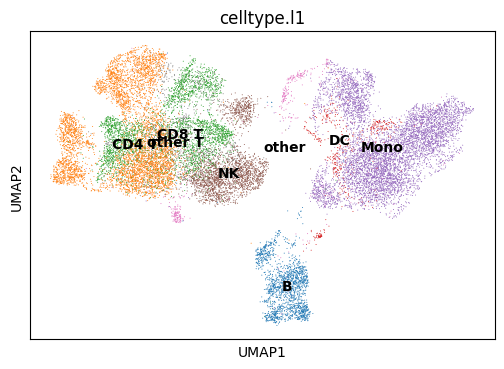

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


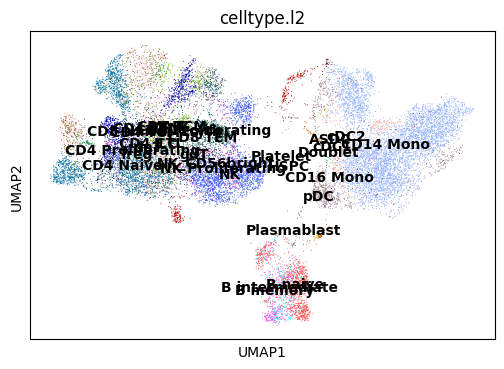

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


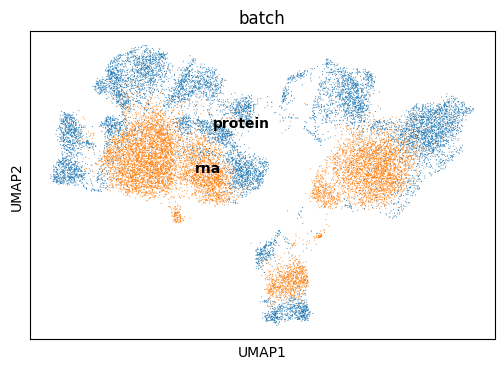

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


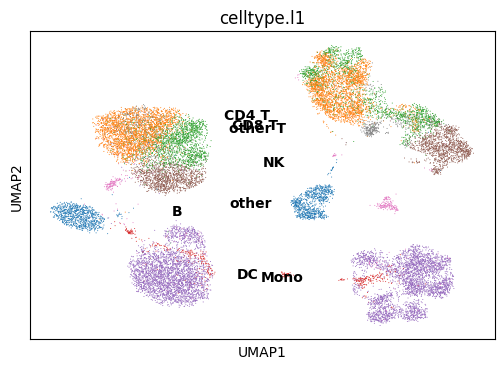

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


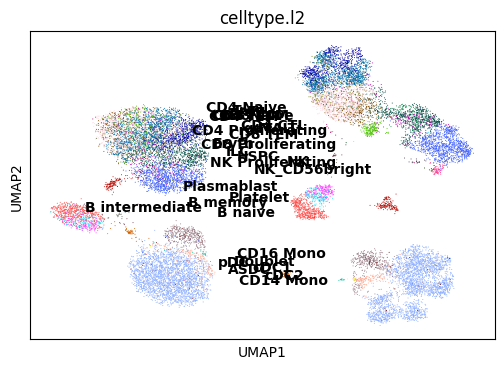

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


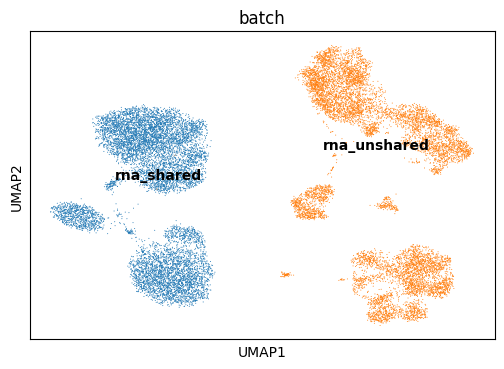

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


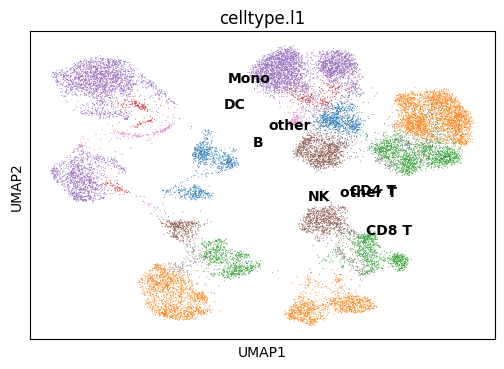

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


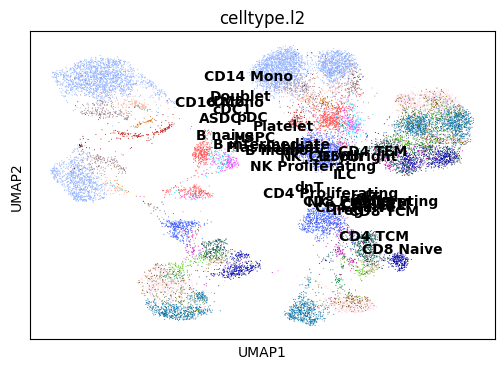

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


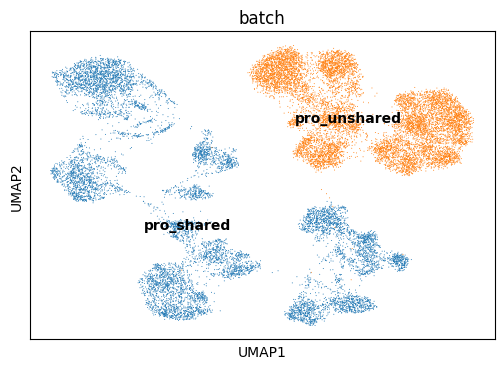

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For All matchings: lv1 matching acc: 0.746,
lv2 matching acc: 0.558.
For All matchings: FOSCTTM score: 0.23356113, 
Knn Alignment score: [0.0018 0.0025 0.0038 0.0048 0.006  0.0067 0.0075 0.0082 0.0094 0.0107
 0.0119 0.0124 0.0133 0.0142 0.0152 0.0162 0.0176 0.0182 0.0193 0.0202
 0.0209 0.0213 0.0223 0.0231 0.0239]
For All matchings: Silhouette F1 score for lv1: 0.508339746610954, 
Silhouette F1 score for lv2: 0.4950875856495781



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  3.3812609910964966
Matchings are reduced to 5000 after filtering...


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:423: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[matchings[0]], labels_l1[matchings[1]])
C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For only filtered matchings: lv1 matching acc: 0.831,
lv2 matching acc: 0.639.



Matches are being propagated....


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:460: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[filtered_matchings[0]], labels_l1[filtered_matchings[1]])


Done!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For all matchings after propagation: lv1 matching acc: 0.767,
lv2 matching acc: 0.561.


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:495: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[propagated_matchings[0]], labels_l1[propagated_matchings[1]])


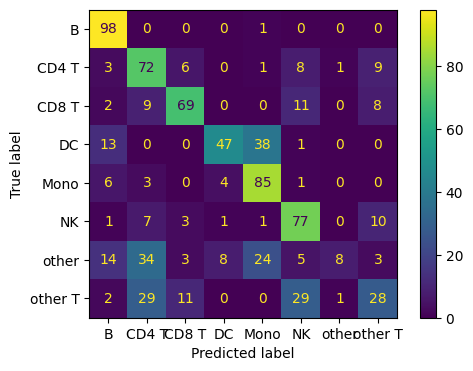

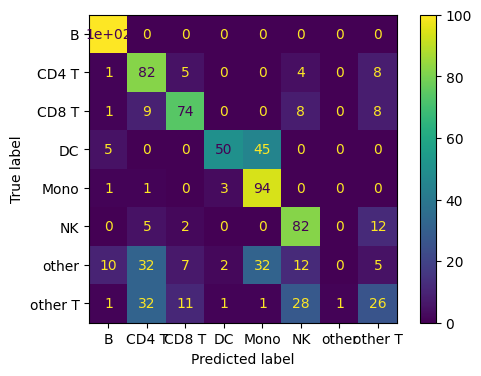

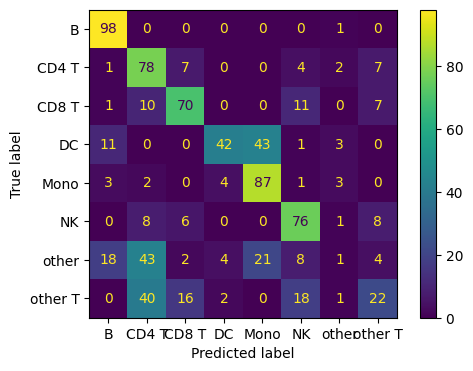

Epoch: 1301: 0it [00:00, ?it/s]C:\Users\vinee\AppData\Local\Temp\ipykernel_2144\3129631169.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return {"x_unshared":self.unshared_data[idx], "x_shared":self.shared_data[idx], "l1":self.labels_l1[idx], "l2":self.labels_l2[idx], "mean": self.local_mean[idx], "var": self.local_var[idx], "batch": self.batch[idx]}
Epoch: 1301: 40it [00:15,  2.52it/s]


RNA Recon Loss: 1.9924, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4210, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8270, Protein KL Div Z: 0.6207, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5284, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7945 Cross Loss Protein: 0.5389


Epoch: 1302: 40it [00:14,  2.74it/s]


RNA Recon Loss: 1.9979, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4208, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8268, Protein KL Div Z: 0.6210, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5290, Shared Recon Loss Gene: 0.2579, Shared Recon Loss Protein: 1.7974 Cross Loss Protein: 0.5397


Epoch: 1303: 40it [00:15,  2.54it/s]


RNA Recon Loss: 1.9929, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4206, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8286, Protein KL Div Z: 0.6210, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5285, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7980 Cross Loss Protein: 0.5404


Epoch: 1304: 40it [00:14,  2.67it/s]


RNA Recon Loss: 1.9917, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4213, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8283, Protein KL Div Z: 0.6214, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5297, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7943 Cross Loss Protein: 0.5396


Epoch: 1305: 40it [00:15,  2.55it/s]


RNA Recon Loss: 1.9913, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4203, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8278, Protein KL Div Z: 0.6206, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5291, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7955 Cross Loss Protein: 0.5395


Epoch: 1306: 40it [00:14,  2.75it/s]


RNA Recon Loss: 1.9988, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4207, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8284, Protein KL Div Z: 0.6213, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5298, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7983 Cross Loss Protein: 0.5402


Epoch: 1307: 40it [00:15,  2.55it/s]


RNA Recon Loss: 1.9945, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4213, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8293, Protein KL Div Z: 0.6222, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5293, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7949 Cross Loss Protein: 0.5395


Epoch: 1308: 40it [00:15,  2.64it/s]


RNA Recon Loss: 1.9936, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4208, Protein Recon Loss: 0.4866, Protein KL Div Back Pro: 0.8277, Protein KL Div Z: 0.6210, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5292, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7975 Cross Loss Protein: 0.5402


Epoch: 1309: 40it [00:15,  2.60it/s]


RNA Recon Loss: 1.9873, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4210, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8298, Protein KL Div Z: 0.6215, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5292, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7950 Cross Loss Protein: 0.5399


Epoch: 1310: 40it [00:14,  2.69it/s]


RNA Recon Loss: 1.9944, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4210, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8289, Protein KL Div Z: 0.6208, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5289, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7978 Cross Loss Protein: 0.5401


Epoch: 1311: 40it [00:15,  2.57it/s]


RNA Recon Loss: 2.0044, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4211, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8285, Protein KL Div Z: 0.6224, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5301, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7941 Cross Loss Protein: 0.5394


Epoch: 1312: 40it [00:15,  2.61it/s]


RNA Recon Loss: 1.9930, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4214, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8273, Protein KL Div Z: 0.6214, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5294, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7967 Cross Loss Protein: 0.5396


Epoch: 1313: 40it [00:15,  2.59it/s]


RNA Recon Loss: 1.9911, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4211, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8286, Protein KL Div Z: 0.6223, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5291, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7927 Cross Loss Protein: 0.5399


Epoch: 1314: 40it [00:15,  2.59it/s]


RNA Recon Loss: 1.9945, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4209, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8264, Protein KL Div Z: 0.6227, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5287, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7949 Cross Loss Protein: 0.5397


Epoch: 1315: 40it [00:15,  2.61it/s]


RNA Recon Loss: 1.9886, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4208, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8261, Protein KL Div Z: 0.6217, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5291, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7950 Cross Loss Protein: 0.5393


Epoch: 1316: 40it [00:15,  2.62it/s]


RNA Recon Loss: 1.9967, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4207, Protein Recon Loss: 0.4866, Protein KL Div Back Pro: 0.8259, Protein KL Div Z: 0.6214, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5291, Shared Recon Loss Gene: 0.2577, Shared Recon Loss Protein: 1.7969 Cross Loss Protein: 0.5407


Epoch: 1317: 40it [00:15,  2.63it/s]


RNA Recon Loss: 1.9956, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4199, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8285, Protein KL Div Z: 0.6230, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5284, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7958 Cross Loss Protein: 0.5396


Epoch: 1318: 40it [00:15,  2.56it/s]


RNA Recon Loss: 1.9902, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4205, Protein Recon Loss: 0.4869, Protein KL Div Back Pro: 0.8276, Protein KL Div Z: 0.6214, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5289, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7983 Cross Loss Protein: 0.5408


Epoch: 1319: 40it [00:15,  2.66it/s]


RNA Recon Loss: 1.9895, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4209, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8276, Protein KL Div Z: 0.6214, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5288, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7955 Cross Loss Protein: 0.5396


Epoch: 1320: 40it [00:16,  2.47it/s]


RNA Recon Loss: 2.0041, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4207, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8271, Protein KL Div Z: 0.6227, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5294, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7960 Cross Loss Protein: 0.5402


Epoch: 1321: 40it [00:14,  2.72it/s]


RNA Recon Loss: 1.9974, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4207, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8266, Protein KL Div Z: 0.6220, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5294, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7984 Cross Loss Protein: 0.5405


Epoch: 1322: 40it [00:15,  2.51it/s]


RNA Recon Loss: 1.9957, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4208, Protein Recon Loss: 0.4863, Protein KL Div Back Pro: 0.8269, Protein KL Div Z: 0.6205, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5288, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7960 Cross Loss Protein: 0.5408


Epoch: 1323: 40it [00:14,  2.70it/s]


RNA Recon Loss: 1.9941, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4209, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8269, Protein KL Div Z: 0.6217, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5289, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7954 Cross Loss Protein: 0.5400


Epoch: 1324: 40it [00:15,  2.62it/s]


RNA Recon Loss: 1.9917, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4207, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8271, Protein KL Div Z: 0.6215, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5284, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7943 Cross Loss Protein: 0.5394


Epoch: 1325: 40it [00:13,  2.94it/s]


RNA Recon Loss: 1.9947, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4201, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8231, Protein KL Div Z: 0.6204, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5280, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7953 Cross Loss Protein: 0.5402


Epoch: 1326: 40it [00:13,  2.89it/s]


RNA Recon Loss: 1.9994, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4210, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8259, Protein KL Div Z: 0.6208, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5287, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7948 Cross Loss Protein: 0.5395


Epoch: 1327: 40it [00:15,  2.63it/s]


RNA Recon Loss: 1.9916, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4208, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8265, Protein KL Div Z: 0.6217, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5287, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7943 Cross Loss Protein: 0.5396


Epoch: 1328: 40it [00:13,  2.88it/s]


RNA Recon Loss: 1.9897, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4208, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8265, Protein KL Div Z: 0.6208, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5290, Shared Recon Loss Gene: 0.2562, Shared Recon Loss Protein: 1.7951 Cross Loss Protein: 0.5394


Epoch: 1329: 40it [00:14,  2.83it/s]


RNA Recon Loss: 1.9992, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4209, Protein Recon Loss: 0.4871, Protein KL Div Back Pro: 0.8250, Protein KL Div Z: 0.6209, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5289, Shared Recon Loss Gene: 0.2580, Shared Recon Loss Protein: 1.7987 Cross Loss Protein: 0.5405


Epoch: 1330: 40it [00:15,  2.66it/s]


RNA Recon Loss: 1.9950, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4215, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8279, Protein KL Div Z: 0.6219, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5283, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7963 Cross Loss Protein: 0.5399


Epoch: 1331: 40it [00:14,  2.73it/s]


RNA Recon Loss: 1.9966, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4206, Protein Recon Loss: 0.4845, Protein KL Div Back Pro: 0.8267, Protein KL Div Z: 0.6215, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5289, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7959 Cross Loss Protein: 0.5389


Epoch: 1332: 40it [00:13,  2.96it/s]


RNA Recon Loss: 1.9955, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4206, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8259, Protein KL Div Z: 0.6226, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5285, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7955 Cross Loss Protein: 0.5400


Epoch: 1333: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9899, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4204, Protein Recon Loss: 0.4863, Protein KL Div Back Pro: 0.8256, Protein KL Div Z: 0.6216, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5285, Shared Recon Loss Gene: 0.2562, Shared Recon Loss Protein: 1.8000 Cross Loss Protein: 0.5403


Epoch: 1334: 40it [00:12,  3.12it/s]


RNA Recon Loss: 1.9978, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4207, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8261, Protein KL Div Z: 0.6216, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5291, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7955 Cross Loss Protein: 0.5408


Epoch: 1335: 40it [00:12,  3.12it/s]


RNA Recon Loss: 1.9991, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4207, Protein Recon Loss: 0.4865, Protein KL Div Back Pro: 0.8277, Protein KL Div Z: 0.6210, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5292, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7976 Cross Loss Protein: 0.5407


Epoch: 1336: 40it [00:12,  3.09it/s]


RNA Recon Loss: 2.0032, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4208, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8257, Protein KL Div Z: 0.6221, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5287, Shared Recon Loss Gene: 0.2577, Shared Recon Loss Protein: 1.7943 Cross Loss Protein: 0.5393


Epoch: 1337: 40it [00:13,  3.02it/s]


RNA Recon Loss: 2.0033, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4211, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8249, Protein KL Div Z: 0.6208, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5280, Shared Recon Loss Gene: 0.2578, Shared Recon Loss Protein: 1.7945 Cross Loss Protein: 0.5397


Epoch: 1338: 40it [00:13,  2.96it/s]


RNA Recon Loss: 1.9992, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4203, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8236, Protein KL Div Z: 0.6218, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5289, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7948 Cross Loss Protein: 0.5394


Epoch: 1339: 40it [00:14,  2.69it/s]


RNA Recon Loss: 1.9958, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4209, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8249, Protein KL Div Z: 0.6212, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5285, Shared Recon Loss Gene: 0.2578, Shared Recon Loss Protein: 1.7953 Cross Loss Protein: 0.5402


Epoch: 1340: 40it [00:12,  3.22it/s]


RNA Recon Loss: 1.9897, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4202, Protein Recon Loss: 0.4869, Protein KL Div Back Pro: 0.8263, Protein KL Div Z: 0.6213, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5285, Shared Recon Loss Gene: 0.2556, Shared Recon Loss Protein: 1.8018 Cross Loss Protein: 0.5407


Epoch: 1341: 40it [00:11,  3.34it/s]


RNA Recon Loss: 1.9890, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4201, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8265, Protein KL Div Z: 0.6208, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5297, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7969 Cross Loss Protein: 0.5391


Epoch: 1342: 40it [00:12,  3.28it/s]


RNA Recon Loss: 1.9956, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4211, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8247, Protein KL Div Z: 0.6208, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5291, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7958 Cross Loss Protein: 0.5403


Epoch: 1343: 40it [00:12,  3.33it/s]


RNA Recon Loss: 1.9994, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4208, Protein Recon Loss: 0.4863, Protein KL Div Back Pro: 0.8263, Protein KL Div Z: 0.6229, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5290, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7968 Cross Loss Protein: 0.5408


Epoch: 1344: 40it [00:11,  3.34it/s]


RNA Recon Loss: 1.9911, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4205, Protein Recon Loss: 0.4869, Protein KL Div Back Pro: 0.8250, Protein KL Div Z: 0.6203, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5294, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.8008 Cross Loss Protein: 0.5404


Epoch: 1345: 40it [00:11,  3.34it/s]


RNA Recon Loss: 1.9935, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4210, Protein Recon Loss: 0.4866, Protein KL Div Back Pro: 0.8280, Protein KL Div Z: 0.6226, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5292, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7993 Cross Loss Protein: 0.5403


Epoch: 1346: 40it [00:12,  3.30it/s]


RNA Recon Loss: 1.9977, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4211, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8264, Protein KL Div Z: 0.6221, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5298, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7935 Cross Loss Protein: 0.5394


Epoch: 1347: 40it [00:12,  3.31it/s]


RNA Recon Loss: 1.9894, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4203, Protein Recon Loss: 0.4873, Protein KL Div Back Pro: 0.8258, Protein KL Div Z: 0.6204, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5291, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7986 Cross Loss Protein: 0.5409


Epoch: 1348: 40it [00:12,  3.32it/s]


RNA Recon Loss: 1.9934, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4204, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8279, Protein KL Div Z: 0.6210, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5290, Shared Recon Loss Gene: 0.2562, Shared Recon Loss Protein: 1.7952 Cross Loss Protein: 0.5396


Epoch: 1349: 40it [00:11,  3.35it/s]


RNA Recon Loss: 1.9933, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4203, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8257, Protein KL Div Z: 0.6211, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5292, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7957 Cross Loss Protein: 0.5394


Epoch: 1350: 40it [00:11,  3.38it/s]


RNA Recon Loss: 1.9899, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4200, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8256, Protein KL Div Z: 0.6228, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5291, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7971 Cross Loss Protein: 0.5400


Epoch: 1351: 40it [00:12,  3.26it/s]


RNA Recon Loss: 1.9920, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4212, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8265, Protein KL Div Z: 0.6228, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5286, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7964 Cross Loss Protein: 0.5399


Epoch: 1352: 40it [00:11,  3.34it/s]


RNA Recon Loss: 1.9974, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4207, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8252, Protein KL Div Z: 0.6200, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5288, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7952 Cross Loss Protein: 0.5400


Epoch: 1353: 40it [00:12,  3.18it/s]


RNA Recon Loss: 1.9914, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4208, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8266, Protein KL Div Z: 0.6211, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5291, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7949 Cross Loss Protein: 0.5402


Epoch: 1354: 40it [00:13,  2.91it/s]


RNA Recon Loss: 1.9961, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4208, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8256, Protein KL Div Z: 0.6220, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5291, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7957 Cross Loss Protein: 0.5395


Epoch: 1355: 40it [00:12,  3.31it/s]


RNA Recon Loss: 1.9929, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4202, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8258, Protein KL Div Z: 0.6216, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5288, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7953 Cross Loss Protein: 0.5398


Epoch: 1356: 40it [00:13,  2.98it/s]


RNA Recon Loss: 1.9948, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4205, Protein Recon Loss: 0.4880, Protein KL Div Back Pro: 0.8252, Protein KL Div Z: 0.6225, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5291, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7983 Cross Loss Protein: 0.5410


Epoch: 1357: 40it [00:12,  3.18it/s]


RNA Recon Loss: 1.9929, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4209, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8281, Protein KL Div Z: 0.6218, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5287, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7949 Cross Loss Protein: 0.5393


Epoch: 1358: 40it [00:12,  3.13it/s]


RNA Recon Loss: 1.9929, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4209, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8251, Protein KL Div Z: 0.6204, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5288, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7960 Cross Loss Protein: 0.5400


Epoch: 1359: 40it [00:12,  3.33it/s]


RNA Recon Loss: 1.9994, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4209, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8268, Protein KL Div Z: 0.6211, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5290, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7969 Cross Loss Protein: 0.5398


Epoch: 1360: 40it [00:12,  3.32it/s]


RNA Recon Loss: 1.9941, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4213, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8274, Protein KL Div Z: 0.6222, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5285, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7962 Cross Loss Protein: 0.5397


Epoch: 1361: 40it [00:11,  3.34it/s]


RNA Recon Loss: 1.9975, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4208, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8265, Protein KL Div Z: 0.6210, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5289, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7972 Cross Loss Protein: 0.5401


Epoch: 1362: 40it [00:12,  3.29it/s]


RNA Recon Loss: 1.9903, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4198, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8257, Protein KL Div Z: 0.6215, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5285, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7967 Cross Loss Protein: 0.5404


Epoch: 1363: 40it [00:12,  3.22it/s]


RNA Recon Loss: 1.9904, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4208, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8285, Protein KL Div Z: 0.6212, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5294, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7966 Cross Loss Protein: 0.5399


Epoch: 1364: 40it [00:12,  3.27it/s]


RNA Recon Loss: 1.9878, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4202, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8275, Protein KL Div Z: 0.6218, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5284, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7964 Cross Loss Protein: 0.5400


Epoch: 1365: 40it [00:12,  3.30it/s]


RNA Recon Loss: 2.0033, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4205, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8261, Protein KL Div Z: 0.6214, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5287, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7961 Cross Loss Protein: 0.5411


Epoch: 1366: 40it [00:12,  3.22it/s]


RNA Recon Loss: 1.9914, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4201, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8300, Protein KL Div Z: 0.6235, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5291, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7950 Cross Loss Protein: 0.5404


Epoch: 1367: 40it [00:12,  3.31it/s]


RNA Recon Loss: 1.9935, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4202, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8276, Protein KL Div Z: 0.6217, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5288, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7956 Cross Loss Protein: 0.5404


Epoch: 1368: 40it [00:12,  3.29it/s]


RNA Recon Loss: 1.9999, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4210, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8270, Protein KL Div Z: 0.6221, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5293, Shared Recon Loss Gene: 0.2578, Shared Recon Loss Protein: 1.7958 Cross Loss Protein: 0.5395


Epoch: 1369: 40it [00:12,  3.29it/s]


RNA Recon Loss: 1.9895, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4213, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8269, Protein KL Div Z: 0.6214, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5285, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7951 Cross Loss Protein: 0.5401


Epoch: 1370: 40it [00:12,  3.29it/s]


RNA Recon Loss: 1.9930, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4207, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8295, Protein KL Div Z: 0.6223, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5286, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7958 Cross Loss Protein: 0.5402


Epoch: 1371: 40it [00:12,  3.20it/s]


RNA Recon Loss: 1.9927, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4208, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8271, Protein KL Div Z: 0.6211, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5290, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7945 Cross Loss Protein: 0.5396


Epoch: 1372: 40it [00:12,  3.25it/s]


RNA Recon Loss: 1.9918, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4203, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8270, Protein KL Div Z: 0.6224, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5286, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7950 Cross Loss Protein: 0.5396


Epoch: 1373: 40it [00:12,  3.27it/s]


RNA Recon Loss: 2.0003, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4203, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8264, Protein KL Div Z: 0.6227, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5285, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7945 Cross Loss Protein: 0.5401


Epoch: 1374: 40it [00:12,  3.26it/s]


RNA Recon Loss: 1.9995, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4208, Protein Recon Loss: 0.4866, Protein KL Div Back Pro: 0.8274, Protein KL Div Z: 0.6213, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5283, Shared Recon Loss Gene: 0.2578, Shared Recon Loss Protein: 1.8004 Cross Loss Protein: 0.5409


Epoch: 1375: 40it [00:12,  3.24it/s]


RNA Recon Loss: 1.9961, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4208, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8289, Protein KL Div Z: 0.6214, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5295, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7981 Cross Loss Protein: 0.5405


Epoch: 1376: 40it [00:12,  3.09it/s]


RNA Recon Loss: 1.9938, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4208, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8278, Protein KL Div Z: 0.6200, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5289, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7956 Cross Loss Protein: 0.5394


Epoch: 1377: 40it [00:12,  3.20it/s]


RNA Recon Loss: 1.9924, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4208, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8289, Protein KL Div Z: 0.6219, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5287, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7962 Cross Loss Protein: 0.5405


Epoch: 1378: 40it [00:12,  3.21it/s]


RNA Recon Loss: 2.0047, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4211, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8285, Protein KL Div Z: 0.6222, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5297, Shared Recon Loss Gene: 0.2579, Shared Recon Loss Protein: 1.7963 Cross Loss Protein: 0.5400


Epoch: 1379: 40it [00:12,  3.24it/s]


RNA Recon Loss: 1.9900, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4205, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8253, Protein KL Div Z: 0.6206, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5290, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7962 Cross Loss Protein: 0.5398


Epoch: 1380: 40it [00:12,  3.33it/s]


RNA Recon Loss: 1.9889, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4210, Protein Recon Loss: 0.4865, Protein KL Div Back Pro: 0.8289, Protein KL Div Z: 0.6227, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5290, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7985 Cross Loss Protein: 0.5406


Epoch: 1381: 40it [00:12,  3.20it/s]


RNA Recon Loss: 1.9974, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4206, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8278, Protein KL Div Z: 0.6224, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5285, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7963 Cross Loss Protein: 0.5397


Epoch: 1382: 40it [00:12,  3.17it/s]


RNA Recon Loss: 1.9997, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4199, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8276, Protein KL Div Z: 0.6217, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5284, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7954 Cross Loss Protein: 0.5396


Epoch: 1383: 40it [00:12,  3.25it/s]


RNA Recon Loss: 1.9992, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4204, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8275, Protein KL Div Z: 0.6224, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5288, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7962 Cross Loss Protein: 0.5399


Epoch: 1384: 40it [00:12,  3.18it/s]


RNA Recon Loss: 1.9869, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4209, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8291, Protein KL Div Z: 0.6212, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5288, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7944 Cross Loss Protein: 0.5394


Epoch: 1385: 40it [00:12,  3.16it/s]


RNA Recon Loss: 1.9877, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4201, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8276, Protein KL Div Z: 0.6216, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5283, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7941 Cross Loss Protein: 0.5398


Epoch: 1386: 40it [00:12,  3.19it/s]


RNA Recon Loss: 1.9868, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4204, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8302, Protein KL Div Z: 0.6239, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5292, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7980 Cross Loss Protein: 0.5397


Epoch: 1387: 40it [00:12,  3.25it/s]


RNA Recon Loss: 1.9899, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4201, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8284, Protein KL Div Z: 0.6225, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5290, Shared Recon Loss Gene: 0.2561, Shared Recon Loss Protein: 1.7968 Cross Loss Protein: 0.5398


Epoch: 1388: 40it [00:12,  3.20it/s]


RNA Recon Loss: 1.9904, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4197, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8255, Protein KL Div Z: 0.6218, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5281, Shared Recon Loss Gene: 0.2562, Shared Recon Loss Protein: 1.7952 Cross Loss Protein: 0.5393


Epoch: 1389: 40it [00:12,  3.26it/s]


RNA Recon Loss: 1.9937, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4201, Protein Recon Loss: 0.4863, Protein KL Div Back Pro: 0.8247, Protein KL Div Z: 0.6213, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5290, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7942 Cross Loss Protein: 0.5401


Epoch: 1390: 40it [00:12,  3.18it/s]


RNA Recon Loss: 2.0053, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4206, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8311, Protein KL Div Z: 0.6232, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5288, Shared Recon Loss Gene: 0.2580, Shared Recon Loss Protein: 1.7948 Cross Loss Protein: 0.5397


Epoch: 1391: 40it [00:12,  3.21it/s]


RNA Recon Loss: 1.9885, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4203, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8276, Protein KL Div Z: 0.6224, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5290, Shared Recon Loss Gene: 0.2560, Shared Recon Loss Protein: 1.7954 Cross Loss Protein: 0.5396


Epoch: 1392: 40it [00:12,  3.30it/s]


RNA Recon Loss: 1.9881, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4203, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8283, Protein KL Div Z: 0.6228, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5283, Shared Recon Loss Gene: 0.2559, Shared Recon Loss Protein: 1.7925 Cross Loss Protein: 0.5393


Epoch: 1393: 40it [00:11,  3.35it/s]


RNA Recon Loss: 1.9930, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4202, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8268, Protein KL Div Z: 0.6214, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5289, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7950 Cross Loss Protein: 0.5394


Epoch: 1394: 40it [00:12,  3.28it/s]


RNA Recon Loss: 1.9949, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4202, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8283, Protein KL Div Z: 0.6231, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5286, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7972 Cross Loss Protein: 0.5402


Epoch: 1395: 40it [00:12,  3.26it/s]


RNA Recon Loss: 1.9910, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4201, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8277, Protein KL Div Z: 0.6223, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5283, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7941 Cross Loss Protein: 0.5398


Epoch: 1396: 40it [00:12,  3.31it/s]


RNA Recon Loss: 1.9894, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4202, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8292, Protein KL Div Z: 0.6231, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5288, Shared Recon Loss Gene: 0.2562, Shared Recon Loss Protein: 1.7945 Cross Loss Protein: 0.5394


Epoch: 1397: 40it [00:12,  3.33it/s]


RNA Recon Loss: 2.0019, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4201, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8281, Protein KL Div Z: 0.6218, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5286, Shared Recon Loss Gene: 0.2580, Shared Recon Loss Protein: 1.7973 Cross Loss Protein: 0.5405


Epoch: 1398: 40it [00:12,  3.32it/s]


RNA Recon Loss: 1.9922, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4201, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8295, Protein KL Div Z: 0.6229, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5289, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7955 Cross Loss Protein: 0.5395


Epoch: 1399: 40it [00:12,  3.32it/s]


RNA Recon Loss: 1.9936, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4208, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8290, Protein KL Div Z: 0.6224, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5287, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7953 Cross Loss Protein: 0.5396


Epoch: 1400: 40it [00:11,  3.37it/s]


RNA Recon Loss: 1.9933, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4202, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8277, Protein KL Div Z: 0.6228, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5285, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7956 Cross Loss Protein: 0.5400


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


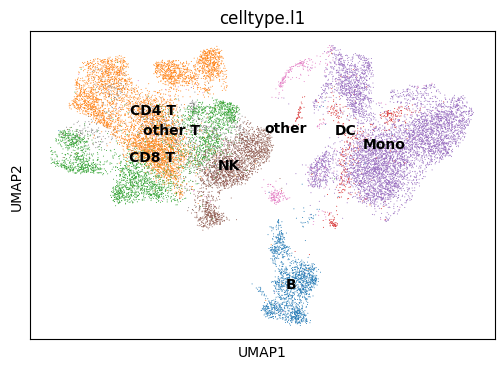

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


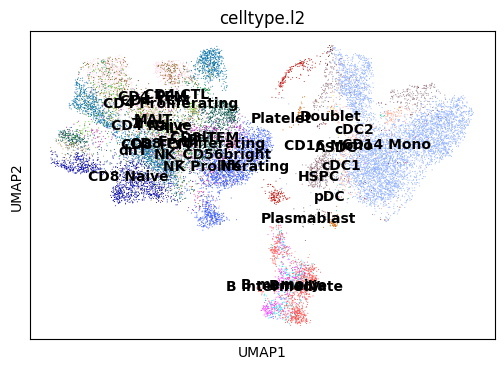

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


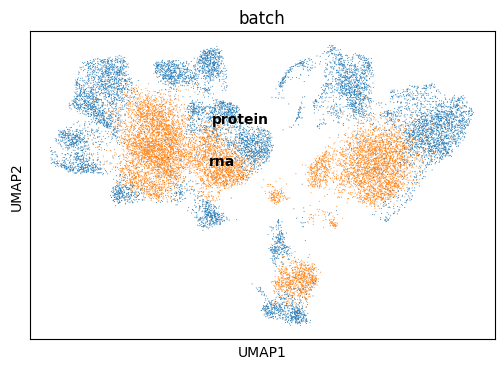

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


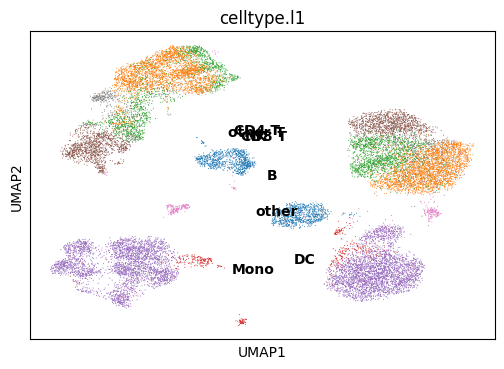

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


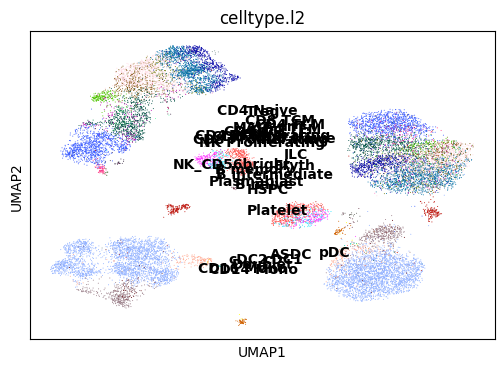

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


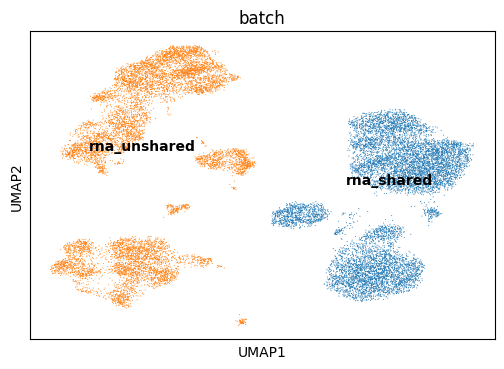

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


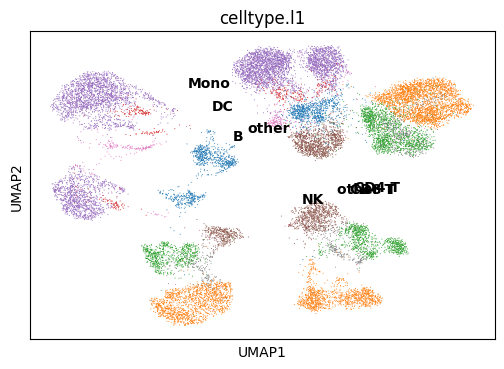

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


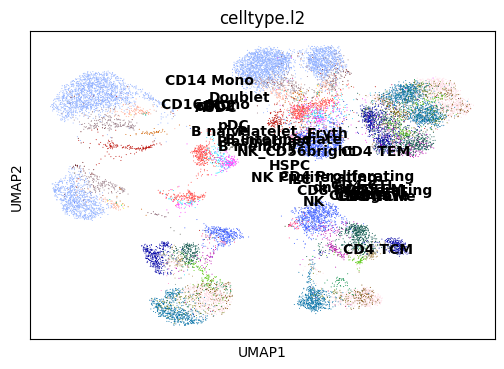

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


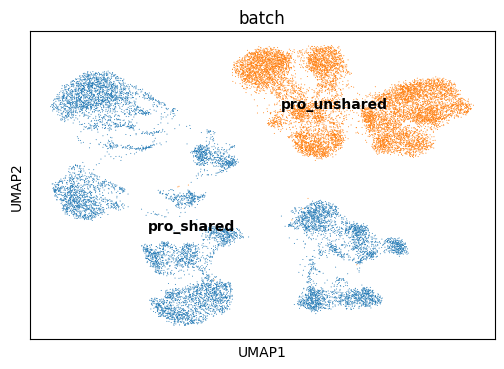

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For All matchings: lv1 matching acc: 0.749,
lv2 matching acc: 0.559.
For All matchings: FOSCTTM score: 0.23328433, 
Knn Alignment score: [0.0013 0.0023 0.0036 0.005  0.0055 0.0069 0.0079 0.0088 0.01   0.0107
 0.012  0.0131 0.0148 0.0156 0.0166 0.0179 0.0183 0.0194 0.02   0.0213
 0.0222 0.0234 0.0244 0.025  0.0262]
For All matchings: Silhouette F1 score for lv1: 0.5085706245685154, 
Silhouette F1 score for lv2: 0.4951765837458698



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  3.390742540359497
Matchings are reduced to 5000 after filtering...


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:423: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[matchings[0]], labels_l1[matchings[1]])
C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For only filtered matchings: lv1 matching acc: 0.837,
lv2 matching acc: 0.638.



Matches are being propagated....


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:460: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[filtered_matchings[0]], labels_l1[filtered_matchings[1]])


Done!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For all matchings after propagation: lv1 matching acc: 0.778,
lv2 matching acc: 0.564.


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:495: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[propagated_matchings[0]], labels_l1[propagated_matchings[1]])


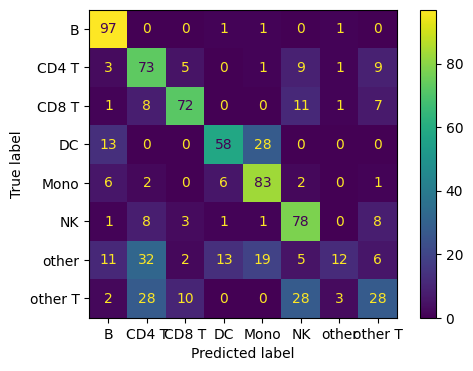

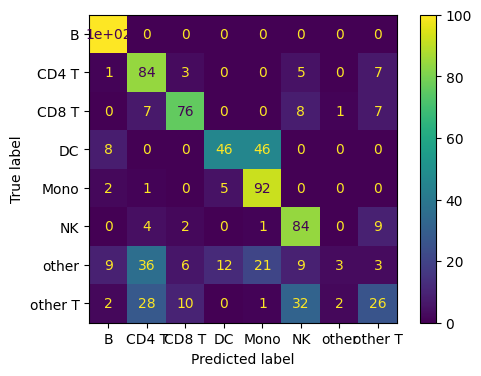

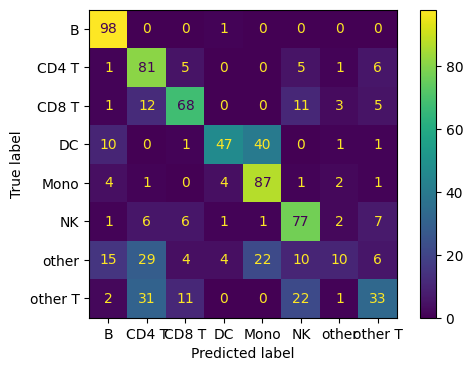

Epoch: 1401: 0it [00:00, ?it/s]C:\Users\vinee\AppData\Local\Temp\ipykernel_2144\3129631169.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return {"x_unshared":self.unshared_data[idx], "x_shared":self.shared_data[idx], "l1":self.labels_l1[idx], "l2":self.labels_l2[idx], "mean": self.local_mean[idx], "var": self.local_var[idx], "batch": self.batch[idx]}
Epoch: 1401: 40it [00:11,  3.39it/s]


RNA Recon Loss: 1.9969, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4200, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8276, Protein KL Div Z: 0.6213, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5286, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7957 Cross Loss Protein: 0.5395


Epoch: 1402: 40it [00:11,  3.39it/s]


RNA Recon Loss: 1.9961, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4204, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8285, Protein KL Div Z: 0.6236, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5287, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7956 Cross Loss Protein: 0.5401


Epoch: 1403: 40it [00:12,  3.31it/s]


RNA Recon Loss: 1.9984, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4199, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8285, Protein KL Div Z: 0.6222, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5284, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7968 Cross Loss Protein: 0.5405


Epoch: 1404: 40it [00:11,  3.37it/s]


RNA Recon Loss: 1.9924, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4205, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8292, Protein KL Div Z: 0.6221, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5283, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7954 Cross Loss Protein: 0.5393


Epoch: 1405: 40it [00:12,  3.31it/s]


RNA Recon Loss: 1.9896, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4206, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8291, Protein KL Div Z: 0.6230, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5282, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7949 Cross Loss Protein: 0.5394


Epoch: 1406: 40it [00:12,  3.32it/s]


RNA Recon Loss: 1.9886, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4202, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8270, Protein KL Div Z: 0.6231, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5280, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7955 Cross Loss Protein: 0.5398


Epoch: 1407: 40it [00:12,  3.23it/s]


RNA Recon Loss: 1.9950, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4200, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8296, Protein KL Div Z: 0.6225, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5288, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7957 Cross Loss Protein: 0.5400


Epoch: 1408: 40it [00:12,  3.18it/s]


RNA Recon Loss: 1.9966, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4210, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8274, Protein KL Div Z: 0.6224, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5283, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7955 Cross Loss Protein: 0.5393


Epoch: 1409: 40it [00:12,  3.32it/s]


RNA Recon Loss: 1.9914, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4199, Protein Recon Loss: 0.4863, Protein KL Div Back Pro: 0.8285, Protein KL Div Z: 0.6238, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5283, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7953 Cross Loss Protein: 0.5403


Epoch: 1410: 40it [00:12,  3.29it/s]


RNA Recon Loss: 1.9885, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4199, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8274, Protein KL Div Z: 0.6214, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5281, Shared Recon Loss Gene: 0.2561, Shared Recon Loss Protein: 1.7949 Cross Loss Protein: 0.5395


Epoch: 1411: 40it [00:12,  3.31it/s]


RNA Recon Loss: 1.9965, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4205, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8269, Protein KL Div Z: 0.6214, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5282, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7952 Cross Loss Protein: 0.5392


Epoch: 1412: 40it [00:12,  3.19it/s]


RNA Recon Loss: 1.9899, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4204, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8265, Protein KL Div Z: 0.6211, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5286, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7930 Cross Loss Protein: 0.5397


Epoch: 1413: 40it [00:12,  3.27it/s]


RNA Recon Loss: 1.9926, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4204, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8272, Protein KL Div Z: 0.6223, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5278, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7942 Cross Loss Protein: 0.5398


Epoch: 1414: 40it [00:11,  3.35it/s]


RNA Recon Loss: 1.9912, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4201, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8236, Protein KL Div Z: 0.6205, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5273, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7966 Cross Loss Protein: 0.5399


Epoch: 1415: 40it [00:11,  3.35it/s]


RNA Recon Loss: 1.9916, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4206, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8268, Protein KL Div Z: 0.6235, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5280, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7972 Cross Loss Protein: 0.5396


Epoch: 1416: 40it [00:13,  3.03it/s]


RNA Recon Loss: 1.9910, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4204, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8280, Protein KL Div Z: 0.6218, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5286, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7970 Cross Loss Protein: 0.5397


Epoch: 1417: 40it [00:12,  3.23it/s]


RNA Recon Loss: 1.9886, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4201, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8264, Protein KL Div Z: 0.6236, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5279, Shared Recon Loss Gene: 0.2561, Shared Recon Loss Protein: 1.7971 Cross Loss Protein: 0.5402


Epoch: 1418: 40it [00:12,  3.31it/s]


RNA Recon Loss: 1.9911, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4199, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8270, Protein KL Div Z: 0.6231, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5286, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7952 Cross Loss Protein: 0.5399


Epoch: 1419: 40it [00:11,  3.34it/s]


RNA Recon Loss: 1.9905, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4202, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8263, Protein KL Div Z: 0.6223, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5285, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7957 Cross Loss Protein: 0.5396


Epoch: 1420: 40it [00:11,  3.37it/s]


RNA Recon Loss: 1.9953, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4199, Protein Recon Loss: 0.4868, Protein KL Div Back Pro: 0.8246, Protein KL Div Z: 0.6227, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5283, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7992 Cross Loss Protein: 0.5409


Epoch: 1421: 40it [00:12,  3.27it/s]


RNA Recon Loss: 1.9919, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4207, Protein Recon Loss: 0.4870, Protein KL Div Back Pro: 0.8288, Protein KL Div Z: 0.6229, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5282, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7952 Cross Loss Protein: 0.5399


Epoch: 1422: 40it [00:12,  3.31it/s]


RNA Recon Loss: 1.9932, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4208, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8283, Protein KL Div Z: 0.6238, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5282, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7946 Cross Loss Protein: 0.5404


Epoch: 1423: 40it [00:12,  3.25it/s]


RNA Recon Loss: 1.9963, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4208, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8290, Protein KL Div Z: 0.6230, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5283, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7946 Cross Loss Protein: 0.5400


Epoch: 1424: 40it [00:12,  3.25it/s]


RNA Recon Loss: 1.9913, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4201, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8272, Protein KL Div Z: 0.6221, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5284, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7945 Cross Loss Protein: 0.5394


Epoch: 1425: 40it [00:12,  3.29it/s]


RNA Recon Loss: 1.9895, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4203, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8256, Protein KL Div Z: 0.6216, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5283, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7990 Cross Loss Protein: 0.5401


Epoch: 1426: 40it [00:11,  3.36it/s]


RNA Recon Loss: 1.9951, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4205, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8264, Protein KL Div Z: 0.6218, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5286, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7963 Cross Loss Protein: 0.5407


Epoch: 1427: 40it [00:12,  3.29it/s]


RNA Recon Loss: 1.9945, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4206, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8268, Protein KL Div Z: 0.6232, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5279, Shared Recon Loss Gene: 0.2578, Shared Recon Loss Protein: 1.7965 Cross Loss Protein: 0.5400


Epoch: 1428: 40it [00:12,  3.28it/s]


RNA Recon Loss: 1.9900, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4200, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8257, Protein KL Div Z: 0.6212, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5287, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7965 Cross Loss Protein: 0.5399


Epoch: 1429: 40it [00:12,  3.28it/s]


RNA Recon Loss: 1.9951, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4206, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8267, Protein KL Div Z: 0.6230, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5275, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7950 Cross Loss Protein: 0.5400


Epoch: 1430: 40it [00:12,  3.28it/s]


RNA Recon Loss: 1.9932, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4202, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8274, Protein KL Div Z: 0.6225, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5290, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7951 Cross Loss Protein: 0.5399


Epoch: 1431: 40it [00:12,  3.32it/s]


RNA Recon Loss: 1.9930, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4202, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8262, Protein KL Div Z: 0.6222, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5280, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7967 Cross Loss Protein: 0.5403


Epoch: 1432: 40it [00:12,  3.26it/s]


RNA Recon Loss: 1.9908, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4198, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8276, Protein KL Div Z: 0.6232, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5283, Shared Recon Loss Gene: 0.2562, Shared Recon Loss Protein: 1.7952 Cross Loss Protein: 0.5401


Epoch: 1433: 40it [00:12,  3.25it/s]


RNA Recon Loss: 1.9939, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4204, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8253, Protein KL Div Z: 0.6230, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5280, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7941 Cross Loss Protein: 0.5397


Epoch: 1434: 40it [00:12,  3.27it/s]


RNA Recon Loss: 1.9935, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4205, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8266, Protein KL Div Z: 0.6226, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5288, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7962 Cross Loss Protein: 0.5407


Epoch: 1435: 40it [00:12,  3.22it/s]


RNA Recon Loss: 1.9941, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4206, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8263, Protein KL Div Z: 0.6220, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5285, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7964 Cross Loss Protein: 0.5395


Epoch: 1436: 40it [00:12,  3.08it/s]


RNA Recon Loss: 1.9957, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4198, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8285, Protein KL Div Z: 0.6231, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5289, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7946 Cross Loss Protein: 0.5394


Epoch: 1437: 40it [00:13,  3.00it/s]


RNA Recon Loss: 1.9947, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4202, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8270, Protein KL Div Z: 0.6231, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5287, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7957 Cross Loss Protein: 0.5395


Epoch: 1438: 40it [00:12,  3.22it/s]


RNA Recon Loss: 1.9939, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4206, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8261, Protein KL Div Z: 0.6221, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5284, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7956 Cross Loss Protein: 0.5400


Epoch: 1439: 40it [00:12,  3.30it/s]


RNA Recon Loss: 1.9899, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4202, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8241, Protein KL Div Z: 0.6226, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5285, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7979 Cross Loss Protein: 0.5400


Epoch: 1440: 40it [00:12,  3.29it/s]


RNA Recon Loss: 2.0018, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4205, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8300, Protein KL Div Z: 0.6242, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5290, Shared Recon Loss Gene: 0.2577, Shared Recon Loss Protein: 1.7958 Cross Loss Protein: 0.5399


Epoch: 1441: 40it [00:12,  3.25it/s]


RNA Recon Loss: 1.9937, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4202, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8256, Protein KL Div Z: 0.6228, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5291, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7957 Cross Loss Protein: 0.5395


Epoch: 1442: 40it [00:12,  3.24it/s]


RNA Recon Loss: 1.9890, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4201, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8267, Protein KL Div Z: 0.6225, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5284, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7965 Cross Loss Protein: 0.5400


Epoch: 1443: 40it [00:12,  3.33it/s]


RNA Recon Loss: 1.9976, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4207, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8269, Protein KL Div Z: 0.6219, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5286, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7959 Cross Loss Protein: 0.5397


Epoch: 1444: 40it [00:12,  3.22it/s]


RNA Recon Loss: 2.0006, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4202, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8258, Protein KL Div Z: 0.6225, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5282, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7972 Cross Loss Protein: 0.5402


Epoch: 1445: 40it [00:12,  3.25it/s]


RNA Recon Loss: 1.9945, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4202, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8270, Protein KL Div Z: 0.6237, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5287, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7950 Cross Loss Protein: 0.5394


Epoch: 1446: 40it [00:12,  3.13it/s]


RNA Recon Loss: 1.9921, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4203, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8273, Protein KL Div Z: 0.6229, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5284, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7970 Cross Loss Protein: 0.5408


Epoch: 1447: 40it [00:12,  3.25it/s]


RNA Recon Loss: 2.0000, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4206, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8286, Protein KL Div Z: 0.6227, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5282, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7944 Cross Loss Protein: 0.5399


Epoch: 1448: 40it [00:12,  3.33it/s]


RNA Recon Loss: 1.9945, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4199, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8274, Protein KL Div Z: 0.6228, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5285, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7948 Cross Loss Protein: 0.5395


Epoch: 1449: 40it [00:12,  3.26it/s]


RNA Recon Loss: 1.9895, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4197, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8273, Protein KL Div Z: 0.6226, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5281, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7975 Cross Loss Protein: 0.5400


Epoch: 1450: 40it [00:12,  3.23it/s]


RNA Recon Loss: 1.9949, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4197, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8259, Protein KL Div Z: 0.6219, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5271, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7939 Cross Loss Protein: 0.5395


Epoch: 1451: 40it [00:12,  3.22it/s]


RNA Recon Loss: 1.9892, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4202, Protein Recon Loss: 0.4865, Protein KL Div Back Pro: 0.8270, Protein KL Div Z: 0.6228, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5277, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7972 Cross Loss Protein: 0.5406


Epoch: 1452: 40it [00:12,  3.19it/s]


RNA Recon Loss: 1.9984, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4203, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8273, Protein KL Div Z: 0.6219, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5278, Shared Recon Loss Gene: 0.2579, Shared Recon Loss Protein: 1.7972 Cross Loss Protein: 0.5400


Epoch: 1453: 40it [00:12,  3.15it/s]


RNA Recon Loss: 2.0003, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4198, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8274, Protein KL Div Z: 0.6230, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5279, Shared Recon Loss Gene: 0.2584, Shared Recon Loss Protein: 1.7967 Cross Loss Protein: 0.5399


Epoch: 1454: 40it [00:12,  3.29it/s]


RNA Recon Loss: 1.9946, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4208, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8277, Protein KL Div Z: 0.6226, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5279, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7951 Cross Loss Protein: 0.5404


Epoch: 1455: 40it [00:12,  3.24it/s]


RNA Recon Loss: 1.9895, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4191, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8271, Protein KL Div Z: 0.6230, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5279, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7962 Cross Loss Protein: 0.5401


Epoch: 1456: 40it [00:13,  3.05it/s]


RNA Recon Loss: 1.9906, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4203, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8264, Protein KL Div Z: 0.6214, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5279, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7969 Cross Loss Protein: 0.5397


Epoch: 1457: 40it [00:13,  3.05it/s]


RNA Recon Loss: 1.9911, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4204, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8284, Protein KL Div Z: 0.6226, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5280, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7958 Cross Loss Protein: 0.5396


Epoch: 1458: 40it [00:14,  2.69it/s]


RNA Recon Loss: 1.9865, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4201, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8257, Protein KL Div Z: 0.6226, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5274, Shared Recon Loss Gene: 0.2561, Shared Recon Loss Protein: 1.7948 Cross Loss Protein: 0.5401


Epoch: 1459: 40it [00:14,  2.77it/s]


RNA Recon Loss: 1.9937, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4202, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8271, Protein KL Div Z: 0.6228, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5281, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7962 Cross Loss Protein: 0.5403


Epoch: 1460: 40it [00:13,  2.86it/s]


RNA Recon Loss: 2.0024, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4202, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8274, Protein KL Div Z: 0.6218, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5282, Shared Recon Loss Gene: 0.2578, Shared Recon Loss Protein: 1.7941 Cross Loss Protein: 0.5394


Epoch: 1461: 40it [00:12,  3.30it/s]


RNA Recon Loss: 1.9987, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4202, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8287, Protein KL Div Z: 0.6235, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5275, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7966 Cross Loss Protein: 0.5396


Epoch: 1462: 40it [00:11,  3.38it/s]


RNA Recon Loss: 1.9920, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4202, Protein Recon Loss: 0.4879, Protein KL Div Back Pro: 0.8258, Protein KL Div Z: 0.6209, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5275, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7967 Cross Loss Protein: 0.5413


Epoch: 1463: 40it [00:12,  3.33it/s]


RNA Recon Loss: 1.9928, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4204, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8301, Protein KL Div Z: 0.6229, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5275, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7972 Cross Loss Protein: 0.5403


Epoch: 1464: 40it [00:12,  3.18it/s]


RNA Recon Loss: 1.9976, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4202, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8266, Protein KL Div Z: 0.6213, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5275, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7953 Cross Loss Protein: 0.5397


Epoch: 1465: 40it [00:12,  3.15it/s]


RNA Recon Loss: 1.9931, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4200, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8298, Protein KL Div Z: 0.6226, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5275, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7963 Cross Loss Protein: 0.5398


Epoch: 1466: 40it [00:13,  3.04it/s]


RNA Recon Loss: 1.9936, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4203, Protein Recon Loss: 0.4863, Protein KL Div Back Pro: 0.8275, Protein KL Div Z: 0.6220, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5275, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7983 Cross Loss Protein: 0.5400


Epoch: 1467: 40it [00:12,  3.23it/s]


RNA Recon Loss: 1.9912, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4201, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8233, Protein KL Div Z: 0.6209, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5275, Shared Recon Loss Gene: 0.2560, Shared Recon Loss Protein: 1.7966 Cross Loss Protein: 0.5396


Epoch: 1468: 40it [00:12,  3.18it/s]


RNA Recon Loss: 1.9875, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4200, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8278, Protein KL Div Z: 0.6227, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5273, Shared Recon Loss Gene: 0.2561, Shared Recon Loss Protein: 1.7962 Cross Loss Protein: 0.5400


Epoch: 1469: 40it [00:12,  3.15it/s]


RNA Recon Loss: 1.9930, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4198, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8285, Protein KL Div Z: 0.6245, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5276, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7941 Cross Loss Protein: 0.5398


Epoch: 1470: 40it [00:12,  3.31it/s]


RNA Recon Loss: 1.9874, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4198, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8255, Protein KL Div Z: 0.6227, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5279, Shared Recon Loss Gene: 0.2562, Shared Recon Loss Protein: 1.7951 Cross Loss Protein: 0.5395


Epoch: 1471: 40it [00:13,  3.07it/s]


RNA Recon Loss: 1.9889, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4200, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8272, Protein KL Div Z: 0.6236, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5276, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7980 Cross Loss Protein: 0.5403


Epoch: 1472: 40it [00:12,  3.25it/s]


RNA Recon Loss: 1.9915, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4199, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8269, Protein KL Div Z: 0.6226, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5284, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7948 Cross Loss Protein: 0.5396


Epoch: 1473: 40it [00:11,  3.34it/s]


RNA Recon Loss: 1.9975, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4201, Protein Recon Loss: 0.4867, Protein KL Div Back Pro: 0.8250, Protein KL Div Z: 0.6227, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5279, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7961 Cross Loss Protein: 0.5416


Epoch: 1474: 40it [00:12,  3.32it/s]


RNA Recon Loss: 1.9872, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4201, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8287, Protein KL Div Z: 0.6234, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5276, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7947 Cross Loss Protein: 0.5392


Epoch: 1475: 40it [00:15,  2.63it/s]


RNA Recon Loss: 1.9909, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4198, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8270, Protein KL Div Z: 0.6215, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5282, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7976 Cross Loss Protein: 0.5400


Epoch: 1476: 40it [00:12,  3.17it/s]


RNA Recon Loss: 1.9875, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4200, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8269, Protein KL Div Z: 0.6219, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5277, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7968 Cross Loss Protein: 0.5401


Epoch: 1477: 40it [00:12,  3.18it/s]


RNA Recon Loss: 1.9863, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4204, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8275, Protein KL Div Z: 0.6218, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5278, Shared Recon Loss Gene: 0.2560, Shared Recon Loss Protein: 1.7946 Cross Loss Protein: 0.5393


Epoch: 1478: 40it [00:13,  2.98it/s]


RNA Recon Loss: 1.9935, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4198, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8281, Protein KL Div Z: 0.6239, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5273, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7964 Cross Loss Protein: 0.5397


Epoch: 1479: 40it [00:12,  3.08it/s]


RNA Recon Loss: 1.9856, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4191, Protein Recon Loss: 0.4875, Protein KL Div Back Pro: 0.8276, Protein KL Div Z: 0.6227, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5277, Shared Recon Loss Gene: 0.2559, Shared Recon Loss Protein: 1.8018 Cross Loss Protein: 0.5406


Epoch: 1480: 40it [00:12,  3.19it/s]


RNA Recon Loss: 2.0002, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4196, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8295, Protein KL Div Z: 0.6234, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5281, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7981 Cross Loss Protein: 0.5407


Epoch: 1481: 40it [00:12,  3.10it/s]


RNA Recon Loss: 1.9916, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4199, Protein Recon Loss: 0.4848, Protein KL Div Back Pro: 0.8266, Protein KL Div Z: 0.6223, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5279, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7935 Cross Loss Protein: 0.5395


Epoch: 1482: 40it [00:13,  3.07it/s]


RNA Recon Loss: 1.9926, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4197, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8263, Protein KL Div Z: 0.6226, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5277, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7970 Cross Loss Protein: 0.5400


Epoch: 1483: 40it [00:12,  3.29it/s]


RNA Recon Loss: 1.9918, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4197, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8257, Protein KL Div Z: 0.6224, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5277, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7966 Cross Loss Protein: 0.5404


Epoch: 1484: 40it [00:12,  3.28it/s]


RNA Recon Loss: 2.0001, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4198, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8260, Protein KL Div Z: 0.6229, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5276, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7951 Cross Loss Protein: 0.5396


Epoch: 1485: 40it [00:12,  3.16it/s]


RNA Recon Loss: 1.9884, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4198, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8274, Protein KL Div Z: 0.6234, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5286, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7963 Cross Loss Protein: 0.5401


Epoch: 1486: 40it [00:13,  2.96it/s]


RNA Recon Loss: 1.9850, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4198, Protein Recon Loss: 0.4865, Protein KL Div Back Pro: 0.8278, Protein KL Div Z: 0.6232, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5277, Shared Recon Loss Gene: 0.2560, Shared Recon Loss Protein: 1.7956 Cross Loss Protein: 0.5405


Epoch: 1487: 40it [00:12,  3.15it/s]


RNA Recon Loss: 1.9985, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4201, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8262, Protein KL Div Z: 0.6227, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5278, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7962 Cross Loss Protein: 0.5395


Epoch: 1488: 40it [00:13,  2.97it/s]


RNA Recon Loss: 1.9939, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4202, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8260, Protein KL Div Z: 0.6223, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5283, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7972 Cross Loss Protein: 0.5401


Epoch: 1489: 40it [00:13,  3.00it/s]


RNA Recon Loss: 1.9915, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4199, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8290, Protein KL Div Z: 0.6246, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5278, Shared Recon Loss Gene: 0.2562, Shared Recon Loss Protein: 1.7958 Cross Loss Protein: 0.5393


Epoch: 1490: 40it [00:12,  3.18it/s]


RNA Recon Loss: 1.9929, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4203, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8260, Protein KL Div Z: 0.6226, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5275, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7959 Cross Loss Protein: 0.5391


Epoch: 1491: 40it [00:12,  3.20it/s]


RNA Recon Loss: 1.9935, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4201, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8261, Protein KL Div Z: 0.6235, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5272, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7949 Cross Loss Protein: 0.5392


Epoch: 1492: 40it [00:12,  3.13it/s]


RNA Recon Loss: 1.9898, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4199, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8253, Protein KL Div Z: 0.6216, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5278, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7980 Cross Loss Protein: 0.5402


Epoch: 1493: 40it [00:12,  3.11it/s]


RNA Recon Loss: 1.9887, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4198, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8258, Protein KL Div Z: 0.6225, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5276, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7935 Cross Loss Protein: 0.5393


Epoch: 1494: 40it [00:12,  3.12it/s]


RNA Recon Loss: 1.9961, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4202, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8267, Protein KL Div Z: 0.6218, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5270, Shared Recon Loss Gene: 0.2577, Shared Recon Loss Protein: 1.7997 Cross Loss Protein: 0.5398


Epoch: 1495: 40it [00:15,  2.61it/s]


RNA Recon Loss: 1.9888, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4197, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8276, Protein KL Div Z: 0.6229, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5282, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7940 Cross Loss Protein: 0.5391


Epoch: 1496: 40it [00:12,  3.20it/s]


RNA Recon Loss: 1.9872, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4197, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8251, Protein KL Div Z: 0.6212, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5276, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7997 Cross Loss Protein: 0.5403


Epoch: 1497: 40it [00:14,  2.84it/s]


RNA Recon Loss: 2.0051, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4196, Protein Recon Loss: 0.4865, Protein KL Div Back Pro: 0.8297, Protein KL Div Z: 0.6236, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5283, Shared Recon Loss Gene: 0.2586, Shared Recon Loss Protein: 1.7996 Cross Loss Protein: 0.5411


Epoch: 1498: 40it [00:13,  2.96it/s]


RNA Recon Loss: 1.9968, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4202, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8279, Protein KL Div Z: 0.6229, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5282, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7950 Cross Loss Protein: 0.5398


Epoch: 1499: 40it [00:13,  2.92it/s]


RNA Recon Loss: 1.9914, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4201, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8275, Protein KL Div Z: 0.6232, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5274, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7962 Cross Loss Protein: 0.5400


Epoch: 1500: 40it [00:12,  3.29it/s]


RNA Recon Loss: 1.9992, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4203, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8244, Protein KL Div Z: 0.6229, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5283, Shared Recon Loss Gene: 0.2577, Shared Recon Loss Protein: 1.7953 Cross Loss Protein: 0.5396


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


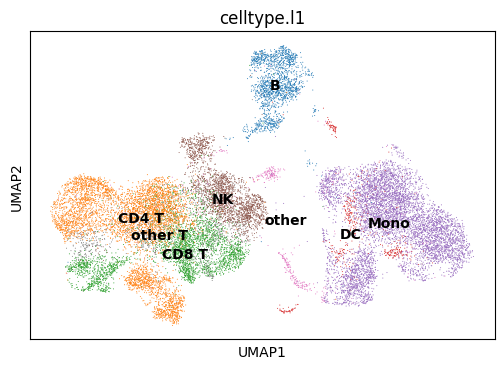

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


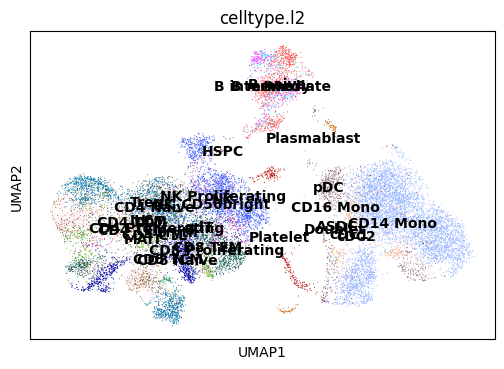

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


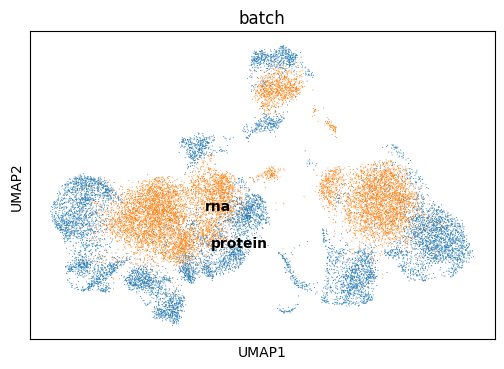

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


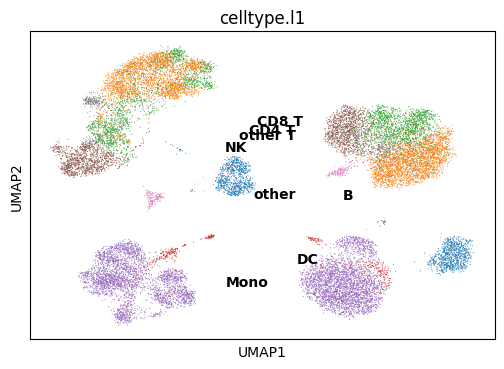

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


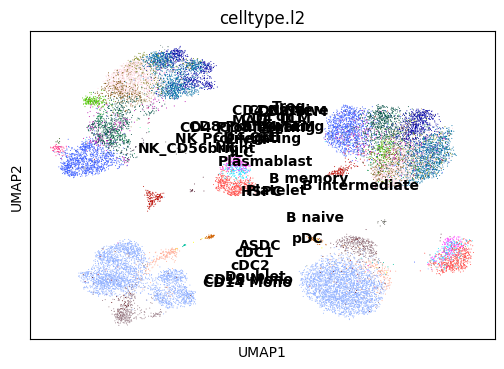

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


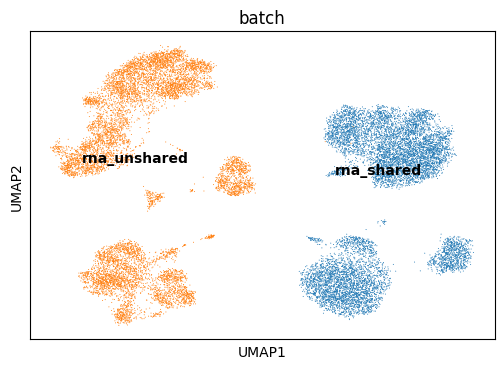

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


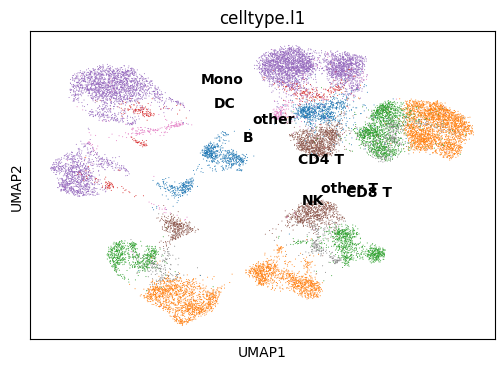

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


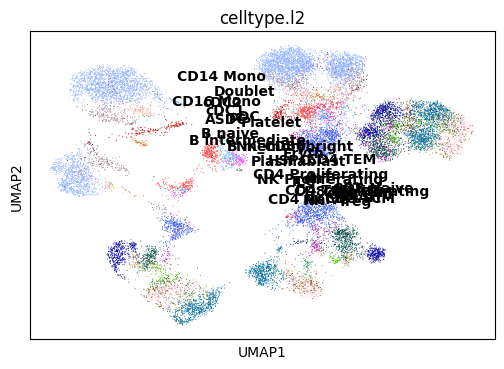

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


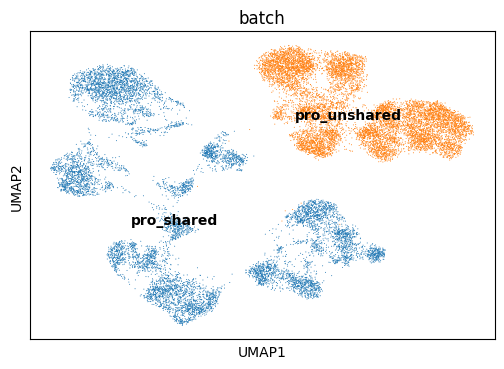

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For All matchings: lv1 matching acc: 0.739,
lv2 matching acc: 0.556.
For All matchings: FOSCTTM score: 0.23006005, 
Knn Alignment score: [0.0015 0.0028 0.0037 0.0041 0.005  0.0061 0.0074 0.0085 0.0096 0.0102
 0.0111 0.0117 0.0125 0.0132 0.0141 0.0143 0.0149 0.016  0.0167 0.0175
 0.0183 0.0192 0.0206 0.0219 0.0228]
For All matchings: Silhouette F1 score for lv1: 0.5094781353467441, 
Silhouette F1 score for lv2: 0.49613742786912884



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  3.368848204612732
Matchings are reduced to 5000 after filtering...


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:423: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[matchings[0]], labels_l1[matchings[1]])
C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For only filtered matchings: lv1 matching acc: 0.827,
lv2 matching acc: 0.640.



Matches are being propagated....


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:460: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[filtered_matchings[0]], labels_l1[filtered_matchings[1]])


Done!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For all matchings after propagation: lv1 matching acc: 0.764,
lv2 matching acc: 0.559.


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:495: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[propagated_matchings[0]], labels_l1[propagated_matchings[1]])


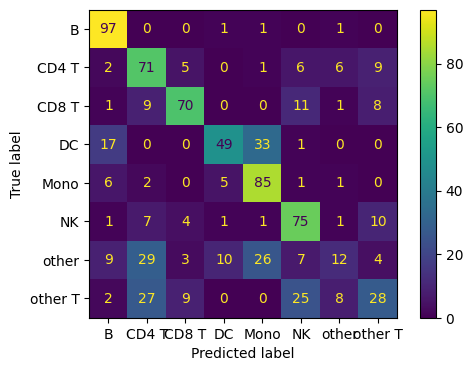

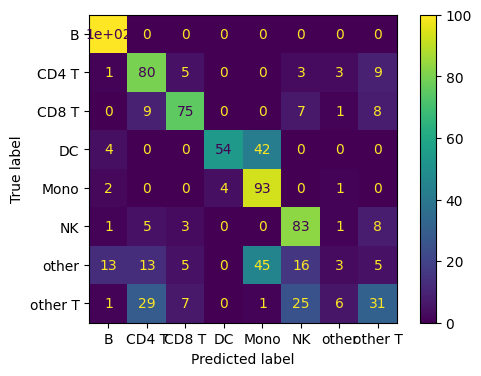

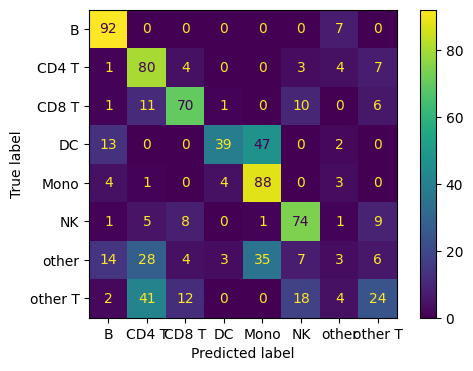

Epoch: 1501: 0it [00:00, ?it/s]C:\Users\vinee\AppData\Local\Temp\ipykernel_2144\3129631169.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return {"x_unshared":self.unshared_data[idx], "x_shared":self.shared_data[idx], "l1":self.labels_l1[idx], "l2":self.labels_l2[idx], "mean": self.local_mean[idx], "var": self.local_var[idx], "batch": self.batch[idx]}
Epoch: 1501: 40it [00:13,  3.07it/s]


RNA Recon Loss: 1.9944, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4201, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8254, Protein KL Div Z: 0.6239, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5276, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7962 Cross Loss Protein: 0.5401


Epoch: 1502: 40it [00:13,  3.06it/s]


RNA Recon Loss: 1.9934, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4202, Protein Recon Loss: 0.4849, Protein KL Div Back Pro: 0.8258, Protein KL Div Z: 0.6227, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5276, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7942 Cross Loss Protein: 0.5399


Epoch: 1503: 40it [00:12,  3.16it/s]


RNA Recon Loss: 1.9913, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4198, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8274, Protein KL Div Z: 0.6231, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5275, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7958 Cross Loss Protein: 0.5395


Epoch: 1504: 40it [00:12,  3.17it/s]


RNA Recon Loss: 1.9946, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4194, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8254, Protein KL Div Z: 0.6217, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5274, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7941 Cross Loss Protein: 0.5396


Epoch: 1505: 40it [00:12,  3.22it/s]


RNA Recon Loss: 1.9901, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4197, Protein Recon Loss: 0.4849, Protein KL Div Back Pro: 0.8254, Protein KL Div Z: 0.6229, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5277, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7935 Cross Loss Protein: 0.5393


Epoch: 1506: 40it [00:14,  2.83it/s]


RNA Recon Loss: 1.9853, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4195, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8257, Protein KL Div Z: 0.6239, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5274, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7951 Cross Loss Protein: 0.5403


Epoch: 1507: 40it [00:13,  2.86it/s]


RNA Recon Loss: 1.9927, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4195, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8273, Protein KL Div Z: 0.6231, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5279, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7953 Cross Loss Protein: 0.5395


Epoch: 1508: 40it [00:14,  2.82it/s]


RNA Recon Loss: 1.9950, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4200, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8250, Protein KL Div Z: 0.6225, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5281, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7951 Cross Loss Protein: 0.5395


Epoch: 1509: 40it [00:14,  2.70it/s]


RNA Recon Loss: 1.9880, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4200, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8249, Protein KL Div Z: 0.6232, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5279, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7957 Cross Loss Protein: 0.5398


Epoch: 1510: 40it [00:15,  2.51it/s]


RNA Recon Loss: 1.9898, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4200, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8259, Protein KL Div Z: 0.6227, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5275, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7956 Cross Loss Protein: 0.5400


Epoch: 1511: 40it [00:16,  2.43it/s]


RNA Recon Loss: 1.9952, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4197, Protein Recon Loss: 0.4846, Protein KL Div Back Pro: 0.8280, Protein KL Div Z: 0.6233, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5275, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7949 Cross Loss Protein: 0.5393


Epoch: 1512: 40it [00:14,  2.75it/s]


RNA Recon Loss: 2.0040, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4204, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8264, Protein KL Div Z: 0.6235, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5277, Shared Recon Loss Gene: 0.2580, Shared Recon Loss Protein: 1.7950 Cross Loss Protein: 0.5394


Epoch: 1513: 40it [00:14,  2.79it/s]


RNA Recon Loss: 1.9923, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4194, Protein Recon Loss: 0.4891, Protein KL Div Back Pro: 0.8257, Protein KL Div Z: 0.6226, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5279, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.8053 Cross Loss Protein: 0.5416


Epoch: 1514: 40it [00:14,  2.76it/s]


RNA Recon Loss: 1.9893, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4195, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8307, Protein KL Div Z: 0.6254, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5284, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7967 Cross Loss Protein: 0.5399


Epoch: 1515: 40it [00:14,  2.81it/s]


RNA Recon Loss: 1.9931, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4198, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8268, Protein KL Div Z: 0.6220, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5277, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7957 Cross Loss Protein: 0.5398


Epoch: 1516: 40it [00:12,  3.08it/s]


RNA Recon Loss: 1.9894, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4195, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8262, Protein KL Div Z: 0.6234, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5275, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7965 Cross Loss Protein: 0.5398


Epoch: 1517: 40it [00:12,  3.10it/s]


RNA Recon Loss: 1.9933, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4201, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8277, Protein KL Div Z: 0.6228, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5276, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7972 Cross Loss Protein: 0.5399


Epoch: 1518: 40it [00:12,  3.33it/s]


RNA Recon Loss: 1.9986, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4198, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8278, Protein KL Div Z: 0.6234, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5275, Shared Recon Loss Gene: 0.2580, Shared Recon Loss Protein: 1.7945 Cross Loss Protein: 0.5394


Epoch: 1519: 40it [00:11,  3.38it/s]


RNA Recon Loss: 1.9938, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4197, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8249, Protein KL Div Z: 0.6230, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5270, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7962 Cross Loss Protein: 0.5398


Epoch: 1520: 40it [00:12,  3.32it/s]


RNA Recon Loss: 1.9908, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4199, Protein Recon Loss: 0.4867, Protein KL Div Back Pro: 0.8274, Protein KL Div Z: 0.6222, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5278, Shared Recon Loss Gene: 0.2562, Shared Recon Loss Protein: 1.7981 Cross Loss Protein: 0.5405


Epoch: 1521: 40it [00:11,  3.38it/s]


RNA Recon Loss: 1.9902, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4197, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8287, Protein KL Div Z: 0.6240, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5276, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7964 Cross Loss Protein: 0.5402


Epoch: 1522: 40it [00:12,  3.24it/s]


RNA Recon Loss: 1.9893, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4192, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8271, Protein KL Div Z: 0.6240, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5278, Shared Recon Loss Gene: 0.2561, Shared Recon Loss Protein: 1.7953 Cross Loss Protein: 0.5401


Epoch: 1523: 40it [00:15,  2.55it/s]


RNA Recon Loss: 1.9883, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4201, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8275, Protein KL Div Z: 0.6230, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5273, Shared Recon Loss Gene: 0.2562, Shared Recon Loss Protein: 1.7988 Cross Loss Protein: 0.5402


Epoch: 1524: 40it [00:13,  2.96it/s]


RNA Recon Loss: 1.9930, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4200, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8281, Protein KL Div Z: 0.6228, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5279, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7973 Cross Loss Protein: 0.5403


Epoch: 1525: 40it [00:14,  2.84it/s]


RNA Recon Loss: 1.9935, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4199, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8275, Protein KL Div Z: 0.6235, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5276, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7960 Cross Loss Protein: 0.5400


Epoch: 1526: 40it [00:14,  2.79it/s]


RNA Recon Loss: 1.9911, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4197, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8287, Protein KL Div Z: 0.6232, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5273, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7955 Cross Loss Protein: 0.5398


Epoch: 1527: 40it [00:17,  2.31it/s]


RNA Recon Loss: 1.9933, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4200, Protein Recon Loss: 0.4849, Protein KL Div Back Pro: 0.8264, Protein KL Div Z: 0.6225, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5275, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7959 Cross Loss Protein: 0.5397


Epoch: 1528: 40it [00:18,  2.19it/s]


RNA Recon Loss: 1.9911, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4190, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8272, Protein KL Div Z: 0.6239, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5279, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7958 Cross Loss Protein: 0.5396


Epoch: 1529: 40it [00:18,  2.14it/s]


RNA Recon Loss: 1.9903, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4201, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8260, Protein KL Div Z: 0.6233, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5275, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7957 Cross Loss Protein: 0.5405


Epoch: 1530: 40it [00:18,  2.22it/s]


RNA Recon Loss: 1.9889, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4197, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8257, Protein KL Div Z: 0.6234, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5277, Shared Recon Loss Gene: 0.2561, Shared Recon Loss Protein: 1.7981 Cross Loss Protein: 0.5400


Epoch: 1531: 40it [00:18,  2.20it/s]


RNA Recon Loss: 2.0019, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4200, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8289, Protein KL Div Z: 0.6238, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5275, Shared Recon Loss Gene: 0.2579, Shared Recon Loss Protein: 1.7936 Cross Loss Protein: 0.5391


Epoch: 1532: 40it [00:18,  2.22it/s]


RNA Recon Loss: 1.9947, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4198, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8249, Protein KL Div Z: 0.6231, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5275, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7936 Cross Loss Protein: 0.5396


Epoch: 1533: 40it [00:17,  2.26it/s]


RNA Recon Loss: 1.9913, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4190, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8256, Protein KL Div Z: 0.6221, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5277, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7975 Cross Loss Protein: 0.5397


Epoch: 1534: 40it [00:19,  2.07it/s]


RNA Recon Loss: 2.0090, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4197, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8262, Protein KL Div Z: 0.6223, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5274, Shared Recon Loss Gene: 0.2581, Shared Recon Loss Protein: 1.7978 Cross Loss Protein: 0.5395


Epoch: 1535: 40it [00:18,  2.19it/s]


RNA Recon Loss: 1.9938, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4199, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8280, Protein KL Div Z: 0.6250, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5278, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7935 Cross Loss Protein: 0.5391


Epoch: 1536: 40it [00:16,  2.41it/s]


RNA Recon Loss: 1.9886, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4196, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8236, Protein KL Div Z: 0.6220, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5283, Shared Recon Loss Gene: 0.2561, Shared Recon Loss Protein: 1.7955 Cross Loss Protein: 0.5396


Epoch: 1537: 40it [00:16,  2.42it/s]


RNA Recon Loss: 1.9894, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4199, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8258, Protein KL Div Z: 0.6224, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5273, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7951 Cross Loss Protein: 0.5396


Epoch: 1538: 40it [00:16,  2.44it/s]


RNA Recon Loss: 2.0161, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4199, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8269, Protein KL Div Z: 0.6232, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5281, Shared Recon Loss Gene: 0.2582, Shared Recon Loss Protein: 1.7936 Cross Loss Protein: 0.5390


Epoch: 1539: 40it [00:16,  2.35it/s]


RNA Recon Loss: 1.9926, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4196, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8258, Protein KL Div Z: 0.6228, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5280, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7954 Cross Loss Protein: 0.5395


Epoch: 1540: 40it [00:17,  2.34it/s]


RNA Recon Loss: 1.9901, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4194, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8261, Protein KL Div Z: 0.6219, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5275, Shared Recon Loss Gene: 0.2561, Shared Recon Loss Protein: 1.7947 Cross Loss Protein: 0.5396


Epoch: 1541: 40it [00:17,  2.35it/s]


RNA Recon Loss: 2.0010, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4195, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8250, Protein KL Div Z: 0.6226, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5266, Shared Recon Loss Gene: 0.2580, Shared Recon Loss Protein: 1.7951 Cross Loss Protein: 0.5398


Epoch: 1542: 40it [00:17,  2.30it/s]


RNA Recon Loss: 1.9912, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4193, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8267, Protein KL Div Z: 0.6224, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5273, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7961 Cross Loss Protein: 0.5403


Epoch: 1543: 40it [00:16,  2.41it/s]


RNA Recon Loss: 1.9925, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4195, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8269, Protein KL Div Z: 0.6230, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5277, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7943 Cross Loss Protein: 0.5392


Epoch: 1544: 40it [00:16,  2.36it/s]


RNA Recon Loss: 1.9890, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4197, Protein Recon Loss: 0.4863, Protein KL Div Back Pro: 0.8262, Protein KL Div Z: 0.6223, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5274, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7950 Cross Loss Protein: 0.5404


Epoch: 1545: 40it [00:17,  2.28it/s]


RNA Recon Loss: 1.9912, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4192, Protein Recon Loss: 0.4849, Protein KL Div Back Pro: 0.8276, Protein KL Div Z: 0.6242, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5275, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7942 Cross Loss Protein: 0.5396


Epoch: 1546: 40it [00:16,  2.38it/s]


RNA Recon Loss: 1.9988, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4196, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8263, Protein KL Div Z: 0.6234, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5270, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7930 Cross Loss Protein: 0.5398


Epoch: 1547: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9884, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4194, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8270, Protein KL Div Z: 0.6241, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5276, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7945 Cross Loss Protein: 0.5396


Epoch: 1548: 40it [00:12,  3.15it/s]


RNA Recon Loss: 1.9871, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4192, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8277, Protein KL Div Z: 0.6239, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5276, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7969 Cross Loss Protein: 0.5399


Epoch: 1549: 40it [00:12,  3.28it/s]


RNA Recon Loss: 1.9963, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4197, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8276, Protein KL Div Z: 0.6245, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5273, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7932 Cross Loss Protein: 0.5399


Epoch: 1550: 40it [00:12,  3.14it/s]


RNA Recon Loss: 1.9852, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4193, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8259, Protein KL Div Z: 0.6223, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5274, Shared Recon Loss Gene: 0.2561, Shared Recon Loss Protein: 1.7975 Cross Loss Protein: 0.5400


Epoch: 1551: 40it [00:12,  3.25it/s]


RNA Recon Loss: 1.9924, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4196, Protein Recon Loss: 0.4869, Protein KL Div Back Pro: 0.8267, Protein KL Div Z: 0.6231, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5275, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7970 Cross Loss Protein: 0.5414


Epoch: 1552: 40it [00:12,  3.15it/s]


RNA Recon Loss: 1.9951, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4194, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8296, Protein KL Div Z: 0.6236, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5273, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7932 Cross Loss Protein: 0.5397


Epoch: 1553: 40it [00:14,  2.85it/s]


RNA Recon Loss: 1.9979, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4195, Protein Recon Loss: 0.4846, Protein KL Div Back Pro: 0.8279, Protein KL Div Z: 0.6245, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5273, Shared Recon Loss Gene: 0.2578, Shared Recon Loss Protein: 1.7955 Cross Loss Protein: 0.5391


Epoch: 1554: 40it [00:14,  2.83it/s]


RNA Recon Loss: 1.9930, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4196, Protein Recon Loss: 0.4847, Protein KL Div Back Pro: 0.8272, Protein KL Div Z: 0.6227, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5276, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7936 Cross Loss Protein: 0.5396


Epoch: 1555: 40it [00:14,  2.82it/s]


RNA Recon Loss: 1.9934, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4193, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8259, Protein KL Div Z: 0.6229, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5270, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7939 Cross Loss Protein: 0.5396


Epoch: 1556: 40it [00:14,  2.83it/s]


RNA Recon Loss: 1.9958, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4200, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8292, Protein KL Div Z: 0.6240, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5275, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7952 Cross Loss Protein: 0.5396


Epoch: 1557: 40it [00:15,  2.57it/s]


RNA Recon Loss: 1.9892, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4192, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8246, Protein KL Div Z: 0.6222, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5271, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7952 Cross Loss Protein: 0.5393


Epoch: 1558: 40it [00:14,  2.85it/s]


RNA Recon Loss: 1.9982, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4199, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8261, Protein KL Div Z: 0.6236, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5277, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7940 Cross Loss Protein: 0.5395


Epoch: 1559: 40it [00:14,  2.81it/s]


RNA Recon Loss: 1.9914, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4198, Protein Recon Loss: 0.4866, Protein KL Div Back Pro: 0.8256, Protein KL Div Z: 0.6222, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5281, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7959 Cross Loss Protein: 0.5401


Epoch: 1560: 40it [00:14,  2.85it/s]


RNA Recon Loss: 1.9892, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4191, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8286, Protein KL Div Z: 0.6243, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5274, Shared Recon Loss Gene: 0.2562, Shared Recon Loss Protein: 1.7960 Cross Loss Protein: 0.5399


Epoch: 1561: 40it [00:13,  2.93it/s]


RNA Recon Loss: 1.9920, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4195, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8290, Protein KL Div Z: 0.6244, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5270, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7955 Cross Loss Protein: 0.5394


Epoch: 1562: 40it [00:14,  2.77it/s]


RNA Recon Loss: 1.9901, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4196, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8281, Protein KL Div Z: 0.6243, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5275, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7950 Cross Loss Protein: 0.5397


Epoch: 1563: 40it [00:14,  2.77it/s]


RNA Recon Loss: 1.9917, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4196, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8262, Protein KL Div Z: 0.6235, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5279, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7938 Cross Loss Protein: 0.5391


Epoch: 1564: 40it [00:16,  2.36it/s]


RNA Recon Loss: 1.9935, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4196, Protein Recon Loss: 0.4876, Protein KL Div Back Pro: 0.8266, Protein KL Div Z: 0.6237, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5275, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7953 Cross Loss Protein: 0.5427


Epoch: 1565: 40it [00:16,  2.36it/s]


RNA Recon Loss: 1.9910, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4195, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8312, Protein KL Div Z: 0.6254, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5274, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7955 Cross Loss Protein: 0.5404


Epoch: 1566: 40it [00:16,  2.40it/s]


RNA Recon Loss: 1.9997, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4205, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8257, Protein KL Div Z: 0.6222, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5278, Shared Recon Loss Gene: 0.2578, Shared Recon Loss Protein: 1.7943 Cross Loss Protein: 0.5395


Epoch: 1567: 40it [00:17,  2.26it/s]


RNA Recon Loss: 1.9887, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4190, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8278, Protein KL Div Z: 0.6241, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5269, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7942 Cross Loss Protein: 0.5397


Epoch: 1568: 40it [00:16,  2.46it/s]


RNA Recon Loss: 1.9893, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4196, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8267, Protein KL Div Z: 0.6242, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5272, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7948 Cross Loss Protein: 0.5397


Epoch: 1569: 40it [00:17,  2.28it/s]


RNA Recon Loss: 1.9953, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4190, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8284, Protein KL Div Z: 0.6228, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5270, Shared Recon Loss Gene: 0.2561, Shared Recon Loss Protein: 1.7951 Cross Loss Protein: 0.5395


Epoch: 1570: 40it [00:17,  2.23it/s]


RNA Recon Loss: 1.9961, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4198, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8273, Protein KL Div Z: 0.6228, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5277, Shared Recon Loss Gene: 0.2577, Shared Recon Loss Protein: 1.7958 Cross Loss Protein: 0.5398


Epoch: 1571: 40it [00:18,  2.20it/s]


RNA Recon Loss: 1.9894, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4192, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8264, Protein KL Div Z: 0.6223, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5275, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7961 Cross Loss Protein: 0.5397


Epoch: 1572: 40it [00:20,  1.96it/s]


RNA Recon Loss: 1.9901, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4195, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8284, Protein KL Div Z: 0.6244, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5272, Shared Recon Loss Gene: 0.2562, Shared Recon Loss Protein: 1.7950 Cross Loss Protein: 0.5394


Epoch: 1573: 40it [00:17,  2.35it/s]


RNA Recon Loss: 1.9874, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4192, Protein Recon Loss: 0.4849, Protein KL Div Back Pro: 0.8255, Protein KL Div Z: 0.6219, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5275, Shared Recon Loss Gene: 0.2559, Shared Recon Loss Protein: 1.7943 Cross Loss Protein: 0.5393


Epoch: 1574: 40it [00:17,  2.28it/s]


RNA Recon Loss: 1.9948, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4194, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8284, Protein KL Div Z: 0.6245, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5273, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7965 Cross Loss Protein: 0.5400


Epoch: 1575: 40it [00:17,  2.29it/s]


RNA Recon Loss: 1.9962, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4193, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8281, Protein KL Div Z: 0.6247, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5279, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7978 Cross Loss Protein: 0.5408


Epoch: 1576: 40it [00:16,  2.40it/s]


RNA Recon Loss: 1.9943, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4194, Protein Recon Loss: 0.4867, Protein KL Div Back Pro: 0.8268, Protein KL Div Z: 0.6226, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5269, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7991 Cross Loss Protein: 0.5403


Epoch: 1577: 40it [00:20,  1.95it/s]


RNA Recon Loss: 1.9992, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4196, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8288, Protein KL Div Z: 0.6235, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5273, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7938 Cross Loss Protein: 0.5395


Epoch: 1578: 40it [00:24,  1.61it/s]


RNA Recon Loss: 1.9923, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4194, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8267, Protein KL Div Z: 0.6235, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5270, Shared Recon Loss Gene: 0.2578, Shared Recon Loss Protein: 1.7941 Cross Loss Protein: 0.5391


Epoch: 1579: 40it [00:19,  2.05it/s]


RNA Recon Loss: 1.9886, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4195, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8265, Protein KL Div Z: 0.6224, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5269, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7953 Cross Loss Protein: 0.5398


Epoch: 1580: 40it [00:19,  2.09it/s]


RNA Recon Loss: 1.9915, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4192, Protein Recon Loss: 0.4848, Protein KL Div Back Pro: 0.8270, Protein KL Div Z: 0.6234, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5277, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7936 Cross Loss Protein: 0.5394


Epoch: 1581: 40it [00:19,  2.10it/s]


RNA Recon Loss: 2.0020, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4197, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8285, Protein KL Div Z: 0.6242, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5275, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7943 Cross Loss Protein: 0.5397


Epoch: 1582: 40it [00:19,  2.06it/s]


RNA Recon Loss: 1.9977, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4193, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8269, Protein KL Div Z: 0.6230, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5272, Shared Recon Loss Gene: 0.2578, Shared Recon Loss Protein: 1.7943 Cross Loss Protein: 0.5390


Epoch: 1583: 40it [00:18,  2.21it/s]


RNA Recon Loss: 1.9903, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4195, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8260, Protein KL Div Z: 0.6236, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5280, Shared Recon Loss Gene: 0.2562, Shared Recon Loss Protein: 1.7971 Cross Loss Protein: 0.5402


Epoch: 1584: 40it [00:17,  2.29it/s]


RNA Recon Loss: 1.9989, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4197, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8275, Protein KL Div Z: 0.6231, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5276, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7958 Cross Loss Protein: 0.5406


Epoch: 1585: 40it [00:17,  2.25it/s]


RNA Recon Loss: 1.9966, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4198, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8281, Protein KL Div Z: 0.6226, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5282, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7960 Cross Loss Protein: 0.5399


Epoch: 1586: 40it [00:18,  2.12it/s]


RNA Recon Loss: 1.9947, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4199, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8276, Protein KL Div Z: 0.6234, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5274, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7964 Cross Loss Protein: 0.5400


Epoch: 1587: 40it [00:18,  2.19it/s]


RNA Recon Loss: 1.9927, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4192, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8263, Protein KL Div Z: 0.6235, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5272, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7973 Cross Loss Protein: 0.5399


Epoch: 1588: 40it [00:17,  2.32it/s]


RNA Recon Loss: 1.9975, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4194, Protein Recon Loss: 0.4849, Protein KL Div Back Pro: 0.8262, Protein KL Div Z: 0.6237, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5269, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7947 Cross Loss Protein: 0.5395


Epoch: 1589: 40it [00:16,  2.39it/s]


RNA Recon Loss: 1.9874, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4191, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8258, Protein KL Div Z: 0.6228, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5273, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7943 Cross Loss Protein: 0.5395


Epoch: 1590: 40it [00:16,  2.36it/s]


RNA Recon Loss: 1.9914, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4196, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8292, Protein KL Div Z: 0.6243, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5273, Shared Recon Loss Gene: 0.2561, Shared Recon Loss Protein: 1.7936 Cross Loss Protein: 0.5393


Epoch: 1591: 40it [00:16,  2.39it/s]


RNA Recon Loss: 2.0060, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4193, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8251, Protein KL Div Z: 0.6217, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5274, Shared Recon Loss Gene: 0.2581, Shared Recon Loss Protein: 1.7943 Cross Loss Protein: 0.5396


Epoch: 1592: 40it [00:16,  2.38it/s]


RNA Recon Loss: 1.9890, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4194, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8253, Protein KL Div Z: 0.6222, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5277, Shared Recon Loss Gene: 0.2557, Shared Recon Loss Protein: 1.7956 Cross Loss Protein: 0.5399


Epoch: 1593: 40it [00:16,  2.40it/s]


RNA Recon Loss: 1.9892, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4195, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8284, Protein KL Div Z: 0.6238, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5269, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7928 Cross Loss Protein: 0.5391


Epoch: 1594: 40it [00:17,  2.28it/s]


RNA Recon Loss: 1.9885, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4192, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8239, Protein KL Div Z: 0.6219, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5269, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7943 Cross Loss Protein: 0.5391


Epoch: 1595: 40it [00:16,  2.37it/s]


RNA Recon Loss: 1.9878, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4187, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8256, Protein KL Div Z: 0.6227, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5274, Shared Recon Loss Gene: 0.2559, Shared Recon Loss Protein: 1.7957 Cross Loss Protein: 0.5396


Epoch: 1596: 40it [00:19,  2.04it/s]


RNA Recon Loss: 1.9942, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4199, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8263, Protein KL Div Z: 0.6242, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5275, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7973 Cross Loss Protein: 0.5405


Epoch: 1597: 40it [00:18,  2.15it/s]


RNA Recon Loss: 1.9960, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4192, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8250, Protein KL Div Z: 0.6238, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5277, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7942 Cross Loss Protein: 0.5391


Epoch: 1598: 40it [00:17,  2.34it/s]


RNA Recon Loss: 1.9897, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4193, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8259, Protein KL Div Z: 0.6242, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5272, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7933 Cross Loss Protein: 0.5394


Epoch: 1599: 40it [00:18,  2.19it/s]


RNA Recon Loss: 1.9904, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4191, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8245, Protein KL Div Z: 0.6229, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5276, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7928 Cross Loss Protein: 0.5391


Epoch: 1600: 40it [00:18,  2.12it/s]


RNA Recon Loss: 1.9876, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4190, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8251, Protein KL Div Z: 0.6236, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5268, Shared Recon Loss Gene: 0.2559, Shared Recon Loss Protein: 1.7938 Cross Loss Protein: 0.5394


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


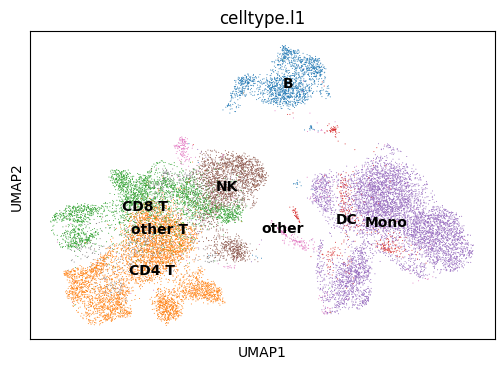

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


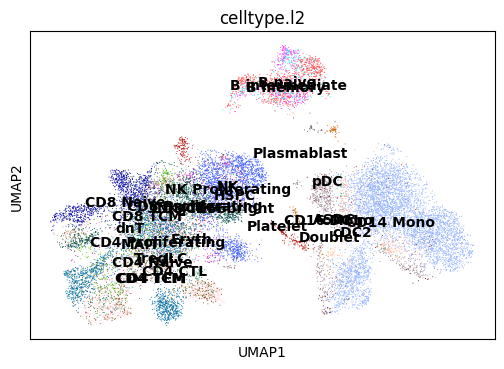

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


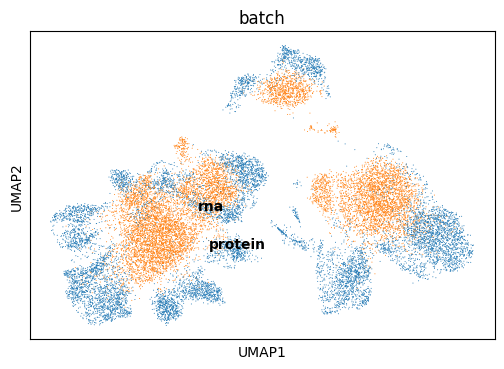

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


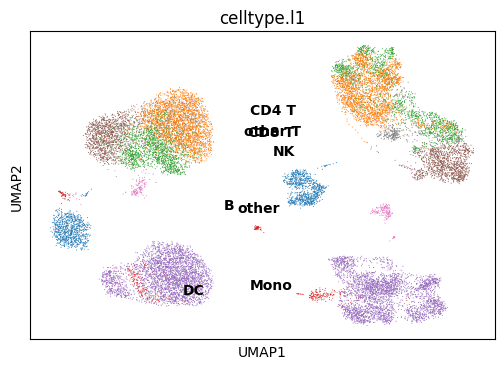

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


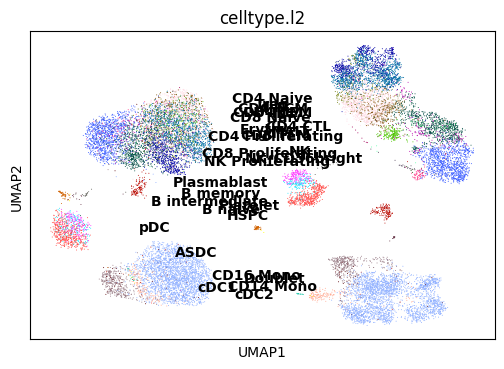

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


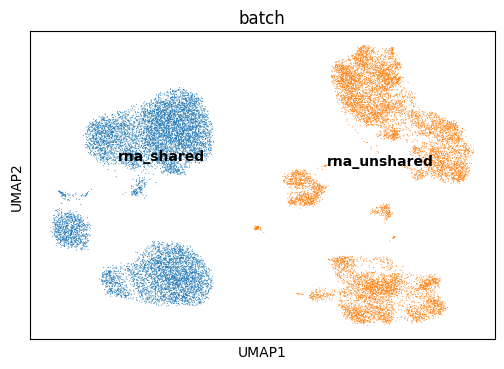

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


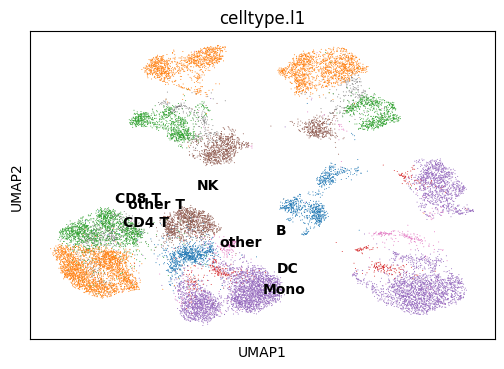

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


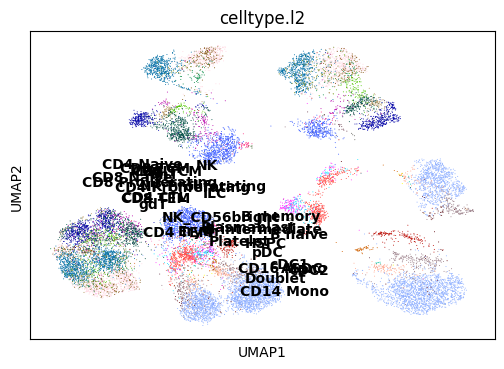

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


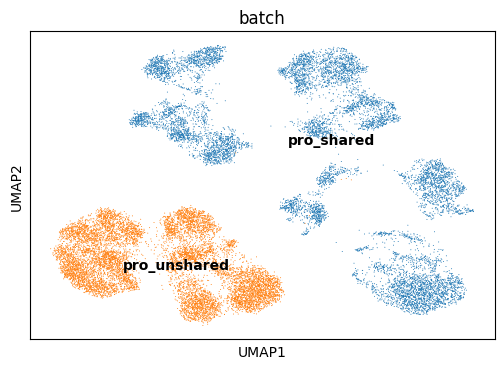

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For All matchings: lv1 matching acc: 0.734,
lv2 matching acc: 0.542.
For All matchings: FOSCTTM score: 0.23296668, 
Knn Alignment score: [0.0011 0.0023 0.0033 0.0038 0.0046 0.0052 0.0058 0.0064 0.007  0.008
 0.0083 0.0094 0.0112 0.0127 0.0137 0.0148 0.0156 0.0159 0.0165 0.0174
 0.0182 0.0192 0.0199 0.0202 0.0206]
For All matchings: Silhouette F1 score for lv1: 0.5091556428770213, 
Silhouette F1 score for lv2: 0.4956379984377905


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:423: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[matchings[0]], labels_l1[matchings[1]])





Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  3.3545063734054565
Matchings are reduced to 5000 after filtering...


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For only filtered matchings: lv1 matching acc: 0.823,
lv2 matching acc: 0.634.


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:460: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[filtered_matchings[0]], labels_l1[filtered_matchings[1]])





Matches are being propagated....
Done!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For all matchings after propagation: lv1 matching acc: 0.766,
lv2 matching acc: 0.560.


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:495: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[propagated_matchings[0]], labels_l1[propagated_matchings[1]])


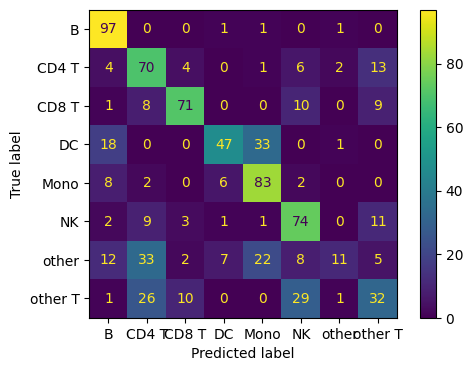

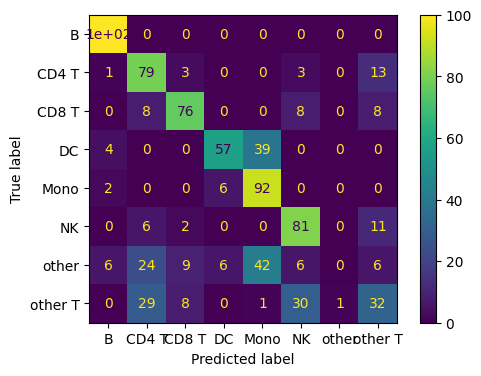

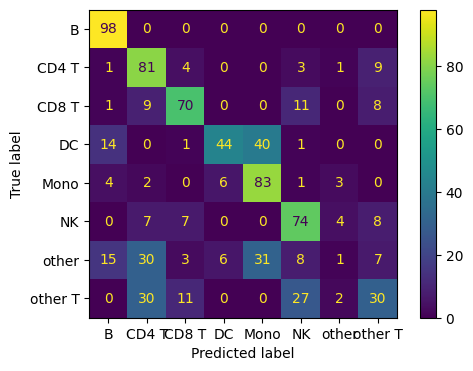

Epoch: 1601: 0it [00:00, ?it/s]C:\Users\vinee\AppData\Local\Temp\ipykernel_2144\3129631169.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return {"x_unshared":self.unshared_data[idx], "x_shared":self.shared_data[idx], "l1":self.labels_l1[idx], "l2":self.labels_l2[idx], "mean": self.local_mean[idx], "var": self.local_var[idx], "batch": self.batch[idx]}
Epoch: 1601: 40it [00:19,  2.01it/s]


RNA Recon Loss: 1.9977, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4197, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8252, Protein KL Div Z: 0.6230, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5273, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7971 Cross Loss Protein: 0.5401


Epoch: 1602: 40it [00:17,  2.28it/s]


RNA Recon Loss: 1.9907, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4193, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8264, Protein KL Div Z: 0.6243, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5280, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7975 Cross Loss Protein: 0.5406


Epoch: 1603: 40it [00:16,  2.39it/s]


RNA Recon Loss: 1.9867, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4196, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8266, Protein KL Div Z: 0.6235, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5271, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7939 Cross Loss Protein: 0.5399


Epoch: 1604: 40it [00:16,  2.40it/s]


RNA Recon Loss: 1.9878, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4182, Protein Recon Loss: 0.4848, Protein KL Div Back Pro: 0.8269, Protein KL Div Z: 0.6231, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5273, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7949 Cross Loss Protein: 0.5392


Epoch: 1605: 40it [00:17,  2.33it/s]


RNA Recon Loss: 1.9899, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4191, Protein Recon Loss: 0.4845, Protein KL Div Back Pro: 0.8264, Protein KL Div Z: 0.6241, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5271, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7942 Cross Loss Protein: 0.5391


Epoch: 1606: 40it [00:17,  2.34it/s]


RNA Recon Loss: 1.9879, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4188, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8247, Protein KL Div Z: 0.6232, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5271, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7944 Cross Loss Protein: 0.5394


Epoch: 1607: 40it [00:16,  2.36it/s]


RNA Recon Loss: 1.9932, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4192, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8255, Protein KL Div Z: 0.6234, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5273, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7933 Cross Loss Protein: 0.5388


Epoch: 1608: 40it [00:16,  2.40it/s]


RNA Recon Loss: 1.9888, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4189, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8261, Protein KL Div Z: 0.6241, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5266, Shared Recon Loss Gene: 0.2559, Shared Recon Loss Protein: 1.7951 Cross Loss Protein: 0.5394


Epoch: 1609: 40it [00:17,  2.30it/s]


RNA Recon Loss: 1.9917, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4191, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8253, Protein KL Div Z: 0.6237, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5273, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7953 Cross Loss Protein: 0.5402


Epoch: 1610: 40it [00:17,  2.35it/s]


RNA Recon Loss: 1.9924, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4190, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8261, Protein KL Div Z: 0.6243, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5268, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7948 Cross Loss Protein: 0.5396


Epoch: 1611: 40it [00:16,  2.37it/s]


RNA Recon Loss: 1.9892, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4193, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8272, Protein KL Div Z: 0.6244, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5271, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7964 Cross Loss Protein: 0.5399


Epoch: 1612: 40it [00:17,  2.31it/s]


RNA Recon Loss: 1.9960, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4198, Protein Recon Loss: 0.4884, Protein KL Div Back Pro: 0.8262, Protein KL Div Z: 0.6235, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5275, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.8010 Cross Loss Protein: 0.5418


Epoch: 1613: 40it [00:16,  2.40it/s]


RNA Recon Loss: 1.9916, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4192, Protein Recon Loss: 0.4849, Protein KL Div Back Pro: 0.8283, Protein KL Div Z: 0.6237, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5270, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7952 Cross Loss Protein: 0.5393


Epoch: 1614: 40it [00:16,  2.38it/s]


RNA Recon Loss: 1.9943, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4197, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8266, Protein KL Div Z: 0.6243, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5271, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7944 Cross Loss Protein: 0.5399


Epoch: 1615: 40it [00:16,  2.40it/s]


RNA Recon Loss: 1.9948, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4194, Protein Recon Loss: 0.4849, Protein KL Div Back Pro: 0.8268, Protein KL Div Z: 0.6230, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5270, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7946 Cross Loss Protein: 0.5395


Epoch: 1616: 40it [00:16,  2.39it/s]


RNA Recon Loss: 1.9991, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4199, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8264, Protein KL Div Z: 0.6230, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5277, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7940 Cross Loss Protein: 0.5398


Epoch: 1617: 40it [00:16,  2.39it/s]


RNA Recon Loss: 1.9889, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4196, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8271, Protein KL Div Z: 0.6232, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5274, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7948 Cross Loss Protein: 0.5400


Epoch: 1618: 40it [00:16,  2.39it/s]


RNA Recon Loss: 1.9931, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4192, Protein Recon Loss: 0.4878, Protein KL Div Back Pro: 0.8280, Protein KL Div Z: 0.6246, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5276, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7982 Cross Loss Protein: 0.5408


Epoch: 1619: 40it [00:16,  2.40it/s]


RNA Recon Loss: 1.9964, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4195, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8292, Protein KL Div Z: 0.6242, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5270, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7945 Cross Loss Protein: 0.5395


Epoch: 1620: 40it [00:17,  2.33it/s]


RNA Recon Loss: 1.9939, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4194, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8276, Protein KL Div Z: 0.6239, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5275, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7961 Cross Loss Protein: 0.5401


Epoch: 1621: 40it [00:16,  2.39it/s]


RNA Recon Loss: 1.9872, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4187, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8273, Protein KL Div Z: 0.6231, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5273, Shared Recon Loss Gene: 0.2561, Shared Recon Loss Protein: 1.7977 Cross Loss Protein: 0.5410


Epoch: 1622: 40it [00:16,  2.37it/s]


RNA Recon Loss: 1.9953, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4190, Protein Recon Loss: 0.4847, Protein KL Div Back Pro: 0.8290, Protein KL Div Z: 0.6244, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5270, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7941 Cross Loss Protein: 0.5394


Epoch: 1623: 40it [00:16,  2.39it/s]


RNA Recon Loss: 2.0018, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4194, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8265, Protein KL Div Z: 0.6233, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5274, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7935 Cross Loss Protein: 0.5397


Epoch: 1624: 40it [00:16,  2.40it/s]


RNA Recon Loss: 1.9903, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4192, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8258, Protein KL Div Z: 0.6233, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5270, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7948 Cross Loss Protein: 0.5390


Epoch: 1625: 40it [00:16,  2.40it/s]


RNA Recon Loss: 1.9946, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4192, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8261, Protein KL Div Z: 0.6225, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5273, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7953 Cross Loss Protein: 0.5393


Epoch: 1626: 40it [00:16,  2.40it/s]


RNA Recon Loss: 1.9997, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4195, Protein Recon Loss: 0.4843, Protein KL Div Back Pro: 0.8263, Protein KL Div Z: 0.6233, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5275, Shared Recon Loss Gene: 0.2577, Shared Recon Loss Protein: 1.7945 Cross Loss Protein: 0.5391


Epoch: 1627: 40it [00:17,  2.25it/s]


RNA Recon Loss: 1.9932, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4199, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8269, Protein KL Div Z: 0.6235, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5278, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7952 Cross Loss Protein: 0.5389


Epoch: 1628: 40it [00:19,  2.05it/s]


RNA Recon Loss: 1.9907, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4195, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8275, Protein KL Div Z: 0.6244, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5272, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7955 Cross Loss Protein: 0.5400


Epoch: 1629: 40it [00:19,  2.02it/s]


RNA Recon Loss: 1.9892, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4193, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8262, Protein KL Div Z: 0.6233, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5271, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7944 Cross Loss Protein: 0.5397


Epoch: 1630: 40it [00:18,  2.15it/s]


RNA Recon Loss: 1.9874, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4192, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8268, Protein KL Div Z: 0.6240, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5267, Shared Recon Loss Gene: 0.2562, Shared Recon Loss Protein: 1.7927 Cross Loss Protein: 0.5408


Epoch: 1631: 40it [00:17,  2.22it/s]


RNA Recon Loss: 1.9883, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4189, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8286, Protein KL Div Z: 0.6237, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5276, Shared Recon Loss Gene: 0.2560, Shared Recon Loss Protein: 1.7958 Cross Loss Protein: 0.5398


Epoch: 1632: 40it [00:18,  2.19it/s]


RNA Recon Loss: 1.9924, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4191, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8268, Protein KL Div Z: 0.6237, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5269, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7949 Cross Loss Protein: 0.5395


Epoch: 1633: 40it [00:20,  1.98it/s]


RNA Recon Loss: 1.9948, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4197, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8276, Protein KL Div Z: 0.6242, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5275, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7965 Cross Loss Protein: 0.5403


Epoch: 1634: 40it [00:19,  2.08it/s]


RNA Recon Loss: 1.9865, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4191, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8281, Protein KL Div Z: 0.6242, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5273, Shared Recon Loss Gene: 0.2560, Shared Recon Loss Protein: 1.7960 Cross Loss Protein: 0.5398


Epoch: 1635: 40it [00:19,  2.06it/s]


RNA Recon Loss: 1.9921, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4197, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8267, Protein KL Div Z: 0.6233, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5272, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7976 Cross Loss Protein: 0.5403


Epoch: 1636: 40it [00:19,  2.04it/s]


RNA Recon Loss: 1.9916, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4198, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8291, Protein KL Div Z: 0.6251, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5275, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7958 Cross Loss Protein: 0.5395


Epoch: 1637: 40it [00:25,  1.57it/s]


RNA Recon Loss: 1.9870, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4190, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8262, Protein KL Div Z: 0.6238, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5274, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7957 Cross Loss Protein: 0.5399


Epoch: 1638: 40it [00:19,  2.06it/s]


RNA Recon Loss: 1.9948, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4194, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8276, Protein KL Div Z: 0.6250, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5269, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7948 Cross Loss Protein: 0.5395


Epoch: 1639: 40it [00:15,  2.58it/s]


RNA Recon Loss: 1.9926, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4194, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8261, Protein KL Div Z: 0.6244, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5274, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7960 Cross Loss Protein: 0.5406


Epoch: 1640: 40it [00:15,  2.55it/s]


RNA Recon Loss: 1.9882, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4191, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8278, Protein KL Div Z: 0.6244, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5269, Shared Recon Loss Gene: 0.2561, Shared Recon Loss Protein: 1.7967 Cross Loss Protein: 0.5405


Epoch: 1641: 40it [00:18,  2.16it/s]


RNA Recon Loss: 2.0021, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4195, Protein Recon Loss: 0.4882, Protein KL Div Back Pro: 0.8259, Protein KL Div Z: 0.6228, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5271, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.8014 Cross Loss Protein: 0.5410


Epoch: 1642: 40it [00:19,  2.10it/s]


RNA Recon Loss: 1.9960, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4193, Protein Recon Loss: 0.4849, Protein KL Div Back Pro: 0.8294, Protein KL Div Z: 0.6237, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5276, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7970 Cross Loss Protein: 0.5392


Epoch: 1643: 40it [00:17,  2.25it/s]


RNA Recon Loss: 1.9999, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4196, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8267, Protein KL Div Z: 0.6231, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5272, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7978 Cross Loss Protein: 0.5398


Epoch: 1644: 40it [00:17,  2.34it/s]


RNA Recon Loss: 1.9937, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4196, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8277, Protein KL Div Z: 0.6241, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5275, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7971 Cross Loss Protein: 0.5400


Epoch: 1645: 40it [00:17,  2.22it/s]


RNA Recon Loss: 1.9926, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4194, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8277, Protein KL Div Z: 0.6246, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5273, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7950 Cross Loss Protein: 0.5395


Epoch: 1646: 40it [00:18,  2.12it/s]


RNA Recon Loss: 1.9931, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4190, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8276, Protein KL Div Z: 0.6242, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5270, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7959 Cross Loss Protein: 0.5403


Epoch: 1647: 40it [00:17,  2.26it/s]


RNA Recon Loss: 1.9948, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4191, Protein Recon Loss: 0.4848, Protein KL Div Back Pro: 0.8275, Protein KL Div Z: 0.6231, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5271, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7940 Cross Loss Protein: 0.5396


Epoch: 1648: 40it [00:17,  2.22it/s]


RNA Recon Loss: 1.9929, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4190, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8272, Protein KL Div Z: 0.6236, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5273, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7939 Cross Loss Protein: 0.5394


Epoch: 1649: 40it [00:17,  2.31it/s]


RNA Recon Loss: 1.9907, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4192, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8275, Protein KL Div Z: 0.6235, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5273, Shared Recon Loss Gene: 0.2560, Shared Recon Loss Protein: 1.7963 Cross Loss Protein: 0.5394


Epoch: 1650: 40it [00:17,  2.22it/s]


RNA Recon Loss: 1.9929, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4193, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8283, Protein KL Div Z: 0.6244, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5273, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7966 Cross Loss Protein: 0.5400


Epoch: 1651: 40it [00:17,  2.22it/s]


RNA Recon Loss: 1.9943, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4192, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8270, Protein KL Div Z: 0.6230, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5272, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7949 Cross Loss Protein: 0.5399


Epoch: 1652: 40it [00:18,  2.20it/s]


RNA Recon Loss: 1.9886, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4193, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8271, Protein KL Div Z: 0.6232, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5265, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7951 Cross Loss Protein: 0.5399


Epoch: 1653: 40it [00:19,  2.10it/s]


RNA Recon Loss: 1.9870, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4189, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8272, Protein KL Div Z: 0.6235, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5272, Shared Recon Loss Gene: 0.2559, Shared Recon Loss Protein: 1.7952 Cross Loss Protein: 0.5395


Epoch: 1654: 40it [00:17,  2.31it/s]


RNA Recon Loss: 1.9978, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4189, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8271, Protein KL Div Z: 0.6234, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5276, Shared Recon Loss Gene: 0.2578, Shared Recon Loss Protein: 1.7942 Cross Loss Protein: 0.5389


Epoch: 1655: 40it [00:17,  2.23it/s]


RNA Recon Loss: 2.0061, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4196, Protein Recon Loss: 0.4849, Protein KL Div Back Pro: 0.8257, Protein KL Div Z: 0.6232, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5267, Shared Recon Loss Gene: 0.2578, Shared Recon Loss Protein: 1.7959 Cross Loss Protein: 0.5399


Epoch: 1656: 40it [00:17,  2.25it/s]


RNA Recon Loss: 1.9933, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4192, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8265, Protein KL Div Z: 0.6236, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5276, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7964 Cross Loss Protein: 0.5402


Epoch: 1657: 40it [00:19,  2.05it/s]


RNA Recon Loss: 1.9941, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4196, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8285, Protein KL Div Z: 0.6243, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5270, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7946 Cross Loss Protein: 0.5394


Epoch: 1658: 40it [00:18,  2.13it/s]


RNA Recon Loss: 1.9895, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4192, Protein Recon Loss: 0.4849, Protein KL Div Back Pro: 0.8268, Protein KL Div Z: 0.6237, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5265, Shared Recon Loss Gene: 0.2562, Shared Recon Loss Protein: 1.7963 Cross Loss Protein: 0.5396


Epoch: 1659: 40it [00:19,  2.05it/s]


RNA Recon Loss: 1.9954, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4196, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8270, Protein KL Div Z: 0.6235, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5273, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7964 Cross Loss Protein: 0.5396


Epoch: 1660: 40it [00:19,  2.05it/s]


RNA Recon Loss: 1.9905, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4189, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8265, Protein KL Div Z: 0.6233, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5263, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7944 Cross Loss Protein: 0.5403


Epoch: 1661: 40it [00:21,  1.90it/s]


RNA Recon Loss: 1.9870, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4190, Protein Recon Loss: 0.4847, Protein KL Div Back Pro: 0.8281, Protein KL Div Z: 0.6255, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5271, Shared Recon Loss Gene: 0.2561, Shared Recon Loss Protein: 1.7935 Cross Loss Protein: 0.5393


Epoch: 1662: 40it [00:17,  2.26it/s]


RNA Recon Loss: 1.9921, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4194, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8259, Protein KL Div Z: 0.6233, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5272, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7974 Cross Loss Protein: 0.5404


Epoch: 1663: 40it [00:17,  2.26it/s]


RNA Recon Loss: 1.9900, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4198, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8278, Protein KL Div Z: 0.6238, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5274, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7978 Cross Loss Protein: 0.5401


Epoch: 1664: 40it [00:16,  2.38it/s]


RNA Recon Loss: 1.9918, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4194, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8271, Protein KL Div Z: 0.6236, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5270, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7962 Cross Loss Protein: 0.5400


Epoch: 1665: 40it [00:12,  3.08it/s]


RNA Recon Loss: 1.9906, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4194, Protein Recon Loss: 0.4848, Protein KL Div Back Pro: 0.8262, Protein KL Div Z: 0.6235, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5269, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7950 Cross Loss Protein: 0.5392


Epoch: 1666: 40it [00:12,  3.28it/s]


RNA Recon Loss: 1.9867, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4192, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8261, Protein KL Div Z: 0.6240, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5270, Shared Recon Loss Gene: 0.2560, Shared Recon Loss Protein: 1.7944 Cross Loss Protein: 0.5395


Epoch: 1667: 40it [00:13,  3.07it/s]


RNA Recon Loss: 1.9852, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4187, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8269, Protein KL Div Z: 0.6226, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5269, Shared Recon Loss Gene: 0.2557, Shared Recon Loss Protein: 1.7968 Cross Loss Protein: 0.5402


Epoch: 1668: 40it [00:13,  3.05it/s]


RNA Recon Loss: 1.9906, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4191, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8296, Protein KL Div Z: 0.6245, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5266, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7948 Cross Loss Protein: 0.5395


Epoch: 1669: 40it [00:12,  3.21it/s]


RNA Recon Loss: 1.9869, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4193, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8265, Protein KL Div Z: 0.6244, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5275, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7972 Cross Loss Protein: 0.5405


Epoch: 1670: 40it [00:13,  3.05it/s]


RNA Recon Loss: 1.9907, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4193, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8268, Protein KL Div Z: 0.6238, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5267, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7960 Cross Loss Protein: 0.5400


Epoch: 1671: 40it [00:12,  3.25it/s]


RNA Recon Loss: 1.9922, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4193, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8285, Protein KL Div Z: 0.6247, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5272, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7951 Cross Loss Protein: 0.5402


Epoch: 1672: 40it [00:12,  3.25it/s]


RNA Recon Loss: 1.9887, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4190, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8253, Protein KL Div Z: 0.6231, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5269, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7932 Cross Loss Protein: 0.5394


Epoch: 1673: 40it [00:12,  3.28it/s]


RNA Recon Loss: 1.9949, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4193, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8245, Protein KL Div Z: 0.6244, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5268, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7945 Cross Loss Protein: 0.5393


Epoch: 1674: 40it [00:12,  3.23it/s]


RNA Recon Loss: 1.9883, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4191, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8277, Protein KL Div Z: 0.6238, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5260, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7959 Cross Loss Protein: 0.5402


Epoch: 1675: 40it [00:12,  3.30it/s]


RNA Recon Loss: 1.9920, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4188, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8277, Protein KL Div Z: 0.6253, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5273, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7986 Cross Loss Protein: 0.5399


Epoch: 1676: 40it [00:12,  3.24it/s]


RNA Recon Loss: 1.9906, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4193, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8272, Protein KL Div Z: 0.6237, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7950 Cross Loss Protein: 0.5395


Epoch: 1677: 40it [00:12,  3.17it/s]


RNA Recon Loss: 1.9884, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4191, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8272, Protein KL Div Z: 0.6231, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5270, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7955 Cross Loss Protein: 0.5399


Epoch: 1678: 40it [00:12,  3.33it/s]


RNA Recon Loss: 1.9986, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4191, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8269, Protein KL Div Z: 0.6238, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5268, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.8004 Cross Loss Protein: 0.5408


Epoch: 1679: 40it [00:12,  3.24it/s]


RNA Recon Loss: 1.9897, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4187, Protein Recon Loss: 0.4847, Protein KL Div Back Pro: 0.8280, Protein KL Div Z: 0.6251, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5270, Shared Recon Loss Gene: 0.2562, Shared Recon Loss Protein: 1.7942 Cross Loss Protein: 0.5397


Epoch: 1680: 40it [00:12,  3.30it/s]


RNA Recon Loss: 1.9878, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4182, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8261, Protein KL Div Z: 0.6240, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5262, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7948 Cross Loss Protein: 0.5393


Epoch: 1681: 40it [00:13,  2.96it/s]


RNA Recon Loss: 1.9912, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4186, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8289, Protein KL Div Z: 0.6253, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5268, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7947 Cross Loss Protein: 0.5394


Epoch: 1682: 40it [00:14,  2.72it/s]


RNA Recon Loss: 1.9864, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4184, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8273, Protein KL Div Z: 0.6244, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5273, Shared Recon Loss Gene: 0.2559, Shared Recon Loss Protein: 1.7959 Cross Loss Protein: 0.5404


Epoch: 1683: 40it [00:14,  2.71it/s]


RNA Recon Loss: 1.9980, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4194, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8270, Protein KL Div Z: 0.6251, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5270, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7957 Cross Loss Protein: 0.5398


Epoch: 1684: 40it [00:15,  2.59it/s]


RNA Recon Loss: 1.9914, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4188, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8262, Protein KL Div Z: 0.6232, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5269, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7946 Cross Loss Protein: 0.5391


Epoch: 1685: 40it [00:15,  2.63it/s]


RNA Recon Loss: 1.9877, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4192, Protein Recon Loss: 0.4865, Protein KL Div Back Pro: 0.8260, Protein KL Div Z: 0.6245, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5268, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7938 Cross Loss Protein: 0.5409


Epoch: 1686: 40it [00:13,  2.98it/s]


RNA Recon Loss: 1.9875, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4190, Protein Recon Loss: 0.4846, Protein KL Div Back Pro: 0.8254, Protein KL Div Z: 0.6235, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5263, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7954 Cross Loss Protein: 0.5390


Epoch: 1687: 40it [00:13,  3.04it/s]


RNA Recon Loss: 1.9920, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4192, Protein Recon Loss: 0.4845, Protein KL Div Back Pro: 0.8269, Protein KL Div Z: 0.6235, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5272, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7936 Cross Loss Protein: 0.5386


Epoch: 1688: 40it [00:13,  3.04it/s]


RNA Recon Loss: 1.9887, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4192, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8268, Protein KL Div Z: 0.6239, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5268, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7939 Cross Loss Protein: 0.5393


Epoch: 1689: 40it [00:12,  3.13it/s]


RNA Recon Loss: 1.9862, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4189, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8258, Protein KL Div Z: 0.6235, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5272, Shared Recon Loss Gene: 0.2561, Shared Recon Loss Protein: 1.7961 Cross Loss Protein: 0.5403


Epoch: 1690: 40it [00:13,  2.90it/s]


RNA Recon Loss: 1.9902, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4194, Protein Recon Loss: 0.4887, Protein KL Div Back Pro: 0.8279, Protein KL Div Z: 0.6240, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5263, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7994 Cross Loss Protein: 0.5415


Epoch: 1691: 40it [00:13,  2.96it/s]


RNA Recon Loss: 1.9906, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4193, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8300, Protein KL Div Z: 0.6244, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5272, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.8016 Cross Loss Protein: 0.5411


Epoch: 1692: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9929, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4189, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8285, Protein KL Div Z: 0.6248, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5269, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7952 Cross Loss Protein: 0.5392


Epoch: 1693: 40it [00:13,  3.04it/s]


RNA Recon Loss: 1.9891, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4192, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8268, Protein KL Div Z: 0.6247, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5268, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7945 Cross Loss Protein: 0.5386


Epoch: 1694: 40it [00:12,  3.14it/s]


RNA Recon Loss: 1.9890, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4188, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8269, Protein KL Div Z: 0.6252, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5272, Shared Recon Loss Gene: 0.2562, Shared Recon Loss Protein: 1.7956 Cross Loss Protein: 0.5399


Epoch: 1695: 40it [00:13,  3.05it/s]


RNA Recon Loss: 1.9918, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4189, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8258, Protein KL Div Z: 0.6232, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5269, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7948 Cross Loss Protein: 0.5400


Epoch: 1696: 40it [00:12,  3.12it/s]


RNA Recon Loss: 1.9946, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4189, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8294, Protein KL Div Z: 0.6256, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5271, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7939 Cross Loss Protein: 0.5396


Epoch: 1697: 40it [00:12,  3.16it/s]


RNA Recon Loss: 1.9891, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4192, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8271, Protein KL Div Z: 0.6245, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5268, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7959 Cross Loss Protein: 0.5394


Epoch: 1698: 40it [00:12,  3.14it/s]


RNA Recon Loss: 1.9852, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4187, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8258, Protein KL Div Z: 0.6231, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5268, Shared Recon Loss Gene: 0.2561, Shared Recon Loss Protein: 1.7932 Cross Loss Protein: 0.5392


Epoch: 1699: 40it [00:12,  3.20it/s]


RNA Recon Loss: 1.9895, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4190, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8262, Protein KL Div Z: 0.6231, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5271, Shared Recon Loss Gene: 0.2562, Shared Recon Loss Protein: 1.7950 Cross Loss Protein: 0.5398


Epoch: 1700: 40it [00:12,  3.27it/s]


RNA Recon Loss: 1.9945, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4191, Protein Recon Loss: 0.4849, Protein KL Div Back Pro: 0.8273, Protein KL Div Z: 0.6232, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5269, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7944 Cross Loss Protein: 0.5392


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


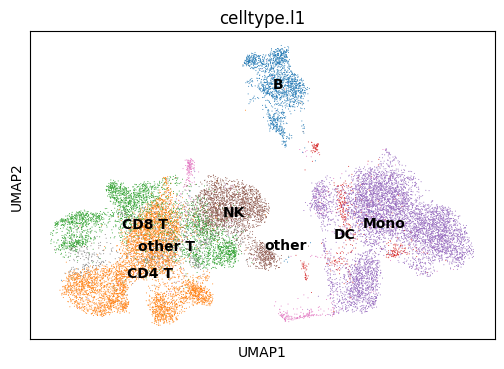

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


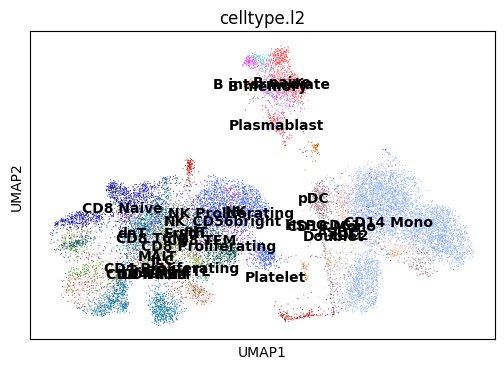

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


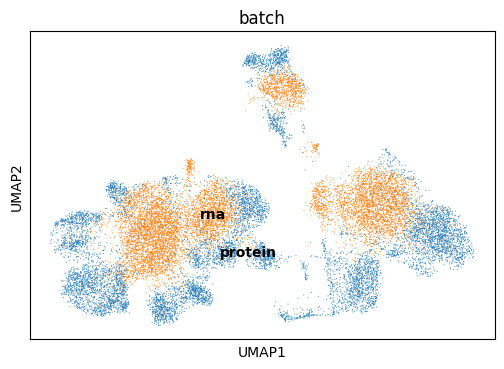

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


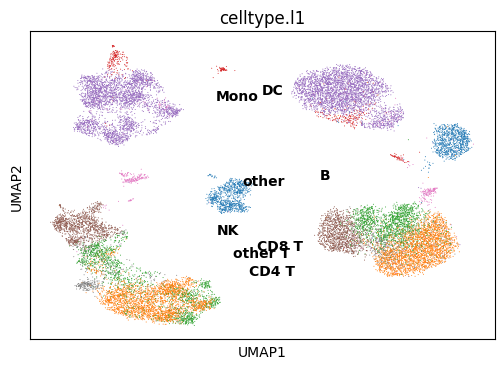

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


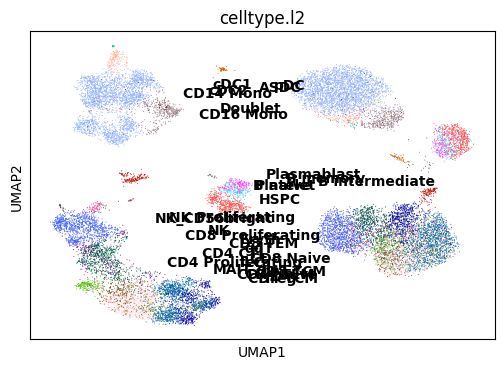

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


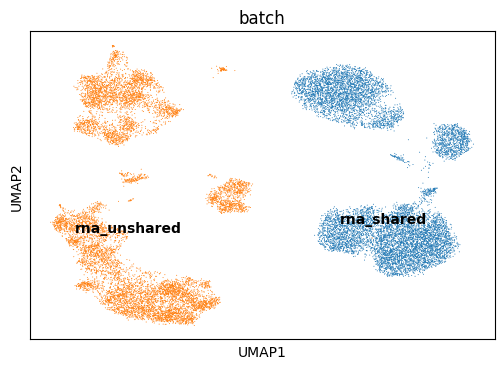

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


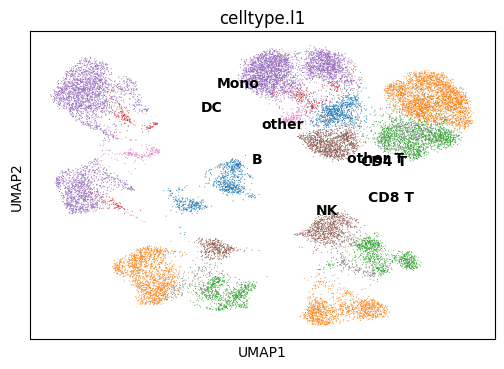

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


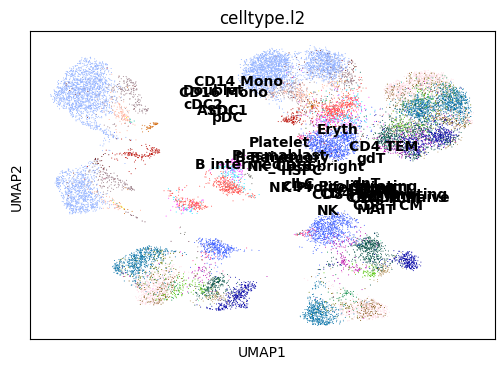

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


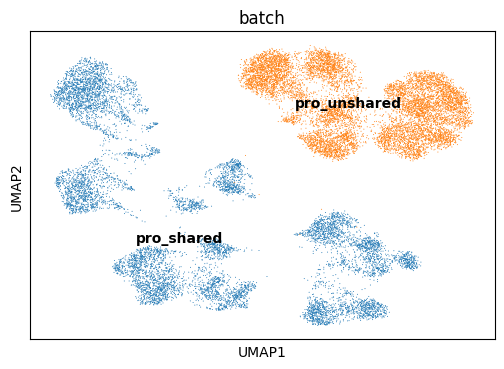

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For All matchings: lv1 matching acc: 0.746,
lv2 matching acc: 0.562.
For All matchings: FOSCTTM score: 0.22962949, 
Knn Alignment score: [0.0015 0.0026 0.0031 0.0042 0.0047 0.006  0.0061 0.0074 0.0091 0.0099
 0.0111 0.0119 0.013  0.0136 0.0145 0.0152 0.0159 0.0176 0.0185 0.0189
 0.0201 0.0213 0.0217 0.0224 0.023 ]
For All matchings: Silhouette F1 score for lv1: 0.5098244553562382, 
Silhouette F1 score for lv2: 0.4964559233651107


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:423: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[matchings[0]], labels_l1[matchings[1]])





Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  3.3612520694732666
Matchings are reduced to 5000 after filtering...


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For only filtered matchings: lv1 matching acc: 0.845,
lv2 matching acc: 0.661.


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:460: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[filtered_matchings[0]], labels_l1[filtered_matchings[1]])





Matches are being propagated....
Done!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For all matchings after propagation: lv1 matching acc: 0.773,
lv2 matching acc: 0.564.


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:495: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[propagated_matchings[0]], labels_l1[propagated_matchings[1]])


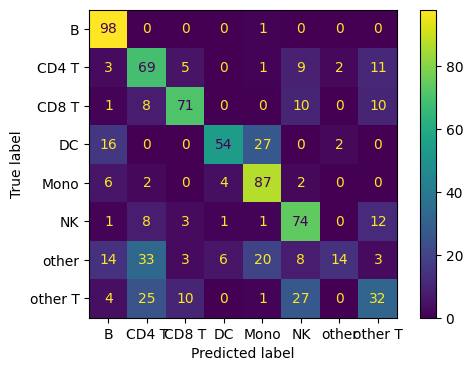

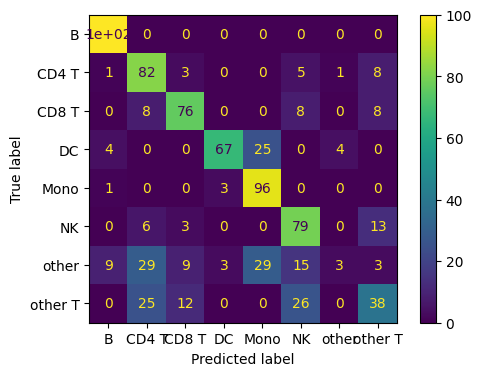

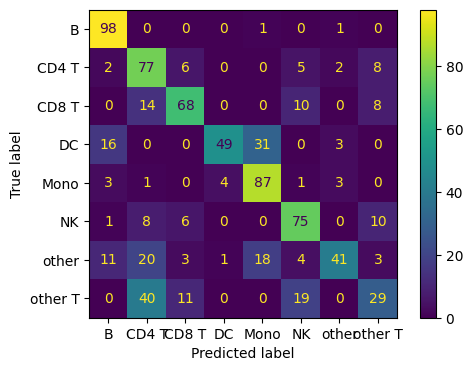

Epoch: 1701: 0it [00:00, ?it/s]C:\Users\vinee\AppData\Local\Temp\ipykernel_2144\3129631169.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return {"x_unshared":self.unshared_data[idx], "x_shared":self.shared_data[idx], "l1":self.labels_l1[idx], "l2":self.labels_l2[idx], "mean": self.local_mean[idx], "var": self.local_var[idx], "batch": self.batch[idx]}
Epoch: 1701: 40it [00:13,  3.07it/s]


RNA Recon Loss: 1.9924, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4188, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8268, Protein KL Div Z: 0.6236, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5272, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7944 Cross Loss Protein: 0.5395


Epoch: 1702: 40it [00:12,  3.15it/s]


RNA Recon Loss: 1.9876, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4189, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8250, Protein KL Div Z: 0.6235, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5267, Shared Recon Loss Gene: 0.2560, Shared Recon Loss Protein: 1.7968 Cross Loss Protein: 0.5395


Epoch: 1703: 40it [00:12,  3.14it/s]


RNA Recon Loss: 2.0022, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4191, Protein Recon Loss: 0.4848, Protein KL Div Back Pro: 0.8265, Protein KL Div Z: 0.6242, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5267, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7952 Cross Loss Protein: 0.5395


Epoch: 1704: 40it [00:12,  3.11it/s]


RNA Recon Loss: 1.9916, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4183, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8283, Protein KL Div Z: 0.6247, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5269, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7959 Cross Loss Protein: 0.5393


Epoch: 1705: 40it [00:12,  3.17it/s]


RNA Recon Loss: 1.9964, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4192, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8269, Protein KL Div Z: 0.6247, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5270, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7935 Cross Loss Protein: 0.5394


Epoch: 1706: 40it [00:12,  3.13it/s]


RNA Recon Loss: 1.9958, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4189, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8273, Protein KL Div Z: 0.6248, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5274, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7956 Cross Loss Protein: 0.5398


Epoch: 1707: 40it [00:12,  3.18it/s]


RNA Recon Loss: 1.9878, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4188, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8261, Protein KL Div Z: 0.6233, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5258, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7958 Cross Loss Protein: 0.5394


Epoch: 1708: 40it [00:12,  3.15it/s]


RNA Recon Loss: 1.9963, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4191, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8288, Protein KL Div Z: 0.6243, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5275, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7944 Cross Loss Protein: 0.5396


Epoch: 1709: 40it [00:12,  3.15it/s]


RNA Recon Loss: 1.9947, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4190, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8255, Protein KL Div Z: 0.6221, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5271, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7947 Cross Loss Protein: 0.5389


Epoch: 1710: 40it [00:12,  3.10it/s]


RNA Recon Loss: 1.9894, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4197, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8274, Protein KL Div Z: 0.6255, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5266, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7940 Cross Loss Protein: 0.5391


Epoch: 1711: 40it [00:12,  3.14it/s]


RNA Recon Loss: 1.9959, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4187, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8257, Protein KL Div Z: 0.6255, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5271, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7942 Cross Loss Protein: 0.5392


Epoch: 1712: 40it [00:13,  3.04it/s]


RNA Recon Loss: 1.9887, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4194, Protein Recon Loss: 0.4846, Protein KL Div Back Pro: 0.8248, Protein KL Div Z: 0.6229, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7945 Cross Loss Protein: 0.5392


Epoch: 1713: 40it [00:12,  3.13it/s]


RNA Recon Loss: 1.9942, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4190, Protein Recon Loss: 0.4849, Protein KL Div Back Pro: 0.8269, Protein KL Div Z: 0.6242, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5271, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7937 Cross Loss Protein: 0.5394


Epoch: 1714: 40it [00:13,  3.06it/s]


RNA Recon Loss: 1.9931, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4190, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8269, Protein KL Div Z: 0.6244, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5269, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7961 Cross Loss Protein: 0.5405


Epoch: 1715: 40it [00:13,  3.03it/s]


RNA Recon Loss: 1.9866, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4186, Protein Recon Loss: 0.4863, Protein KL Div Back Pro: 0.8271, Protein KL Div Z: 0.6256, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5265, Shared Recon Loss Gene: 0.2561, Shared Recon Loss Protein: 1.7952 Cross Loss Protein: 0.5405


Epoch: 1716: 40it [00:12,  3.09it/s]


RNA Recon Loss: 1.9890, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4191, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8264, Protein KL Div Z: 0.6239, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5268, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7947 Cross Loss Protein: 0.5406


Epoch: 1717: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9928, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4188, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8266, Protein KL Div Z: 0.6244, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5269, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7964 Cross Loss Protein: 0.5398


Epoch: 1718: 40it [00:13,  3.06it/s]


RNA Recon Loss: 1.9893, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4194, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8255, Protein KL Div Z: 0.6236, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5265, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7953 Cross Loss Protein: 0.5391


Epoch: 1719: 40it [00:13,  3.06it/s]


RNA Recon Loss: 1.9888, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4188, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8275, Protein KL Div Z: 0.6247, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5267, Shared Recon Loss Gene: 0.2558, Shared Recon Loss Protein: 1.7962 Cross Loss Protein: 0.5394


Epoch: 1720: 40it [00:13,  3.06it/s]


RNA Recon Loss: 1.9960, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4194, Protein Recon Loss: 0.4849, Protein KL Div Back Pro: 0.8267, Protein KL Div Z: 0.6241, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7945 Cross Loss Protein: 0.5393


Epoch: 1721: 40it [00:13,  3.06it/s]


RNA Recon Loss: 1.9912, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4189, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8255, Protein KL Div Z: 0.6244, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5268, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7947 Cross Loss Protein: 0.5391


Epoch: 1722: 40it [00:13,  3.03it/s]


RNA Recon Loss: 1.9883, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4187, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8271, Protein KL Div Z: 0.6232, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5261, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7938 Cross Loss Protein: 0.5390


Epoch: 1723: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9889, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4184, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8263, Protein KL Div Z: 0.6243, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5262, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7952 Cross Loss Protein: 0.5399


Epoch: 1724: 40it [00:13,  3.05it/s]


RNA Recon Loss: 2.0022, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4193, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8263, Protein KL Div Z: 0.6249, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5271, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7953 Cross Loss Protein: 0.5400


Epoch: 1725: 40it [00:13,  3.05it/s]


RNA Recon Loss: 1.9920, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4188, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8261, Protein KL Div Z: 0.6231, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5269, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7959 Cross Loss Protein: 0.5394


Epoch: 1726: 40it [00:13,  3.06it/s]


RNA Recon Loss: 1.9891, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4186, Protein Recon Loss: 0.4847, Protein KL Div Back Pro: 0.8266, Protein KL Div Z: 0.6246, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5266, Shared Recon Loss Gene: 0.2562, Shared Recon Loss Protein: 1.7962 Cross Loss Protein: 0.5396


Epoch: 1727: 40it [00:13,  3.04it/s]


RNA Recon Loss: 1.9938, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4192, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8273, Protein KL Div Z: 0.6251, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7961 Cross Loss Protein: 0.5396


Epoch: 1728: 40it [00:13,  3.04it/s]


RNA Recon Loss: 1.9958, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4190, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8269, Protein KL Div Z: 0.6259, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5269, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7975 Cross Loss Protein: 0.5403


Epoch: 1729: 40it [00:13,  3.03it/s]


RNA Recon Loss: 1.9993, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4192, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8266, Protein KL Div Z: 0.6240, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5262, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7947 Cross Loss Protein: 0.5401


Epoch: 1730: 40it [00:13,  3.04it/s]


RNA Recon Loss: 1.9901, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4191, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8273, Protein KL Div Z: 0.6242, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5262, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7963 Cross Loss Protein: 0.5403


Epoch: 1731: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9953, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4192, Protein Recon Loss: 0.4847, Protein KL Div Back Pro: 0.8259, Protein KL Div Z: 0.6239, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5265, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7950 Cross Loss Protein: 0.5391


Epoch: 1732: 40it [00:13,  2.96it/s]


RNA Recon Loss: 1.9955, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4188, Protein Recon Loss: 0.4866, Protein KL Div Back Pro: 0.8261, Protein KL Div Z: 0.6238, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5268, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7971 Cross Loss Protein: 0.5405


Epoch: 1733: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9890, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4188, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8285, Protein KL Div Z: 0.6252, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5266, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7980 Cross Loss Protein: 0.5401


Epoch: 1734: 40it [00:13,  3.00it/s]


RNA Recon Loss: 1.9894, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4192, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8244, Protein KL Div Z: 0.6239, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5265, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7961 Cross Loss Protein: 0.5393


Epoch: 1735: 40it [00:13,  3.03it/s]


RNA Recon Loss: 1.9928, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4191, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8255, Protein KL Div Z: 0.6240, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5269, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7948 Cross Loss Protein: 0.5400


Epoch: 1736: 40it [00:13,  3.04it/s]


RNA Recon Loss: 1.9898, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4190, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8273, Protein KL Div Z: 0.6242, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5265, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7956 Cross Loss Protein: 0.5400


Epoch: 1737: 40it [00:13,  3.06it/s]


RNA Recon Loss: 1.9885, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4186, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8284, Protein KL Div Z: 0.6248, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7942 Cross Loss Protein: 0.5391


Epoch: 1738: 40it [00:13,  3.04it/s]


RNA Recon Loss: 1.9919, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4191, Protein Recon Loss: 0.4866, Protein KL Div Back Pro: 0.8256, Protein KL Div Z: 0.6245, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5263, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7996 Cross Loss Protein: 0.5402


Epoch: 1739: 40it [00:13,  3.05it/s]


RNA Recon Loss: 1.9959, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4191, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8264, Protein KL Div Z: 0.6228, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5265, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7957 Cross Loss Protein: 0.5397


Epoch: 1740: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9992, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4193, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8269, Protein KL Div Z: 0.6230, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5267, Shared Recon Loss Gene: 0.2577, Shared Recon Loss Protein: 1.7941 Cross Loss Protein: 0.5395


Epoch: 1741: 40it [00:13,  3.06it/s]


RNA Recon Loss: 1.9959, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4191, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8276, Protein KL Div Z: 0.6250, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5261, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7928 Cross Loss Protein: 0.5389


Epoch: 1742: 40it [00:13,  2.89it/s]


RNA Recon Loss: 2.0086, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4193, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8271, Protein KL Div Z: 0.6245, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5268, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7944 Cross Loss Protein: 0.5393


Epoch: 1743: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9919, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4186, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8258, Protein KL Div Z: 0.6229, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5270, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7940 Cross Loss Protein: 0.5395


Epoch: 1744: 40it [00:13,  3.05it/s]


RNA Recon Loss: 1.9896, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4187, Protein Recon Loss: 0.4849, Protein KL Div Back Pro: 0.8250, Protein KL Div Z: 0.6238, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7934 Cross Loss Protein: 0.5396


Epoch: 1745: 40it [00:13,  3.07it/s]


RNA Recon Loss: 1.9887, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4184, Protein Recon Loss: 0.4870, Protein KL Div Back Pro: 0.8282, Protein KL Div Z: 0.6249, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5266, Shared Recon Loss Gene: 0.2561, Shared Recon Loss Protein: 1.7972 Cross Loss Protein: 0.5400


Epoch: 1746: 40it [00:13,  3.04it/s]


RNA Recon Loss: 1.9918, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4192, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8294, Protein KL Div Z: 0.6243, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7960 Cross Loss Protein: 0.5399


Epoch: 1747: 40it [00:13,  3.05it/s]


RNA Recon Loss: 1.9877, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4191, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8272, Protein KL Div Z: 0.6233, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5269, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7953 Cross Loss Protein: 0.5398


Epoch: 1748: 40it [00:13,  3.05it/s]


RNA Recon Loss: 1.9933, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4186, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8253, Protein KL Div Z: 0.6223, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5257, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7940 Cross Loss Protein: 0.5398


Epoch: 1749: 40it [00:13,  3.05it/s]


RNA Recon Loss: 1.9931, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4188, Protein Recon Loss: 0.4849, Protein KL Div Back Pro: 0.8273, Protein KL Div Z: 0.6239, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5267, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7954 Cross Loss Protein: 0.5390


Epoch: 1750: 40it [00:13,  3.06it/s]


RNA Recon Loss: 1.9875, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4184, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8269, Protein KL Div Z: 0.6251, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5261, Shared Recon Loss Gene: 0.2561, Shared Recon Loss Protein: 1.7960 Cross Loss Protein: 0.5394


Epoch: 1751: 40it [00:13,  3.00it/s]


RNA Recon Loss: 1.9877, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4185, Protein Recon Loss: 0.4848, Protein KL Div Back Pro: 0.8255, Protein KL Div Z: 0.6225, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7924 Cross Loss Protein: 0.5394


Epoch: 1752: 40it [00:13,  3.04it/s]


RNA Recon Loss: 2.0061, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4191, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8258, Protein KL Div Z: 0.6231, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5267, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7970 Cross Loss Protein: 0.5399


Epoch: 1753: 40it [00:13,  3.05it/s]


RNA Recon Loss: 1.9860, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4188, Protein Recon Loss: 0.4849, Protein KL Div Back Pro: 0.8265, Protein KL Div Z: 0.6247, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5269, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7939 Cross Loss Protein: 0.5390


Epoch: 1754: 40it [00:13,  3.03it/s]


RNA Recon Loss: 1.9850, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4187, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8271, Protein KL Div Z: 0.6252, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5266, Shared Recon Loss Gene: 0.2559, Shared Recon Loss Protein: 1.7952 Cross Loss Protein: 0.5398


Epoch: 1755: 40it [00:13,  3.05it/s]


RNA Recon Loss: 1.9946, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4189, Protein Recon Loss: 0.4847, Protein KL Div Back Pro: 0.8266, Protein KL Div Z: 0.6251, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5265, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7945 Cross Loss Protein: 0.5395


Epoch: 1756: 40it [00:13,  3.06it/s]


RNA Recon Loss: 1.9901, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4190, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8261, Protein KL Div Z: 0.6245, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5269, Shared Recon Loss Gene: 0.2561, Shared Recon Loss Protein: 1.7951 Cross Loss Protein: 0.5395


Epoch: 1757: 40it [00:13,  3.04it/s]


RNA Recon Loss: 1.9932, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4189, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8284, Protein KL Div Z: 0.6242, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5262, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7959 Cross Loss Protein: 0.5400


Epoch: 1758: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9934, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4192, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8256, Protein KL Div Z: 0.6245, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5262, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7936 Cross Loss Protein: 0.5393


Epoch: 1759: 40it [00:13,  3.05it/s]


RNA Recon Loss: 1.9859, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4187, Protein Recon Loss: 0.4848, Protein KL Div Back Pro: 0.8258, Protein KL Div Z: 0.6246, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2561, Shared Recon Loss Protein: 1.7949 Cross Loss Protein: 0.5394


Epoch: 1760: 40it [00:13,  2.98it/s]


RNA Recon Loss: 1.9912, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4185, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8251, Protein KL Div Z: 0.6232, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5265, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7959 Cross Loss Protein: 0.5397


Epoch: 1761: 40it [00:13,  3.00it/s]


RNA Recon Loss: 1.9988, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4193, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8257, Protein KL Div Z: 0.6242, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5267, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7963 Cross Loss Protein: 0.5399


Epoch: 1762: 40it [00:13,  3.00it/s]


RNA Recon Loss: 1.9960, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4189, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8295, Protein KL Div Z: 0.6261, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5267, Shared Recon Loss Gene: 0.2577, Shared Recon Loss Protein: 1.7941 Cross Loss Protein: 0.5396


Epoch: 1763: 40it [00:13,  3.00it/s]


RNA Recon Loss: 1.9939, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4191, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8250, Protein KL Div Z: 0.6242, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7969 Cross Loss Protein: 0.5394


Epoch: 1764: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9968, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4185, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8259, Protein KL Div Z: 0.6251, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5262, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7957 Cross Loss Protein: 0.5397


Epoch: 1765: 40it [00:13,  3.03it/s]


RNA Recon Loss: 1.9880, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4188, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8259, Protein KL Div Z: 0.6239, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5263, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7960 Cross Loss Protein: 0.5401


Epoch: 1766: 40it [00:13,  3.03it/s]


RNA Recon Loss: 1.9909, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4193, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8267, Protein KL Div Z: 0.6244, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5265, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7952 Cross Loss Protein: 0.5390


Epoch: 1767: 40it [00:13,  3.03it/s]


RNA Recon Loss: 1.9903, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4187, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8261, Protein KL Div Z: 0.6250, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5266, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7959 Cross Loss Protein: 0.5400


Epoch: 1768: 40it [00:13,  3.06it/s]


RNA Recon Loss: 1.9924, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4191, Protein Recon Loss: 0.4848, Protein KL Div Back Pro: 0.8265, Protein KL Div Z: 0.6252, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5266, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7938 Cross Loss Protein: 0.5389


Epoch: 1769: 40it [00:13,  2.99it/s]


RNA Recon Loss: 1.9897, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4184, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8278, Protein KL Div Z: 0.6253, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5266, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7941 Cross Loss Protein: 0.5393


Epoch: 1770: 40it [00:13,  3.00it/s]


RNA Recon Loss: 1.9988, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4190, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8263, Protein KL Div Z: 0.6245, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5258, Shared Recon Loss Gene: 0.2578, Shared Recon Loss Protein: 1.7952 Cross Loss Protein: 0.5398


Epoch: 1771: 40it [00:13,  3.04it/s]


RNA Recon Loss: 1.9868, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4188, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8266, Protein KL Div Z: 0.6241, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5270, Shared Recon Loss Gene: 0.2560, Shared Recon Loss Protein: 1.7952 Cross Loss Protein: 0.5394


Epoch: 1772: 40it [00:13,  3.03it/s]


RNA Recon Loss: 1.9992, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4193, Protein Recon Loss: 0.4847, Protein KL Div Back Pro: 0.8259, Protein KL Div Z: 0.6236, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5260, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7932 Cross Loss Protein: 0.5389


Epoch: 1773: 40it [00:13,  3.05it/s]


RNA Recon Loss: 1.9911, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4187, Protein Recon Loss: 0.4866, Protein KL Div Back Pro: 0.8247, Protein KL Div Z: 0.6239, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5261, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7989 Cross Loss Protein: 0.5401


Epoch: 1774: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9878, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4184, Protein Recon Loss: 0.4867, Protein KL Div Back Pro: 0.8314, Protein KL Div Z: 0.6253, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5265, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.8007 Cross Loss Protein: 0.5411


Epoch: 1775: 40it [00:13,  3.04it/s]


RNA Recon Loss: 1.9961, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4190, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8262, Protein KL Div Z: 0.6242, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5273, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7936 Cross Loss Protein: 0.5386


Epoch: 1776: 40it [00:13,  3.05it/s]


RNA Recon Loss: 1.9869, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4186, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8272, Protein KL Div Z: 0.6247, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5265, Shared Recon Loss Gene: 0.2560, Shared Recon Loss Protein: 1.7939 Cross Loss Protein: 0.5395


Epoch: 1777: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9877, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4187, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8274, Protein KL Div Z: 0.6245, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5267, Shared Recon Loss Gene: 0.2556, Shared Recon Loss Protein: 1.7986 Cross Loss Protein: 0.5408


Epoch: 1778: 40it [00:13,  3.00it/s]


RNA Recon Loss: 1.9901, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4193, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8280, Protein KL Div Z: 0.6252, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5267, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7940 Cross Loss Protein: 0.5397


Epoch: 1779: 40it [00:13,  2.96it/s]


RNA Recon Loss: 1.9905, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4184, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8235, Protein KL Div Z: 0.6231, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5269, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7974 Cross Loss Protein: 0.5398


Epoch: 1780: 40it [00:13,  3.04it/s]


RNA Recon Loss: 1.9952, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4184, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8279, Protein KL Div Z: 0.6243, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5262, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7960 Cross Loss Protein: 0.5393


Epoch: 1781: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9916, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4186, Protein Recon Loss: 0.4849, Protein KL Div Back Pro: 0.8273, Protein KL Div Z: 0.6250, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5269, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7941 Cross Loss Protein: 0.5396


Epoch: 1782: 40it [00:13,  3.05it/s]


RNA Recon Loss: 1.9969, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4184, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8240, Protein KL Div Z: 0.6238, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5263, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7950 Cross Loss Protein: 0.5399


Epoch: 1783: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9913, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4185, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8265, Protein KL Div Z: 0.6237, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5260, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7930 Cross Loss Protein: 0.5397


Epoch: 1784: 40it [00:13,  3.03it/s]


RNA Recon Loss: 1.9883, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4189, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8261, Protein KL Div Z: 0.6250, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5260, Shared Recon Loss Gene: 0.2562, Shared Recon Loss Protein: 1.7940 Cross Loss Protein: 0.5398


Epoch: 1785: 40it [00:13,  2.98it/s]


RNA Recon Loss: 1.9869, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4188, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8244, Protein KL Div Z: 0.6240, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5263, Shared Recon Loss Gene: 0.2559, Shared Recon Loss Protein: 1.7941 Cross Loss Protein: 0.5396


Epoch: 1786: 40it [00:13,  2.98it/s]


RNA Recon Loss: 1.9938, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4183, Protein Recon Loss: 0.4872, Protein KL Div Back Pro: 0.8268, Protein KL Div Z: 0.6243, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5257, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7982 Cross Loss Protein: 0.5419


Epoch: 1787: 40it [00:13,  3.04it/s]


RNA Recon Loss: 1.9887, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4185, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8271, Protein KL Div Z: 0.6244, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5265, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7937 Cross Loss Protein: 0.5393


Epoch: 1788: 40it [00:13,  2.97it/s]


RNA Recon Loss: 1.9878, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4186, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8268, Protein KL Div Z: 0.6236, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5263, Shared Recon Loss Gene: 0.2560, Shared Recon Loss Protein: 1.7961 Cross Loss Protein: 0.5397


Epoch: 1789: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9942, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4185, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8255, Protein KL Div Z: 0.6237, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5265, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7935 Cross Loss Protein: 0.5399


Epoch: 1790: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9927, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4188, Protein Recon Loss: 0.4874, Protein KL Div Back Pro: 0.8276, Protein KL Div Z: 0.6254, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5269, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7998 Cross Loss Protein: 0.5409


Epoch: 1791: 40it [00:13,  3.03it/s]


RNA Recon Loss: 1.9951, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4193, Protein Recon Loss: 0.4849, Protein KL Div Back Pro: 0.8285, Protein KL Div Z: 0.6252, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5269, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7955 Cross Loss Protein: 0.5402


Epoch: 1792: 40it [00:13,  3.00it/s]


RNA Recon Loss: 1.9924, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4191, Protein Recon Loss: 0.4867, Protein KL Div Back Pro: 0.8270, Protein KL Div Z: 0.6232, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5265, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7962 Cross Loss Protein: 0.5402


Epoch: 1793: 40it [00:13,  3.02it/s]


RNA Recon Loss: 2.0130, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4190, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8280, Protein KL Div Z: 0.6249, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5262, Shared Recon Loss Gene: 0.2581, Shared Recon Loss Protein: 1.7939 Cross Loss Protein: 0.5393


Epoch: 1794: 40it [00:13,  3.05it/s]


RNA Recon Loss: 1.9922, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4189, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8262, Protein KL Div Z: 0.6241, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5268, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7943 Cross Loss Protein: 0.5396


Epoch: 1795: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9855, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4186, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8272, Protein KL Div Z: 0.6253, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5267, Shared Recon Loss Gene: 0.2559, Shared Recon Loss Protein: 1.7954 Cross Loss Protein: 0.5396


Epoch: 1796: 40it [00:13,  3.00it/s]


RNA Recon Loss: 1.9902, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4186, Protein Recon Loss: 0.4846, Protein KL Div Back Pro: 0.8256, Protein KL Div Z: 0.6244, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5267, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7938 Cross Loss Protein: 0.5391


Epoch: 1797: 40it [00:13,  2.96it/s]


RNA Recon Loss: 1.9899, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4182, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8261, Protein KL Div Z: 0.6253, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5265, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7959 Cross Loss Protein: 0.5397


Epoch: 1798: 40it [00:13,  3.04it/s]


RNA Recon Loss: 2.0005, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4189, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8255, Protein KL Div Z: 0.6246, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5268, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7944 Cross Loss Protein: 0.5391


Epoch: 1799: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9920, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4188, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8244, Protein KL Div Z: 0.6243, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5259, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7931 Cross Loss Protein: 0.5393


Epoch: 1800: 40it [00:13,  3.04it/s]


RNA Recon Loss: 1.9835, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4185, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8247, Protein KL Div Z: 0.6243, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5256, Shared Recon Loss Gene: 0.2559, Shared Recon Loss Protein: 1.7928 Cross Loss Protein: 0.5400


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


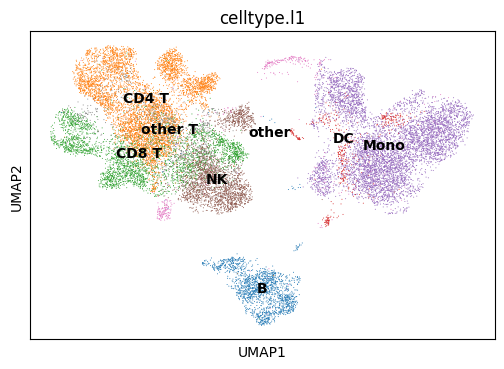

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


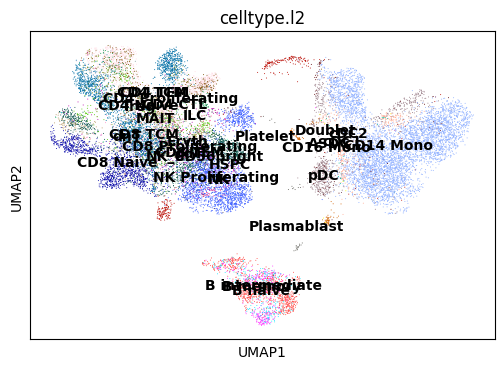

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


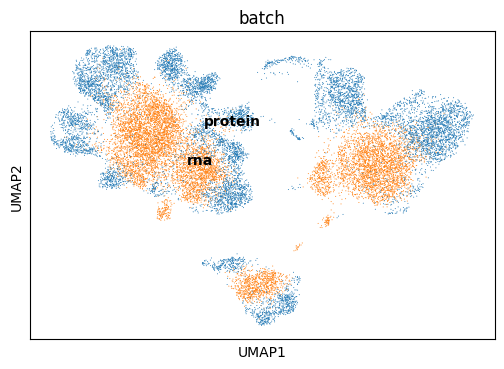

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


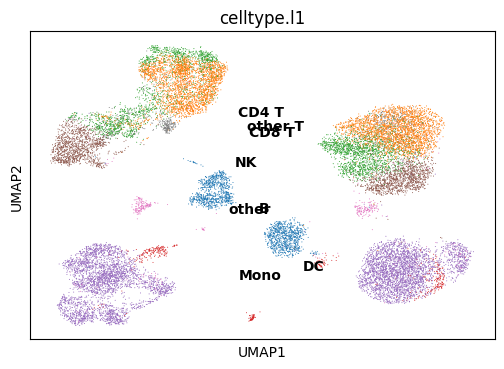

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


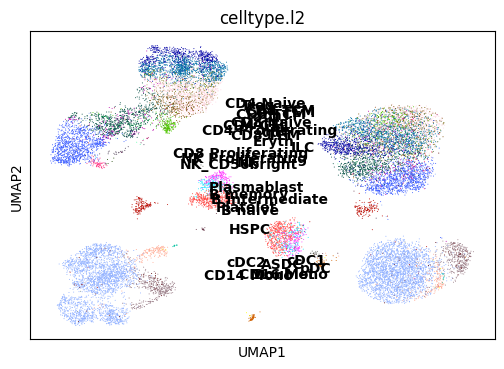

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


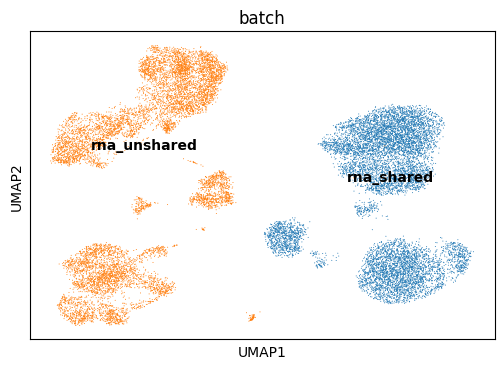

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


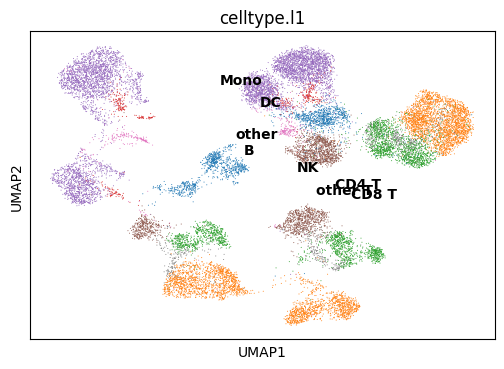

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


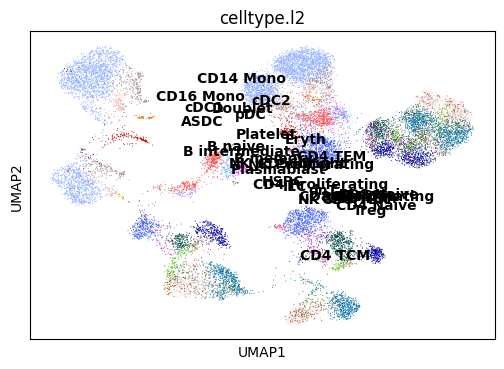

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


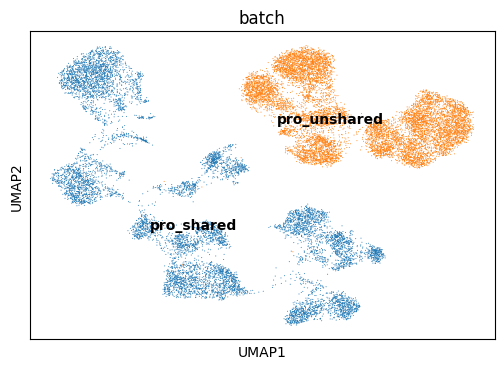

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For All matchings: lv1 matching acc: 0.740,
lv2 matching acc: 0.554.
For All matchings: FOSCTTM score: 0.23113469, 
Knn Alignment score: [0.001  0.0019 0.0031 0.0047 0.006  0.0074 0.0085 0.0094 0.0103 0.011
 0.0119 0.0133 0.0145 0.0154 0.0166 0.0178 0.019  0.0197 0.0201 0.0216
 0.0223 0.0229 0.0237 0.0247 0.0253]
For All matchings: Silhouette F1 score for lv1: 0.5097360116968601, 
Silhouette F1 score for lv2: 0.496305074780642



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  3.3694759607315063
Matchings are reduced to 5000 after filtering...


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:423: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[matchings[0]], labels_l1[matchings[1]])
C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For only filtered matchings: lv1 matching acc: 0.837,
lv2 matching acc: 0.650.



Matches are being propagated....


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:460: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[filtered_matchings[0]], labels_l1[filtered_matchings[1]])


Done!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For all matchings after propagation: lv1 matching acc: 0.769,
lv2 matching acc: 0.559.


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:495: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[propagated_matchings[0]], labels_l1[propagated_matchings[1]])


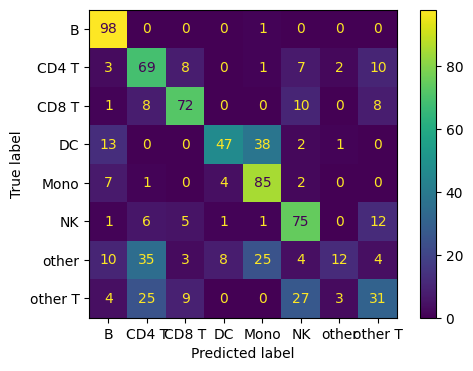

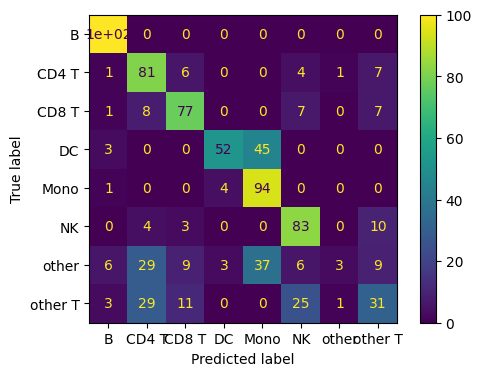

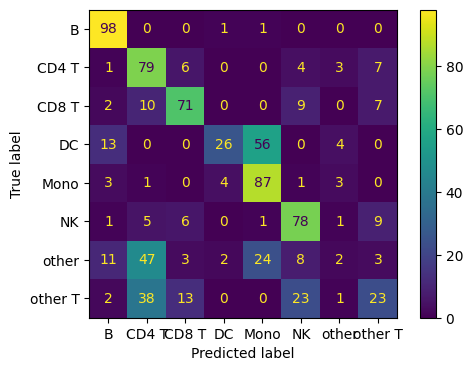

Epoch: 1801: 0it [00:00, ?it/s]C:\Users\vinee\AppData\Local\Temp\ipykernel_2144\3129631169.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return {"x_unshared":self.unshared_data[idx], "x_shared":self.shared_data[idx], "l1":self.labels_l1[idx], "l2":self.labels_l2[idx], "mean": self.local_mean[idx], "var": self.local_var[idx], "batch": self.batch[idx]}
Epoch: 1801: 40it [00:13,  3.05it/s]


RNA Recon Loss: 1.9887, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4187, Protein Recon Loss: 0.4846, Protein KL Div Back Pro: 0.8253, Protein KL Div Z: 0.6241, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5265, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7948 Cross Loss Protein: 0.5397


Epoch: 1802: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9867, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4182, Protein Recon Loss: 0.4846, Protein KL Div Back Pro: 0.8260, Protein KL Div Z: 0.6246, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2561, Shared Recon Loss Protein: 1.7929 Cross Loss Protein: 0.5393


Epoch: 1803: 40it [00:13,  3.05it/s]


RNA Recon Loss: 1.9872, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4189, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8257, Protein KL Div Z: 0.6262, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5267, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7957 Cross Loss Protein: 0.5400


Epoch: 1804: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9876, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4184, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8241, Protein KL Div Z: 0.6249, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5261, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7942 Cross Loss Protein: 0.5404


Epoch: 1805: 40it [00:13,  3.06it/s]


RNA Recon Loss: 1.9853, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4183, Protein Recon Loss: 0.4848, Protein KL Div Back Pro: 0.8272, Protein KL Div Z: 0.6236, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5262, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7939 Cross Loss Protein: 0.5397


Epoch: 1806: 40it [00:13,  3.04it/s]


RNA Recon Loss: 1.9877, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4189, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8240, Protein KL Div Z: 0.6237, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5262, Shared Recon Loss Gene: 0.2562, Shared Recon Loss Protein: 1.7929 Cross Loss Protein: 0.5397


Epoch: 1807: 40it [00:13,  2.96it/s]


RNA Recon Loss: 1.9881, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4184, Protein Recon Loss: 0.4871, Protein KL Div Back Pro: 0.8270, Protein KL Div Z: 0.6246, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5265, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7999 Cross Loss Protein: 0.5408


Epoch: 1808: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9945, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4187, Protein Recon Loss: 0.4848, Protein KL Div Back Pro: 0.8274, Protein KL Div Z: 0.6239, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5260, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7947 Cross Loss Protein: 0.5392


Epoch: 1809: 40it [00:13,  3.04it/s]


RNA Recon Loss: 1.9872, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4189, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8238, Protein KL Div Z: 0.6245, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5261, Shared Recon Loss Gene: 0.2559, Shared Recon Loss Protein: 1.7955 Cross Loss Protein: 0.5404


Epoch: 1810: 40it [00:13,  3.03it/s]


RNA Recon Loss: 1.9926, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4187, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8251, Protein KL Div Z: 0.6241, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5268, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7936 Cross Loss Protein: 0.5392


Epoch: 1811: 40it [00:13,  3.04it/s]


RNA Recon Loss: 1.9914, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4183, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8251, Protein KL Div Z: 0.6242, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5263, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7935 Cross Loss Protein: 0.5395


Epoch: 1812: 40it [00:13,  3.03it/s]


RNA Recon Loss: 1.9891, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4181, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8266, Protein KL Div Z: 0.6251, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2560, Shared Recon Loss Protein: 1.7964 Cross Loss Protein: 0.5403


Epoch: 1813: 40it [00:13,  3.04it/s]


RNA Recon Loss: 1.9921, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4183, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8279, Protein KL Div Z: 0.6257, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5268, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7938 Cross Loss Protein: 0.5396


Epoch: 1814: 40it [00:13,  3.03it/s]


RNA Recon Loss: 1.9875, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4187, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8259, Protein KL Div Z: 0.6248, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5268, Shared Recon Loss Gene: 0.2562, Shared Recon Loss Protein: 1.7928 Cross Loss Protein: 0.5398


Epoch: 1815: 40it [00:13,  3.03it/s]


RNA Recon Loss: 1.9969, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4181, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8255, Protein KL Div Z: 0.6236, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5272, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7962 Cross Loss Protein: 0.5402


Epoch: 1816: 40it [00:13,  2.94it/s]


RNA Recon Loss: 1.9890, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4182, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8266, Protein KL Div Z: 0.6234, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5263, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7937 Cross Loss Protein: 0.5395


Epoch: 1817: 40it [00:13,  2.99it/s]


RNA Recon Loss: 1.9881, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4187, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8254, Protein KL Div Z: 0.6254, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5266, Shared Recon Loss Gene: 0.2561, Shared Recon Loss Protein: 1.7948 Cross Loss Protein: 0.5396


Epoch: 1818: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9928, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4185, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8254, Protein KL Div Z: 0.6241, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5270, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7973 Cross Loss Protein: 0.5400


Epoch: 1819: 40it [00:13,  3.03it/s]


RNA Recon Loss: 1.9938, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4183, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8260, Protein KL Div Z: 0.6233, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5261, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7952 Cross Loss Protein: 0.5403


Epoch: 1820: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9941, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4181, Protein Recon Loss: 0.4848, Protein KL Div Back Pro: 0.8270, Protein KL Div Z: 0.6247, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5263, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7952 Cross Loss Protein: 0.5394


Epoch: 1821: 40it [00:13,  2.99it/s]


RNA Recon Loss: 1.9860, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4189, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8267, Protein KL Div Z: 0.6263, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5265, Shared Recon Loss Gene: 0.2561, Shared Recon Loss Protein: 1.7954 Cross Loss Protein: 0.5401


Epoch: 1822: 40it [00:13,  2.98it/s]


RNA Recon Loss: 1.9902, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4186, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8249, Protein KL Div Z: 0.6251, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5263, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7937 Cross Loss Protein: 0.5399


Epoch: 1823: 40it [00:13,  2.94it/s]


RNA Recon Loss: 1.9855, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4184, Protein Recon Loss: 0.4849, Protein KL Div Back Pro: 0.8261, Protein KL Div Z: 0.6249, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5260, Shared Recon Loss Gene: 0.2562, Shared Recon Loss Protein: 1.7937 Cross Loss Protein: 0.5394


Epoch: 1824: 40it [00:13,  2.99it/s]


RNA Recon Loss: 1.9955, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4187, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8248, Protein KL Div Z: 0.6239, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7939 Cross Loss Protein: 0.5389


Epoch: 1825: 40it [00:13,  2.97it/s]


RNA Recon Loss: 1.9871, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4188, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8246, Protein KL Div Z: 0.6241, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5266, Shared Recon Loss Gene: 0.2560, Shared Recon Loss Protein: 1.7952 Cross Loss Protein: 0.5401


Epoch: 1826: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9845, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4187, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8280, Protein KL Div Z: 0.6257, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5265, Shared Recon Loss Gene: 0.2557, Shared Recon Loss Protein: 1.7959 Cross Loss Protein: 0.5399


Epoch: 1827: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9927, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4191, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8251, Protein KL Div Z: 0.6248, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5262, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7944 Cross Loss Protein: 0.5395


Epoch: 1828: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9925, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4188, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8261, Protein KL Div Z: 0.6250, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5270, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7964 Cross Loss Protein: 0.5402


Epoch: 1829: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9885, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4185, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8270, Protein KL Div Z: 0.6260, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5259, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7941 Cross Loss Protein: 0.5389


Epoch: 1830: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9914, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4189, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8235, Protein KL Div Z: 0.6231, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7963 Cross Loss Protein: 0.5409


Epoch: 1831: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9920, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4185, Protein Recon Loss: 0.4849, Protein KL Div Back Pro: 0.8265, Protein KL Div Z: 0.6241, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5266, Shared Recon Loss Gene: 0.2560, Shared Recon Loss Protein: 1.7952 Cross Loss Protein: 0.5393


Epoch: 1832: 40it [00:13,  3.03it/s]


RNA Recon Loss: 1.9900, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4183, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8268, Protein KL Div Z: 0.6255, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5259, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7944 Cross Loss Protein: 0.5398


Epoch: 1833: 40it [00:13,  3.04it/s]


RNA Recon Loss: 1.9940, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4182, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8264, Protein KL Div Z: 0.6259, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5265, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7949 Cross Loss Protein: 0.5393


Epoch: 1834: 40it [00:13,  2.96it/s]


RNA Recon Loss: 1.9897, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4181, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8237, Protein KL Div Z: 0.6244, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5260, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7942 Cross Loss Protein: 0.5400


Epoch: 1835: 40it [00:13,  2.99it/s]


RNA Recon Loss: 1.9859, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4180, Protein Recon Loss: 0.4865, Protein KL Div Back Pro: 0.8256, Protein KL Div Z: 0.6247, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5265, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7946 Cross Loss Protein: 0.5401


Epoch: 1836: 40it [00:13,  3.03it/s]


RNA Recon Loss: 1.9905, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4185, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8271, Protein KL Div Z: 0.6252, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5265, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7955 Cross Loss Protein: 0.5400


Epoch: 1837: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9954, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4181, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8263, Protein KL Div Z: 0.6247, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7939 Cross Loss Protein: 0.5397


Epoch: 1838: 40it [00:13,  3.00it/s]


RNA Recon Loss: 1.9857, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4185, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8259, Protein KL Div Z: 0.6237, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5255, Shared Recon Loss Gene: 0.2562, Shared Recon Loss Protein: 1.7968 Cross Loss Protein: 0.5400


Epoch: 1839: 40it [00:13,  3.02it/s]


RNA Recon Loss: 2.0019, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4186, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8262, Protein KL Div Z: 0.6245, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5268, Shared Recon Loss Gene: 0.2587, Shared Recon Loss Protein: 1.7981 Cross Loss Protein: 0.5408


Epoch: 1840: 40it [00:13,  3.04it/s]


RNA Recon Loss: 1.9958, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4185, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8277, Protein KL Div Z: 0.6256, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5263, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7972 Cross Loss Protein: 0.5400


Epoch: 1841: 40it [00:13,  2.98it/s]


RNA Recon Loss: 1.9878, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4187, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8258, Protein KL Div Z: 0.6243, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5263, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7942 Cross Loss Protein: 0.5403


Epoch: 1842: 40it [00:13,  3.03it/s]


RNA Recon Loss: 1.9863, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4188, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8266, Protein KL Div Z: 0.6245, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5260, Shared Recon Loss Gene: 0.2560, Shared Recon Loss Protein: 1.7949 Cross Loss Protein: 0.5394


Epoch: 1843: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9930, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4184, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8269, Protein KL Div Z: 0.6253, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5261, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7957 Cross Loss Protein: 0.5401


Epoch: 1844: 40it [00:13,  2.91it/s]


RNA Recon Loss: 1.9899, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4188, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8259, Protein KL Div Z: 0.6239, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7939 Cross Loss Protein: 0.5395


Epoch: 1845: 40it [00:13,  2.96it/s]


RNA Recon Loss: 1.9948, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4193, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8278, Protein KL Div Z: 0.6258, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5261, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7945 Cross Loss Protein: 0.5392


Epoch: 1846: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9906, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4187, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8254, Protein KL Div Z: 0.6251, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5261, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7953 Cross Loss Protein: 0.5402


Epoch: 1847: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9878, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4183, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8272, Protein KL Div Z: 0.6248, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5256, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7958 Cross Loss Protein: 0.5396


Epoch: 1848: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9881, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4188, Protein Recon Loss: 0.4849, Protein KL Div Back Pro: 0.8255, Protein KL Div Z: 0.6241, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5270, Shared Recon Loss Gene: 0.2560, Shared Recon Loss Protein: 1.7934 Cross Loss Protein: 0.5391


Epoch: 1849: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9879, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4185, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8244, Protein KL Div Z: 0.6239, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5256, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7937 Cross Loss Protein: 0.5391


Epoch: 1850: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9911, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4188, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8246, Protein KL Div Z: 0.6254, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7946 Cross Loss Protein: 0.5398


Epoch: 1851: 40it [00:13,  3.00it/s]


RNA Recon Loss: 1.9956, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4188, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8282, Protein KL Div Z: 0.6254, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5257, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7940 Cross Loss Protein: 0.5407


Epoch: 1852: 40it [00:13,  2.96it/s]


RNA Recon Loss: 1.9914, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4183, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8263, Protein KL Div Z: 0.6255, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5263, Shared Recon Loss Gene: 0.2561, Shared Recon Loss Protein: 1.7956 Cross Loss Protein: 0.5395


Epoch: 1853: 40it [00:13,  2.95it/s]


RNA Recon Loss: 1.9934, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4188, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8254, Protein KL Div Z: 0.6242, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5266, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7959 Cross Loss Protein: 0.5398


Epoch: 1854: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9858, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4191, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8266, Protein KL Div Z: 0.6253, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5262, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7937 Cross Loss Protein: 0.5396


Epoch: 1855: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9871, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4189, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8254, Protein KL Div Z: 0.6250, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5259, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7965 Cross Loss Protein: 0.5401


Epoch: 1856: 40it [00:13,  3.00it/s]


RNA Recon Loss: 1.9890, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4189, Protein Recon Loss: 0.4849, Protein KL Div Back Pro: 0.8261, Protein KL Div Z: 0.6247, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5263, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7944 Cross Loss Protein: 0.5391


Epoch: 1857: 40it [00:13,  3.03it/s]


RNA Recon Loss: 1.9926, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4194, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8261, Protein KL Div Z: 0.6243, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7943 Cross Loss Protein: 0.5400


Epoch: 1858: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9957, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4186, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8273, Protein KL Div Z: 0.6258, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5259, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7974 Cross Loss Protein: 0.5400


Epoch: 1859: 40it [00:13,  3.04it/s]


RNA Recon Loss: 1.9895, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4190, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8247, Protein KL Div Z: 0.6237, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5272, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7962 Cross Loss Protein: 0.5394


Epoch: 1860: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9949, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4181, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8273, Protein KL Div Z: 0.6265, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5259, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7967 Cross Loss Protein: 0.5402


Epoch: 1861: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9896, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4184, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8276, Protein KL Div Z: 0.6263, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5262, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7943 Cross Loss Protein: 0.5395


Epoch: 1862: 40it [00:13,  2.92it/s]


RNA Recon Loss: 1.9853, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4187, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8259, Protein KL Div Z: 0.6251, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5257, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7965 Cross Loss Protein: 0.5404


Epoch: 1863: 40it [00:13,  2.99it/s]


RNA Recon Loss: 1.9938, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4183, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8282, Protein KL Div Z: 0.6249, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5268, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7975 Cross Loss Protein: 0.5404


Epoch: 1864: 40it [00:13,  2.97it/s]


RNA Recon Loss: 1.9869, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4187, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8270, Protein KL Div Z: 0.6253, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5266, Shared Recon Loss Gene: 0.2562, Shared Recon Loss Protein: 1.7995 Cross Loss Protein: 0.5404


Epoch: 1865: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9865, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4186, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8280, Protein KL Div Z: 0.6253, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7938 Cross Loss Protein: 0.5394


Epoch: 1866: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9932, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4183, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8250, Protein KL Div Z: 0.6237, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5263, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7944 Cross Loss Protein: 0.5401


Epoch: 1867: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9900, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4187, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8272, Protein KL Div Z: 0.6260, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5265, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7946 Cross Loss Protein: 0.5396


Epoch: 1868: 40it [00:13,  2.99it/s]


RNA Recon Loss: 2.0001, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4187, Protein Recon Loss: 0.4844, Protein KL Div Back Pro: 0.8256, Protein KL Div Z: 0.6255, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5261, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7946 Cross Loss Protein: 0.5390


Epoch: 1869: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9862, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4185, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8243, Protein KL Div Z: 0.6241, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5262, Shared Recon Loss Gene: 0.2559, Shared Recon Loss Protein: 1.7930 Cross Loss Protein: 0.5394


Epoch: 1870: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9884, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4186, Protein Recon Loss: 0.4849, Protein KL Div Back Pro: 0.8267, Protein KL Div Z: 0.6255, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5261, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7939 Cross Loss Protein: 0.5393


Epoch: 1871: 40it [00:13,  2.92it/s]


RNA Recon Loss: 1.9936, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4188, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8254, Protein KL Div Z: 0.6254, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5259, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7957 Cross Loss Protein: 0.5393


Epoch: 1872: 40it [00:13,  2.94it/s]


RNA Recon Loss: 1.9898, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4186, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8260, Protein KL Div Z: 0.6251, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5267, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7936 Cross Loss Protein: 0.5401


Epoch: 1873: 40it [00:13,  3.03it/s]


RNA Recon Loss: 1.9901, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4185, Protein Recon Loss: 0.4847, Protein KL Div Back Pro: 0.8241, Protein KL Div Z: 0.6246, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5268, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7941 Cross Loss Protein: 0.5395


Epoch: 1874: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9886, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4186, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8247, Protein KL Div Z: 0.6255, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5265, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7963 Cross Loss Protein: 0.5401


Epoch: 1875: 40it [00:13,  3.04it/s]


RNA Recon Loss: 1.9843, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4184, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8271, Protein KL Div Z: 0.6247, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5263, Shared Recon Loss Gene: 0.2555, Shared Recon Loss Protein: 1.7951 Cross Loss Protein: 0.5395


Epoch: 1876: 40it [00:13,  3.00it/s]


RNA Recon Loss: 1.9896, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4186, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8243, Protein KL Div Z: 0.6240, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5266, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7928 Cross Loss Protein: 0.5393


Epoch: 1877: 40it [00:13,  3.04it/s]


RNA Recon Loss: 1.9895, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4184, Protein Recon Loss: 0.4873, Protein KL Div Back Pro: 0.8268, Protein KL Div Z: 0.6235, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5263, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7993 Cross Loss Protein: 0.5412


Epoch: 1878: 40it [00:13,  2.99it/s]


RNA Recon Loss: 1.9896, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4183, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8273, Protein KL Div Z: 0.6257, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5262, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7955 Cross Loss Protein: 0.5395


Epoch: 1879: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9886, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4191, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8247, Protein KL Div Z: 0.6239, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5261, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7961 Cross Loss Protein: 0.5400


Epoch: 1880: 40it [00:13,  2.93it/s]


RNA Recon Loss: 1.9874, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4184, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8274, Protein KL Div Z: 0.6252, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5266, Shared Recon Loss Gene: 0.2559, Shared Recon Loss Protein: 1.7936 Cross Loss Protein: 0.5394


Epoch: 1881: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9878, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4185, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8257, Protein KL Div Z: 0.6249, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5261, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7952 Cross Loss Protein: 0.5397


Epoch: 1882: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9899, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4184, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8262, Protein KL Div Z: 0.6247, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5261, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7921 Cross Loss Protein: 0.5397


Epoch: 1883: 40it [00:13,  2.97it/s]


RNA Recon Loss: 1.9902, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4187, Protein Recon Loss: 0.4861, Protein KL Div Back Pro: 0.8257, Protein KL Div Z: 0.6258, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5262, Shared Recon Loss Gene: 0.2560, Shared Recon Loss Protein: 1.7956 Cross Loss Protein: 0.5401


Epoch: 1884: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9826, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4189, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8256, Protein KL Div Z: 0.6252, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2556, Shared Recon Loss Protein: 1.7961 Cross Loss Protein: 0.5399


Epoch: 1885: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9842, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4178, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8267, Protein KL Div Z: 0.6248, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5267, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7953 Cross Loss Protein: 0.5396


Epoch: 1886: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9867, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4179, Protein Recon Loss: 0.4848, Protein KL Div Back Pro: 0.8245, Protein KL Div Z: 0.6254, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5262, Shared Recon Loss Gene: 0.2557, Shared Recon Loss Protein: 1.7932 Cross Loss Protein: 0.5392


Epoch: 1887: 40it [00:13,  2.99it/s]


RNA Recon Loss: 1.9903, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4180, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8243, Protein KL Div Z: 0.6231, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5256, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7942 Cross Loss Protein: 0.5400


Epoch: 1888: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9867, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4183, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8252, Protein KL Div Z: 0.6242, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5268, Shared Recon Loss Gene: 0.2561, Shared Recon Loss Protein: 1.7953 Cross Loss Protein: 0.5395


Epoch: 1889: 40it [00:13,  2.93it/s]


RNA Recon Loss: 1.9897, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4186, Protein Recon Loss: 0.4843, Protein KL Div Back Pro: 0.8270, Protein KL Div Z: 0.6256, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5261, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7939 Cross Loss Protein: 0.5397


Epoch: 1890: 40it [00:13,  3.04it/s]


RNA Recon Loss: 1.9885, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4183, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8250, Protein KL Div Z: 0.6246, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5269, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7940 Cross Loss Protein: 0.5399


Epoch: 1891: 40it [00:13,  3.07it/s]


RNA Recon Loss: 1.9912, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4183, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8251, Protein KL Div Z: 0.6248, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5262, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7936 Cross Loss Protein: 0.5412


Epoch: 1892: 40it [00:13,  3.05it/s]


RNA Recon Loss: 1.9893, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4188, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8286, Protein KL Div Z: 0.6255, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5270, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7968 Cross Loss Protein: 0.5402


Epoch: 1893: 40it [00:12,  3.09it/s]


RNA Recon Loss: 1.9873, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4186, Protein Recon Loss: 0.4847, Protein KL Div Back Pro: 0.8260, Protein KL Div Z: 0.6252, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2562, Shared Recon Loss Protein: 1.7946 Cross Loss Protein: 0.5393


Epoch: 1894: 40it [00:13,  3.07it/s]


RNA Recon Loss: 1.9898, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4188, Protein Recon Loss: 0.4845, Protein KL Div Back Pro: 0.8267, Protein KL Div Z: 0.6258, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5265, Shared Recon Loss Gene: 0.2561, Shared Recon Loss Protein: 1.7951 Cross Loss Protein: 0.5393


Epoch: 1895: 40it [00:13,  3.07it/s]


RNA Recon Loss: 1.9954, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4184, Protein Recon Loss: 0.4849, Protein KL Div Back Pro: 0.8228, Protein KL Div Z: 0.6237, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5263, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7918 Cross Loss Protein: 0.5396


Epoch: 1896: 40it [00:13,  3.08it/s]


RNA Recon Loss: 1.9947, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4182, Protein Recon Loss: 0.4866, Protein KL Div Back Pro: 0.8267, Protein KL Div Z: 0.6249, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5258, Shared Recon Loss Gene: 0.2571, Shared Recon Loss Protein: 1.7944 Cross Loss Protein: 0.5399


Epoch: 1897: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9936, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4188, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8243, Protein KL Div Z: 0.6241, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7956 Cross Loss Protein: 0.5396


Epoch: 1898: 40it [00:13,  2.99it/s]


RNA Recon Loss: 1.9915, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4187, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8279, Protein KL Div Z: 0.6262, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5267, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7957 Cross Loss Protein: 0.5405


Epoch: 1899: 40it [00:13,  2.93it/s]


RNA Recon Loss: 1.9917, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4185, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8269, Protein KL Div Z: 0.6255, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5262, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7924 Cross Loss Protein: 0.5394


Epoch: 1900: 40it [00:13,  2.99it/s]


RNA Recon Loss: 1.9879, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4186, Protein Recon Loss: 0.4859, Protein KL Div Back Pro: 0.8244, Protein KL Div Z: 0.6254, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5260, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7970 Cross Loss Protein: 0.5403


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


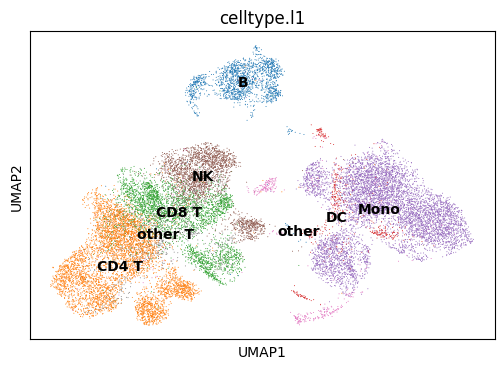

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


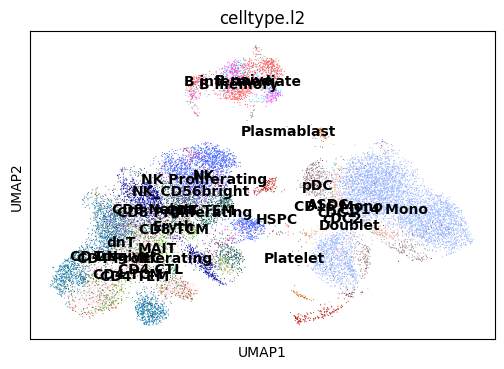

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


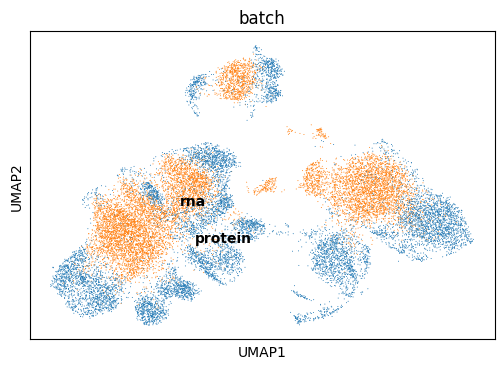

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


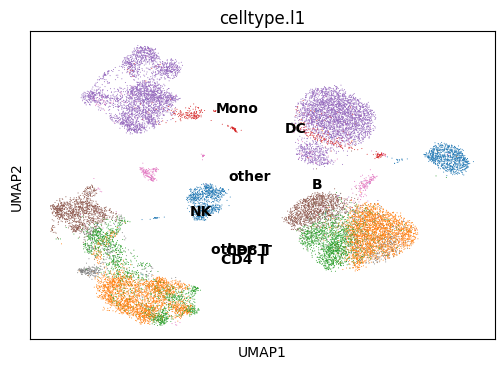

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


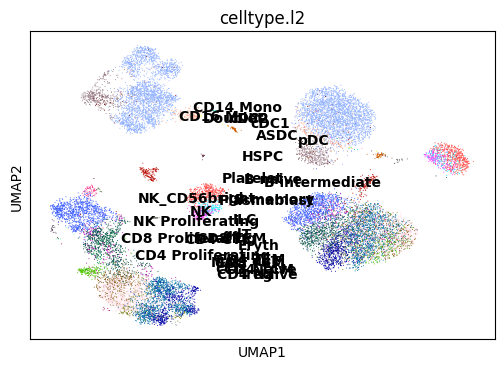

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


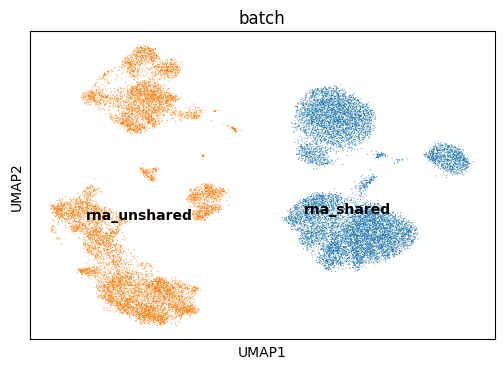

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


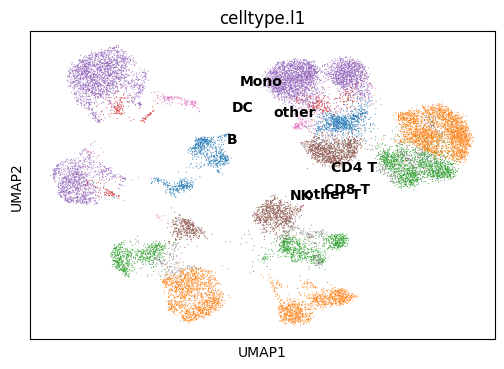

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


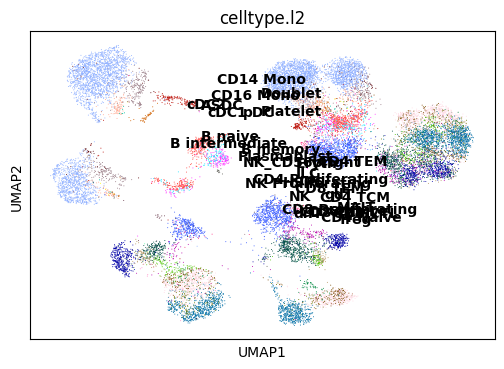

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


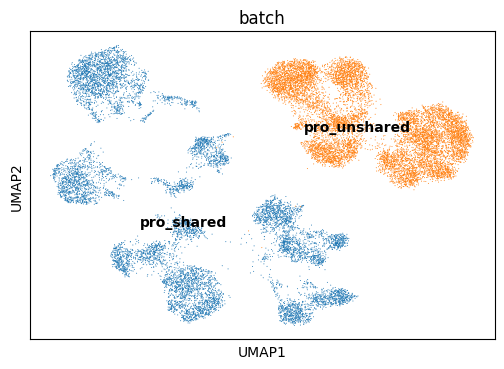

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For All matchings: lv1 matching acc: 0.727,
lv2 matching acc: 0.542.
For All matchings: FOSCTTM score: 0.23106258, 
Knn Alignment score: [0.0012 0.0024 0.0033 0.0039 0.0044 0.0064 0.0073 0.0075 0.0083 0.0088
 0.0097 0.0101 0.0109 0.0117 0.0126 0.0134 0.0142 0.0151 0.016  0.0172
 0.0183 0.0192 0.0203 0.0215 0.0222]
For All matchings: Silhouette F1 score for lv1: 0.5095569522331083, 
Silhouette F1 score for lv2: 0.4962791704373064



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  3.34678053855896
Matchings are reduced to 5000 after filtering...


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:423: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[matchings[0]], labels_l1[matchings[1]])
C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For only filtered matchings: lv1 matching acc: 0.824,
lv2 matching acc: 0.634.



Matches are being propagated....


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:460: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[filtered_matchings[0]], labels_l1[filtered_matchings[1]])


Done!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For all matchings after propagation: lv1 matching acc: 0.774,
lv2 matching acc: 0.559.


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:495: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[propagated_matchings[0]], labels_l1[propagated_matchings[1]])


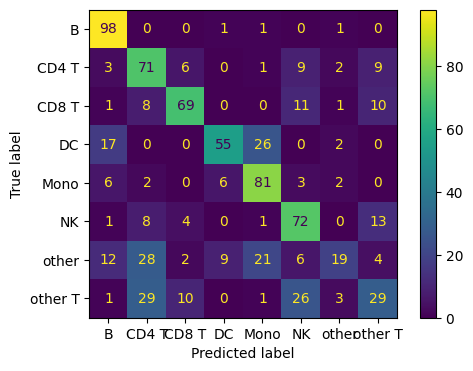

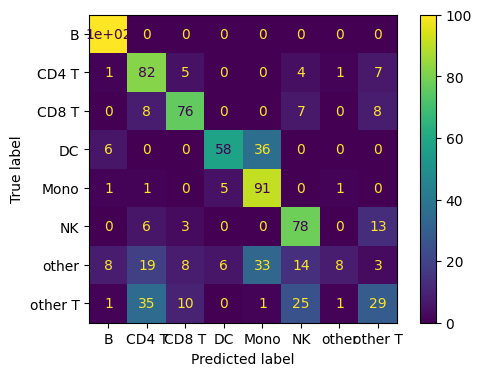

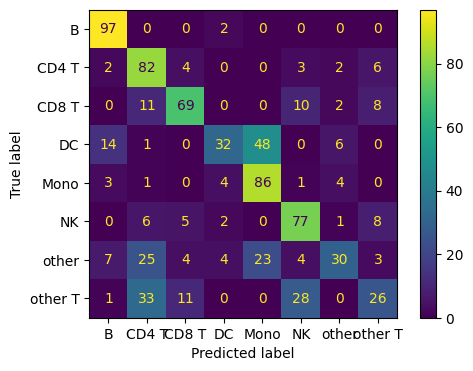

Epoch: 1901: 0it [00:00, ?it/s]C:\Users\vinee\AppData\Local\Temp\ipykernel_2144\3129631169.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return {"x_unshared":self.unshared_data[idx], "x_shared":self.shared_data[idx], "l1":self.labels_l1[idx], "l2":self.labels_l2[idx], "mean": self.local_mean[idx], "var": self.local_var[idx], "batch": self.batch[idx]}
Epoch: 1901: 40it [00:13,  2.98it/s]


RNA Recon Loss: 1.9887, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4183, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8270, Protein KL Div Z: 0.6253, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5263, Shared Recon Loss Gene: 0.2559, Shared Recon Loss Protein: 1.7966 Cross Loss Protein: 0.5401


Epoch: 1902: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9962, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4184, Protein Recon Loss: 0.4873, Protein KL Div Back Pro: 0.8268, Protein KL Div Z: 0.6250, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5256, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7985 Cross Loss Protein: 0.5420


Epoch: 1903: 40it [00:13,  3.06it/s]


RNA Recon Loss: 1.9894, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4186, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8290, Protein KL Div Z: 0.6257, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5269, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7962 Cross Loss Protein: 0.5402


Epoch: 1904: 40it [00:13,  2.97it/s]


RNA Recon Loss: 1.9892, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4190, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8264, Protein KL Div Z: 0.6244, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5268, Shared Recon Loss Gene: 0.2562, Shared Recon Loss Protein: 1.7973 Cross Loss Protein: 0.5397


Epoch: 1905: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9843, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4182, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8258, Protein KL Div Z: 0.6249, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5266, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7950 Cross Loss Protein: 0.5397


Epoch: 1906: 40it [00:13,  2.95it/s]


RNA Recon Loss: 1.9916, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4184, Protein Recon Loss: 0.4869, Protein KL Div Back Pro: 0.8259, Protein KL Div Z: 0.6248, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7967 Cross Loss Protein: 0.5400


Epoch: 1907: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9941, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4188, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8285, Protein KL Div Z: 0.6253, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5263, Shared Recon Loss Gene: 0.2577, Shared Recon Loss Protein: 1.7966 Cross Loss Protein: 0.5404


Epoch: 1908: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9885, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4188, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8280, Protein KL Div Z: 0.6268, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5266, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7943 Cross Loss Protein: 0.5390


Epoch: 1909: 40it [00:13,  2.96it/s]


RNA Recon Loss: 1.9875, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4185, Protein Recon Loss: 0.4870, Protein KL Div Back Pro: 0.8248, Protein KL Div Z: 0.6238, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5262, Shared Recon Loss Gene: 0.2560, Shared Recon Loss Protein: 1.7986 Cross Loss Protein: 0.5410


Epoch: 1910: 40it [00:13,  2.99it/s]


RNA Recon Loss: 1.9859, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4186, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8278, Protein KL Div Z: 0.6254, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5266, Shared Recon Loss Gene: 0.2561, Shared Recon Loss Protein: 1.7953 Cross Loss Protein: 0.5396


Epoch: 1911: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9888, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4183, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8256, Protein KL Div Z: 0.6247, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5266, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7940 Cross Loss Protein: 0.5392


Epoch: 1912: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9943, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4183, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8263, Protein KL Div Z: 0.6251, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5265, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7954 Cross Loss Protein: 0.5402


Epoch: 1913: 40it [00:13,  3.03it/s]


RNA Recon Loss: 1.9923, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4182, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8251, Protein KL Div Z: 0.6245, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5266, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7956 Cross Loss Protein: 0.5399


Epoch: 1914: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9842, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4180, Protein Recon Loss: 0.4848, Protein KL Div Back Pro: 0.8261, Protein KL Div Z: 0.6249, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2553, Shared Recon Loss Protein: 1.7952 Cross Loss Protein: 0.5398


Epoch: 1915: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9891, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4191, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8264, Protein KL Div Z: 0.6252, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5270, Shared Recon Loss Gene: 0.2575, Shared Recon Loss Protein: 1.7948 Cross Loss Protein: 0.5400


Epoch: 1916: 40it [00:13,  2.99it/s]


RNA Recon Loss: 1.9893, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4190, Protein Recon Loss: 0.4849, Protein KL Div Back Pro: 0.8268, Protein KL Div Z: 0.6250, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7943 Cross Loss Protein: 0.5396


Epoch: 1917: 40it [00:13,  3.03it/s]


RNA Recon Loss: 1.9871, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4187, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8251, Protein KL Div Z: 0.6250, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5265, Shared Recon Loss Gene: 0.2561, Shared Recon Loss Protein: 1.7966 Cross Loss Protein: 0.5399


Epoch: 1918: 40it [00:13,  2.90it/s]


RNA Recon Loss: 1.9962, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4183, Protein Recon Loss: 0.4848, Protein KL Div Back Pro: 0.8265, Protein KL Div Z: 0.6271, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5266, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7960 Cross Loss Protein: 0.5399


Epoch: 1919: 40it [00:13,  2.99it/s]


RNA Recon Loss: 1.9893, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4185, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8271, Protein KL Div Z: 0.6262, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5265, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7955 Cross Loss Protein: 0.5397


Epoch: 1920: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9960, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4187, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8243, Protein KL Div Z: 0.6245, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5259, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7926 Cross Loss Protein: 0.5397


Epoch: 1921: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9890, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4186, Protein Recon Loss: 0.4873, Protein KL Div Back Pro: 0.8257, Protein KL Div Z: 0.6250, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5262, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7986 Cross Loss Protein: 0.5415


Epoch: 1922: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9917, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4187, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8260, Protein KL Div Z: 0.6250, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5262, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7954 Cross Loss Protein: 0.5398


Epoch: 1923: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9905, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4185, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8296, Protein KL Div Z: 0.6249, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5270, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7961 Cross Loss Protein: 0.5393


Epoch: 1924: 40it [00:13,  2.92it/s]


RNA Recon Loss: 1.9938, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4191, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8266, Protein KL Div Z: 0.6256, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5262, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7950 Cross Loss Protein: 0.5394


Epoch: 1925: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9928, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4186, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8265, Protein KL Div Z: 0.6246, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5262, Shared Recon Loss Gene: 0.2561, Shared Recon Loss Protein: 1.7966 Cross Loss Protein: 0.5406


Epoch: 1926: 40it [00:13,  3.00it/s]


RNA Recon Loss: 1.9929, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4189, Protein Recon Loss: 0.4849, Protein KL Div Back Pro: 0.8256, Protein KL Div Z: 0.6256, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5259, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7945 Cross Loss Protein: 0.5395


Epoch: 1927: 40it [00:13,  2.91it/s]


RNA Recon Loss: 1.9850, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4187, Protein Recon Loss: 0.4849, Protein KL Div Back Pro: 0.8255, Protein KL Div Z: 0.6245, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5260, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7956 Cross Loss Protein: 0.5394


Epoch: 1928: 40it [00:13,  2.98it/s]


RNA Recon Loss: 1.9879, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4190, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8270, Protein KL Div Z: 0.6250, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5261, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7961 Cross Loss Protein: 0.5397


Epoch: 1929: 40it [00:13,  3.00it/s]


RNA Recon Loss: 1.9897, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4180, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8243, Protein KL Div Z: 0.6247, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5256, Shared Recon Loss Gene: 0.2562, Shared Recon Loss Protein: 1.7950 Cross Loss Protein: 0.5404


Epoch: 1930: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9930, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4183, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8267, Protein KL Div Z: 0.6238, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5271, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.7963 Cross Loss Protein: 0.5397


Epoch: 1931: 40it [00:13,  3.00it/s]


RNA Recon Loss: 1.9981, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4189, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8261, Protein KL Div Z: 0.6251, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5261, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7944 Cross Loss Protein: 0.5395


Epoch: 1932: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9942, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4185, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8247, Protein KL Div Z: 0.6250, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7948 Cross Loss Protein: 0.5394


Epoch: 1933: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9926, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4180, Protein Recon Loss: 0.4844, Protein KL Div Back Pro: 0.8261, Protein KL Div Z: 0.6244, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5263, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7926 Cross Loss Protein: 0.5386


Epoch: 1934: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9893, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4184, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8264, Protein KL Div Z: 0.6244, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7970 Cross Loss Protein: 0.5395


Epoch: 1935: 40it [00:13,  3.03it/s]


RNA Recon Loss: 1.9893, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4187, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8245, Protein KL Div Z: 0.6256, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5263, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7936 Cross Loss Protein: 0.5396


Epoch: 1936: 40it [00:13,  2.92it/s]


RNA Recon Loss: 1.9901, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4191, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8254, Protein KL Div Z: 0.6244, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5262, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7975 Cross Loss Protein: 0.5407


Epoch: 1937: 40it [00:13,  3.00it/s]


RNA Recon Loss: 1.9874, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4182, Protein Recon Loss: 0.4863, Protein KL Div Back Pro: 0.8259, Protein KL Div Z: 0.6256, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5255, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7943 Cross Loss Protein: 0.5404


Epoch: 1938: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9901, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4181, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8278, Protein KL Div Z: 0.6253, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2560, Shared Recon Loss Protein: 1.7954 Cross Loss Protein: 0.5393


Epoch: 1939: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9868, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4180, Protein Recon Loss: 0.4864, Protein KL Div Back Pro: 0.8240, Protein KL Div Z: 0.6238, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5260, Shared Recon Loss Gene: 0.2553, Shared Recon Loss Protein: 1.7962 Cross Loss Protein: 0.5402


Epoch: 1940: 40it [00:13,  3.03it/s]


RNA Recon Loss: 1.9931, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4185, Protein Recon Loss: 0.4846, Protein KL Div Back Pro: 0.8281, Protein KL Div Z: 0.6247, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7945 Cross Loss Protein: 0.5392


Epoch: 1941: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9863, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4185, Protein Recon Loss: 0.4848, Protein KL Div Back Pro: 0.8267, Protein KL Div Z: 0.6251, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7931 Cross Loss Protein: 0.5392


Epoch: 1942: 40it [00:13,  3.00it/s]


RNA Recon Loss: 1.9886, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4185, Protein Recon Loss: 0.4845, Protein KL Div Back Pro: 0.8248, Protein KL Div Z: 0.6246, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5256, Shared Recon Loss Gene: 0.2559, Shared Recon Loss Protein: 1.7927 Cross Loss Protein: 0.5399


Epoch: 1943: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9903, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4180, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8268, Protein KL Div Z: 0.6268, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5263, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7954 Cross Loss Protein: 0.5395


Epoch: 1944: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9900, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4191, Protein Recon Loss: 0.4870, Protein KL Div Back Pro: 0.8262, Protein KL Div Z: 0.6255, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7986 Cross Loss Protein: 0.5404


Epoch: 1945: 40it [00:13,  2.93it/s]


RNA Recon Loss: 1.9906, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4184, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8273, Protein KL Div Z: 0.6254, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2561, Shared Recon Loss Protein: 1.7938 Cross Loss Protein: 0.5396


Epoch: 1946: 40it [00:13,  2.91it/s]


RNA Recon Loss: 1.9857, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4182, Protein Recon Loss: 0.4878, Protein KL Div Back Pro: 0.8266, Protein KL Div Z: 0.6256, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7991 Cross Loss Protein: 0.5411


Epoch: 1947: 40it [00:14,  2.82it/s]


RNA Recon Loss: 1.9968, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4186, Protein Recon Loss: 0.4846, Protein KL Div Back Pro: 0.8269, Protein KL Div Z: 0.6247, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7934 Cross Loss Protein: 0.5387


Epoch: 1948: 40it [00:13,  2.91it/s]


RNA Recon Loss: 1.9863, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4188, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8267, Protein KL Div Z: 0.6252, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5258, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7938 Cross Loss Protein: 0.5399


Epoch: 1949: 40it [00:13,  2.90it/s]


RNA Recon Loss: 1.9903, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4180, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8263, Protein KL Div Z: 0.6246, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5263, Shared Recon Loss Gene: 0.2560, Shared Recon Loss Protein: 1.7941 Cross Loss Protein: 0.5391


Epoch: 1950: 40it [00:13,  2.95it/s]


RNA Recon Loss: 1.9895, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4184, Protein Recon Loss: 0.4848, Protein KL Div Back Pro: 0.8259, Protein KL Div Z: 0.6259, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5261, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7956 Cross Loss Protein: 0.5396


Epoch: 1951: 40it [00:13,  2.97it/s]


RNA Recon Loss: 1.9900, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4182, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8255, Protein KL Div Z: 0.6252, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5258, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7943 Cross Loss Protein: 0.5394


Epoch: 1952: 40it [00:13,  2.99it/s]


RNA Recon Loss: 1.9957, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4181, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8257, Protein KL Div Z: 0.6246, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5265, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7951 Cross Loss Protein: 0.5398


Epoch: 1953: 40it [00:13,  2.95it/s]


RNA Recon Loss: 1.9874, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4184, Protein Recon Loss: 0.4848, Protein KL Div Back Pro: 0.8265, Protein KL Div Z: 0.6250, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2561, Shared Recon Loss Protein: 1.7944 Cross Loss Protein: 0.5393


Epoch: 1954: 40it [00:13,  2.90it/s]


RNA Recon Loss: 1.9897, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4189, Protein Recon Loss: 0.4845, Protein KL Div Back Pro: 0.8255, Protein KL Div Z: 0.6241, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5258, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7917 Cross Loss Protein: 0.5393


Epoch: 1955: 40it [00:13,  2.98it/s]


RNA Recon Loss: 1.9859, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4182, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8256, Protein KL Div Z: 0.6258, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5262, Shared Recon Loss Gene: 0.2561, Shared Recon Loss Protein: 1.7935 Cross Loss Protein: 0.5394


Epoch: 1956: 40it [00:13,  2.95it/s]


RNA Recon Loss: 1.9918, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4186, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8252, Protein KL Div Z: 0.6254, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5261, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7980 Cross Loss Protein: 0.5398


Epoch: 1957: 40it [00:13,  2.97it/s]


RNA Recon Loss: 1.9890, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4183, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8269, Protein KL Div Z: 0.6251, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5260, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7958 Cross Loss Protein: 0.5399


Epoch: 1958: 40it [00:13,  2.97it/s]


RNA Recon Loss: 1.9881, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4184, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8256, Protein KL Div Z: 0.6242, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2573, Shared Recon Loss Protein: 1.7954 Cross Loss Protein: 0.5395


Epoch: 1959: 40it [00:13,  2.98it/s]


RNA Recon Loss: 1.9912, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4185, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8248, Protein KL Div Z: 0.6241, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5259, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7962 Cross Loss Protein: 0.5398


Epoch: 1960: 40it [00:13,  2.98it/s]


RNA Recon Loss: 1.9915, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4186, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8258, Protein KL Div Z: 0.6235, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5259, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7965 Cross Loss Protein: 0.5396


Epoch: 1961: 40it [00:13,  2.99it/s]


RNA Recon Loss: 1.9857, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4185, Protein Recon Loss: 0.4846, Protein KL Div Back Pro: 0.8257, Protein KL Div Z: 0.6247, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5257, Shared Recon Loss Gene: 0.2561, Shared Recon Loss Protein: 1.7937 Cross Loss Protein: 0.5394


Epoch: 1962: 40it [00:13,  2.97it/s]


RNA Recon Loss: 1.9914, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4178, Protein Recon Loss: 0.4857, Protein KL Div Back Pro: 0.8258, Protein KL Div Z: 0.6249, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5265, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7933 Cross Loss Protein: 0.5410


Epoch: 1963: 40it [00:13,  2.90it/s]


RNA Recon Loss: 1.9922, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4186, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8251, Protein KL Div Z: 0.6247, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5263, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7938 Cross Loss Protein: 0.5396


Epoch: 1964: 40it [00:13,  2.91it/s]


RNA Recon Loss: 1.9907, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4187, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8256, Protein KL Div Z: 0.6251, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5262, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7940 Cross Loss Protein: 0.5391


Epoch: 1965: 40it [00:13,  3.02it/s]


RNA Recon Loss: 2.0049, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4185, Protein Recon Loss: 0.4860, Protein KL Div Back Pro: 0.8251, Protein KL Div Z: 0.6237, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5260, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7938 Cross Loss Protein: 0.5405


Epoch: 1966: 40it [00:13,  3.03it/s]


RNA Recon Loss: 1.9906, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4183, Protein Recon Loss: 0.4847, Protein KL Div Back Pro: 0.8271, Protein KL Div Z: 0.6246, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5266, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7954 Cross Loss Protein: 0.5394


Epoch: 1967: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9895, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4186, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8266, Protein KL Div Z: 0.6261, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5262, Shared Recon Loss Gene: 0.2562, Shared Recon Loss Protein: 1.7940 Cross Loss Protein: 0.5392


Epoch: 1968: 40it [00:13,  3.03it/s]


RNA Recon Loss: 1.9949, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4185, Protein Recon Loss: 0.4868, Protein KL Div Back Pro: 0.8264, Protein KL Div Z: 0.6256, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5260, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7981 Cross Loss Protein: 0.5409


Epoch: 1969: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9942, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4184, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8273, Protein KL Div Z: 0.6251, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5268, Shared Recon Loss Gene: 0.2570, Shared Recon Loss Protein: 1.7947 Cross Loss Protein: 0.5394


Epoch: 1970: 40it [00:13,  3.04it/s]


RNA Recon Loss: 1.9892, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4184, Protein Recon Loss: 0.4847, Protein KL Div Back Pro: 0.8275, Protein KL Div Z: 0.6253, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5267, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7965 Cross Loss Protein: 0.5394


Epoch: 1971: 40it [00:13,  3.04it/s]


RNA Recon Loss: 1.9839, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4182, Protein Recon Loss: 0.4848, Protein KL Div Back Pro: 0.8268, Protein KL Div Z: 0.6258, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2560, Shared Recon Loss Protein: 1.7937 Cross Loss Protein: 0.5390


Epoch: 1972: 40it [00:13,  2.87it/s]


RNA Recon Loss: 1.9975, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4181, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8250, Protein KL Div Z: 0.6254, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5257, Shared Recon Loss Gene: 0.2576, Shared Recon Loss Protein: 1.7936 Cross Loss Protein: 0.5397


Epoch: 1973: 40it [00:13,  3.00it/s]


RNA Recon Loss: 1.9909, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4183, Protein Recon Loss: 0.4852, Protein KL Div Back Pro: 0.8254, Protein KL Div Z: 0.6247, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5263, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.7964 Cross Loss Protein: 0.5395


Epoch: 1974: 40it [00:13,  3.03it/s]


RNA Recon Loss: 1.9881, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4186, Protein Recon Loss: 0.4847, Protein KL Div Back Pro: 0.8252, Protein KL Div Z: 0.6244, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5258, Shared Recon Loss Gene: 0.2560, Shared Recon Loss Protein: 1.7929 Cross Loss Protein: 0.5399


Epoch: 1975: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9904, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4185, Protein Recon Loss: 0.4849, Protein KL Div Back Pro: 0.8259, Protein KL Div Z: 0.6257, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5258, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7930 Cross Loss Protein: 0.5390


Epoch: 1976: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9915, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4189, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8259, Protein KL Div Z: 0.6258, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5260, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7948 Cross Loss Protein: 0.5404


Epoch: 1977: 40it [00:13,  3.04it/s]


RNA Recon Loss: 1.9918, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4185, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8270, Protein KL Div Z: 0.6257, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5273, Shared Recon Loss Gene: 0.2572, Shared Recon Loss Protein: 1.7958 Cross Loss Protein: 0.5402


Epoch: 1978: 40it [00:13,  3.01it/s]


RNA Recon Loss: 2.0038, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4190, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8267, Protein KL Div Z: 0.6256, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5265, Shared Recon Loss Gene: 0.2577, Shared Recon Loss Protein: 1.7946 Cross Loss Protein: 0.5392


Epoch: 1979: 40it [00:13,  3.03it/s]


RNA Recon Loss: 1.9872, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4181, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8256, Protein KL Div Z: 0.6252, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5263, Shared Recon Loss Gene: 0.2561, Shared Recon Loss Protein: 1.7955 Cross Loss Protein: 0.5400


Epoch: 1980: 40it [00:13,  2.99it/s]


RNA Recon Loss: 1.9890, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4182, Protein Recon Loss: 0.4858, Protein KL Div Back Pro: 0.8275, Protein KL Div Z: 0.6265, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7955 Cross Loss Protein: 0.5398


Epoch: 1981: 40it [00:13,  2.92it/s]


RNA Recon Loss: 1.9877, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4183, Protein Recon Loss: 0.4848, Protein KL Div Back Pro: 0.8255, Protein KL Div Z: 0.6253, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5263, Shared Recon Loss Gene: 0.2562, Shared Recon Loss Protein: 1.7944 Cross Loss Protein: 0.5390


Epoch: 1982: 40it [00:13,  2.98it/s]


RNA Recon Loss: 1.9865, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4186, Protein Recon Loss: 0.4847, Protein KL Div Back Pro: 0.8235, Protein KL Div Z: 0.6245, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5251, Shared Recon Loss Gene: 0.2560, Shared Recon Loss Protein: 1.7943 Cross Loss Protein: 0.5389


Epoch: 1983: 40it [00:13,  2.98it/s]


RNA Recon Loss: 1.9997, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4190, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8258, Protein KL Div Z: 0.6257, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5268, Shared Recon Loss Gene: 0.2578, Shared Recon Loss Protein: 1.7969 Cross Loss Protein: 0.5398


Epoch: 1984: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9860, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4181, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8287, Protein KL Div Z: 0.6272, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5265, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7962 Cross Loss Protein: 0.5399


Epoch: 1985: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9902, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4189, Protein Recon Loss: 0.4885, Protein KL Div Back Pro: 0.8247, Protein KL Div Z: 0.6250, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5258, Shared Recon Loss Gene: 0.2564, Shared Recon Loss Protein: 1.8001 Cross Loss Protein: 0.5417


Epoch: 1986: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9887, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4182, Protein Recon Loss: 0.4872, Protein KL Div Back Pro: 0.8292, Protein KL Div Z: 0.6269, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5265, Shared Recon Loss Gene: 0.2569, Shared Recon Loss Protein: 1.8007 Cross Loss Protein: 0.5408


Epoch: 1987: 40it [00:13,  2.99it/s]


RNA Recon Loss: 1.9925, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4187, Protein Recon Loss: 0.4847, Protein KL Div Back Pro: 0.8280, Protein KL Div Z: 0.6253, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5265, Shared Recon Loss Gene: 0.2574, Shared Recon Loss Protein: 1.7937 Cross Loss Protein: 0.5391


Epoch: 1988: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9901, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4184, Protein Recon Loss: 0.4848, Protein KL Div Back Pro: 0.8262, Protein KL Div Z: 0.6251, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5263, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7938 Cross Loss Protein: 0.5389


Epoch: 1989: 40it [00:13,  3.02it/s]


RNA Recon Loss: 1.9902, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4182, Protein Recon Loss: 0.4850, Protein KL Div Back Pro: 0.8227, Protein KL Div Z: 0.6242, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5258, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7951 Cross Loss Protein: 0.5398


Epoch: 1990: 40it [00:13,  2.99it/s]


RNA Recon Loss: 1.9867, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4184, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8281, Protein KL Div Z: 0.6265, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5261, Shared Recon Loss Gene: 0.2559, Shared Recon Loss Protein: 1.7981 Cross Loss Protein: 0.5407


Epoch: 1991: 40it [00:13,  2.94it/s]


RNA Recon Loss: 1.9855, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4182, Protein Recon Loss: 0.4855, Protein KL Div Back Pro: 0.8268, Protein KL Div Z: 0.6247, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5265, Shared Recon Loss Gene: 0.2559, Shared Recon Loss Protein: 1.7936 Cross Loss Protein: 0.5394


Epoch: 1992: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9904, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4185, Protein Recon Loss: 0.4849, Protein KL Div Back Pro: 0.8253, Protein KL Div Z: 0.6262, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5259, Shared Recon Loss Gene: 0.2565, Shared Recon Loss Protein: 1.7925 Cross Loss Protein: 0.5389


Epoch: 1993: 40it [00:13,  3.03it/s]


RNA Recon Loss: 1.9866, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4186, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8253, Protein KL Div Z: 0.6249, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5265, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7944 Cross Loss Protein: 0.5401


Epoch: 1994: 40it [00:13,  2.98it/s]


RNA Recon Loss: 1.9904, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4181, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8258, Protein KL Div Z: 0.6259, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5261, Shared Recon Loss Gene: 0.2563, Shared Recon Loss Protein: 1.7956 Cross Loss Protein: 0.5405


Epoch: 1995: 40it [00:13,  3.01it/s]


RNA Recon Loss: 1.9865, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4186, Protein Recon Loss: 0.4853, Protein KL Div Back Pro: 0.8268, Protein KL Div Z: 0.6242, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2562, Shared Recon Loss Protein: 1.7974 Cross Loss Protein: 0.5400


Epoch: 1996: 40it [00:13,  2.95it/s]


RNA Recon Loss: 1.9926, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4183, Protein Recon Loss: 0.4856, Protein KL Div Back Pro: 0.8265, Protein KL Div Z: 0.6256, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5268, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7985 Cross Loss Protein: 0.5400


Epoch: 1997: 40it [00:13,  3.00it/s]


RNA Recon Loss: 1.9871, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4181, Protein Recon Loss: 0.4862, Protein KL Div Back Pro: 0.8267, Protein KL Div Z: 0.6266, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2566, Shared Recon Loss Protein: 1.7957 Cross Loss Protein: 0.5406


Epoch: 1998: 40it [00:13,  3.00it/s]


RNA Recon Loss: 1.9885, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4184, Protein Recon Loss: 0.4854, Protein KL Div Back Pro: 0.8264, Protein KL Div Z: 0.6249, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5257, Shared Recon Loss Gene: 0.2567, Shared Recon Loss Protein: 1.7935 Cross Loss Protein: 0.5393


Epoch: 1999: 40it [00:13,  3.00it/s]


RNA Recon Loss: 1.9854, RNA KL Div L: 0.0145, RNA KL Div Z: 0.4186, Protein Recon Loss: 0.4851, Protein KL Div Back Pro: 0.8249, Protein KL Div Z: 0.6244, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5261, Shared Recon Loss Gene: 0.2559, Shared Recon Loss Protein: 1.7949 Cross Loss Protein: 0.5391


Epoch: 2000: 40it [00:13,  2.89it/s]


RNA Recon Loss: 1.9935, RNA KL Div L: 0.0146, RNA KL Div Z: 0.4190, Protein Recon Loss: 0.4845, Protein KL Div Back Pro: 0.8252, Protein KL Div Z: 0.6245, Embedding Loss P1: 0.0219, Embedding Loss R1: 0.0219, Shared KL Div Z: 0.5264, Shared Recon Loss Gene: 0.2568, Shared Recon Loss Protein: 1.7930 Cross Loss Protein: 0.5388


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


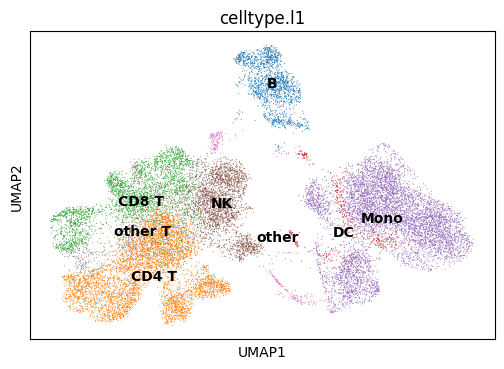

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


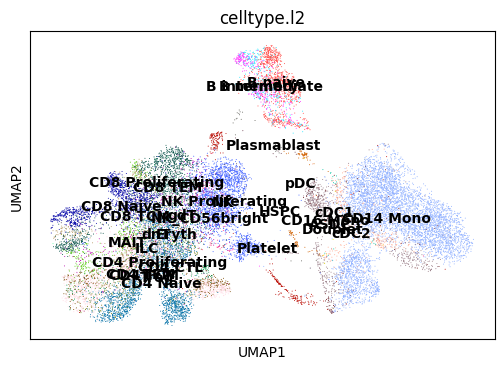

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


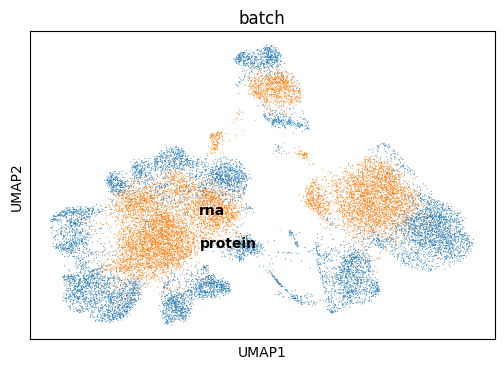

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


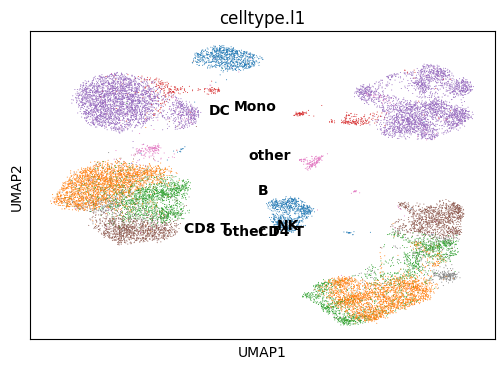

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


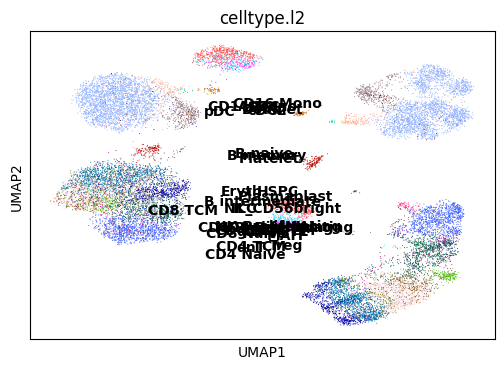

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


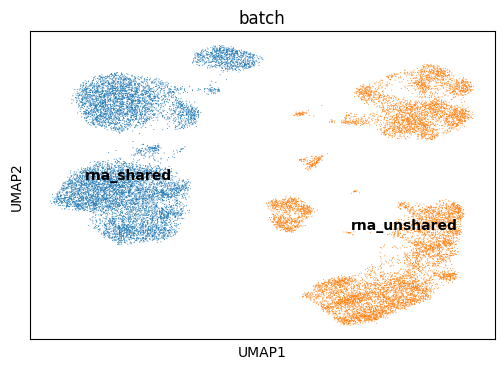

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


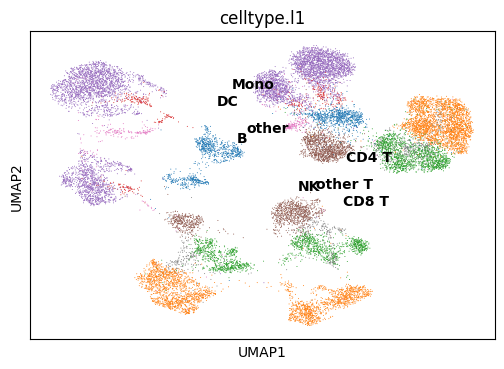

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


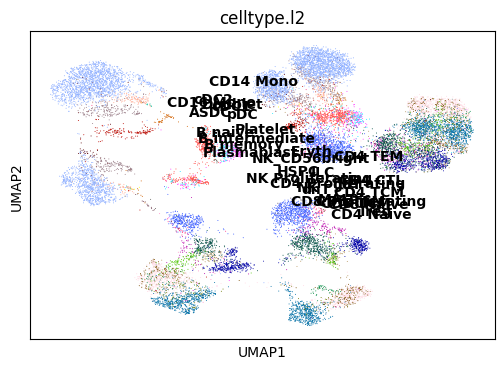

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


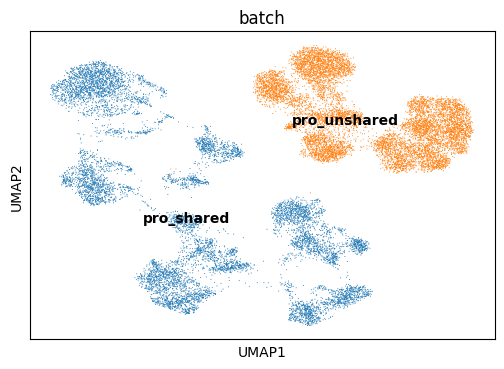

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For All matchings: lv1 matching acc: 0.740,
lv2 matching acc: 0.561.
For All matchings: FOSCTTM score: 0.23035924, 
Knn Alignment score: [0.0015 0.0027 0.0034 0.0044 0.0055 0.0061 0.0071 0.0083 0.0092 0.0102
 0.0111 0.0125 0.014  0.0146 0.0158 0.0162 0.0171 0.018  0.0188 0.0201
 0.0209 0.0219 0.0229 0.0235 0.0245]
For All matchings: Silhouette F1 score for lv1: 0.5097501156235745, 
Silhouette F1 score for lv2: 0.4968267358348702



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  3.360073685646057
Matchings are reduced to 5000 after filtering...


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:423: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[matchings[0]], labels_l1[matchings[1]])
C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For only filtered matchings: lv1 matching acc: 0.838,
lv2 matching acc: 0.659.


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:460: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[filtered_matchings[0]], labels_l1[filtered_matchings[1]])





Matches are being propagated....
Done!


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return np.mean([labels1[i] == labels2[j] for i, j in zip(matching[0], matching[1])])


For all matchings after propagation: lv1 matching acc: 0.784,
lv2 matching acc: 0.566.


C:\Users\vinee\Desktop\cs690\vineet_ugp\scVI\metrics\match_utils.py:495: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cm = confusion_matrix(labels_l1[propagated_matchings[0]], labels_l1[propagated_matchings[1]])


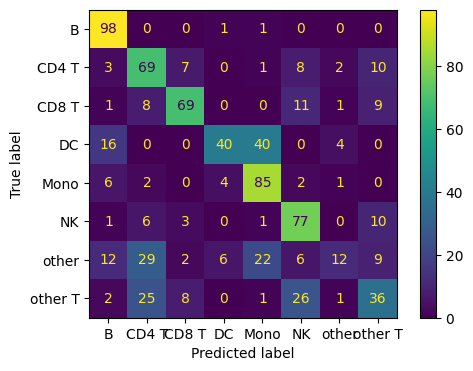

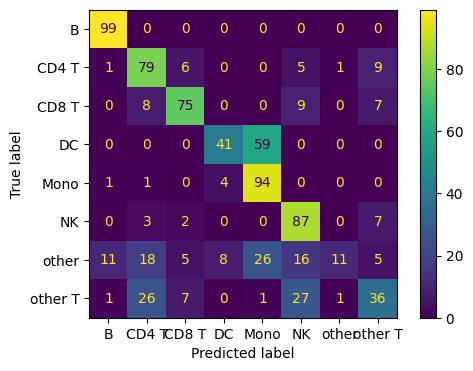

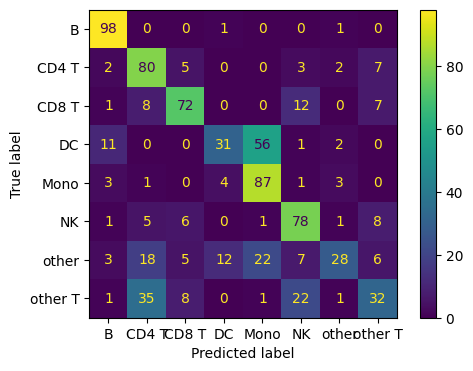

In [16]:
kl_weight = 0.0
metrics = {
    'original': {
        'lv1_acc': [],
        'lv2_acc': [],
        'foscttm_score': []
    },
    'filtered':{
        'lv1_acc': [],
        'lv2_acc': [],
        'foscttm_score': []
    },
    'propagated':{
        'lv1_acc': [],
        'lv2_acc': [],
        'foscttm_score': []
    }
}
for epoch in range(2001):
    loss = 0.0
    rna_recon_loss_piter = 0.0
    rna_kl_div_l_piter = 0.0
    rna_kl_div_z_piter = 0.0
    pro_recon_loss_piter = 0.0
    pro_kl_div_back_pro_piter = 0.0
    pro_kl_div_z_piter = 0.0
    shared_recon_loss1_piter = 0.0
    shared_recon_loss2_piter = 0.0
    shared_kl_div_z_piter = 0.0
    loss_emb_r1_piter = 0.0
    loss_emb_r2_piter = 0.0
    loss_emb_p1_piter = 0.0
    loss_emb_p2_piter = 0.0
    cross_loss_pro_piter = 0.0
    for batchr, batchp in tqdm(zip(rna_dataloader, protein_dataloader), desc="Epoch: {}".format(epoch)):
        optimizer_p.zero_grad()
        optimizer_r.zero_grad()
        optimizer_pr.zero_grad()
        
        y_shared = batchp["y_shared"].to(device)
        x_shared = batchr["x_shared"].to(device)
        y_unshared = batchp["y_unshared"].to(device)
        x_unshared = batchr["x_unshared"].to(device)
        x_batch = batchr["batch"].to(device)
        y_batch = batchp["batch"].to(device)
        # local_mean = rna_dataset.local_mean.reshape(-1,1).expand(x_shared.shape[0], 1).to(device)
        # local_var = rna_dataset.local_var.reshape(-1,1).expand(x_shared.shape[0], 1).to(device)
        local_mean = batchr["mean"].to(device)
        local_var = batchr["var"].to(device)
        
        gene_size = x_shared.size(0)
        ## forward pass of unshared network of proteins and rna
        pro_recon_loss, pro_kl_div_z, pro_kl_div_back_pro, z_pro, _ = podel(y_unshared,cross_inf = False)
        rna_recon_loss, rna_kl_div_l, rna_kl_div_z, z_rna, _ = rodel(x_unshared, local_mean, local_var, cross_inf = False)
        unshared_protein_loss = torch.mean(pro_recon_loss) + 0.001*torch.mean(pro_kl_div_z) + 0.001*torch.mean(pro_kl_div_back_pro)
        unshared_rna_loss = torch.mean(rna_recon_loss) + 0.001*torch.mean(rna_kl_div_l) + 0.001*torch.mean(rna_kl_div_z)
        with torch.no_grad():
            _, _, _, _, _, z_gene, z_protein, _ = prodel(x_shared,y_shared,local_mean,local_var,x_batch,y_batch, cross_inf = False)
        loss_embedd_p = CLIP_loss(z_protein, z_pro)
        loss_embedd_r = CLIP_loss(z_gene, z_rna)
        loss_pro = unshared_protein_loss + loss_embedd_p
        loss_rna = unshared_rna_loss + loss_embedd_r
        loss_rna.backward()
        optimizer_r.step()
        loss_pro.backward()
        optimizer_p.step()
        
        # update losses: 
        rna_recon_loss_piter += torch.mean(rna_recon_loss).item()
        rna_kl_div_l_piter += torch.mean(rna_kl_div_l).item()
        rna_kl_div_z_piter += torch.mean(rna_kl_div_z).item()
        pro_recon_loss_piter += torch.mean(pro_recon_loss).item()
        pro_kl_div_back_pro_piter += torch.mean(pro_kl_div_back_pro).item()
        pro_kl_div_z_piter += torch.mean(pro_kl_div_z).item()
        loss_emb_p1_piter += torch.mean(loss_embedd_p).item()
        loss_emb_r1_piter += torch.mean(loss_embedd_r).item()
    
        # forward pass of shared_network
        reconst_loss_gene, reconst_loss_protein, kl_div_z, kl_div_l_gene, kl_div_back_pro, z_gene, z_protein, _ = prodel(x_shared,y_shared,local_mean,local_var,x_batch,y_batch, cross_inf=False)
        shared_loss = torch.mean(reconst_loss_gene) + torch.mean(reconst_loss_protein) + 0.001*torch.mean(kl_div_z) + 0.001*torch.mean(kl_div_l_gene) + 0.001*torch.mean(kl_div_back_pro)
        with torch.no_grad():
            _, _, _, z_pro, _ = podel(y_unshared, cross_inf=False)
            _, _, _, z_rna, _ = rodel(x_unshared,local_mean,local_var, cross_inf=False)
        loss_embedd_p = CLIP_loss(z_protein, z_pro)
        loss_embedd_r = CLIP_loss(z_gene, z_rna)
        loss = shared_loss + loss_embedd_p + loss_embedd_r
        loss.backward()
        optimizer_pr.step()
        shared_kl_div_z_piter += torch.mean(kl_div_z).item()
        shared_recon_loss1_piter += torch.mean(reconst_loss_gene).item()
        shared_recon_loss2_piter += torch.mean(reconst_loss_protein).item()
        
        if epoch>1:
            # optimizer_p.zero_grad()
            optimizer_r.zero_grad()
            optimizer_pr.zero_grad()
            # cross network training
            _, _, _, _, _, z_gene, z_protein, para_out_prodel = prodel(x_shared,y_shared,local_mean,local_var,x_batch,y_batch, cross_inf = False)
            pro_recon_loss, _, _, _, _ = podel(y_unshared,cross_inf = True, para = get_paras_for_podel(para_out_prodel, gene_size))
            # rna_recon_loss, _, _, _, _ = rodel(x_unshared, local_mean, local_var, cross_inf = True, para = get_paras_for_rodel(para_out_prodel, gene_size))
            cross_loss_podel = torch.mean(pro_recon_loss)
            # print("rna_recon_loss: ", rna_recon_loss)
            # print("pro_recon_loss: ", pro_recon_loss)
            # cross_loss_rodel = torch.mean(rna_recon_loss)
            # cross_loss_rodel.backward(retain_graph=True)
            # optimizer_r.step()
            cross_loss_podel.backward(retain_graph=True)
            optimizer_p.step()
            optimizer_pr.step()
            cross_loss_pro_piter += cross_loss_podel.item()
            
            # with torch.no_grad():
            #     _, _, _, z_pro, para_out_podel = podel(y_unshared, cross_inf=False)
            #     _, _, _, z_rna, para_out_rodel = rodel(x_unshared,local_mean,local_var, cross_inf=False)
            # recon_loss_prodel, _, _, _, _, _, _, _ = prodel(x_shared,y_shared,local_mean,local_var,x_batch,y_batch, cross_inf = True, para = get_paras_for_prodel(para_out_rodel, para_out_podel, gene_size))
            # cross_loss_prodel = torch.mean(recon_loss_prodel)
            # cross_loss_prodel.backward()
            # optimizer_pr.step()
         
    kl_weight = min(1.0,(epoch+1)/1000)  
    print(f"RNA Recon Loss: {rna_recon_loss_piter / 10000:.4f}, "
      f"RNA KL Div L: {rna_kl_div_l_piter / 10000:.4f}, "
      f"RNA KL Div Z: {rna_kl_div_z_piter / 10000:.4f}, "
      f"Protein Recon Loss: {pro_recon_loss_piter / 10000:.4f}, "
      f"Protein KL Div Back Pro: {pro_kl_div_back_pro_piter / 10000:.4f}, "
      f"Protein KL Div Z: {pro_kl_div_z_piter / 10000:.4f}, "
      f"Embedding Loss P1: {loss_emb_p1_piter / 10000:.4f}, "
      f"Embedding Loss R1: {loss_emb_r1_piter / 10000:.4f}, "
      f"Shared KL Div Z: {shared_kl_div_z_piter / 10000:.4f}, "
      f"Shared Recon Loss Gene: {shared_recon_loss1_piter / 10000:.4f}, "
      f"Shared Recon Loss Protein: {shared_recon_loss2_piter / 10000:.4f}",
         f"Cross Loss Protein: {cross_loss_pro_piter/10000:.4f}")
    scheduler_p.step()
    scheduler_r.step()
    scheduler_pr.step()
    if (epoch) % 100 == 0:
        """Testing loop and visualisation saving"""
        with torch.no_grad():
            shared_rna_data = torch.Tensor(rna_dataset.shared_data)
            shared_pro_data = torch.Tensor(protein_dataset.shared_data)
            unshared_pro_data = torch.Tensor(protein_dataset.unshared_data)
            unshared_rna_data = torch.Tensor(rna_dataset.unshared_data)
            labelsl1 = rna_dataset.labels_l1
            labelsl2 = rna_dataset.labels_l2
            shared_tensor_mean = torch.Tensor(rna_dataset.local_mean).to(device)
            shared_tensor_var = torch.Tensor(rna_dataset.local_var).to(device)
            x_batch = torch.Tensor(rna_dataset.batch).to(device)
            y_batch = torch.Tensor(protein_dataset.batch).to(device)
            _, _, _, _, _, z_gene, z_pro, _ = prodel(shared_rna_data, shared_pro_data, shared_tensor_mean, shared_tensor_var, x_batch, y_batch, cross_inf=False)
            _, _, _, z_pro_un, _ = podel(unshared_pro_data, cross_inf=False)
            _, _, _, z_gene_un, _ = rodel(unshared_rna_data,shared_tensor_mean,shared_tensor_var, cross_inf=False)
            adata_plot = ad.AnnData(X= np.concatenate([z_gene.numpy(), z_pro.numpy()], axis=0))
            adata_plot.obs['celltype.l1'] = np.concatenate([labelsl1,labels_l1], axis=0)
            adata_plot.obs['celltype.l2'] = np.concatenate([labelsl2,labels_l2], axis=0)
            adata_plot.obs['batch'] = np.concatenate([["rna"]*z_gene.shape[0], ["protein"]*z_pro.shape[0]], axis=0)
            sc.pp.neighbors(adata_plot)
            sc.tl.umap(adata_plot)
            sc.pl.umap(adata_plot, color='celltype.l1', legend_loc='on data', s=2)            
            sc.pl.umap(adata_plot, color='celltype.l2', legend_loc='on data', s=2)
            sc.pl.umap(adata_plot, color='batch', legend_loc='on data', s=2)            
            
            adata_plot = ad.AnnData(X= np.concatenate([z_gene.numpy(), z_gene_un.numpy()], axis=0))
            adata_plot.obs['celltype.l1'] = np.concatenate([labelsl1,labels_l1], axis=0)
            adata_plot.obs['celltype.l2'] = np.concatenate([labelsl2,labels_l2], axis=0)
            adata_plot.obs['batch'] = np.concatenate([["rna_shared"]*z_gene.shape[0], ["rna_unshared"]*z_gene.shape[0]], axis=0)
            sc.pp.neighbors(adata_plot)
            sc.tl.umap(adata_plot)
            sc.pl.umap(adata_plot, color='celltype.l1', legend_loc='on data', s=2)            
            sc.pl.umap(adata_plot, color='celltype.l2', legend_loc='on data', s=2)
            sc.pl.umap(adata_plot, color='batch', legend_loc='on data', s=2)
            
            adata_plot = ad.AnnData(X= np.concatenate([z_pro.numpy(), z_pro_un.numpy()], axis=0))
            adata_plot.obs['celltype.l1'] = np.concatenate([labelsl1,labels_l1], axis=0)
            adata_plot.obs['celltype.l2'] = np.concatenate([labelsl2,labels_l2], axis=0)
            adata_plot.obs['batch'] = np.concatenate([["pro_shared"]*z_gene.shape[0], ["pro_unshared"]*z_gene.shape[0]], axis=0)
            sc.pp.neighbors(adata_plot)
            sc.tl.umap(adata_plot)
            sc.pl.umap(adata_plot, color='celltype.l1', legend_loc='on data', s=2)            
            sc.pl.umap(adata_plot, color='celltype.l2', legend_loc='on data', s=2)
            sc.pl.umap(adata_plot, color='batch', legend_loc='on data', s=2)
            
            met = mu.get_all_metrics(z_gene, z_pro, labelsl1, labelsl2, dim_use = 20, k_max=25, metric='euclidean', assignment_type='mindist', filter_prop=0.5, verbose=True)
            metrics['original']['lv1_acc'].append(met['original']['lv1_acc'])
            metrics['original']['lv2_acc'].append(met['original']['lv2_acc'])
            metrics['original']['foscttm_score'].append(met['original']['foscttm_score'])
            metrics['filtered']['lv1_acc'].append(met['filtered']['lv1_acc'])
            metrics['filtered']['lv2_acc'].append(met['filtered']['lv2_acc'])
            metrics['filtered']['foscttm_score'].append(met['filtered']['foscttm_score'])
            metrics['propagated']['lv1_acc'].append(met['propagated']['lv1_acc'])
            metrics['propagated']['lv2_acc'].append(met['propagated']['lv2_acc'])
            metrics['propagated']['foscttm_score'].append(met['propagated']['foscttm_score'])

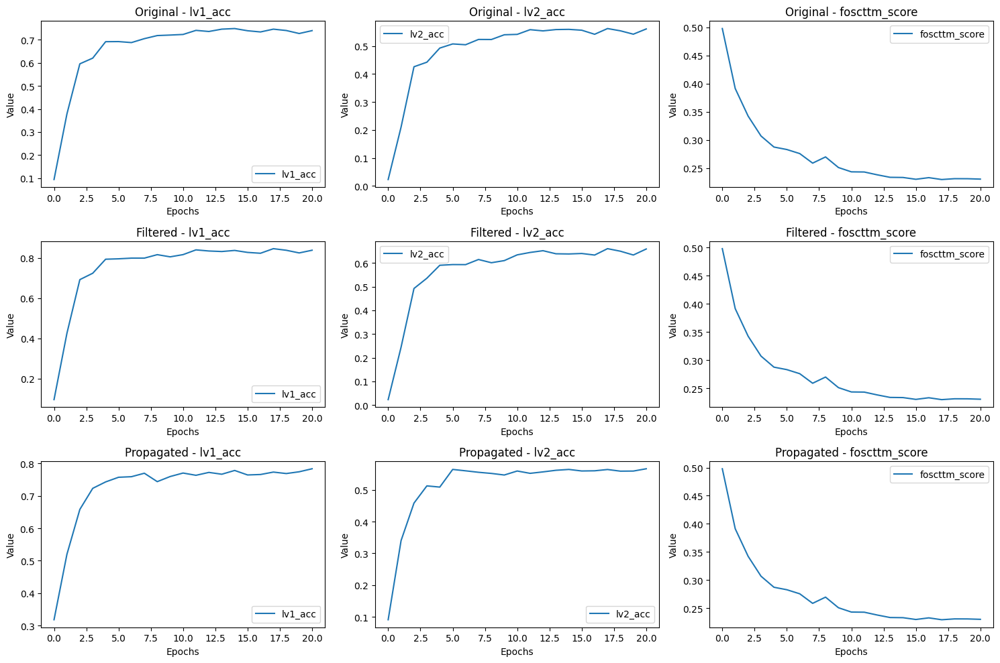

In [17]:
# Create subplots
fig, axs = plt.subplots(3, 3, figsize=(15, 10))

# Plot each metric on a separate subfigure
for i, (category, submetrics) in enumerate(metrics.items()):
    for j, (metric_name, values) in enumerate(submetrics.items()):
        ax = axs[i, j]
        ax.plot(values, label=metric_name)
        ax.set_title(f'{category.capitalize()} - {metric_name}')
        ax.set_xlabel('Epochs')
        ax.set_ylabel('Value')
        ax.legend()

# Adjust layout and show the plot
plt.tight_layout()
plt.show()

In [18]:
# Assuming the metrics dictionary is defined as previously

for key, value in metrics.items():
    max_lv1_acc = max(value['lv1_acc'])
    max_lv2_acc = max(value['lv2_acc'])
    print(f"{key}: Maximum Level 1 Accuracy: {max_lv1_acc}, Maximum Level 2 Accuracy: {max_lv2_acc}")


original: Maximum Level 1 Accuracy: 0.7487, Maximum Level 2 Accuracy: 0.5621
filtered: Maximum Level 1 Accuracy: 0.8454, Maximum Level 2 Accuracy: 0.6606
propagated: Maximum Level 1 Accuracy: 0.7835939270337638, Maximum Level 2 Accuracy: 0.566281441196465
